# Исследование методов построения временных рядов таблиц «затраты-выпуск»

In [137]:
from scripts import support, insd, kuroda, nras, metrics, vectorization as v
from sklearn.linear_model import LinearRegression, Lasso, Ridge
from IPython.display import display
import scipy.stats as ss
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import pickle
%matplotlib inline

# 1. Определение методов, необходимых для проведения анализа

## 1.1. Вспомогательные методы

### 1.1.1. Получение таблиц

In [2]:
def agg_cols_rows(table, cols_to_agg=None, new_cols=None, inds_to_agg=None, new_inds=None):
    """
    Aggregates rows and columns in DataFrame object
    
    Parameters
    ----------
    table: pd.DataFrame
        table in which the rows and columns should be aggregated
    cols_to_agg: array_like
        names of columns to aggregate
    new_cols: array_like
        names of aggregated column
    inds_to_agg: array_like
        table indexes to be aggregated
    new_inds: array_like
        aggregated indexes
        
    Returns
    -------
    table: pd.DataFrame
        table with aggregated columns and rows  
    """
    
    if cols_to_agg is not None:
        for i in range(len(new_cols)):
            table.insert(int(np.argwhere(np.array(table.columns) == cols_to_agg[i][0])[0, 0]), 
                         new_cols[i], np.sum(table[cols_to_agg[i]], axis=1))        
            table = table.drop(columns=cols_to_agg[i])

    if inds_to_agg is not None:
        for i in range(len(new_inds)):
            new_row = pd.Series(np.sum(table.iloc[inds_to_agg[i]], axis=0), name=new_inds[i])
            table = table.drop(index=table.index[inds_to_agg[i]])
            table = table.append(new_row)
    
    return table        

In [3]:
def read_table(file_name, sheet_name=0, skiprows=None, index_col=None, inds_to_take=None, 
               is_agg=False, cols_to_agg=None, new_cols=None, inds_to_agg=None, new_inds=None):
    """
    Read table from Excel file
    
    Parameters
    ----------
    file_name: str
        path to the file with table
    sheet_name: str or int
        file sheet from which table should be read
    skiprows: int
        number of rows to skip
    index_col: int
        index of column to use as rows labels
    ind_to_tale: array_like
        rows and columns indices to read
    is_agg: boolean
        if there is a need to aggregate table columns and/or rows
    cols_to_agg: array_like
        names of columns to aggregate
    new_cols: array_like
        names of aggregated column
    inds_to_agg: array_like
        table indexes to be aggregated
    new_inds: array_like
        aggregated indexes
        
    Returns
    -------
    table: pd.DataFrame
        table from file with aggregated columns and rows if is_agg=True  
    """
    
    table = pd.read_excel(file_name, sheet_name, skiprows=skiprows, index_col=index_col)
    
    if inds_to_take is not None:
        table = table.iloc[inds_to_take[0], inds_to_take[1]].astype(np.float)
        
    if is_agg:
        table = agg_cols_rows(table, cols_to_agg, new_cols, inds_to_agg, new_inds)
        
    return table

In [4]:
def get_series_from_df(df, years, inds_to_take=None):
    """
    Get tables series for years from generic table
    
    Parameters
    ----------
    df: pd.DataFrame
        generic table with tables for some years
    years: array_like
        years for which tables series is requires
    inds_to_tale: array_like
        rows and columns indices to take from table for a year
        
    Returns
    -------
    series: list
        tables series  
    """

    series = []
    
    for i, y in enumerate(years):
        series.append(df[df['year'] == y].drop(columns='year'))
        if inds_to_take is not None:
            series[-1] = series[-1].iloc[inds_to_take]
        
    return series

In [25]:
def read_wiod_sut(file_name, sheet_name, years, cols_inds_drop, n_rows=59):
    """
    Read supply, use tables from WIOD file (release 2013)
    
    Parameters
    ----------
    file_name: str
        path to the file with table
    sheet_name: str or int
        file sheet from which table should be read
    years: array_like
        years for which tables are required
    cols_inds_drop: array_like
        columnds indices to drop
    n_rows: int
        number of rows in first quadrant
        
    Returns
    -------
    tables: ndarray
        tables time series for the years  
    """
    
    iots_all = read_table(file_name, sheet_name).iloc[1:]
    iots_all.dropna(how='all', inplace=True)
    iots_all = iots_all.reset_index().drop(columns=np.append(['level_2'], np.array(iots_all.columns.tolist())[cols_inds_drop]))
    iots_all.columns = ['year', 'code'] + iots_all.columns.tolist()[2:]
    iots_all['year'] = iots_all['year'].astype('int')
    iots_all = iots_all.set_index('code')
    
    iots_agg = iots_all.iloc[:, 1:].groupby(level=0).sum(axis=0).iloc[:59, :36]
    null_rows = pd.Series(np.zeros_like(iots_agg.index), index=iots_agg.index)
    null_rows = null_rows + iots_agg.sum(axis=1) == 0
    null_cols = pd.Series(np.zeros_like(iots_agg.columns[1:]), index=iots_agg.columns[1:])
    null_cols = null_cols + iots_agg.sum(axis=0) == 0
    if sum(null_rows) > 0:
        print(null_rows.index[null_rows == 1])
        iots_all = iots_all.drop(index=null_rows.index[null_rows == 1])
    if sum(null_cols) > 0:
        print(null_cols.index[null_cols == 1])
        iots_all = iots_all.drop(columns=null_cols.index[null_cols == 1]) 
    
    n_rows = n_rows - len(null_rows.index[null_rows == 1].tolist())
    
    iots_years = get_series_from_df(iots_all, years)
    for i in range(len(iots_years)):
        iots_years[i] = iots_years[i].iloc[:n_rows, :]
        iots_years[i] = iots_years[i].values
    print(iots_years[0].shape)
    
    return np.array(iots_years, dtype='float64')

In [26]:
def read_wiod_iot(file_name, years, country):    
    """
    Read input-output tables from WIOD file (release 2013)
    
    Parameters
    ----------
    file_name: str
        path to the file with table
    years: array_like
        years for which tables are required
    country: str
        country for which tables are required
        
    Returns
    -------
    tables: ndarray
        tables time series for the years and for the country  
    """
    
    for y in years:
        iot_y = read_table(file_name, str(y), index_col=3, skiprows=5, is_agg=True,
                           cols_to_agg=[['c37', 'c38', 'c39', 'c41', 'c42']], 
                           new_cols=['other_final_demand']).iloc[:-1, 2:-1]
        iot_y.columns = ['origin'] + iot_y.columns.tolist()[1:]
        cols = iot_y.columns.tolist()
        cols = cols[:-2] + cols[-1:] + cols[-2:-1]
        iot_y = iot_y[cols]
        
        iot_y.insert(0, 'year', np.full(iot_y.shape[0], y))
        
        if y == years[0]:
            iots_all = iot_y.copy()
        else:
            iots_all = iots_all.append(iot_y)
    
    cols = iots_all.columns
    iots_agg = iots_all[iots_all['origin'] == country].groupby(level=0).sum(axis=0).loc[cols[2:-2], cols[2:-2]] 
    null_industries = pd.Series(np.zeros_like(iots_agg.index), index=iots_agg.index)
    null_industries += iots_agg.sum(axis=1) == 0
    null_industries += iots_agg.sum(axis=0) == 0
    if np.sum(null_industries == 2) > 0:
        print(null_industries.index[null_industries == 2])
        iots_all = iots_all.drop(index=null_industries.index[null_industries == 2],
                                 columns=null_industries.index[null_industries == 2])
        
    iots_all.index = list(map(lambda s: str(s[0]) + '_' + str(s[1]), zip(iots_all.index.tolist(), iots_all['origin'])))
    
    cols = iots_all.columns.tolist()
    cur_last_col_ind = len(cols) - 3
    new_last_col_ind = cur_last_col_ind
    
    if np.sum(iots_all.iloc[:, -3] == 0) > 0:
        for i in range(len(cols) - 4, 1, -1):
            inds_to_check = [country in s for s in iots_all.index.tolist()]
            if np.sum(iots_all.iloc[inds_to_check, i] == 0) == 0:
                new_last_col_ind = i
                break
        print(i, cols[new_last_col_ind])
        if i == 2:
            print('all columns contain 0')
                
    cols_inds = list(range(2, new_last_col_ind)) + list(range(cur_last_col_ind, cur_last_col_ind + 1)) + \
                list(range(new_last_col_ind + 1, cur_last_col_ind)) + list(range(new_last_col_ind, new_last_col_ind + 1)) + \
                list(range(cur_last_col_ind + 1, len(cols))) 
    cols_inds = [i - 2 for i in cols_inds]
    
    iots = get_series_from_df(iots_all, years)
    
    for i in range(len(iots)):
        iots[i] = iots[i].drop(index=['r60_TOT'])

        va_inds = np.argwhere(iots[i]['origin'] != country)[:, 0]
        va = pd.Series(np.sum(iots[i].iloc[va_inds], axis=0), name='value_added')        
        iots[i] = iots[i].append(va)
        iots[i] = iots[i].drop(index=iots[i].index[va_inds], columns=['origin'])

        iots[i].loc['value_added', 'other_final_demand'] = sum(iots[i]['other_final_demand'].iloc[:-1])
        iots[i].loc['value_added', 'c44'] = sum(iots[i]['c44'].iloc[:-1])
        
        iots[i] = iots[i].iloc[cols_inds[:-2] + [-1], cols_inds]
        
        iots[i] = iots[i].values
    
    print(iots[0].shape)
        
    return np.array(iots, dtype='float64')

### 1.1.2. Проекция таблиц стандартными методами

In [5]:
def apply_classic_method(init_table, true_table, method, kuroda_args=None, nras_args=None): 
    """
    Project one base table with classic method (NRAS, INSD or Kuroda)
    
    Parameters
    ----------
    init_table: ndarray
        initial estimate for projection
    true_table: ndarray
        true table
    method: function
        method to apply for projection
    kuroda_args: dict
        arguments for kuroda method
    nras_args: dict
        argument for nras method
        
    Returns
    -------
    pred_tables: ndarray
        predicted table  
    """
    
    G = v.addrows(init_table.shape, sparsed=True)
    G = v.addcolumns(init_table.shape, G=G, sparsed=True) 
    
    sums_rows = true_table.sum(axis=1).reshape(-1, 1)
    sums_cols = true_table.sum(axis=0).reshape(-1, 1)
    c = np.append(sums_rows, sums_cols, axis=0)

    vect_a = v.tovector(init_table)
    
    if method == kuroda.kuroda and kuroda_args is not None:
        pred_table = method(G=G, aa=vect_a, c=c, sparsed=True, mtype=kuroda_args['mtype'])
    elif method == nras.nras and nras_args is not None:
        pred_table = method(G=G, aa=vect_a, c=c, sparsed=True, accuracy=nras_args['accuracy'], limit=nras_args['limit'])
    elif method == insd.insd or nras_args is None or kuroda_args is None:
        pred_table = method(G=G, aa=vect_a, c=c, sparsed=True)
    else:
        raise ValueError('Method must be one of [insd.insd, kuroda.kuroda, nras.nras]')
        
#     print('true', true_table)
#     print('pred', pred_table)
        
    return v.tomatrix(pred_table, shape=init_table.shape)

In [6]:
def predict_tables_classic_method(true_tables, method, is_forecast=True, kuroda_args=None, nras_args=None):
    """
    Construct tables time series with classic method (NRAS, INSD or Kuroda)
    
    Parameters
    ----------
    true_tables: ndarray
        true tables time series
    method: function
        method to apply for projection
    is_forecast: boolean
        if is_forecast=True, project in the forward direction
    kuroda_args: dict
        arguments for kuroda method
    nras_args: dict
        argument for nras method
        
    Returns
    -------
    pred_tables: ndarray
        predicted tables time series  
    """
    
    if not is_forecast:
        true_tables = np.flip(true_tables, axis=0)
        
    pred_tables = np.array([], dtype='float').reshape(0, true_tables.shape[1], true_tables.shape[2]) 
    
    pred_table = true_tables[0]
    for i in range(1, len(true_tables)):            
        pred_table = apply_classic_method(pred_table, true_tables[i], method, kuroda_args, nras_args)
        pred_tables = np.vstack((pred_tables, [pred_table]))
        
    if not is_forecast:
        true_tables = np.flip(true_tables, axis=0)
        pred_tables = np.flip(pred_tables, axis=0)
    
    return pred_tables  

## 1.2. Исследуемые методы

### 1.2.1. Cycling method (Lenzen et al., 2012)

$alpha = 1 \Rightarrow$ the initial estimate is always and only taken from the same-year solution of the prior cycle

$alpha = 0 \Rightarrow$ the initial estimate ignores any prior cycle and only ever considers same-cycle, prior-year values

In [9]:
def cycling_method(true_tables, method, max_cycles, is_forecast=True, alpha=0.5, eps=0.01, kuroda_args=None, nras_args=None):
    """
    Construct tables time series with cycling method
    
    Parameters
    ----------
    true_tables: ndarray
        true tables time series
    method: function
        method to apply for projection
    max_cycles: int
        maximum cycles to implement
    is_forecast: boolean
        if is_forecast=True, project in the forward direction
    alpha: float
        cycling method weight coefficient
    eps: float
        maximum deviation in cycles values to interrupt cycles implementation
    kuroda_args: dict
        arguments for kuroda method
    nras_args: dict
        argument for nras method
        
    Returns
    -------
    pred_tables: ndarray
        constructed tables time series
    """
    
    if not is_forecast:
        true_tables = np.flip(true_tables, axis=0)
    
    a = np.zeros((2, true_tables.shape[0], true_tables.shape[1], true_tables.shape[2]), dtype='float')
    a[0, 1:-1] = predict_tables_classic_method(true_tables[:-1], method, kuroda_args, nras_args)
    a[:, 0] = np.array([true_tables[0], true_tables[0]])
    a[:, -1] = np.array([true_tables[-1], true_tables[-1]])
    
    w = np.array([[0, alpha], [1 - alpha, 0]])    
    
    y = len(true_tables) - 1
    for c in range(1, max_cycles):
        for i in range(len(true_tables) - 2):
            increment = 1 if c % 2 == 0 else -1
            y = y + increment
            init_table = w[0, 1] * a[1, y - increment] + w[1, 0] * a[0, y] 

            a[1, y] = apply_classic_method(init_table, true_tables[y], method, kuroda_args, nras_args) 

        a_avg = np.average(a, axis=0)
        if np.average(np.abs(a[1] - a_avg) / a_avg) < eps or c == max_cycles - 1:
            print('final cycle:', c + 1)
            break
            
        a[0] = a[1]        
        y = y + increment
        
    return a_avg if is_forecast else np.flip(a_avg, axis=0)

### 1.2.2. MTT method (Wang et al, 2015)

#### 1.2.2.1. Classic MTT

In [10]:
def transform_mtt0(x_arr):        
    """
    Transform tables for MTT (basic version)
    
    Parameters
    ----------
    x_arr: ndarray
        base tables where last row - total value added, last column - total final demand
        
    Returns
    -------
    y_arr: ndarray
        transformed base tables
    """
    
    y_arr = np.zeros_like(x_arr, dtype='float')
    
    for i in range(x_arr.shape[0]):
        z = x_arr[i, :-1, :-1]
        f = x_arr[i, :-1, -1]
        v = x_arr[i, -1, :-1]
        mu = np.sum(v)

        t = np.dot(np.diag(np.ones_like(f) / f), z)
        d = v / mu
        
        y_arr[i, :-1, :-1] = t
        y_arr[i, -1, :-1] = d
        y_arr[i, :, -1] = np.ones(y_arr[0].shape[0])
    
    return y_arr

In [11]:
def inv_transform_mtt0(y_arr, mu_arr):
    """
    Inverse-transform tables for MTT (basic version)
    
    Parameters
    ----------
    y_arr: ndarray
        predicted tables
    mu_arr: ndarray
        sums of value added (or final demand) in true tables
        
    Returns
    -------
    x_arr: ndarray
        inverse-transformed predicted tables
    """
    
    x_arr = np.zeros_like(y_arr, dtype='float')
    x_arr[:, -1, -1] = mu_arr
    
    for i in range(y_arr.shape[0]):
        t = y_arr[i, :-1, :-1]
        d = y_arr[i, -1, :-1]
        
        v = mu_arr[i] * d
        
        b = np.diag(np.sum(t, axis=1) + np.ones(t.shape[0])) - np.transpose(t)
        f = np.dot(np.linalg.inv(b), v)
        z = np.dot(np.diag(f), t)
        
        x_arr[i, :-1, :-1] = z
        x_arr[i, -1, :-1] = v
        x_arr[i, :-1, -1] = f
                           
    return x_arr

#### 1.2.2.2. MTT I - zeros in final demand

In [12]:
def transform_mtt1(x_arr):    
    """
    Transform tables for MTT I (when there are zeros in final demand)
    
    Parameters
    ----------
    x_arr: ndarray
        base tables where last row - total value added, 
        last but one columns - exports and last column - other final demand
        
    Returns
    -------
    y_arr: ndarray
        transformed base tables
    """
        
    y_arr = np.zeros_like(x_arr, dtype='float')
    
    for i in range(x_arr.shape[0]):
        z = x_arr[i, :-1, :-2]
        f1 = x_arr[i, :-1, -2]
        f2 = x_arr[i, :-1, -1]
        v = x_arr[i, -1, :-2]
        mu1 = np.sum(f1)
        mu2 = np.sum(f2)
        
        f2_inv = np.diag(np.ones_like(f2) / f2)
        t = np.dot(f2_inv, z)
        d = v / mu2
        p = np.dot(f2_inv, f1)
        lam = mu1 / mu2
        
        y_arr[i, :-1, :-2] = t
        y_arr[i, -1, :-2] = d
        y_arr[i, :-1, -1] = p
        y_arr[i, -1, -1] = lam
        y_arr[i, :, -1] = np.ones(y_arr[0].shape[0])
    
    return y_arr

In [13]:
def inv_transform_mtt1(y_arr, f1_arr, mu2_arr):
    """
    Inverse-transform tables for MTT I
    
    Parameters
    ----------
    y_arr: ndarray
        predicted tables
    f1_arr: ndarray
        exports in true tables
    mu2_arr: ndarray
        sums of other final demand in true tables
        
    Returns
    -------
    x_arr: ndarray
        inverse-transformed predicted tables
    """
        
    x_arr = np.zeros_like(y_arr, dtype='float')
    x_arr[:, :-1, -2] = f1_arr
    x_arr[:, -1, -1] = mu2_arr
    
    for i in range(y_arr.shape[0]):
        t = y_arr[i, :-1, :-2]
        d = y_arr[i, -1, :-2]
        p = y_arr[i, :-1, -1]
        lam = y_arr[i, -1, -1]
        
        v = mu2_arr[i] * d
        b = np.diag(np.sum(t, axis=1) + np.ones(t.shape[0])) - np.transpose(t)
        f2 = np.dot(np.linalg.inv(b), (v - f1_arr[i]))
        z = np.dot(np.diag(f2), t)
        mu1 = np.sum(f1_arr[i])
        
        x_arr[i, :-1, :-2] = z
        x_arr[i, -1, :-2] = v
        x_arr[i, :-1, -1] = f2
        x_arr[i, -1, -2] = mu1
                           
    return x_arr

#### 1.2.2.3. MTT II - constraints known

In [14]:
def transform_mtt2(x_arr): 
    """
    Transform tables for MTT II (when gross outputs, intermediate inputs and outputs are known)
    
    Parameters
    ----------
    x_arr: ndarray
        base tables where last row - total value added, last column - total final demand
        
    Returns
    -------
    y_arr: ndarray
        transformed base tables
    """
    
    if 0 in x_arr[:, :-2, -2]:
        raise ValueError('there should not be zeros in the last column of z')
    
    return x_arr[:, :-2, :-2] / x_arr[:, :-2, -2:-1]    

In [15]:
def inv_transform_mtt2(u_arr, gross_out, int_out, int_in):
    """
    Inverse-transform tables for MTT I
    
    Parameters
    ----------
    u_arr: ndarray
        predicted tables
    gross_out: ndarray
        gross outputs in true tables
    int_out: ndarray
        intermediate outputs in true tables
    int_in: ndarray
        intermediate inputs in true tables
        
    Returns
    -------
    x_arr: ndarray
        inverse-transformed predicted tables
    """
    
    x_arr = np.zeros((u_arr.shape[0], u_arr.shape[1] + 2, u_arr.shape[2] + 2), dtype='float')
    
    for i in range(u_arr.shape[0]):
        for j in range(u_arr.shape[1]):
            x_arr[i, j, :-2] = u_arr[i, j] * int_in[i, j] / (1 + np.sum(u_arr[i, j]))
            x_arr[i, j, -2] = int_in[i, j] / (1 + np.sum(u_arr[i, j]))

        x_arr[i, -2, :-1] = int_out[i] - np.sum(x_arr[i, :, :-1], axis=0)
        
    x_arr[:, -1, :-1] = gross_out - int_out
    x_arr[:, :-1, -1] = gross_out - int_in
    
    x_arr[:, -1, -1] = np.sum(x_arr[:, -1], axis=1)
    
    return x_arr

In [16]:
mtt_types = dict(zip([0, 1, 2], [('mtt 0', transform_mtt0, inv_transform_mtt0),
                                 ('mtt i', transform_mtt1, inv_transform_mtt1),
                                 ('mtt ii', transform_mtt2, inv_transform_mtt2)]))

In [17]:
def mtt(true_tables, n_base_years, years, model_inst, mtype=0, is_forecast=True):
    """
    Construct tables time series using MTT method
    
    Parameters
    ----------
    true_tables: ndarray
        true tables time series
    n_base_years: int
        number of base tables to construct time series
    years: array_like
        time series years
    model_inst: object
        instance of forecasting model
    mtype: int
        mtt type (0, 1 or 2)
    is_forecast: boolean
        is to perform forecasting or backcasting
        
    Returns
    -------
    pred_tables: ndarray
        predicted tables time series
    true_tables_new: ndarray
        true tables time series corrected with regard to mtype
    """
    
    if not is_forecast:
        true_tables = np.flip(true_tables, axis=0)
        years = np.flip(years)
    
    if mtype != 1 and 0 not in np.sum(true_tables[:n_base_years, :, -2:], axis=2):
        true_tables_new = np.copy(true_tables[:, :, :-1])
        true_tables_new[:, :, -1] = np.sum(true_tables[:, :, -2:], axis=2)
    else:
        true_tables_new = true_tables
        mtype = 1
        
    print('using', mtt_types[mtype][0])
    transform_mtt = mtt_types[mtype][1]
    inv_transform_mtt = mtt_types[mtype][2]
    
    y_base = transform_mtt(true_tables_new[:n_base_years])
    y_pred = np.zeros((len(true_tables_new) - n_base_years, y_base.shape[1], y_base.shape[2]), dtype='float')

    f = model_inst    
    for i in range(y_base.shape[1]):
        for j in range(y_base.shape[2]):
            x = np.array([1, abs(years[n_base_years - 1] - years[0]) + 1], dtype='float').reshape(-1, 1)
            y = y_base[:n_base_years, i, j].reshape(-1, 1)
            f.fit(x, y)
            
            y_pred[:, i, j] = f.predict(np.arange(n_base_years + 1, len(true_tables_new) + 1).reshape(-1, 1)).reshape(-1)
            
    if not is_forecast:
        true_tables_new = np.flip(true_tables_new, axis=0)
        true_tables = np.flip(true_tables, axis=0)
        y_pred = np.flip(y_pred, axis=0)
        years = np.flip(years)
    
    if mtype == 0:
        return inv_transform_mtt(y_pred, mu_arr=true_tables_new[n_base_years:, -1, -1]), true_tables_new
    
    elif mtype == 1:
        f1_arr = true_tables_new[n_base_years:, :-1, -2]
        mu2_arr = np.sum(true_tables_new[n_base_years:, :-1, -1], axis=1)
        return inv_transform_mtt(y_pred, f1_arr, mu2_arr), true_tables_new
    
    elif mtype == 2:
        gross_out = np.sum(true_tables_new[n_base_years:, :-1], axis=2)
        int_out = np.sum(true_tables_new[n_base_years:, :-1, :-1], axis=1)
        int_in = np.sum(true_tables_new[n_base_years:, :-1, :-1], axis=2)
        return inv_transform_mtt(y_pred, gross_out, int_out, int_in), true_tables_new

## 1.3. Методы для проведения экспериментов и получения результатов

In [7]:
def get_metrics(true_tables, pred_tables, years):
    """
    Calculate metrics for true and predicted tables
    
    Parameters
    ----------
    true_tables: ndarray
        true tables time series
    pred_tables: ndarray
        predicted tables time series 
    years: array_like
        tables time series years
        
    Returns
    -------
    metrics_vals: pd.DataFrame
        DataFrame with metrics values for predicted tables time series
    """
    
    if len(true_tables) != len(pred_tables) or len(true_tables) != len(years):
        raise ValueError('true_tables, pred_tables and years must have the same length')
    
    for i, y in enumerate(years):
        true_table = true_tables[i]
        pred_table = pred_tables[i]
        
        res_metrics = metrics.get_values(pred_table, true_table, save=True)
        if i == 0:
            metrics_df = pd.DataFrame.from_dict({y: res_metrics}, orient='index')
        else:
            metrics_df = pd.concat((metrics_df, 
                                    pd.DataFrame.from_dict({y: res_metrics}, orient='index')), 
                                    axis=0)
            
    return metrics_df

In [8]:
def plot_metrics(metrics_dfs, methods_names):
    """
    Plot metrics for true and predicted tables
    
    Parameters
    ----------
    metrics_dfs: dict
        dictionary with metrics values, key - method name, value - metrics values dataframe
    methods_names: array_like
        list of methods names
    """
        
    metrics_names = list(metrics_dfs[0].keys())
    fig, ax = plt.subplots(3, 3, figsize=(20, 17)) 
    
    ind = 0
    max_year = 0
    min_year = 1e6
    for i in range(ax.shape[0]):    
        for j in range(ax.shape[1]):            
            for method_name, metrics_df in zip(methods_names, metrics_dfs):
                if metrics_names[ind] not in metrics_df.columns:
                    continue
                    
                if i + j == 0:
                    max_year = max([max_year] + metrics_df[metrics_names[ind]].index.tolist())
                    min_year = min([min_year] + metrics_df[metrics_names[ind]].index.tolist())
                    
                if metrics_df.shape[0] == 1:
                    ax[i, j].scatter(metrics_df.index[0], metrics_df[metrics_names[ind]], label=method_name)
                else:
                    ax[i, j].plot(metrics_df[metrics_names[ind]], marker='o', label=method_name)

            ax[i, j].set_title(metrics_names[ind])
            ax[i, j].legend()
            ax[i, j].set_xticks(np.arange(min_year, max_year + 1, dtype='int'))
            ax[i, j].grid(True)
            
            ind += 1
            if ind >= len(metrics_names):
                break

    plt.show()

In [28]:
def save_obj(obj, name):
    with open('obj/'+ name + '.pkl', 'wb') as f:
        pickle.dump(obj, f)
        
def load_obj(name):
    with open('obj/' + name + '.pkl', 'rb') as f:
        return pickle.load(f)

In [18]:
def apply_methods(true_tables, years, max_cycles=10, base_years=1, is_mtt=False, is_mtt_forecast=True, plot=True):
    """
    Apply different methods to construct time series and calculate the metrics
    
    Parameters
    ----------
    true_tables: ndarray
        true tables time series
    years: array_like
        time series years
    max_cycles: int
        maximum cycles to implement in cycling method
    base_years: int
        number of base tables to construct time series (used for mtt)
    is_mtt: boolean
        is to apply mtt method
    is_mtt_forecast: boolean
        is to perform forecasting or backcasting in mtt method
    plot: boolean
        is to plot metrics
        
    Returns
    -------
    metrics_vals: dict
        dictionary with metrics values where keys are methods names
    """
    
    methods = [nras.nras, insd.insd, kuroda.kuroda]
    
    method_names = ['nras', 'insd', 'kuroda']
    mtypes = [0] + ([2] if np.sum(true_tables[:, :-2, -3] == 0) == 0 else [])
    print('available mtypes:', mtypes)
    mtt_variations = [t + ' ' + m + ' ' + c for t in ['mtt' + str(i) for i in mtypes] \
                                            for m in ['linear', 'ridge', 'lasso'] \
                                            for c in ['forecast' if is_mtt_forecast else 'backcast']] \
                     if is_mtt else []
    variations_names = ['simple forecast', 'simple backcast', 'cycling forecast', 'cycling backcast']
    method_variations_names = [m + ' ' + v for m in method_names for v in variations_names] + mtt_variations 

    metrics_vals = dict.fromkeys(method_variations_names)
    
    if is_mtt:
        ind = 0
        for mtype in mtypes:
            for model in [LinearRegression(), Ridge(), Lasso()]:
                print(mtype, model, is_mtt_forecast)
                mtt_pred, mtt_true = mtt(true_tables, base_years, years, model, mtype=mtype, is_forecast=is_mtt_forecast)
                
                if is_mtt_forecast:
                    metrics_vals[mtt_variations[ind]] = get_metrics(mtt_true[base_years:], mtt_pred, years[base_years:])
                else:
                    metrics_vals[mtt_variations[ind]] = get_metrics(mtt_true[:-base_years], mtt_pred, years[:-base_years])
                    
                print(mtt_variations[-2])
                ind += 1

    if is_mtt_forecast or not is_mtt:
        true_tables_classic = true_tables[base_years - 1:]
        years_classic = years[base_years - 1:]
    else:
        true_tables_classic = true_tables[:-base_years + 1]
        years_classic = years[:-base_years + 1]
        
    for i, method in enumerate(methods):
        names = method_variations_names[i * len(variations_names) : (i + 1) * len(variations_names)] + mtt_variations
        
        metrics_vals[names[0]] = get_metrics(true_tables_classic[1:], 
                                             predict_tables_classic_method(true_tables_classic, method, is_forecast=True), 
                                             years_classic[1:])
        print(names[0])

        metrics_vals[names[1]] = get_metrics(true_tables_classic[:-1], 
                                             predict_tables_classic_method(true_tables_classic, method, is_forecast=False), 
                                             years_classic[:-1])
        print(names[1])

        metrics_vals[names[2]] = get_metrics(true_tables_classic[1:-1], 
                                             cycling_method(true_tables_classic, method, max_cycles=max_cycles, is_forecast=True)[1:-1], 
                                             years_classic[1:-1])
        print(names[2])

        metrics_vals[names[3]] = get_metrics(true_tables_classic[1:-1], 
                                             cycling_method(true_tables_classic, method, max_cycles=max_cycles, is_forecast=False)[1:-1], 
                                             years_classic[1:-1])
        print(names[3])
           
        if plot:
            plot_metrics([metrics_vals[mn] for mn in names], names)
        
    return metrics_vals

In [140]:
def get_compared_results(metrics_vals):
    """
    Rank metrics values and calculate cumulative ranks for methods
    
    Parameters
    ----------
    metrics_vals: dict
        dictionary with metrics values where keys are methods names
        
    Returns
    -------
    metrics_com_df: pd.DataFrame
        dataframe with metrics values and ranks
    """
    method_names = list(metrics_vals.keys())
    metrics_names = list(list(metrics_vals.values())[0].columns)
    ranks_names = [mn + '_R' for mn in metrics_names]

    columns_names = []
    for metric_name, rank_name in zip(metrics_names, ranks_names):
        columns_names.extend([metric_name, rank_name])
    columns_names.extend(['R_all', 'CmR'])

    metrics_comp_df = pd.DataFrame(data=np.zeros((len(method_names), len(columns_names)), dtype='float'),
                                   index=method_names, 
                                   columns=columns_names)

    for method_name, metrics_vals in metrics_vals.items():
        metrics_comp_df.loc[method_name, metrics_names] = np.average(metrics_vals, axis=0)

    for i in range(len(ranks_names)):
        metrics_comp_df[ranks_names[i]] = ss.rankdata(metrics_comp_df[metrics_names[i]] 
                                                      if metrics_names[i] != 'RSQ' 
                                                      else -metrics_comp_df[metrics_names[i]], 'dense')

    metrics_comp_df['R_all'] = metrics_comp_df[ranks_names].sum(axis=1)
    metrics_comp_df['CmR'] = ss.rankdata(metrics_comp_df['R_all'], 'min')

    metrics_comp_df = metrics_comp_df.sort_values('CmR')
                        
    return metrics_comp_df

In [32]:
def get_results(country):
    """
    Apply all methods to all kinds of tables
    
    Parameters
    ----------
    country: str
        country for which time series will be constructed
        
    Returns
    -------
    res: dict
        dictionary with metrics values where keys are kinds of tables
    """
    
    res = dict.fromkeys(['use basic I+II', 'use basic I', 'use purchase I+II', 'use purchase I', 'sup I', 'iot'])

    print(country)

    for tables, key in zip([use_basic[country], use_basic[country][:, :, :-use_n_cols_q2], 
                            use_purchase[country], use_purchase[country][:, :, :-use_n_cols_q2], 
                            sup[country], iot[country]],
                           res.keys()):
        print(key)
        res[key] = []
        is_mtt = key == 'iot'

        for i in range(len(years[country]) // 5):
            if not is_mtt or (is_mtt and len(years[country]) // 5 == 1):
                inds = np.arange(i * 5, (i + 1) * 5 + 1) 
            elif i == 0:
                inds = np.append(np.arange(0, 6), [len(years[country]) - 1])
            else:
                inds = np.append([(i - 1) * 5], np.arange(i * 5, (i + 1) * 5 + 1))
                
            print(years[country][inds])
            
            res[key].append(apply_methods(tables[inds], years[country][inds], 
                            is_mtt=is_mtt, is_mtt_forecast=i > 0, base_years=2 if is_mtt else 1))
            
            save_obj(res[key][i], country.lower() + '_metrics_' + key + '_' + \
                     str(years[country][inds[0]]) + '_' + str(years[country][inds[1]]) + '_' + str(years[country][inds[-1]]))
            
            display(get_compared_results(res[key][i]))
    
    save_obj(res, country)
    
    return res

# 2. Проведение экспериментов

## 2.1. Подготовка данных

In [20]:
# Параметры таблиц "затраты-выпуск" для экспериментов

countries = ['RUS', 'ESP', 'NLD', 'CHN', 'IND', 'USA']

years = dict.fromkeys(countries)
years['RUS'] = np.arange(2011, 2017)
years['ESP'] = np.arange(1995, 2006)
years['NLD'] = np.arange(2000, 2011)
years['CHN'] = np.arange(1997, 2008)
years['IND'] = np.arange(1998, 2009)
years['USA'] = np.arange(1997, 2008)

In [21]:
# Таблицы "затраты-выпус"

use_basic = dict.fromkeys(countries)
use_purchase = dict.fromkeys(countries)
sup = dict.fromkeys(countries)
iot = dict.fromkeys(countries)
use_n_cols_q2 = 6

In [22]:
# Считываем российские таблицы ресурсов

sup['RUS'] = []
for y in years['RUS']:
    sup['RUS'].append(read_table('./data/experiment/RUS/tri-' + str(y) + '.xlsx', sheet_name='ТР', 
                                 skiprows=2, index_col=1, inds_to_take=[np.arange(1, 60), np.arange(2, 61)]).values)
sup['RUS'] = np.array(sup['RUS'])

sup['RUS'].shape

(6, 59, 59)

In [23]:
# Считываем российские таблицы использования

use_basic['RUS'] = []
use_purchase['RUS'] = []

cols_inds = [np.append(np.arange(2, 61), [62, 63, 64, 65, 67, 68, 69, 71]),
             np.append(np.arange(2, 61), [62, 63, 64, 66, 67, 69])]

for y in years['RUS']:
    for sheet in ['ТИоц', 'ТИцп']:
        table = read_table('./data/experiment/RUS/tri-' + str(y) + '.xlsx', sheet_name=sheet, 
                            skiprows=2, index_col=1,
                            inds_to_take=[np.arange(1, 60), cols_inds[y not in [2011, 2016]]],
                            is_agg=True if y in [2011, 2016] else False, 
                            cols_to_agg=[['P31_S13', 'P32_S13'], ['P51', 'P53']], new_cols=['P3_S13', 'P51+P53']).values
        if sheet == 'ТИоц':
            use_basic['RUS'].append(table)
        else:
            use_purchase['RUS'].append(table)

use_basic['RUS'] = np.array(use_basic['RUS'])
use_purchase['RUS'] = np.array(use_purchase['RUS'])

use_basic['RUS'].shape, use_purchase['RUS'].shape

((6, 59, 65), (6, 59, 65))

In [24]:
# Считываем российские симметричные таблицы

iot['RUS'] = []

for y in years['RUS']:
    if y < years['RUS'][-1]:
        table = read_table('./data/experiment/RUS/all' + str(y) + '.xlsx', sheet_name='SymCalculated', 
                           skiprows=2, index_col=1).iloc[1:, 2:]
    else:
        table = table.iloc[:-1].groupby(level=0).sum(axis=0).append(table.iloc[-1])
        
        cols = table.index.tolist()[:-1] + table.columns.tolist()[-2:]
        for col in cols[:-2]:
            table[col] = table[list(filter(lambda s: s[:2] == col, table.columns.tolist()))].sum(axis=1)            
        table = table[cols]  
        
    table.insert(0, 'year', np.full(table.shape[0], y))    
    if y == years['RUS'][0]:
        tables_all = table.copy()
    else:
        tables_all = tables_all.append(table)
        
tables_agg = tables_all.iloc[:, 1:-2].groupby(level=0).sum(axis=0).iloc[:-1]
null_industries = pd.Series(np.zeros_like(tables_agg.columns), index=tables_agg.columns)
null_industries += tables_agg.sum(axis=0) == 0 
null_industries += tables_agg.sum(axis=1) == 0

if np.sum(null_industries == 2) > 0:
    tables_all = tables_all.drop(index=null_industries.index[null_industries == 2],
                                 columns=null_industries.index[null_industries == 2])

iot['RUS'] = get_series_from_df(tables_all, years['RUS'])  
for i in range(len(iot['RUS'])):
    iot['RUS'][i] = np.array(iot['RUS'][i], dtype='float')
iot['RUS'] = np.array(iot['RUS'], dtype='float')

iot['RUS'].shape

(6, 59, 60)

In [27]:
# Считываем таблицы для других стран

for country in countries[1:]:
    print(country)
    use_basic[country] = read_wiod_sut('./data/experiment/' + country + '_SUT_sep12.xlsx', 'USE_bas', years[country], [-11, -7, -4, -2, -1])
    use_purchase[country] = read_wiod_sut('./data/experiment/' + country + '_SUT_sep12.xlsx', 'USE_pur', years[country], [-11, -7, -4, -2, -1])
    sup[country] = read_wiod_sut('./data/experiment/' + country + '_SUT_sep12.xlsx', 'SUP_bas', years[country], [-6, -4, -1])
    iot[country] = read_wiod_iot('./data/experiment/' + country + '_NIOT_row_sep12.xlsx', years[country], country)

ESP
Index([12, 75, 95], dtype='object', name='code')
Index(['P', 'FISIM'], dtype='object')
(56, 40)
Index([12, 75, 95], dtype='object', name='code')
Index(['P', 'FISIM'], dtype='object')
(56, 40)
Index([12, 95], dtype='object', name='code')
Index(['P'], dtype='object')
(57, 37)
Index(['c35'], dtype='object')
34 c33
(35, 36)
NLD
Index([12, 95], dtype='object', name='code')
Index(['P', 'FISIM'], dtype='object')
(57, 40)
Index([12, 51, 52, 95], dtype='object', name='code')
Index(['P', 'FISIM'], dtype='object')
(55, 40)
Index([12], dtype='object', name='code')
(58, 38)
Index(['c35'], dtype='object')
34 c33
(35, 36)
CHN
Index([12, 50, 67, 72, 90, 91, 95], dtype='object', name='code')
Index([50, 'P', 'FISIM'], dtype='object')
(52, 39)
Index([12, 50, 67, 72, 90, 91, 95], dtype='object', name='code')
Index([50, 'P', 'FISIM'], dtype='object')
(52, 39)
Index([12, 50, 67, 72, 90, 91, 95], dtype='object', name='code')
Index([50, 'P'], dtype='object')
(52, 36)
Index(['c19', 'c35'], dtype='object')


## 2.2. Построение временных рядов

In [33]:
metrics_res = dict.fromkeys(countries)

IND
use basic I+II
[1998 1999 2000 2001 2002 2003]
available mtypes: [0]
nras simple forecast
nras simple backcast
final cycle: 10
nras cycling forecast
final cycle: 10
nras cycling backcast


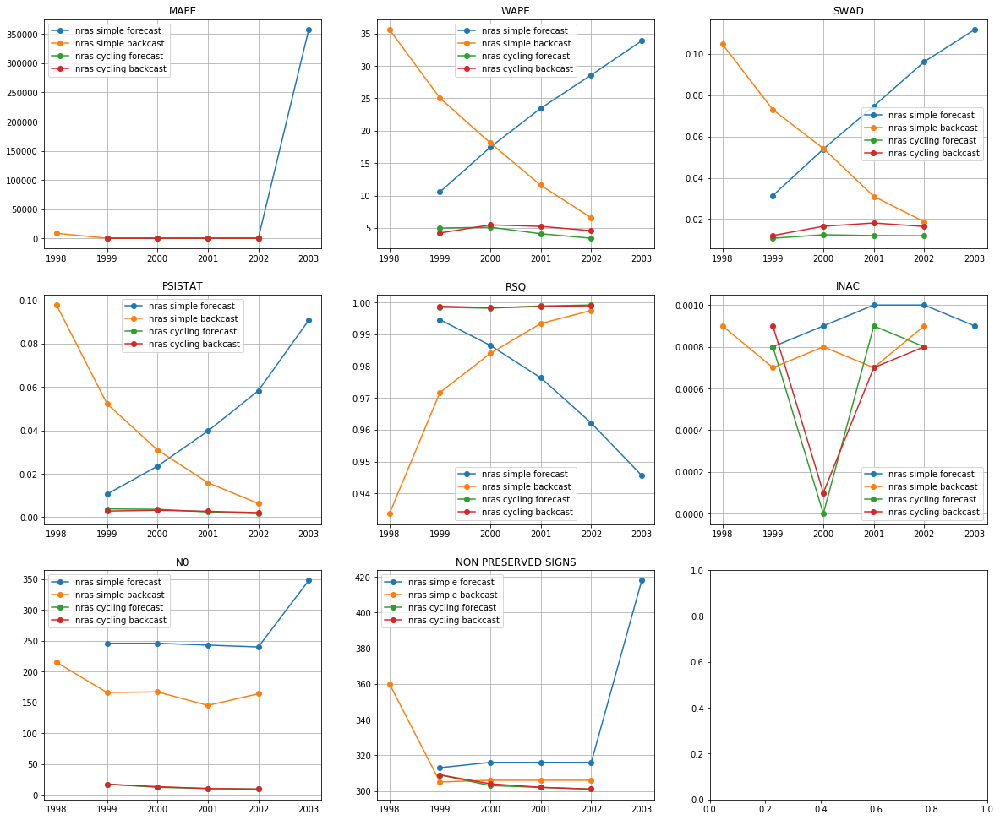

insd simple forecast
insd simple backcast
final cycle: 10
insd cycling forecast
final cycle: 10
insd cycling backcast


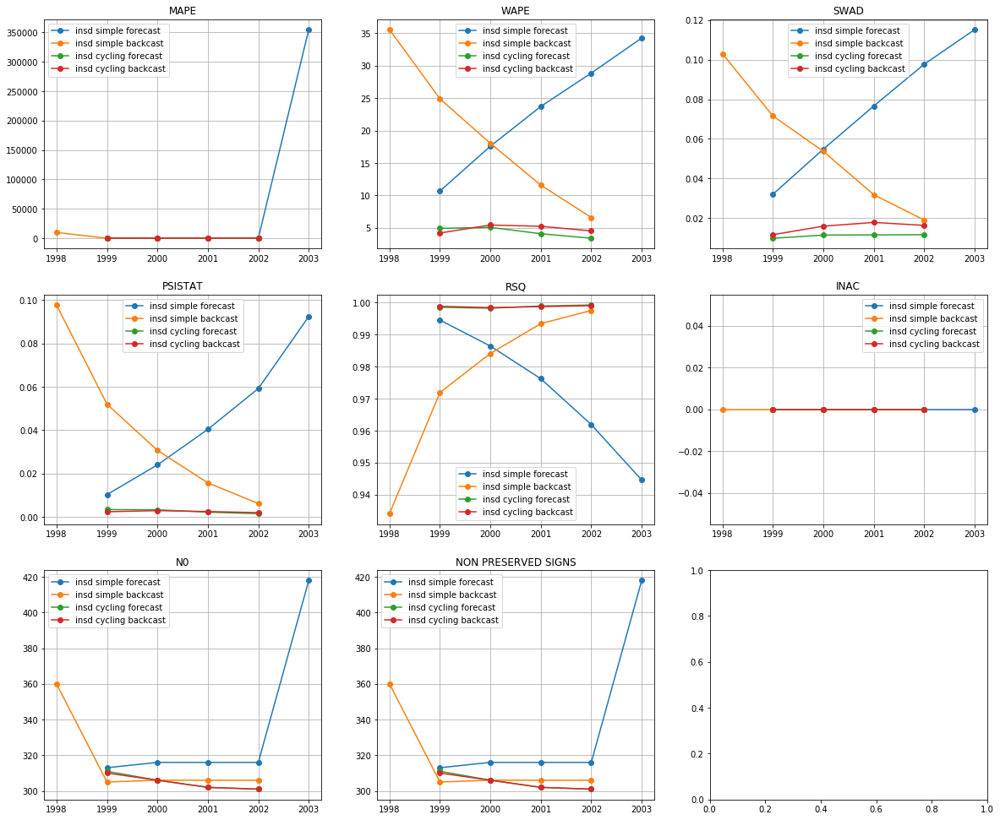

kuroda simple forecast
kuroda simple backcast
final cycle: 10
kuroda cycling forecast
final cycle: 10
kuroda cycling backcast


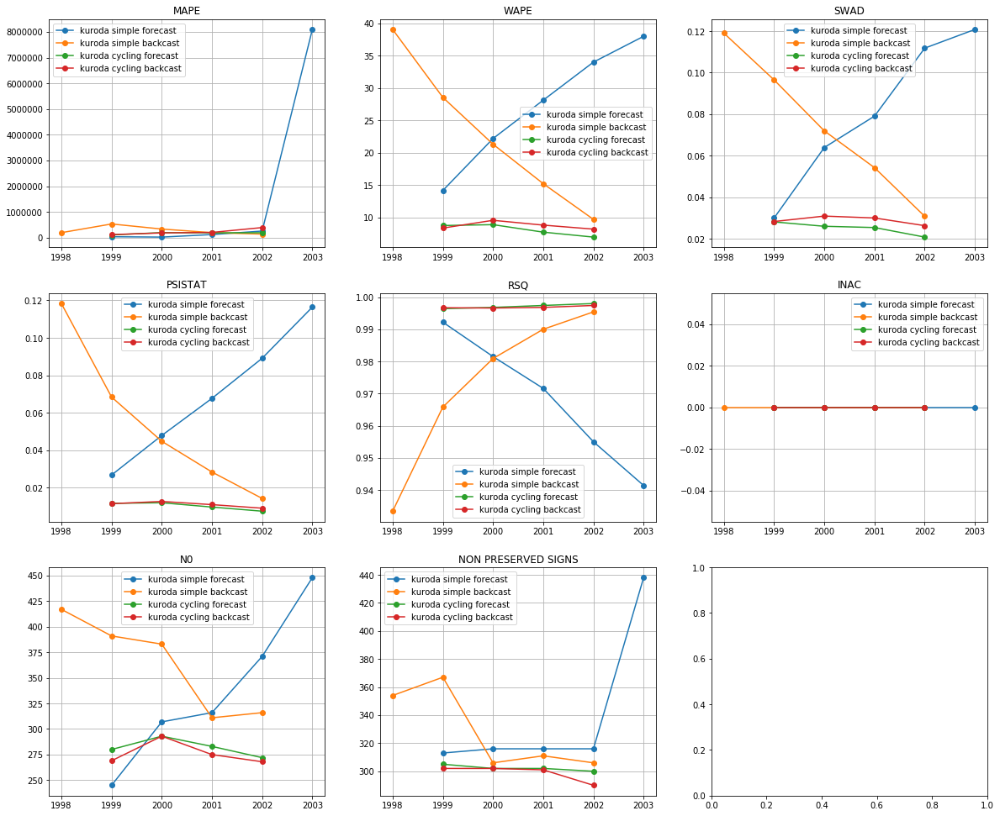

,MAPE,MAPE_R,WAPE,WAPE_R,SWAD,SWAD_R,PSISTAT,PSISTAT_R,RSQ,RSQ_R,INAC,INAC_R,N0,NON PRESERVED SIGNS,R_all,CmR
insd cycling forecast,1.243830e+01,1,4.389525,1,0.011075,1,0.002600,2,0.998700,3,0.000000,1,305.00,305.00,9,1
insd cycling backcast,1.525730e+01,3,4.868325,3,0.015400,3,0.002450,1,0.998725,1,0.000000,1,304.75,304.75,12,2
nras cycling forecast,1.309323e+01,2,4.405575,2,0.011750,2,0.002850,4,0.998700,3,0.000625,9,12.00,303.75,22,3
nras cycling backcast,1.600737e+01,4,4.880925,4,0.015750,4,0.002700,3,0.998725,1,0.000625,9,12.25,304.00,25,4
kuroda cycling forecast,1.680006e+05,9,8.090250,5,0.025175,5,0.010225,5,0.997150,5,0.000000,1,282.00,302.25,30,5
insd simple backcast,1.999465e+03,6,19.328340,7,0.055820,7,0.040460,7,0.976200,7,0.000000,1,316.60,316.60,35,6
kuroda cycling backcast,2.223494e+05,10,8.738850,6,0.028975,6,0.011075,6,0.996875,6,0.000000,1,276.25,298.75,35,6
nras simple backcast,1.729709e+03,5,19.377280,8,0.056320,8,0.040660,8,0.976040,8,0.000800,11,171.40,316.60,48,8
insd simple forecast,7.101786e+04,7,23.005340,11,0.075260,11,0.045260,10,0.972720,11,0.000000,1,335.80,335.80,51,9
kuroda simple backcast,2.765806e+05,11,22.760180,9,0.074540,10,0.054840,11,0.973100,9,0.000000,1,363.60,328.80,51,9


[2003 2004 2005 2006 2007 2008]
available mtypes: [0]
nras simple forecast
nras simple backcast
final cycle: 10
nras cycling forecast
final cycle: 10
nras cycling backcast


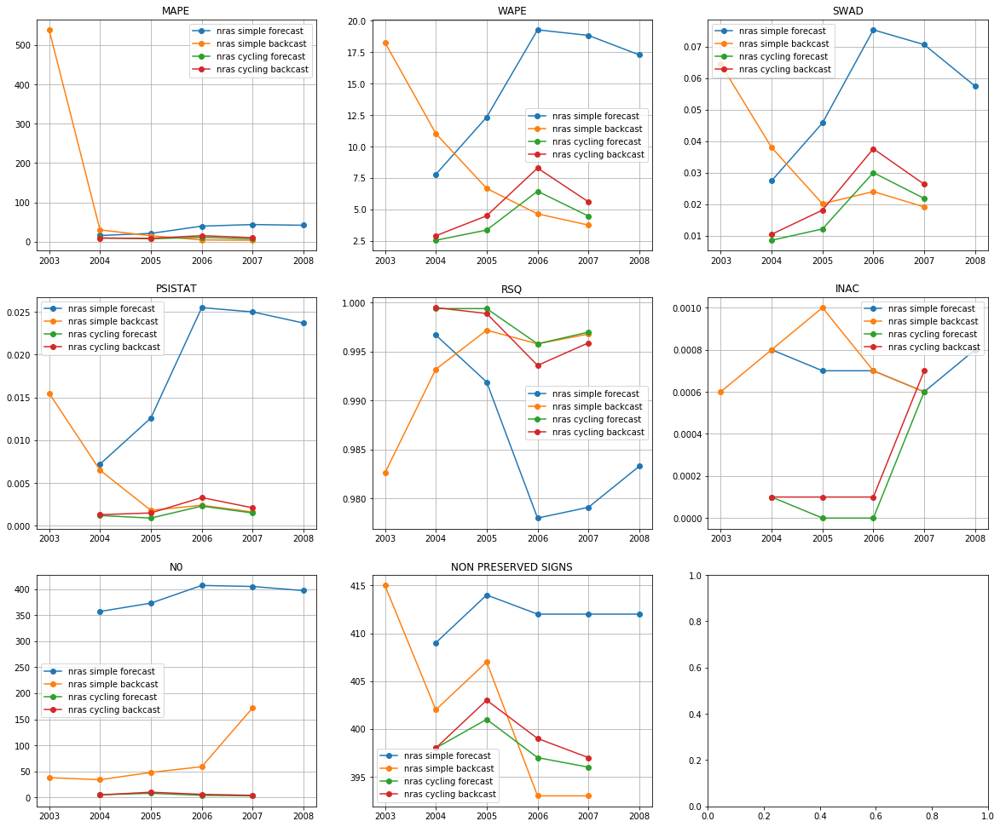

insd simple forecast
insd simple backcast
final cycle: 10
insd cycling forecast
final cycle: 10
insd cycling backcast


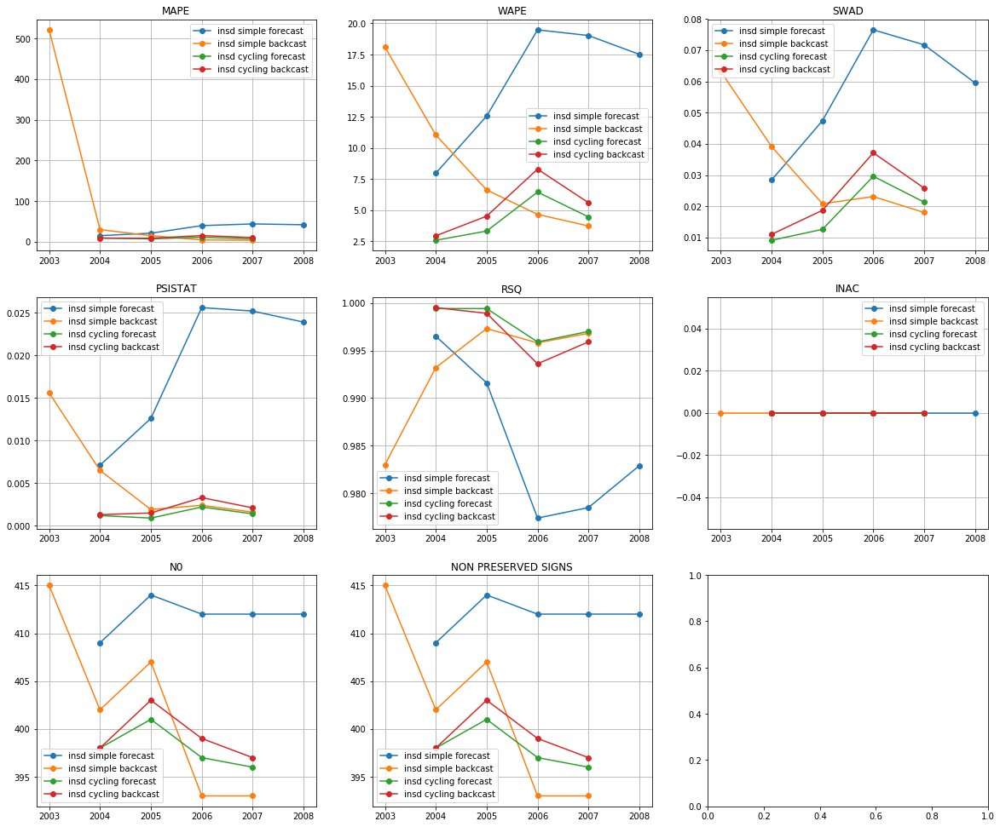

kuroda simple forecast
kuroda simple backcast
final cycle: 10
kuroda cycling forecast
final cycle: 10
kuroda cycling backcast


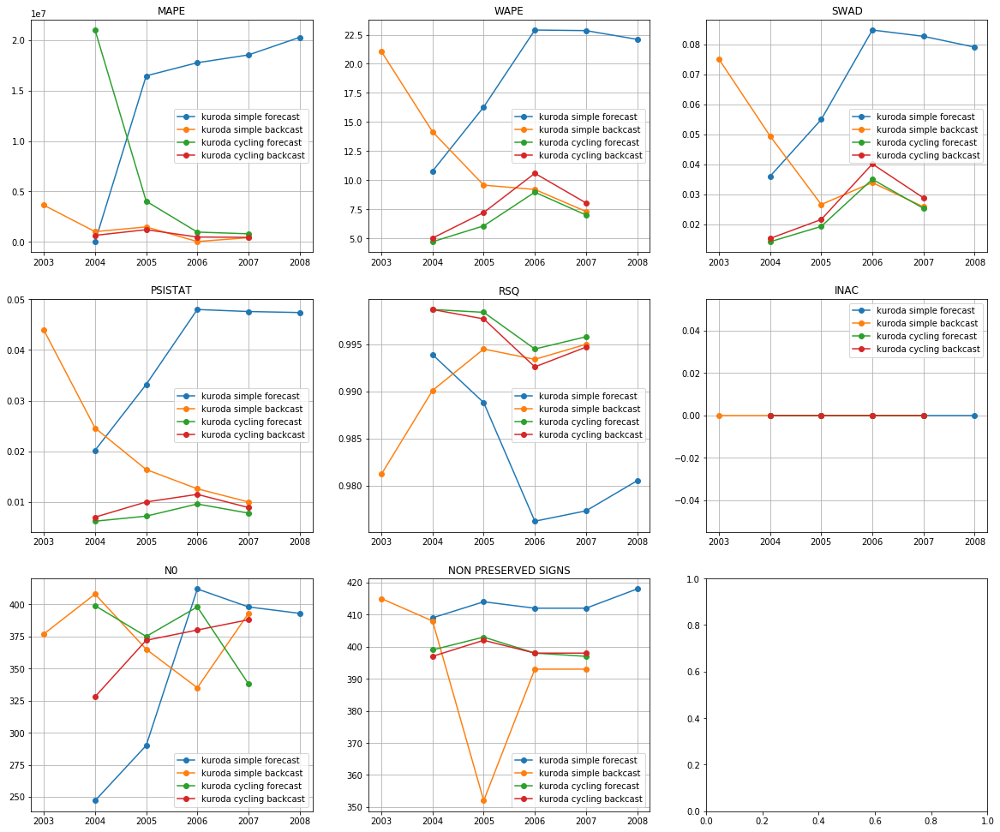

,MAPE,MAPE_R,WAPE,WAPE_R,SWAD,SWAD_R,PSISTAT,PSISTAT_R,RSQ,RSQ_R,INAC,INAC_R,N0,NON PRESERVED SIGNS,R_all,CmR
insd cycling forecast,8.634100e+00,1,4.212250,2,0.01815,2,0.001425,1,0.997925,1,0.000000,1,398.00,398.00,8,1
nras cycling forecast,8.682725e+00,2,4.210200,1,0.01810,1,0.001475,2,0.997900,2,0.000175,9,5.00,398.00,17,2
insd cycling backcast,1.078888e+01,3,5.345775,4,0.02315,4,0.002050,3,0.996975,3,0.000000,1,399.25,399.25,18,3
nras cycling backcast,1.079290e+01,4,5.326950,3,0.02310,3,0.002050,3,0.996975,3,0.000250,10,6.25,399.25,26,4
kuroda cycling forecast,6.699250e+06,11,6.689325,5,0.02345,5,0.007700,7,0.996850,5,0.000000,1,377.50,399.25,34,5
insd simple backcast,1.148252e+02,7,8.835680,7,0.03284,7,0.005600,6,0.993220,7,0.000000,1,402.00,402.00,35,6
kuroda cycling backcast,7.005130e+05,9,7.718850,6,0.02645,6,0.009350,8,0.995925,6,0.000000,1,367.00,398.75,36,7
nras simple backcast,1.183319e+02,8,8.876160,8,0.03314,8,0.005560,5,0.993120,8,0.000740,12,70.20,402.00,49,8
kuroda simple backcast,1.319775e+06,10,12.258520,9,0.04214,9,0.021500,11,0.990840,9,0.000000,1,375.60,392.20,49,8
insd simple forecast,3.229340e+01,6,15.309540,11,0.05670,11,0.018880,10,0.985380,11,0.000000,1,411.80,411.80,50,10


use basic I
[1998 1999 2000 2001 2002 2003]
available mtypes: [0]
nras simple forecast
nras simple backcast
final cycle: 10
nras cycling forecast
final cycle: 10
nras cycling backcast


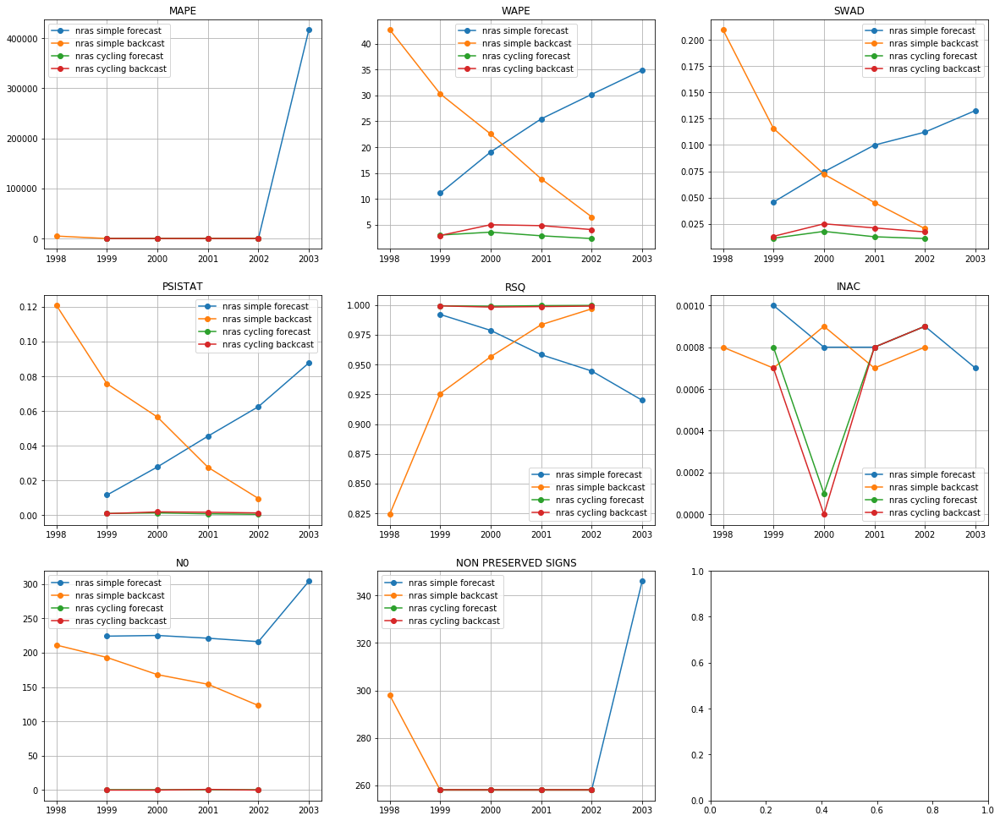

insd simple forecast
insd simple backcast
final cycle: 10
insd cycling forecast
final cycle: 10
insd cycling backcast


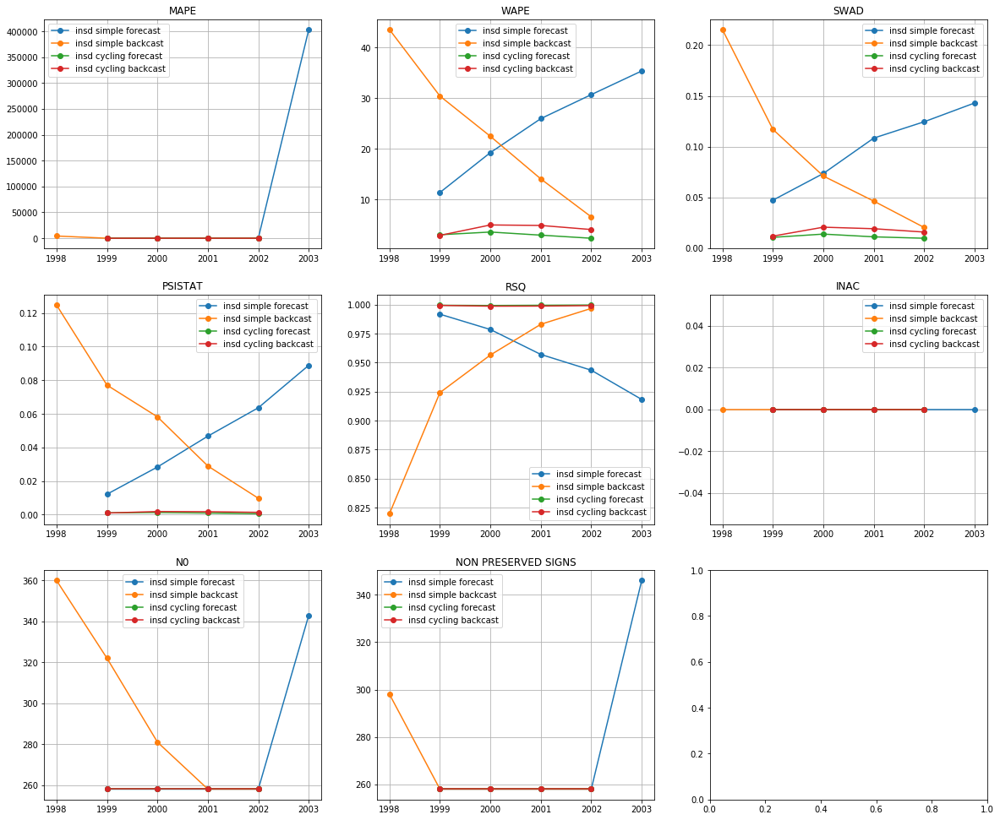

kuroda simple forecast
kuroda simple backcast
final cycle: 10
kuroda cycling forecast
final cycle: 10
kuroda cycling backcast


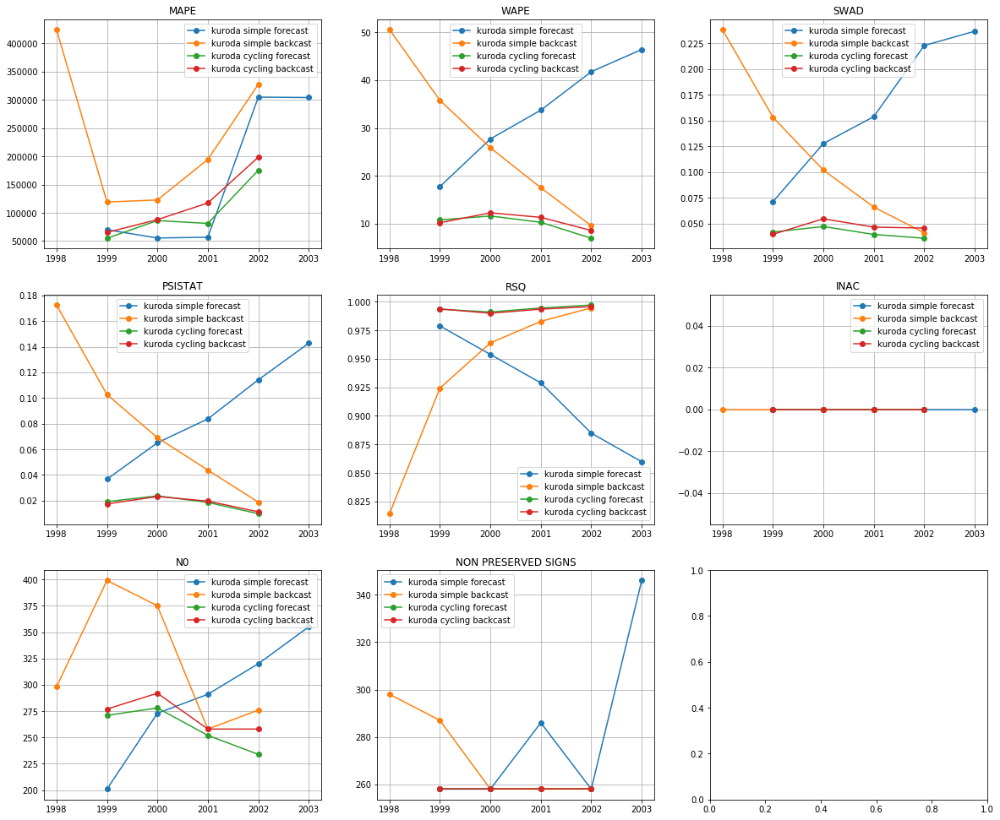

,MAPE,MAPE_R,WAPE,WAPE_R,SWAD,SWAD_R,PSISTAT,PSISTAT_R,RSQ,RSQ_R,INAC,INAC_R,N0,NON PRESERVED SIGNS,R_all,CmR
insd cycling forecast,7.804850,2,2.953350,2,0.011300,1,0.000900,1,0.999500,1,0.00000,1,258.00,258.0,8,1
insd cycling backcast,11.700175,3,4.180850,3,0.016825,3,0.001425,3,0.999025,3,0.00000,1,258.00,258.0,16,2
nras cycling forecast,7.766550,1,2.942850,1,0.013300,2,0.000900,2,0.999400,2,0.00065,10,0.00,258.0,18,3
nras cycling backcast,11.899500,4,4.203250,4,0.019225,4,0.001450,4,0.998850,4,0.00060,9,0.25,258.0,29,4
kuroda cycling forecast,99543.195500,9,9.904075,5,0.040875,5,0.017825,5,0.994000,5,0.00000,1,258.75,258.0,30,5
kuroda cycling backcast,117366.188800,10,10.587600,6,0.046450,6,0.017875,6,0.993200,6,0.00000,1,271.25,258.0,35,6
insd simple backcast,902.147700,5,23.405560,8,0.093980,9,0.059740,10,0.936100,10,0.00000,1,295.80,266.0,43,7
insd simple forecast,80716.292980,7,24.528440,10,0.099320,10,0.047920,8,0.957860,8,0.00000,1,275.00,275.6,44,8
nras simple backcast,1029.370560,6,23.191760,7,0.092700,7,0.058040,9,0.937340,9,0.00078,11,169.80,266.0,49,9
nras simple forecast,83507.607360,8,24.141700,9,0.093000,8,0.047020,7,0.958740,7,0.00084,12,238.00,275.6,51,10


[2003 2004 2005 2006 2007 2008]
available mtypes: [0]
nras simple forecast
nras simple backcast
final cycle: 10
nras cycling forecast
final cycle: 10
nras cycling backcast


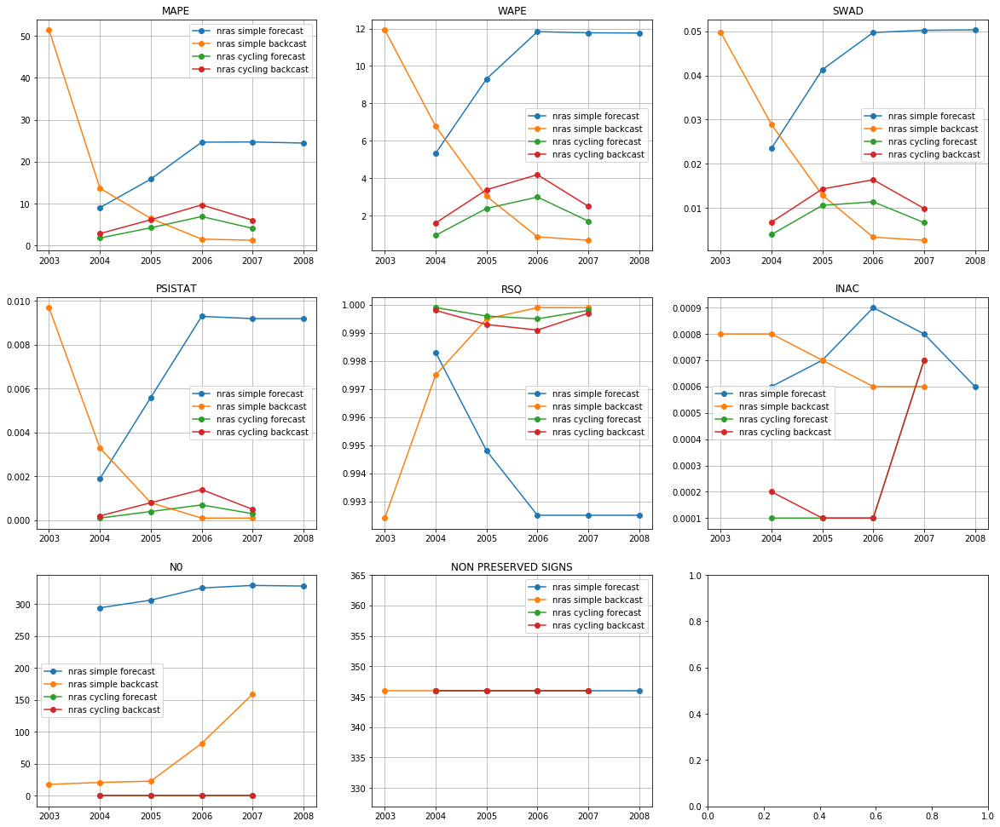

insd simple forecast
insd simple backcast
final cycle: 10
insd cycling forecast
final cycle: 10
insd cycling backcast


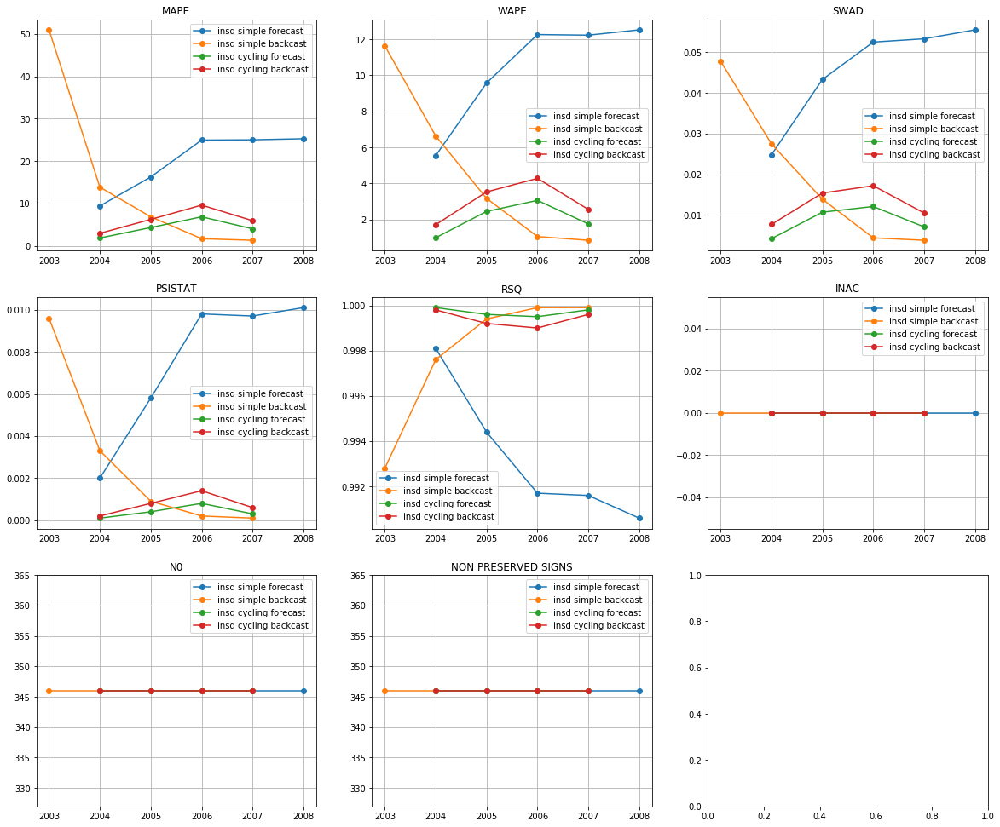

kuroda simple forecast
kuroda simple backcast
final cycle: 10
kuroda cycling forecast
final cycle: 10
kuroda cycling backcast


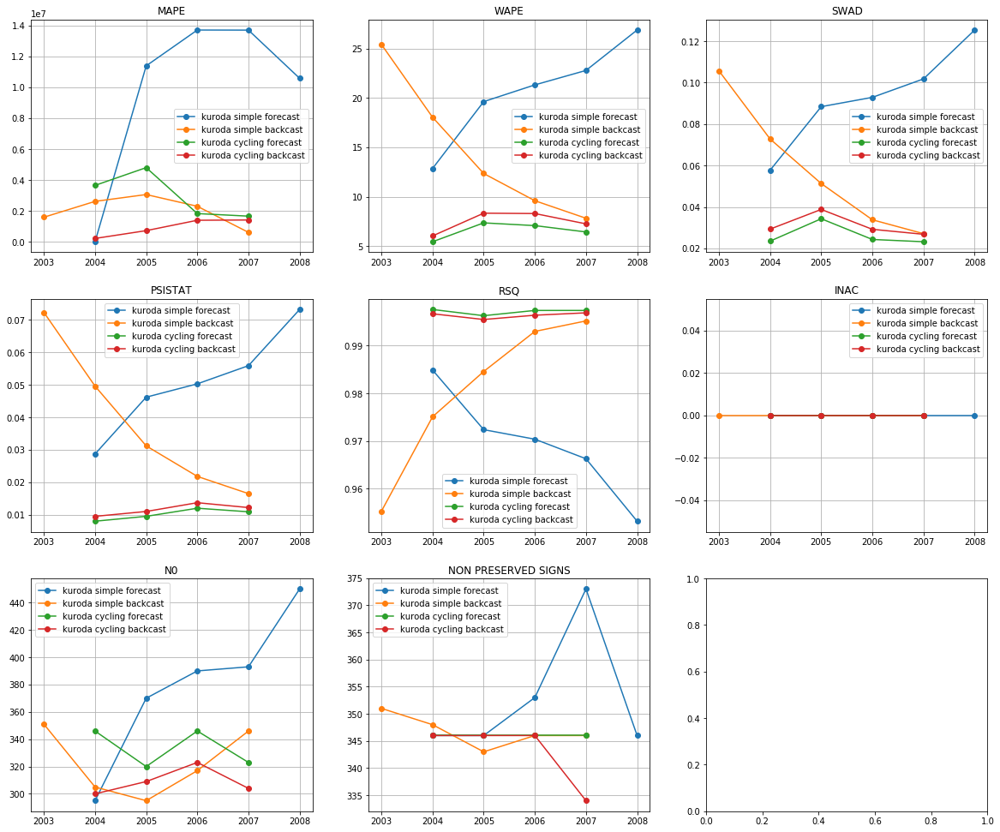

,MAPE,MAPE_R,WAPE,WAPE_R,SWAD,SWAD_R,PSISTAT,PSISTAT_R,RSQ,RSQ_R,INAC,INAC_R,N0,NON PRESERVED SIGNS,R_all,CmR
insd cycling forecast,4.265025e+00,1,2.056675,2,0.008525,2,0.000400,2,0.999700,1,0.000000,1,346.00,346.0,9,1
nras cycling forecast,4.291700e+00,2,2.002075,1,0.008175,1,0.000375,1,0.999700,1,0.000250,9,0.00,346.0,15,2
insd cycling backcast,6.189375e+00,3,3.015925,4,0.012700,4,0.000750,4,0.999400,4,0.000000,1,346.00,346.0,20,3
nras cycling backcast,6.213775e+00,4,2.914775,3,0.011850,3,0.000725,3,0.999475,3,0.000275,10,0.00,346.0,26,4
insd simple backcast,1.492726e+01,6,4.664780,6,0.019480,5,0.002820,6,0.997920,5,0.000000,1,346.00,346.0,29,5
nras simple backcast,1.490156e+01,5,4.653340,5,0.019540,6,0.002800,5,0.997840,6,0.000700,11,60.60,346.0,38,6
kuroda cycling forecast,2.984255e+06,11,6.579925,7,0.026325,7,0.010100,9,0.997175,7,0.000000,1,333.75,346.0,42,7
kuroda cycling backcast,9.354961e+05,9,7.482575,8,0.031025,8,0.011600,10,0.996375,8,0.000000,1,309.00,343.0,44,8
insd simple forecast,2.017684e+01,8,10.426480,10,0.045880,10,0.007480,8,0.993280,10,0.000000,1,346.00,346.0,47,9
nras simple forecast,1.976260e+01,7,10.004100,9,0.043000,9,0.007040,7,0.994120,9,0.000720,12,316.40,346.0,53,10


use purchase I+II
[1998 1999 2000 2001 2002 2003]
available mtypes: [0]
nras simple forecast
nras simple backcast
final cycle: 10
nras cycling forecast
final cycle: 10
nras cycling backcast


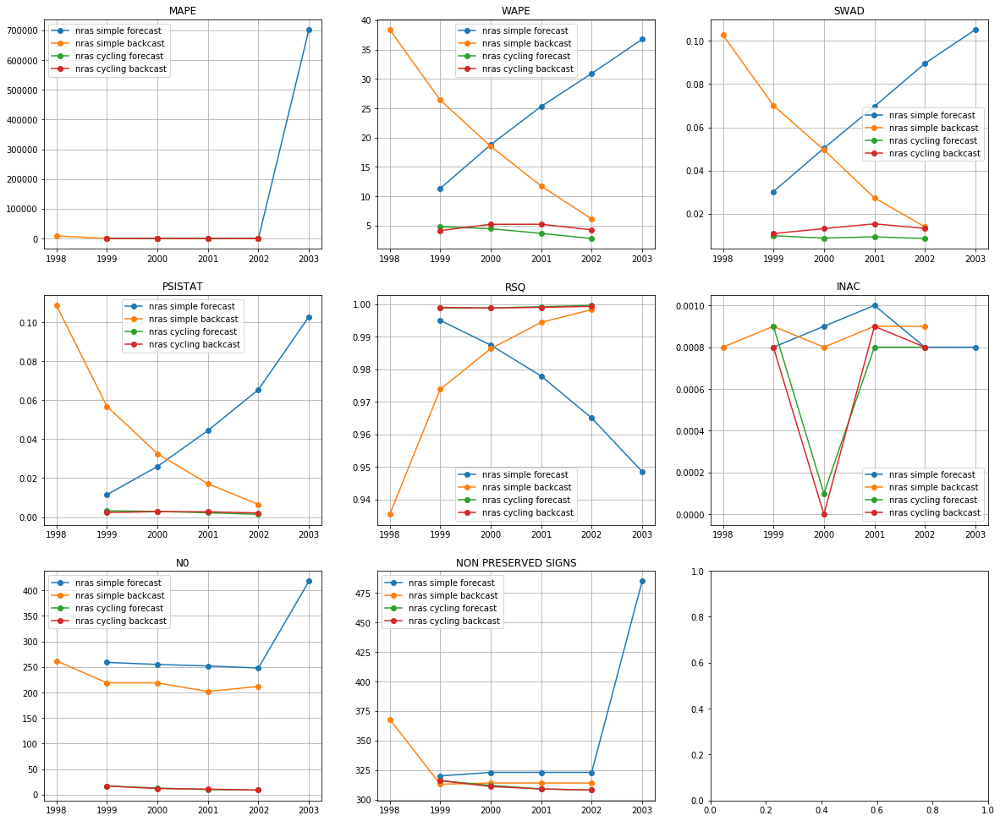

insd simple forecast
insd simple backcast
final cycle: 10
insd cycling forecast
final cycle: 10
insd cycling backcast


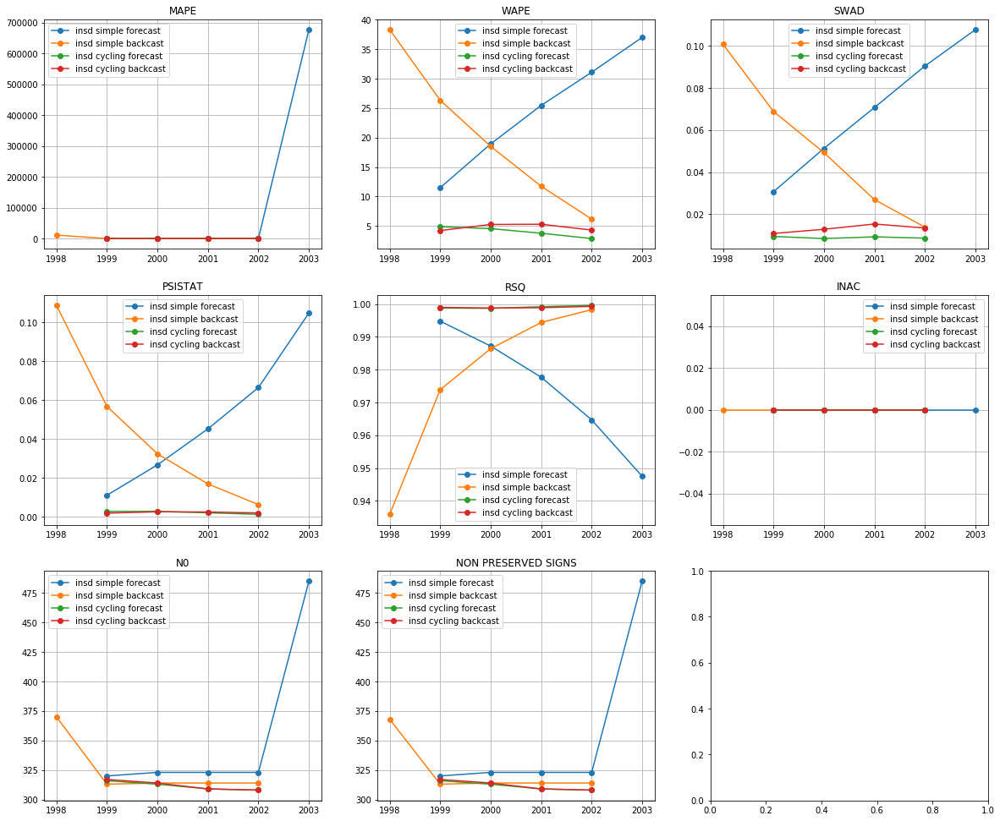

kuroda simple forecast
kuroda simple backcast
final cycle: 10
kuroda cycling forecast
final cycle: 10
kuroda cycling backcast


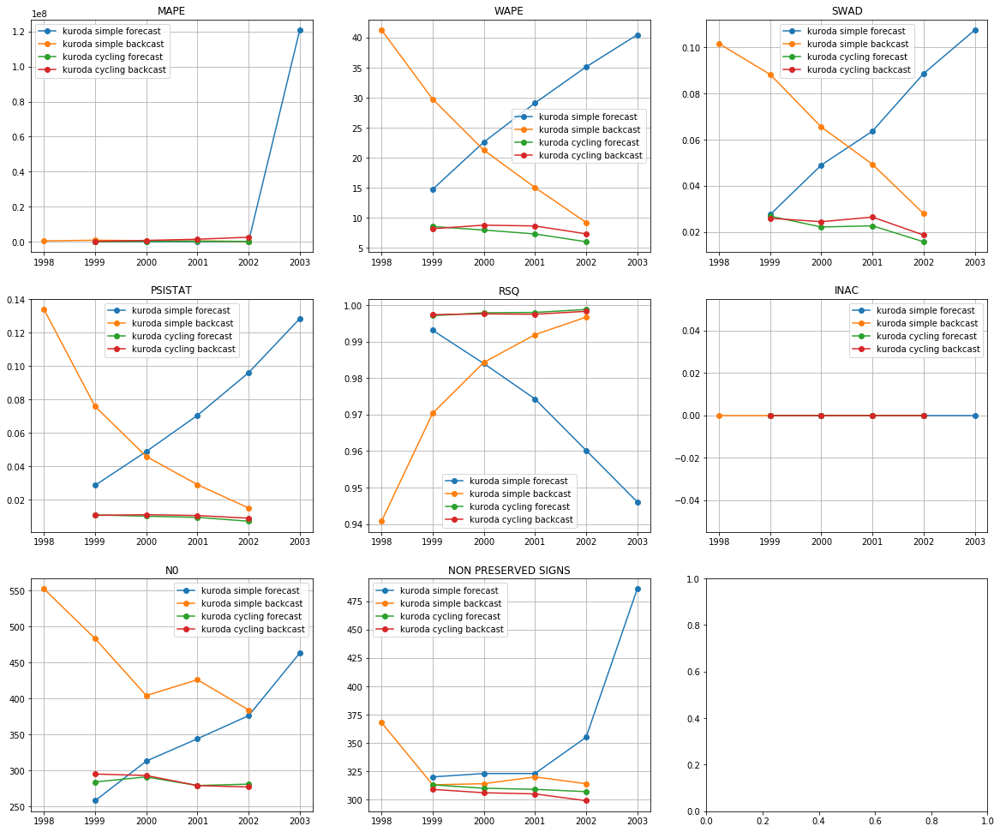

,MAPE,MAPE_R,WAPE,WAPE_R,SWAD,SWAD_R,PSISTAT,PSISTAT_R,RSQ,RSQ_R,INAC,INAC_R,N0,NON PRESERVED SIGNS,R_all,CmR
insd cycling forecast,1.280537e+01,1,4.023075,2,0.009000,1,0.002250,2,0.999075,2,0.000000,1,311.50,311.50,9,1
insd cycling backcast,1.584060e+01,3,4.777100,4,0.013175,3,0.002250,1,0.999000,4,0.000000,1,312.00,312.00,16,2
nras cycling forecast,1.314018e+01,2,3.949125,1,0.009175,2,0.002425,3,0.999100,1,0.000650,10,12.25,311.25,19,3
nras cycling backcast,1.623252e+01,4,4.728475,3,0.013200,4,0.002475,4,0.999025,3,0.000625,9,12.25,311.00,27,4
kuroda cycling forecast,3.130718e+05,9,7.459550,5,0.021800,5,0.009575,5,0.997950,5,0.000000,1,283.75,309.75,30,5
insd simple backcast,2.270223e+03,6,20.223260,7,0.051980,7,0.044180,7,0.977780,7,0.000000,1,325.00,324.60,35,6
kuroda cycling backcast,1.369032e+06,11,8.231850,6,0.023825,6,0.010450,6,0.997700,6,0.000000,1,286.00,304.75,36,7
nras simple backcast,1.859849e+03,5,20.244460,8,0.052720,8,0.044380,8,0.977640,8,0.000860,11,222.80,324.60,48,8
kuroda simple backcast,6.167052e+05,10,23.317120,9,0.066540,9,0.060040,11,0.976820,9,0.000000,1,449.80,325.80,49,9
insd simple forecast,1.355588e+05,7,24.797580,11,0.070160,12,0.050820,10,0.974380,11,0.000000,1,354.80,354.80,52,10


[2003 2004 2005 2006 2007 2008]
available mtypes: [0]
nras simple forecast
nras simple backcast
final cycle: 10
nras cycling forecast
final cycle: 10
nras cycling backcast


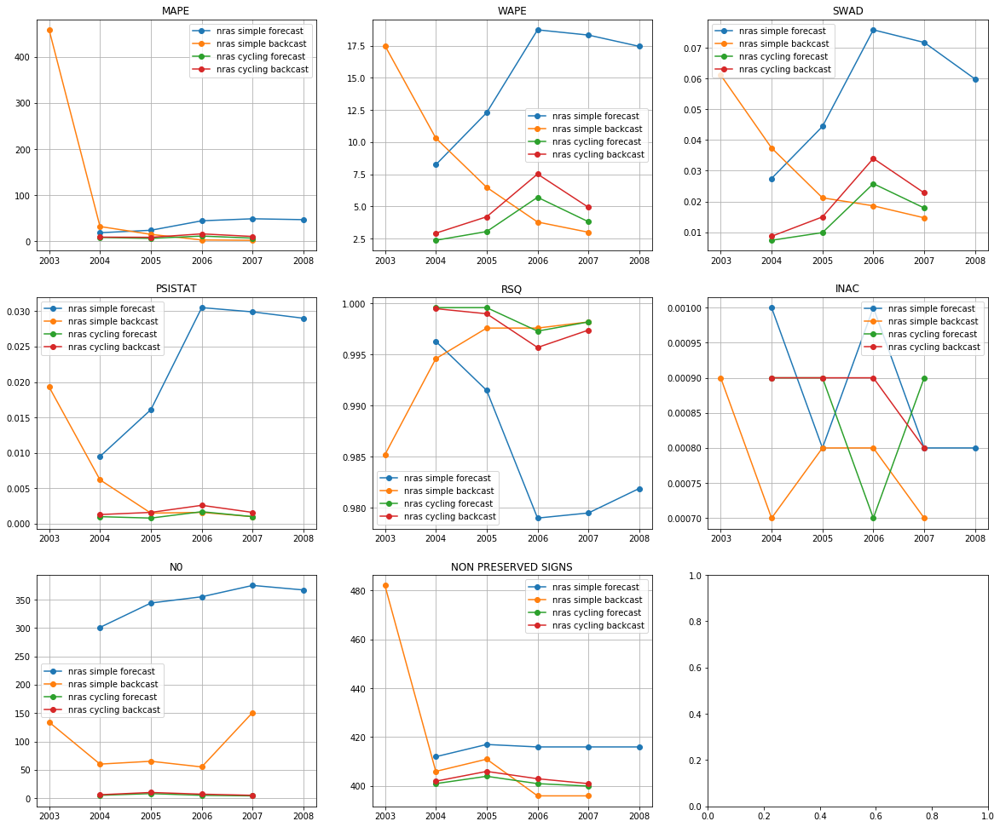

insd simple forecast
insd simple backcast
final cycle: 10
insd cycling forecast
final cycle: 10
insd cycling backcast


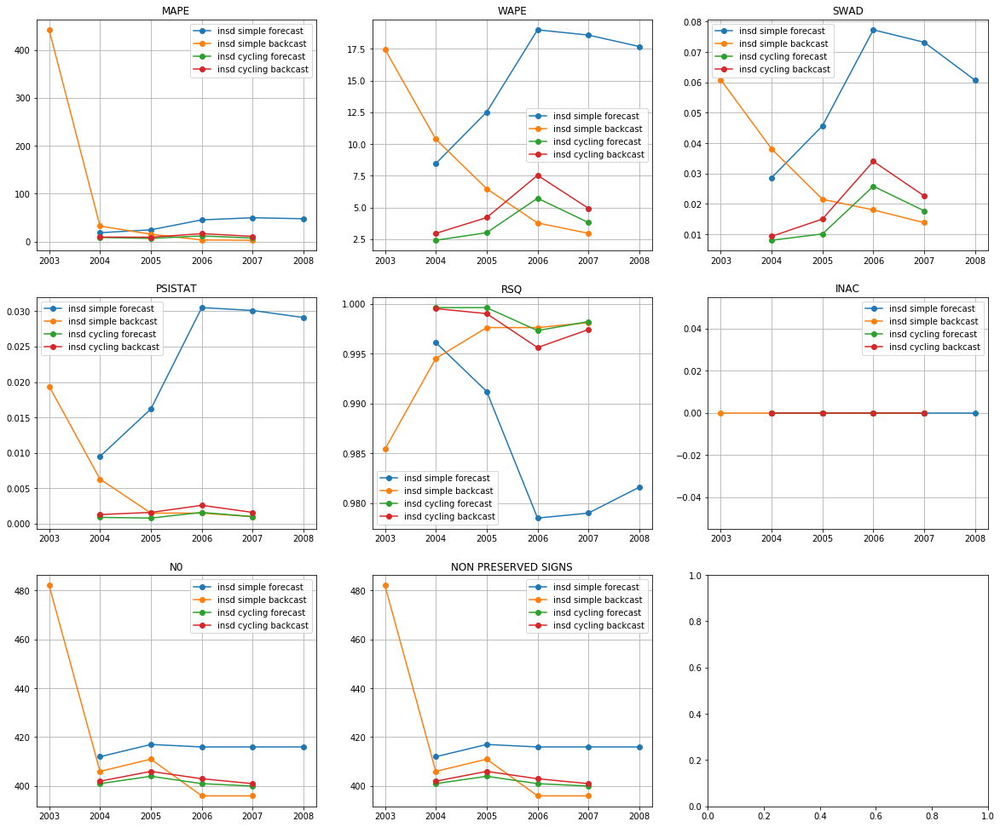

kuroda simple forecast
kuroda simple backcast
final cycle: 10
kuroda cycling forecast
final cycle: 10
kuroda cycling backcast


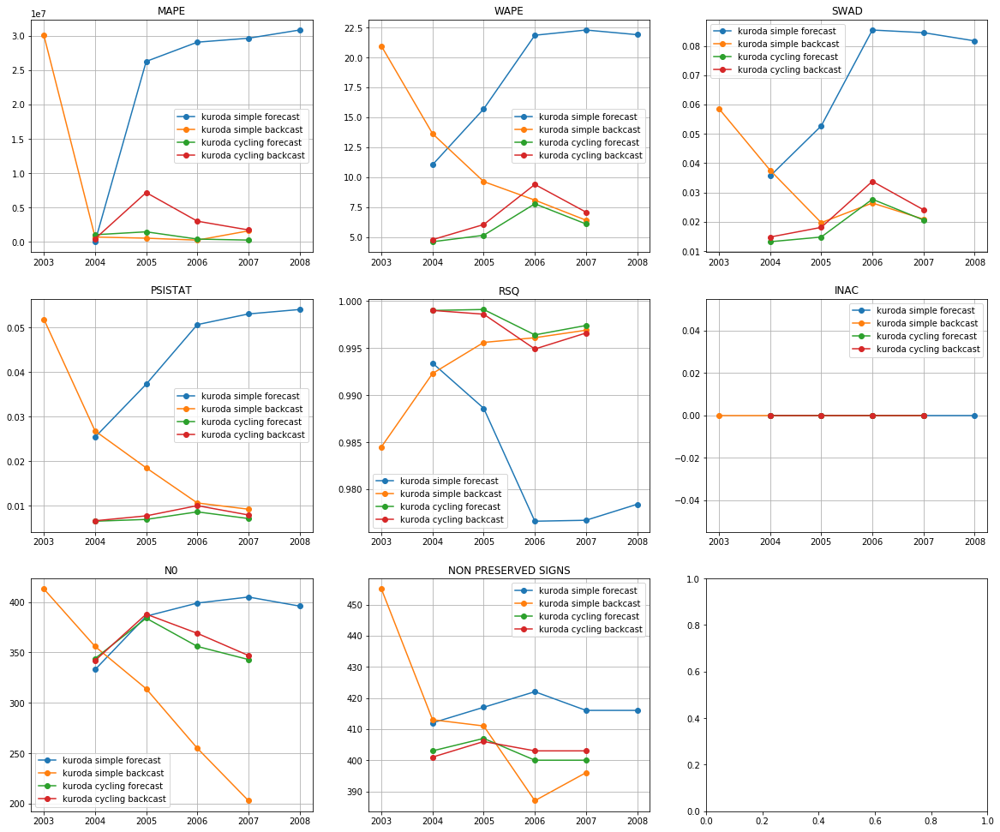

,MAPE,MAPE_R,WAPE,WAPE_R,SWAD,SWAD_R,PSISTAT,PSISTAT_R,RSQ,RSQ_R,INAC,INAC_R,N0,NON PRESERVED SIGNS,R_all,CmR
insd cycling forecast,8.540925e+00,2,3.743125,2,0.015400,2,0.001075,1,0.998675,1,0.000000,1,401.50,401.50,9,1
nras cycling forecast,8.528050e+00,1,3.732925,1,0.015250,1,0.001125,2,0.998675,1,0.000850,10,5.50,401.50,16,2
insd cycling backcast,1.141995e+01,4,4.909150,4,0.020225,5,0.001775,3,0.997875,5,0.000000,1,403.00,403.00,22,3
nras cycling backcast,1.137068e+01,3,4.890350,3,0.020125,4,0.001775,3,0.997900,4,0.000875,11,7.00,403.00,28,4
kuroda cycling forecast,7.959832e+05,9,5.901050,5,0.019075,3,0.007275,7,0.997975,3,0.000000,1,356.75,402.50,28,4
insd simple backcast,9.911006e+01,7,8.215600,7,0.030460,7,0.005940,6,0.994640,7,0.000000,1,418.20,418.20,35,6
kuroda cycling backcast,3.096823e+06,10,6.820200,6,0.022700,6,0.008050,8,0.997275,6,0.000000,1,361.50,403.25,37,7
nras simple backcast,1.023943e+02,8,8.217580,8,0.030600,8,0.005920,5,0.994640,7,0.000780,9,93.00,418.20,45,8
insd simple forecast,3.709180e+01,6,15.249580,11,0.057100,11,0.023080,10,0.985280,11,0.000000,1,415.40,415.40,50,9
kuroda simple backcast,6.633539e+06,11,11.735860,9,0.032640,9,0.023400,11,0.993080,9,0.000000,1,308.20,412.40,50,9


use purchase I
[1998 1999 2000 2001 2002 2003]
available mtypes: [0]
nras simple forecast
nras simple backcast
final cycle: 10
nras cycling forecast
final cycle: 10
nras cycling backcast


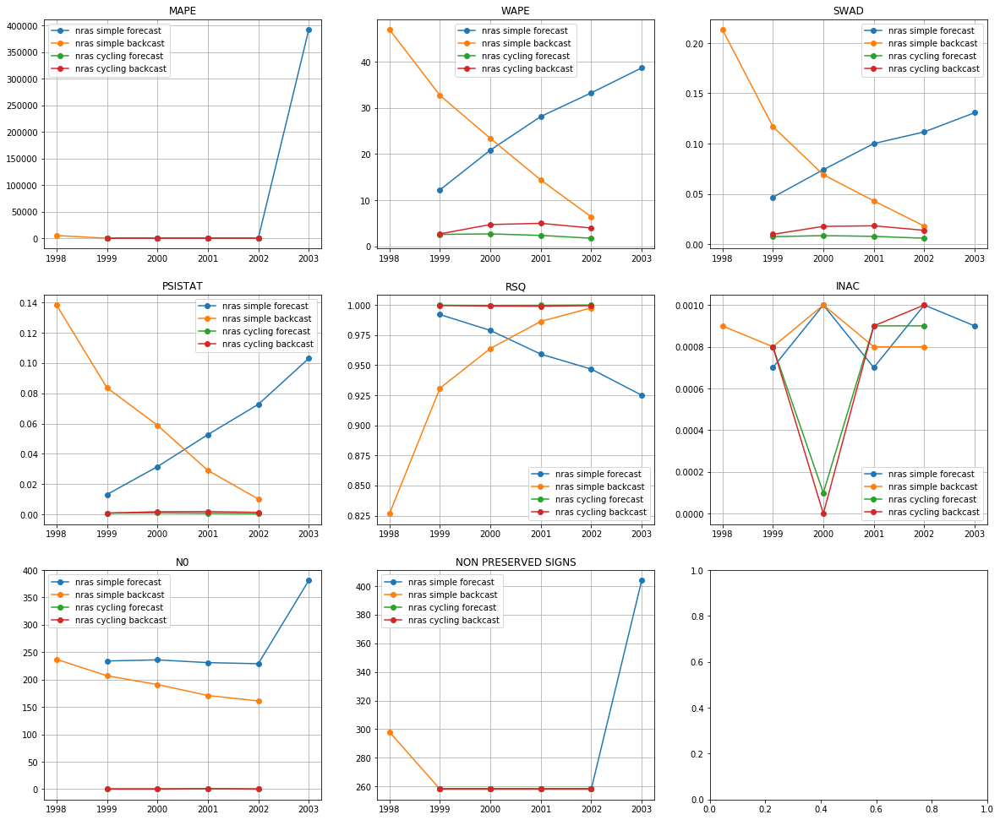

insd simple forecast
insd simple backcast
final cycle: 10
insd cycling forecast
final cycle: 10
insd cycling backcast


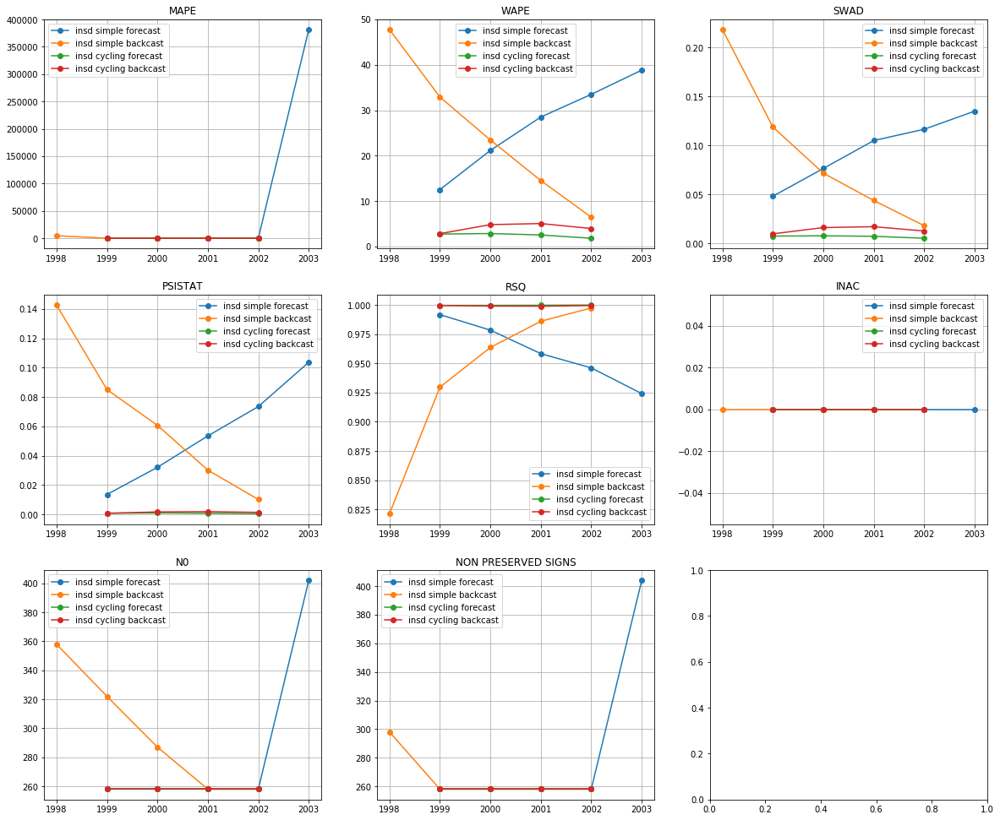

kuroda simple forecast
kuroda simple backcast
final cycle: 10
kuroda cycling forecast
final cycle: 10
kuroda cycling backcast


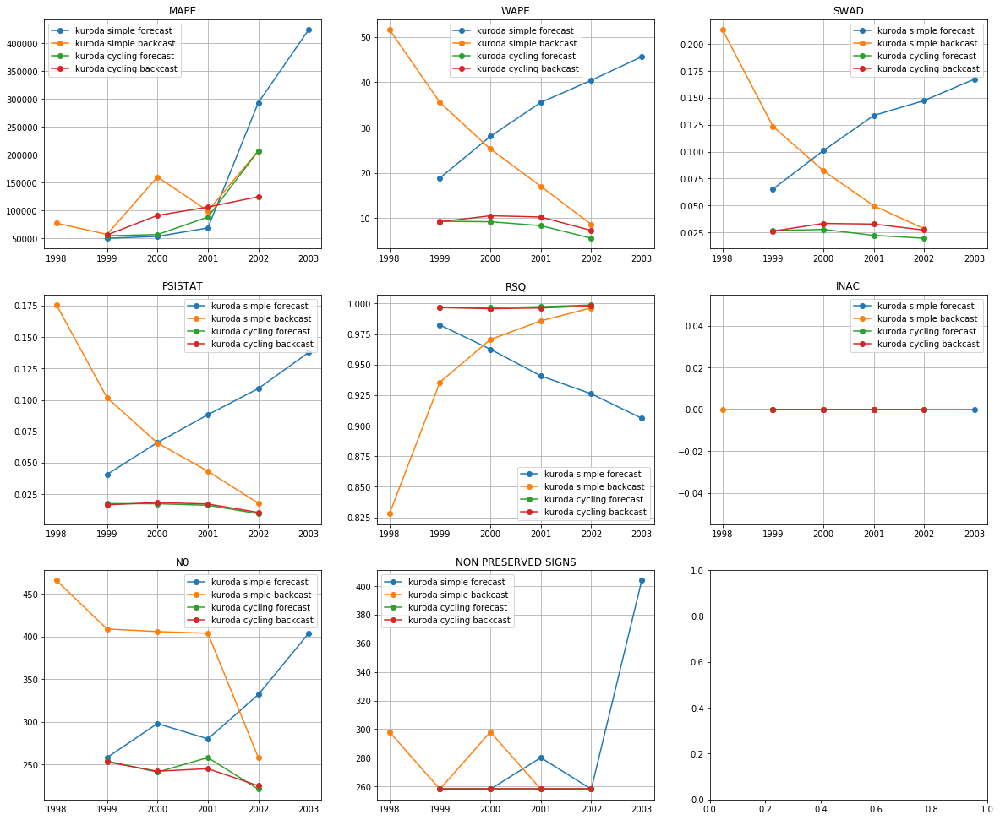

,MAPE,MAPE_R,WAPE,WAPE_R,SWAD,SWAD_R,PSISTAT,PSISTAT_R,RSQ,RSQ_R,INAC,INAC_R,N0,NON PRESERVED SIGNS,R_all,CmR
insd cycling forecast,8.258375,2,2.489100,2,0.006875,1,0.000775,2,0.999700,2,0.000000,1,258.00,258.0,10,1
nras cycling forecast,8.156700,1,2.355575,1,0.007325,2,0.000700,1,0.999725,1,0.000675,9,0.00,258.0,15,2
insd cycling backcast,12.304600,3,4.165925,4,0.013850,3,0.001450,4,0.999200,4,0.000000,1,258.00,258.0,19,3
nras cycling backcast,12.365675,4,4.097925,3,0.014800,4,0.001400,3,0.999225,3,0.000675,9,0.25,258.0,26,4
kuroda cycling forecast,101548.789125,10,8.103025,5,0.023900,5,0.015050,5,0.997400,5,0.000000,1,243.50,258.0,31,5
kuroda cycling backcast,94410.145075,9,9.309325,6,0.029700,6,0.015550,6,0.996725,6,0.000000,1,241.25,258.0,34,6
insd simple forecast,76359.601560,7,26.899980,10,0.096140,10,0.055280,8,0.959720,8,0.000000,1,286.80,287.2,44,7
insd simple backcast,961.367940,5,25.015820,8,0.094020,9,0.065780,10,0.939580,12,0.000000,1,296.60,266.0,45,8
nras simple forecast,78495.878540,8,26.617360,9,0.092580,8,0.054620,7,0.960320,7,0.000860,11,262.20,287.2,50,9
nras simple backcast,1056.754000,6,24.755380,7,0.092040,7,0.064020,9,0.941000,11,0.000860,11,193.40,266.0,51,10


[2003 2004 2005 2006 2007 2008]
available mtypes: [0]
nras simple forecast
nras simple backcast
final cycle: 10
nras cycling forecast
final cycle: 10
nras cycling backcast


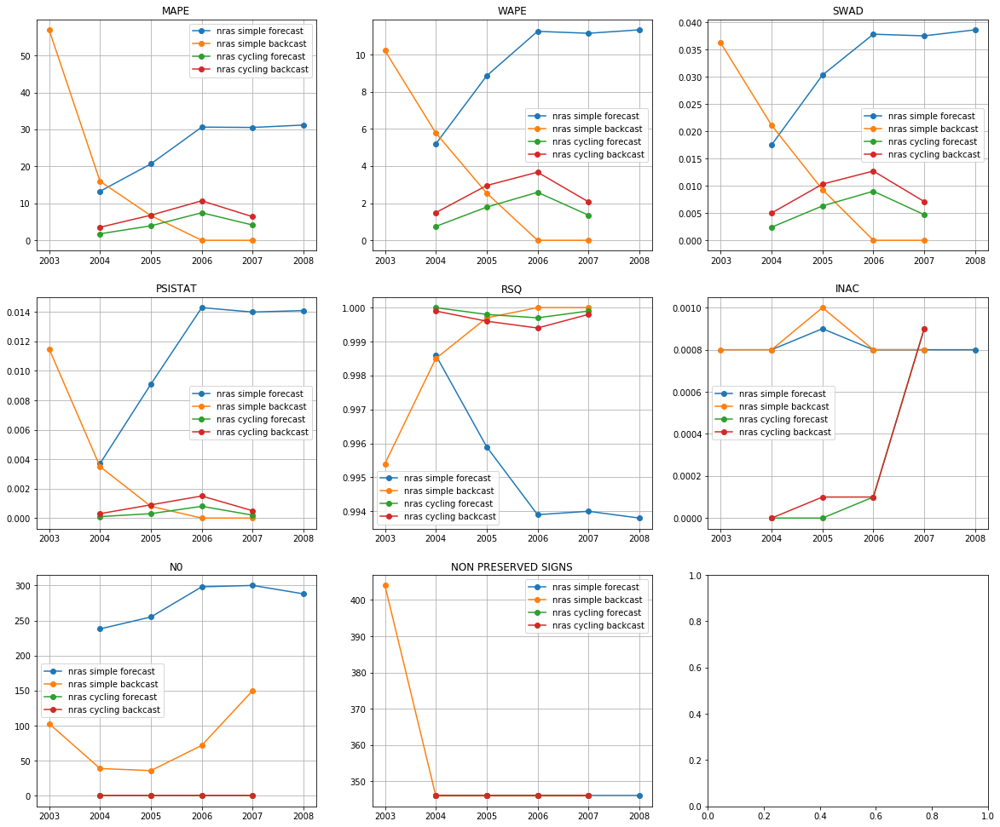

insd simple forecast
insd simple backcast
final cycle: 10
insd cycling forecast
final cycle: 10
insd cycling backcast


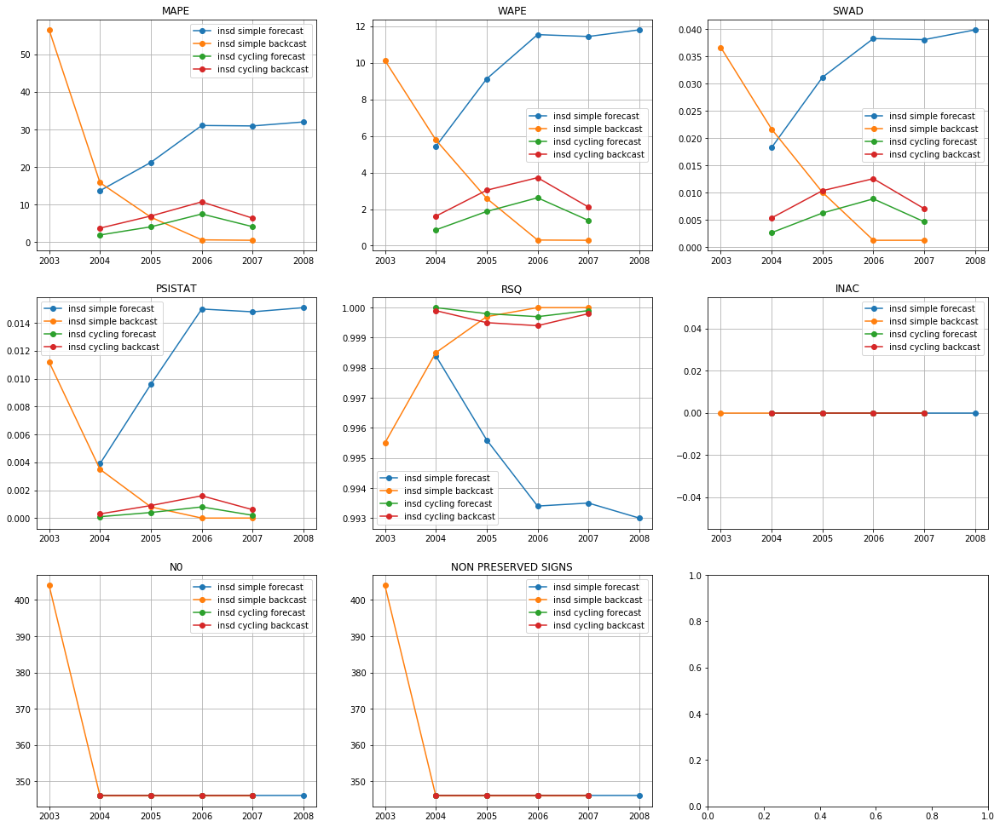

kuroda simple forecast
kuroda simple backcast
final cycle: 10
kuroda cycling forecast
final cycle: 10
kuroda cycling backcast


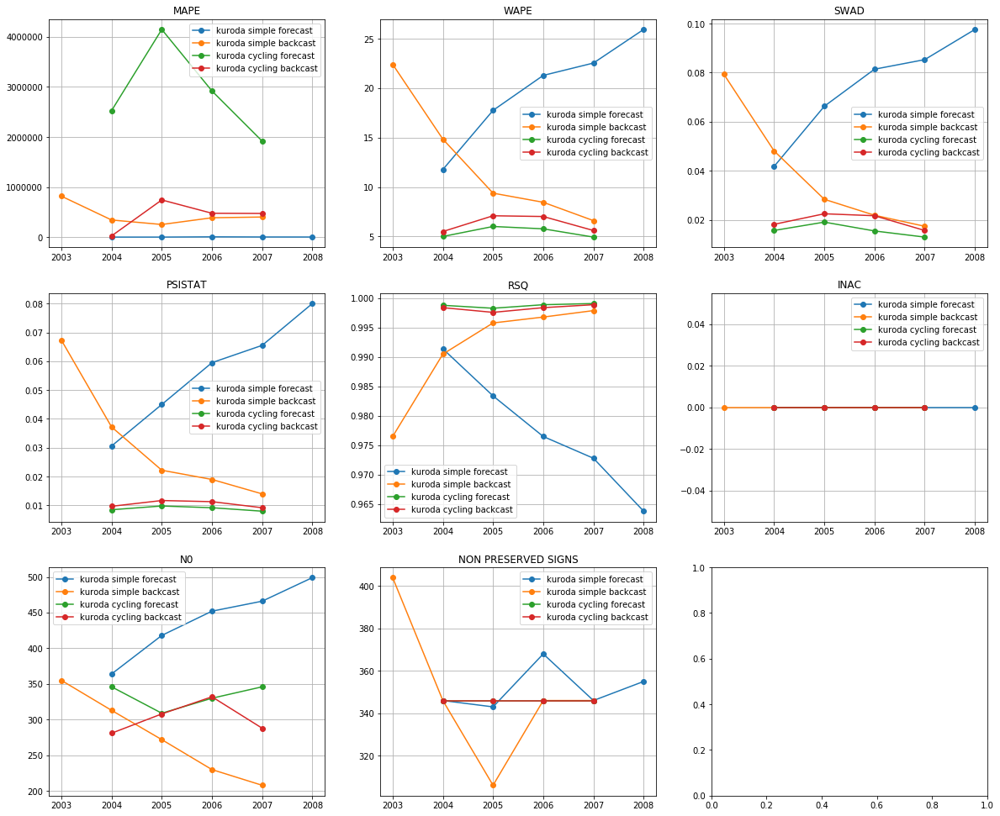

,MAPE,MAPE_R,WAPE,WAPE_R,SWAD,SWAD_R,PSISTAT,PSISTAT_R,RSQ,RSQ_R,INAC,INAC_R,N0,NON PRESERVED SIGNS,R_all,CmR
insd cycling forecast,4.432150e+00,2,1.685300,2,0.005650,2,0.000375,2,0.999850,1,0.000000,1,346.00,346.0,10,1
nras cycling forecast,4.312925e+00,1,1.617925,1,0.005600,1,0.000350,1,0.999850,1,0.000250,9,0.00,346.0,14,2
insd cycling backcast,6.979750e+00,4,2.620525,4,0.008875,4,0.000850,4,0.999650,4,0.000000,1,346.00,346.0,21,3
nras cycling backcast,6.844450e+00,3,2.544525,3,0.008775,3,0.000800,3,0.999675,3,0.000275,10,0.00,346.0,25,4
insd simple backcast,1.604572e+01,6,3.823140,6,0.014220,6,0.003100,5,0.998740,6,0.000000,1,357.60,357.6,30,5
kuroda cycling forecast,2.878072e+06,12,5.430175,7,0.015825,7,0.008875,7,0.998775,5,0.000000,1,332.75,346.0,39,6
nras simple backcast,1.591812e+01,5,3.708400,5,0.013320,5,0.003160,6,0.998720,7,0.000840,12,80.00,357.6,40,7
kuroda cycling backcast,4.287700e+05,10,6.304100,8,0.019525,8,0.010475,8,0.998325,8,0.000000,1,302.25,346.0,43,8
insd simple forecast,2.580478e+01,8,9.867520,10,0.033160,10,0.011680,10,0.994780,10,0.000000,1,346.00,346.0,49,9
nras simple forecast,2.525494e+01,7,9.557500,9,0.032340,9,0.011040,9,0.995240,9,0.000820,11,275.80,346.0,54,10


sup I
[1998 1999 2000 2001 2002 2003]
available mtypes: [0]
nras simple forecast
nras simple backcast
final cycle: 10
nras cycling forecast
final cycle: 10
nras cycling backcast


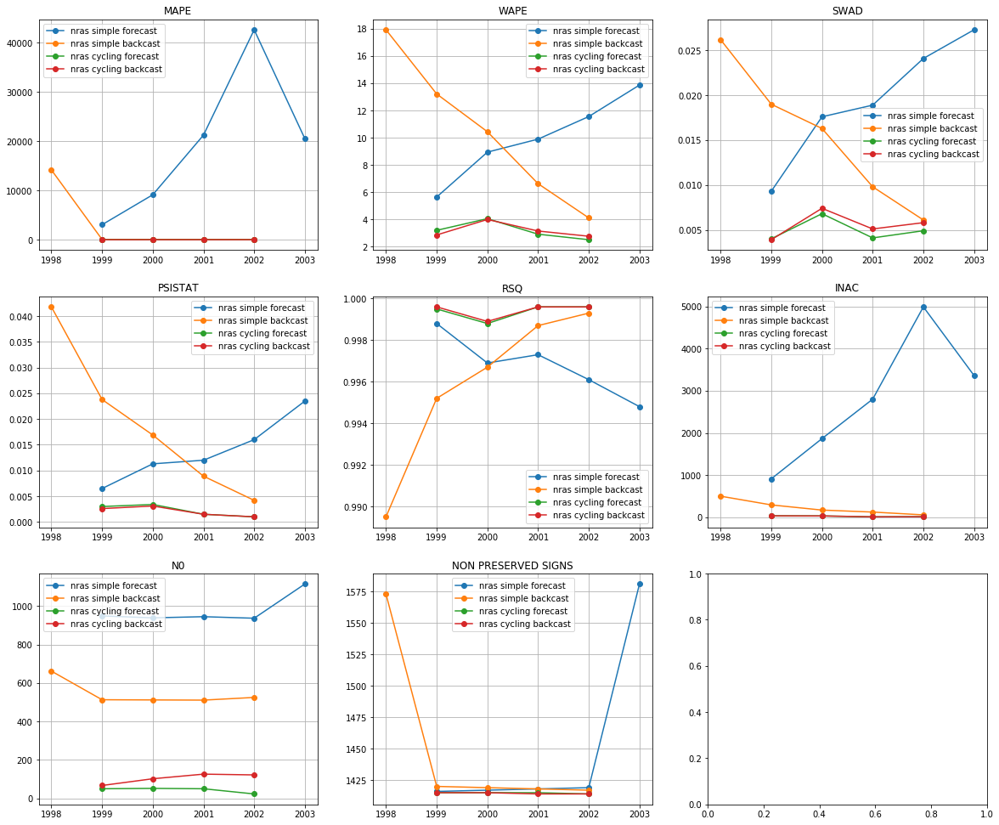

insd simple forecast
insd simple backcast
final cycle: 10
insd cycling forecast
final cycle: 10
insd cycling backcast


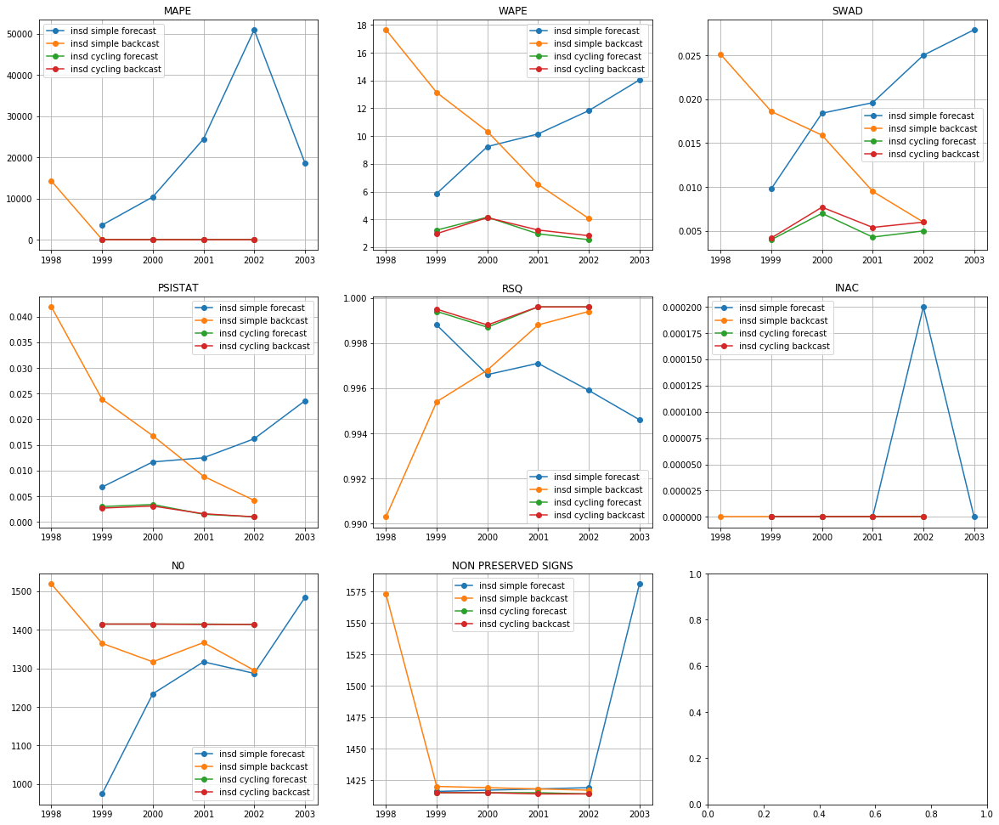

kuroda simple forecast
kuroda simple backcast
final cycle: 10
kuroda cycling forecast
final cycle: 10
kuroda cycling backcast


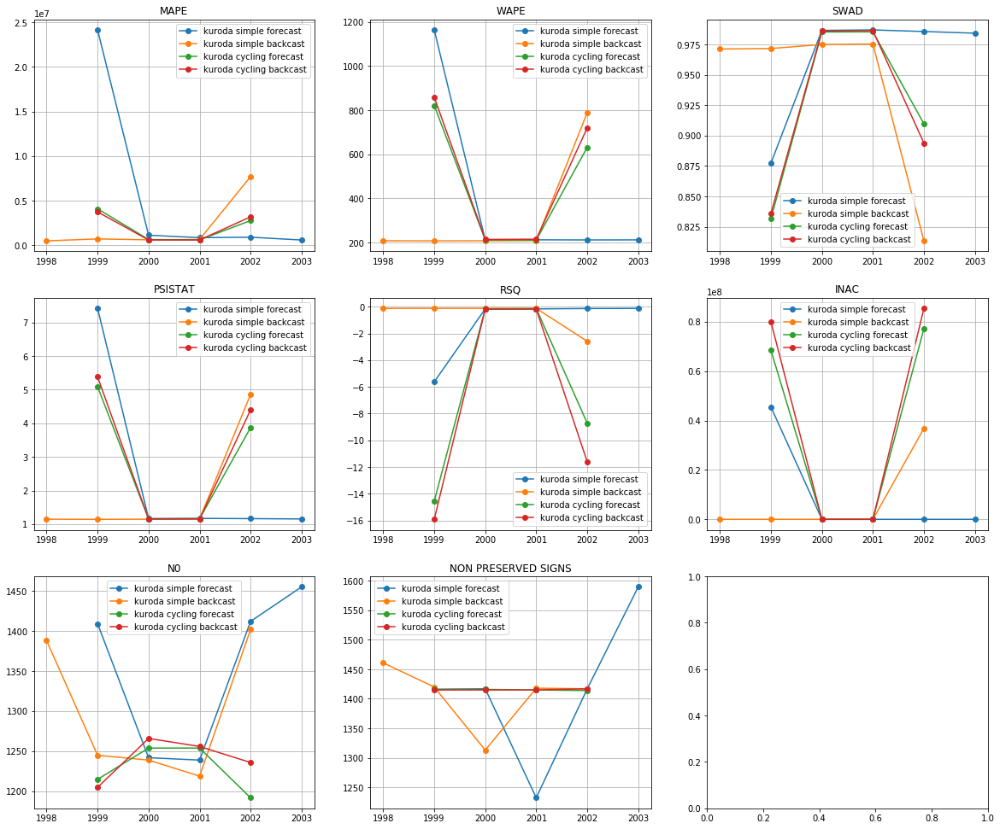

,MAPE,MAPE_R,WAPE,WAPE_R,SWAD,SWAD_R,PSISTAT,PSISTAT_R,RSQ,RSQ_R,INAC,INAC_R,N0,NON PRESERVED SIGNS,R_all,CmR
nras cycling forecast,5.717725e+00,2,3.172325,1,0.004950,1,0.002225,3,0.999375,2,1.947240e+01,5,43.75,1414.75,14,1
insd cycling forecast,5.568975e+00,1,3.221950,3,0.005075,2,0.002225,3,0.999325,4,0.000000e+00,1,1414.75,1414.75,14,1
insd cycling backcast,6.352675e+00,3,3.290150,4,0.005825,4,0.002100,2,0.999375,2,0.000000e+00,1,1414.50,1414.50,16,3
nras cycling backcast,6.524150e+00,4,3.194575,2,0.005550,3,0.002050,1,0.999425,1,1.948325e+01,6,104.25,1414.50,17,4
insd simple backcast,2.874057e+03,6,10.342520,7,0.015020,5,0.019140,8,0.996140,7,0.000000e+00,1,1372.60,1449.40,34,5
nras simple forecast,1.931319e+04,7,9.979400,5,0.019440,7,0.013860,5,0.996780,5,2.785664e+03,8,977.00,1450.20,37,6
insd simple forecast,2.162962e+04,8,10.226440,6,0.020140,8,0.014160,6,0.996600,6,4.000000e-05,4,1259.20,1450.20,38,7
nras simple backcast,2.859224e+03,5,10.462380,8,0.015480,6,0.019120,7,0.995880,8,2.261812e+02,7,544.60,1449.40,41,8
kuroda simple backcast,2.038988e+06,11,324.441380,9,0.941280,11,1.890480,9,-0.619000,9,7.369053e+06,9,1298.60,1405.80,58,9
kuroda cycling forecast,2.031557e+06,9,469.284525,11,0.927975,10,2.819050,11,-5.897250,11,3.643758e+07,11,1228.75,1415.25,63,10


[2003 2004 2005 2006 2007 2008]
available mtypes: [0]
nras simple forecast
nras simple backcast
final cycle: 10
nras cycling forecast
final cycle: 10
nras cycling backcast


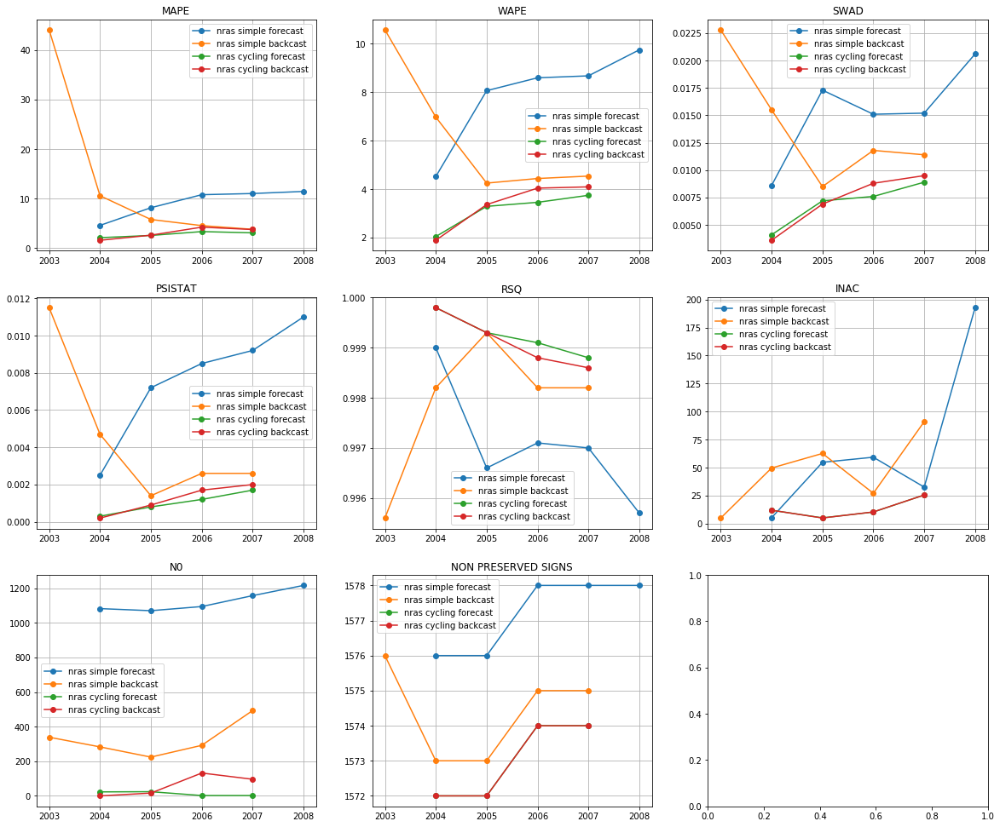

insd simple forecast
insd simple backcast
final cycle: 10
insd cycling forecast
final cycle: 10
insd cycling backcast


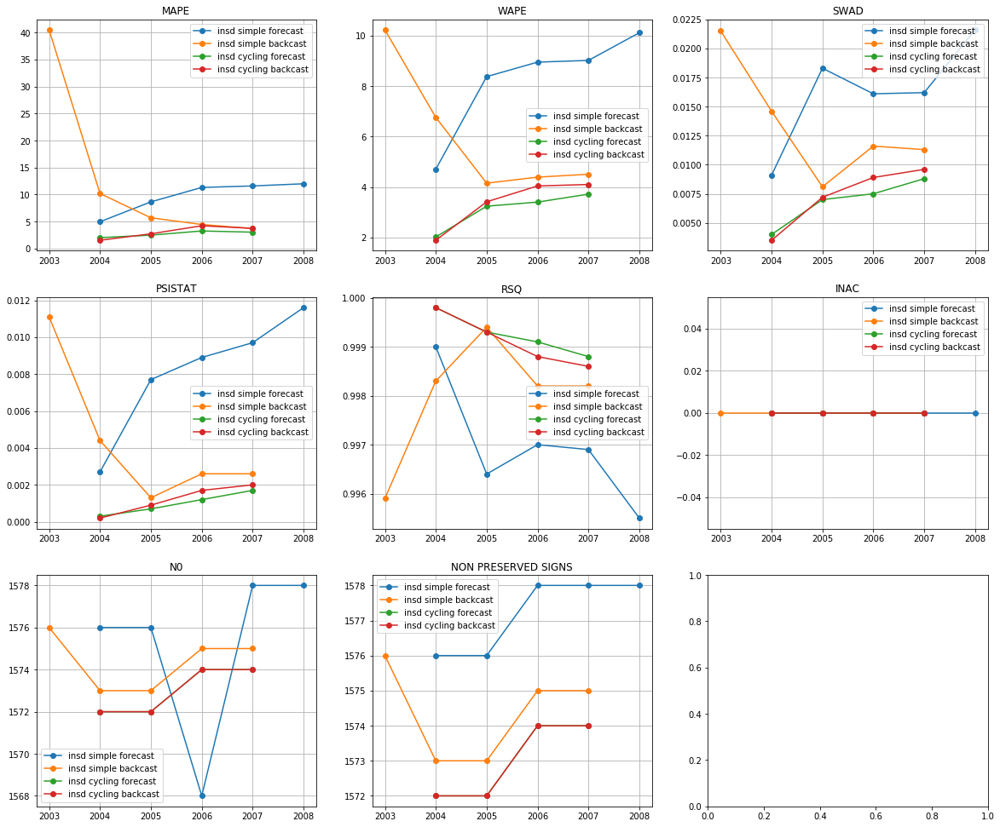

kuroda simple forecast
kuroda simple backcast
final cycle: 10
kuroda cycling forecast
final cycle: 10
kuroda cycling backcast


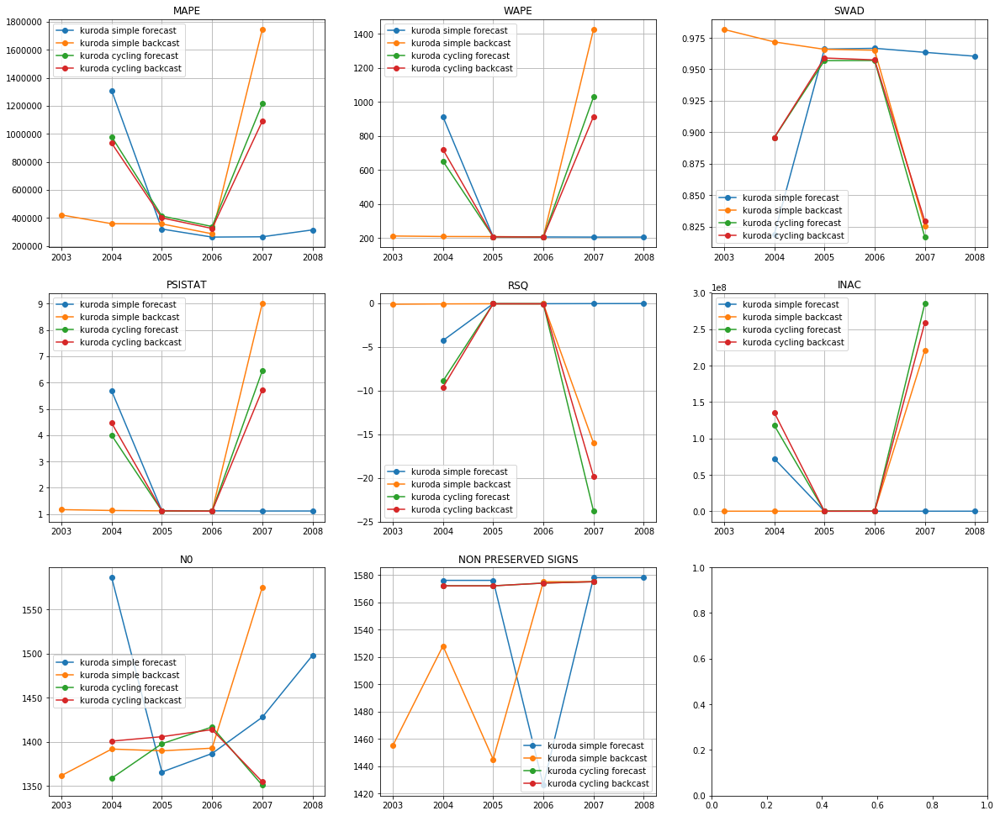

,MAPE,MAPE_R,WAPE,WAPE_R,SWAD,SWAD_R,PSISTAT,PSISTAT_R,RSQ,RSQ_R,INAC,INAC_R,N0,NON PRESERVED SIGNS,R_all,CmR
insd cycling forecast,2.706025,1,3.094650,1,0.006825,1,0.000975,1,0.999250,1,0.000000e+00,1,1573.00,1573.00,6,1
nras cycling forecast,2.793550,2,3.133250,2,0.006950,2,0.001000,2,0.999250,1,1.322380e+01,6,12.75,1573.00,15,2
insd cycling backcast,3.064625,3,3.360500,4,0.007300,4,0.001200,3,0.999125,3,0.000000e+00,1,1573.00,1573.00,18,3
nras cycling backcast,3.066350,4,3.347075,3,0.007200,3,0.001200,3,0.999125,3,1.322253e+01,5,61.00,1573.00,21,4
insd simple backcast,12.915900,7,6.005660,5,0.013420,5,0.004400,5,0.998000,5,0.000000e+00,1,1574.40,1574.40,28,5
nras simple backcast,13.771680,8,6.155320,6,0.014000,6,0.004560,6,0.997900,6,4.704500e+01,7,326.20,1574.40,39,6
insd simple forecast,9.709300,6,8.229980,8,0.016260,8,0.008120,8,0.996960,8,0.000000e+00,1,1575.20,1577.20,39,6
nras simple forecast,9.217960,5,7.920980,7,0.015360,7,0.007680,7,0.997080,7,6.890832e+01,8,1123.80,1577.20,41,8
kuroda simple forecast,494411.500260,9,347.002540,9,0.935060,11,2.034680,9,-0.905460,9,1.445805e+07,9,1453.00,1546.80,56,9
kuroda simple backcast,633845.571700,10,451.824580,10,0.942000,12,2.710740,10,-3.275540,10,4.426433e+07,10,1422.40,1515.60,62,10


iot
[1998 1999 2000 2001 2002 2003 2008]
available mtypes: [0]
0 LinearRegression(copy_X=True, fit_intercept=True, n_jobs=1, normalize=False) False
using mtt 0
mtt0 ridge backcast
0 Ridge(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=None,
   normalize=False, random_state=None, solver='auto', tol=0.001) False
using mtt 0
mtt0 ridge backcast
0 Lasso(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=1000,
   normalize=False, positive=False, precompute=False, random_state=None,
   selection='cyclic', tol=0.0001, warm_start=False) False
using mtt 0
mtt0 ridge backcast
nras simple forecast
nras simple backcast
final cycle: 10
nras cycling forecast
final cycle: 10
nras cycling backcast


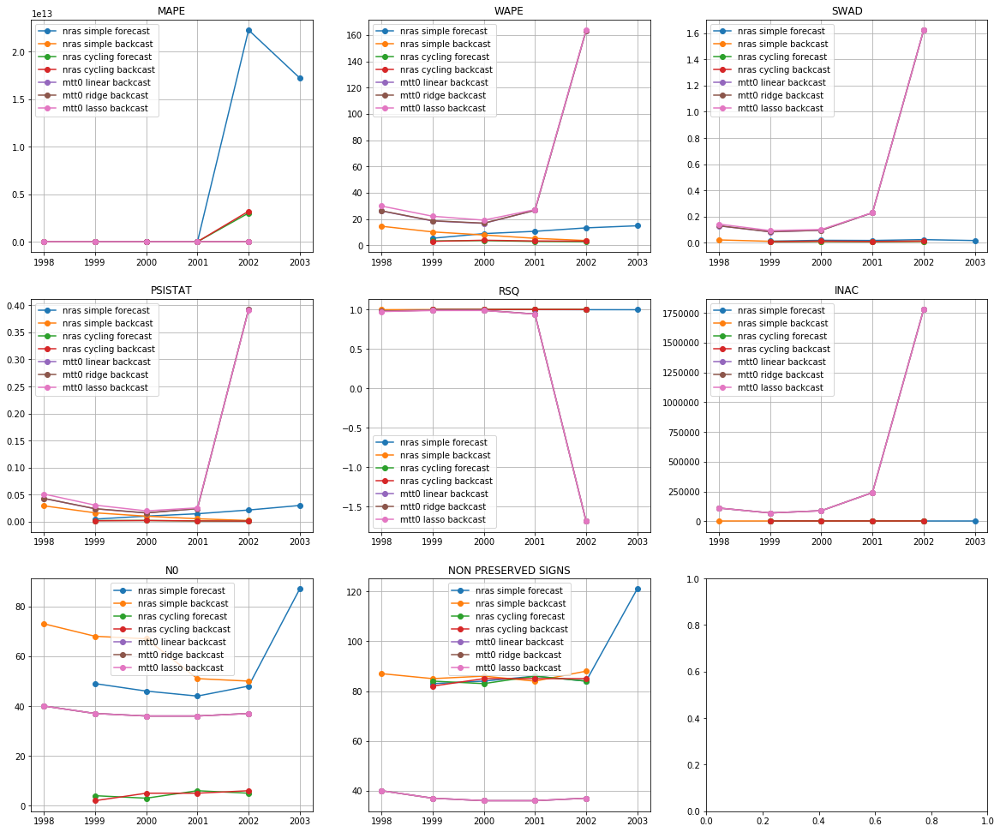

insd simple forecast
insd simple backcast
final cycle: 10
insd cycling forecast
final cycle: 10
insd cycling backcast


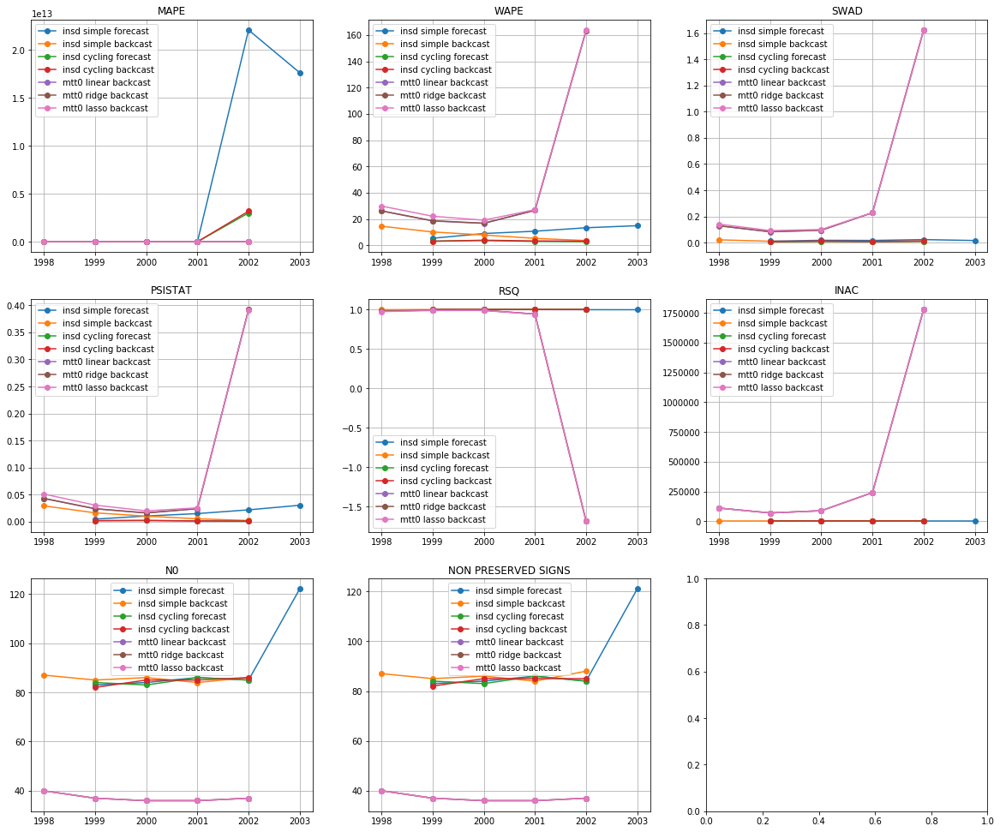

kuroda simple forecast
kuroda simple backcast
final cycle: 10
kuroda cycling forecast
final cycle: 10
kuroda cycling backcast


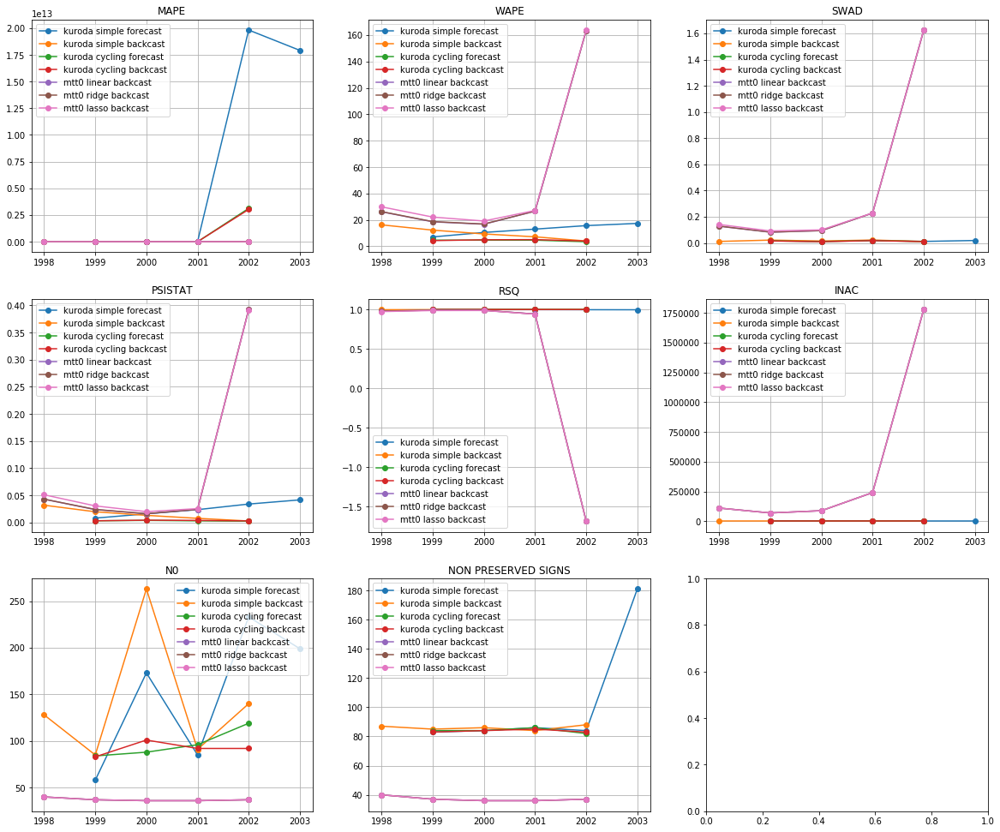

,MAPE,MAPE_R,WAPE,WAPE_R,SWAD,SWAD_R,PSISTAT,PSISTAT_R,RSQ,RSQ_R,INAC,INAC_R,N0,NON PRESERVED SIGNS,R_all,CmR
insd cycling forecast,7.507777e+11,7,3.132825,1,0.008025,1,0.001550,1,0.99975,1,0.00000,1,84.50,84.25,12,1
nras cycling forecast,7.536610e+11,8,3.135050,2,0.008150,2,0.001550,1,0.99975,1,0.00035,9,4.50,84.25,23,2
insd cycling backcast,7.978147e+11,11,3.368175,4,0.009200,3,0.001600,4,0.99975,1,0.00000,1,84.50,84.25,24,3
nras cycling backcast,8.020622e+11,12,3.352100,3,0.009250,4,0.001575,3,0.99975,1,0.00035,9,4.50,84.25,32,4
insd simple backcast,9.582186e+06,5,8.300360,7,0.011120,6,0.012580,7,0.99880,7,0.00000,1,85.60,86.00,33,5
kuroda cycling forecast,7.806652e+11,10,4.345550,5,0.013675,8,0.003050,5,0.99960,5,0.00000,1,96.75,84.00,34,6
kuroda cycling backcast,7.562076e+11,9,4.565325,6,0.012775,7,0.003500,6,0.99960,5,0.00000,1,92.00,83.75,34,6
kuroda simple backcast,8.687291e+05,4,9.796160,9,0.016100,10,0.014980,9,0.99854,9,0.00000,1,141.40,86.00,42,8
nras simple backcast,1.081241e+07,6,8.300560,8,0.011080,5,0.012600,8,0.99880,7,0.00064,12,61.80,86.00,46,9
insd simple forecast,7.945889e+12,15,10.686920,11,0.016100,10,0.016420,11,0.99810,11,0.00000,1,92.00,91.60,59,10


[1998 2003 2004 2005 2006 2007 2008]
available mtypes: [0]
0 LinearRegression(copy_X=True, fit_intercept=True, n_jobs=1, normalize=False) True
using mtt 0
mtt0 ridge forecast
0 Ridge(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=None,
   normalize=False, random_state=None, solver='auto', tol=0.001) True
using mtt 0
mtt0 ridge forecast
0 Lasso(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=1000,
   normalize=False, positive=False, precompute=False, random_state=None,
   selection='cyclic', tol=0.0001, warm_start=False) True
using mtt 0
mtt0 ridge forecast
nras simple forecast
nras simple backcast
final cycle: 10
nras cycling forecast
final cycle: 10
nras cycling backcast


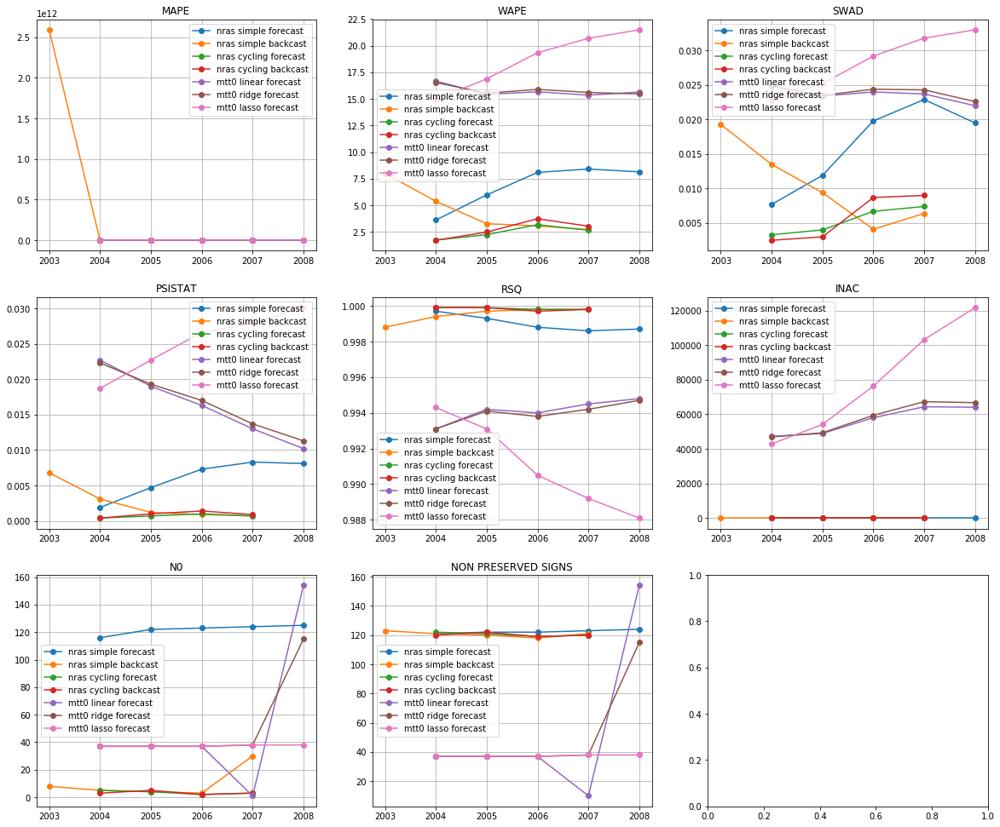

insd simple forecast
insd simple backcast
final cycle: 10
insd cycling forecast
final cycle: 10
insd cycling backcast


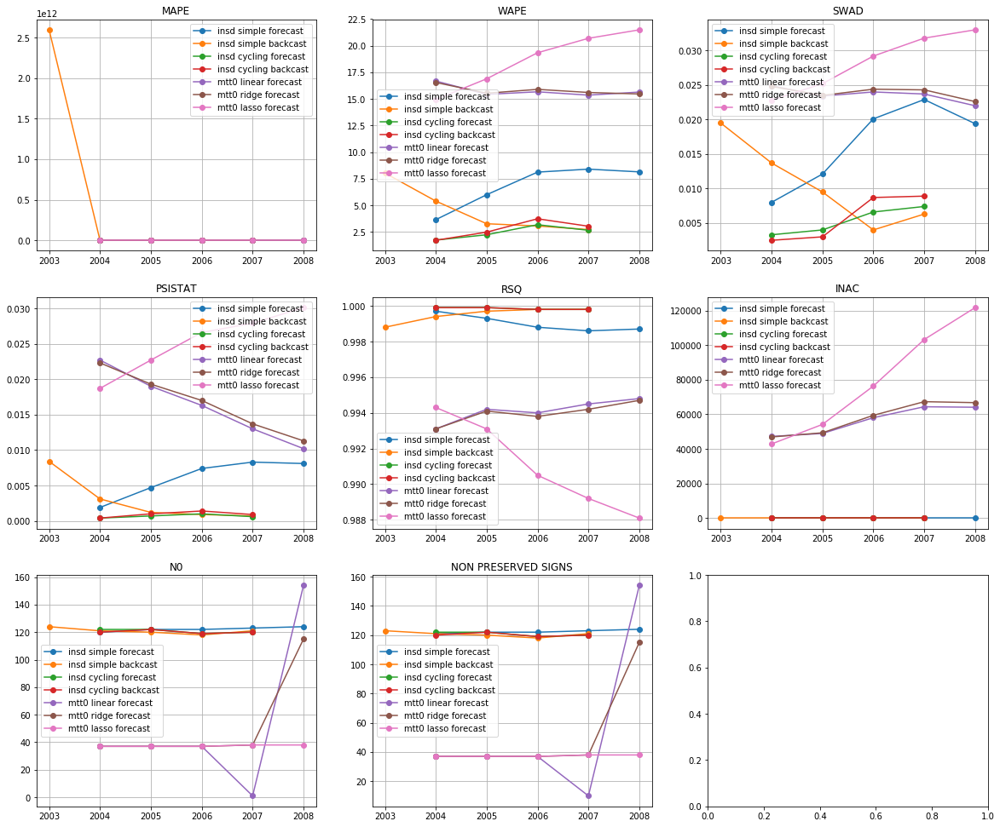

kuroda simple forecast
kuroda simple backcast
final cycle: 10
kuroda cycling forecast
final cycle: 10
kuroda cycling backcast


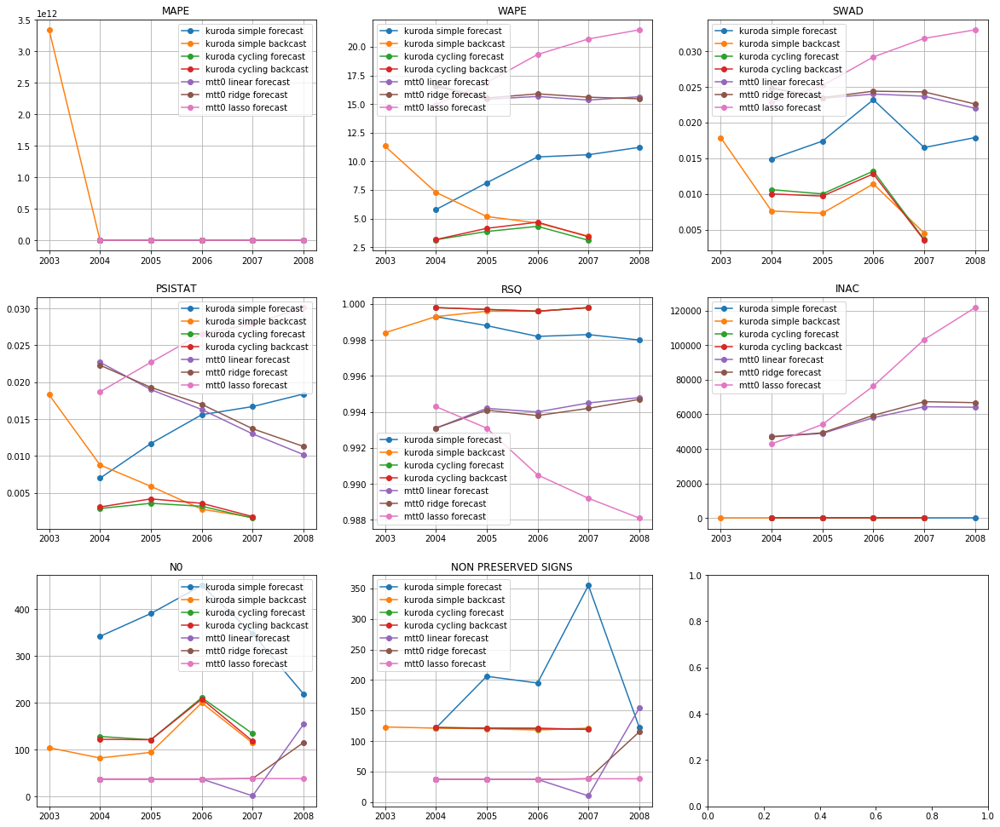

,MAPE,MAPE_R,WAPE,WAPE_R,SWAD,SWAD_R,PSISTAT,PSISTAT_R,RSQ,RSQ_R,INAC,INAC_R,N0,NON PRESERVED SIGNS,R_all,CmR
insd cycling forecast,1.460005e+04,6,2.448050,1,0.005325,1,0.000675,1,0.999850,1,0.000000,1,120.75,120.75,11,1
insd cycling backcast,9.022868e+03,4,2.739725,3,0.005775,3,0.000925,3,0.999850,1,0.000000,1,120.25,120.25,15,2
nras cycling forecast,1.455855e+04,5,2.451500,2,0.005350,2,0.000700,2,0.999850,1,0.000275,9,3.50,120.50,21,3
nras cycling backcast,9.005475e+03,3,2.742150,4,0.005800,4,0.000925,3,0.999825,4,0.000300,10,3.25,120.25,28,4
kuroda cycling forecast,5.763398e+05,11,3.606550,5,0.009350,6,0.002825,6,0.999725,5,0.000000,1,148.50,120.50,34,5
kuroda cycling backcast,5.416485e+05,10,3.847650,6,0.009000,5,0.003175,8,0.999725,5,0.000000,1,142.25,120.75,35,6
insd simple forecast,8.197730e+01,1,6.859340,11,0.016500,11,0.006080,10,0.999020,10,0.000000,1,122.20,122.40,44,7
insd simple backcast,5.190268e+11,14,4.494080,8,0.010600,9,0.002860,7,0.999500,7,0.000000,1,120.80,120.60,46,8
nras simple backcast,5.178879e+11,13,4.487640,7,0.010540,8,0.002540,5,0.999500,7,0.000460,11,10.00,120.60,51,9
kuroda simple backcast,6.685893e+11,15,6.372920,9,0.009740,7,0.007500,11,0.999340,9,0.000000,1,118.80,120.60,52,10


In [34]:
metrics_res['IND'] = get_results('IND')

NLD
use basic I+II
[2000 2001 2002 2003 2004 2005]
available mtypes: [0]
nras simple forecast
nras simple backcast
final cycle: 10
nras cycling forecast
final cycle: 10
nras cycling backcast


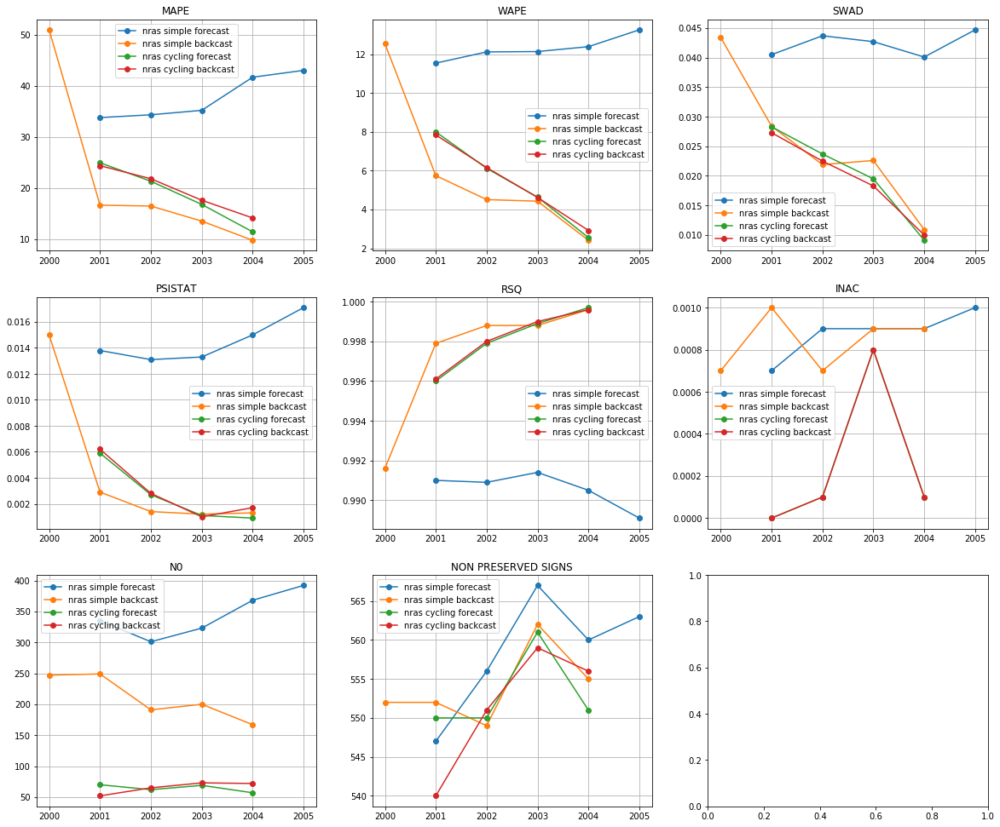

insd simple forecast
insd simple backcast
final cycle: 10
insd cycling forecast
final cycle: 10
insd cycling backcast


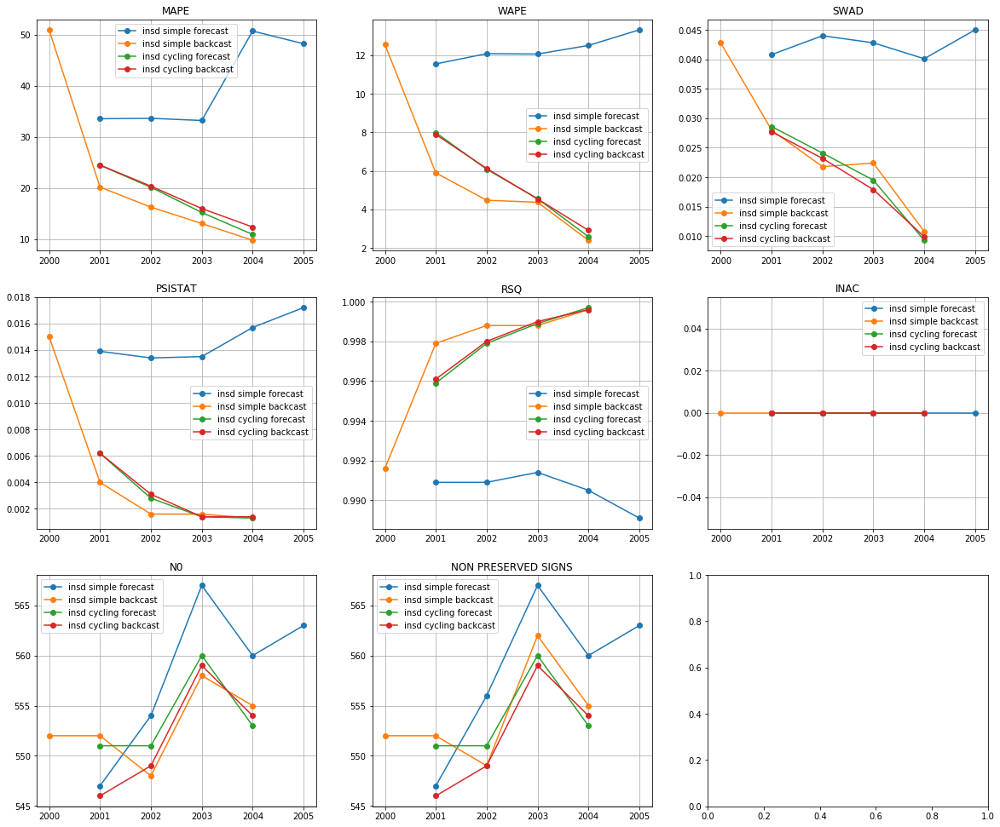

kuroda simple forecast
kuroda simple backcast
final cycle: 10
kuroda cycling forecast
final cycle: 10
kuroda cycling backcast


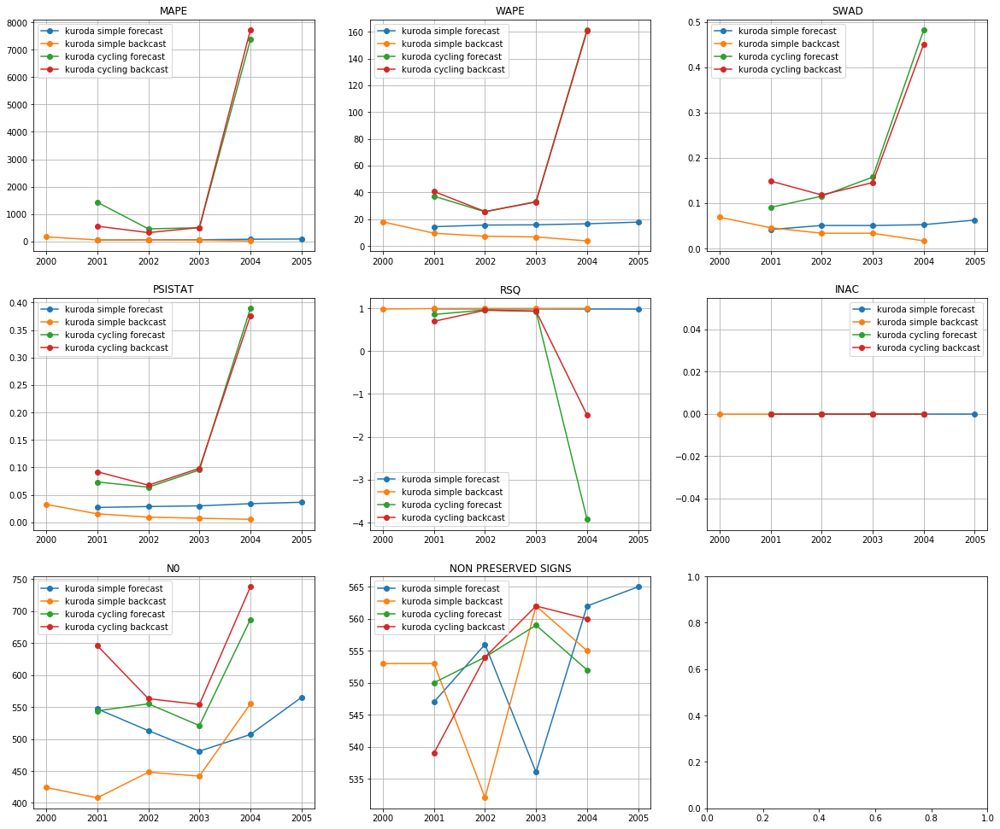

,MAPE,MAPE_R,WAPE,WAPE_R,SWAD,SWAD_R,PSISTAT,PSISTAT_R,RSQ,RSQ_R,INAC,INAC_R,N0,NON PRESERVED SIGNS,R_all,CmR
insd cycling forecast,17.655475,1,5.304075,1,0.020375,4,0.002925,2,0.998100,4,0.00000,1,553.75,553.75,13,1
insd cycling backcast,18.276100,2,5.369000,3,0.019675,2,0.003025,4,0.998175,1,0.00000,1,552.00,552.00,13,1
nras cycling forecast,18.636200,3,5.325825,2,0.020150,3,0.002650,1,0.998125,3,0.00025,9,64.50,553.00,21,3
nras cycling backcast,19.500875,4,5.384400,4,0.019525,1,0.002925,2,0.998175,1,0.00025,9,65.50,551.50,21,3
insd simple backcast,22.017520,6,5.941300,6,0.025160,5,0.004700,6,0.997340,5,0.00000,1,553.00,554.00,29,5
nras simple backcast,21.491340,5,5.926480,5,0.025440,6,0.004360,5,0.997340,5,0.00084,11,210.80,554.00,37,6
kuroda simple backcast,69.719700,10,9.004340,7,0.039680,7,0.014120,7,0.994140,7,0.00000,1,455.40,551.00,39,7
insd simple forecast,39.856680,8,12.306820,9,0.042540,9,0.014740,9,0.990560,9,0.00000,1,558.20,558.60,45,8
kuroda simple forecast,67.862480,9,15.983120,10,0.051640,10,0.031280,10,0.984960,10,0.00000,1,522.60,553.20,50,9
nras simple forecast,37.621040,7,12.282320,8,0.042340,8,0.014460,8,0.990580,8,0.00088,12,343.80,558.60,51,10


[2005 2006 2007 2008 2009 2010]
available mtypes: [0]
nras simple forecast
nras simple backcast
final cycle: 10
nras cycling forecast
final cycle: 10
nras cycling backcast


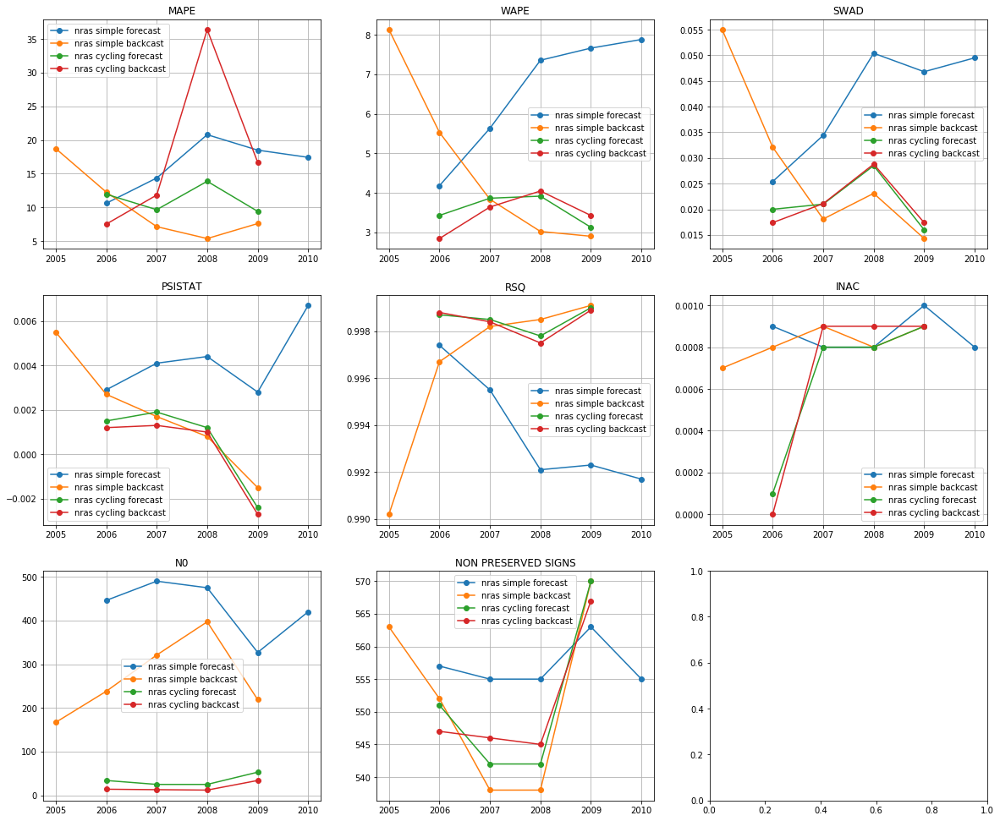

insd simple forecast
insd simple backcast
final cycle: 10
insd cycling forecast
final cycle: 10
insd cycling backcast


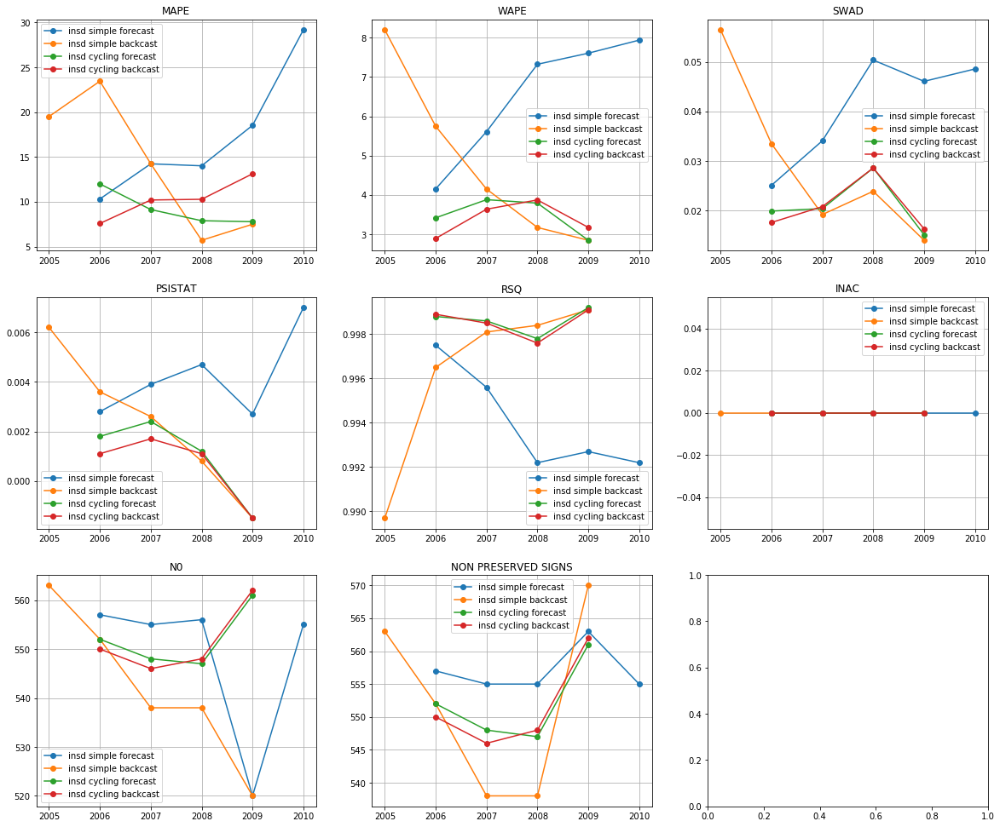

kuroda simple forecast
kuroda simple backcast
final cycle: 10
kuroda cycling forecast
final cycle: 10
kuroda cycling backcast


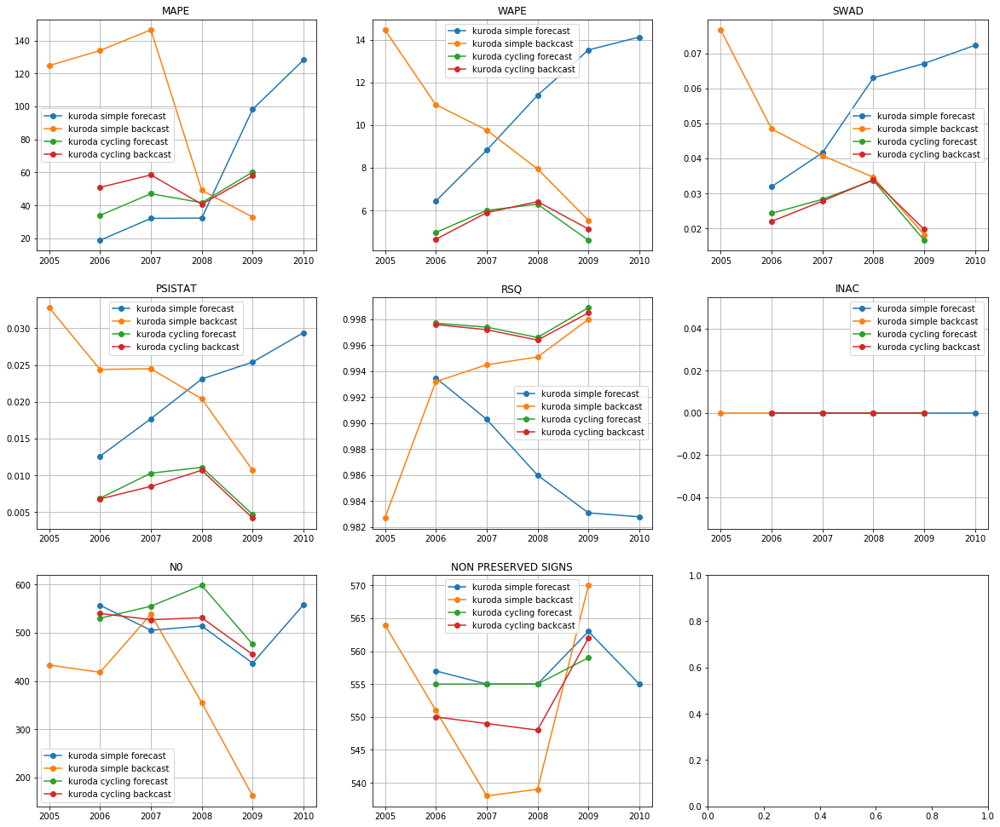

,MAPE,MAPE_R,WAPE,WAPE_R,SWAD,SWAD_R,PSISTAT,PSISTAT_R,RSQ,RSQ_R,INAC,INAC_R,N0,NON PRESERVED SIGNS,R_all,CmR
insd cycling forecast,9.198025,1,3.483725,2,0.021000,2,0.000975,4,0.998600,1,0.000000,1,552.00,552.00,11,1
insd cycling backcast,10.293950,3,3.394025,1,0.020825,1,0.000600,3,0.998525,2,0.000000,1,551.50,551.50,11,1
nras cycling forecast,11.218875,4,3.585500,4,0.021375,4,0.000550,2,0.998500,3,0.000650,9,34.25,551.25,26,3
nras cycling backcast,18.098375,8,3.490775,3,0.021175,3,0.000200,1,0.998400,4,0.000675,10,18.25,551.25,29,4
insd simple backcast,14.079460,5,4.823300,6,0.029420,8,0.002340,6,0.996360,8,0.000000,1,542.20,552.20,34,5
nras simple backcast,10.219800,2,4.685740,5,0.028520,7,0.001840,5,0.996540,7,0.000820,11,268.40,552.20,37,6
kuroda cycling forecast,45.667725,9,5.462600,7,0.025725,5,0.008250,10,0.997650,5,0.000000,1,539.75,556.00,37,6
kuroda cycling backcast,51.981175,10,5.518875,8,0.025850,6,0.007550,9,0.997425,6,0.000000,1,513.25,552.25,40,8
insd simple forecast,17.251900,7,6.527340,9,0.040860,9,0.004220,8,0.994040,9,0.000000,1,548.60,557.00,43,9
nras simple forecast,16.332000,6,6.544740,10,0.041300,10,0.004180,7,0.993800,10,0.000860,12,431.60,557.00,55,10


use basic I
[2000 2001 2002 2003 2004 2005]
available mtypes: [0]
nras simple forecast
nras simple backcast
final cycle: 10
nras cycling forecast
final cycle: 10
nras cycling backcast


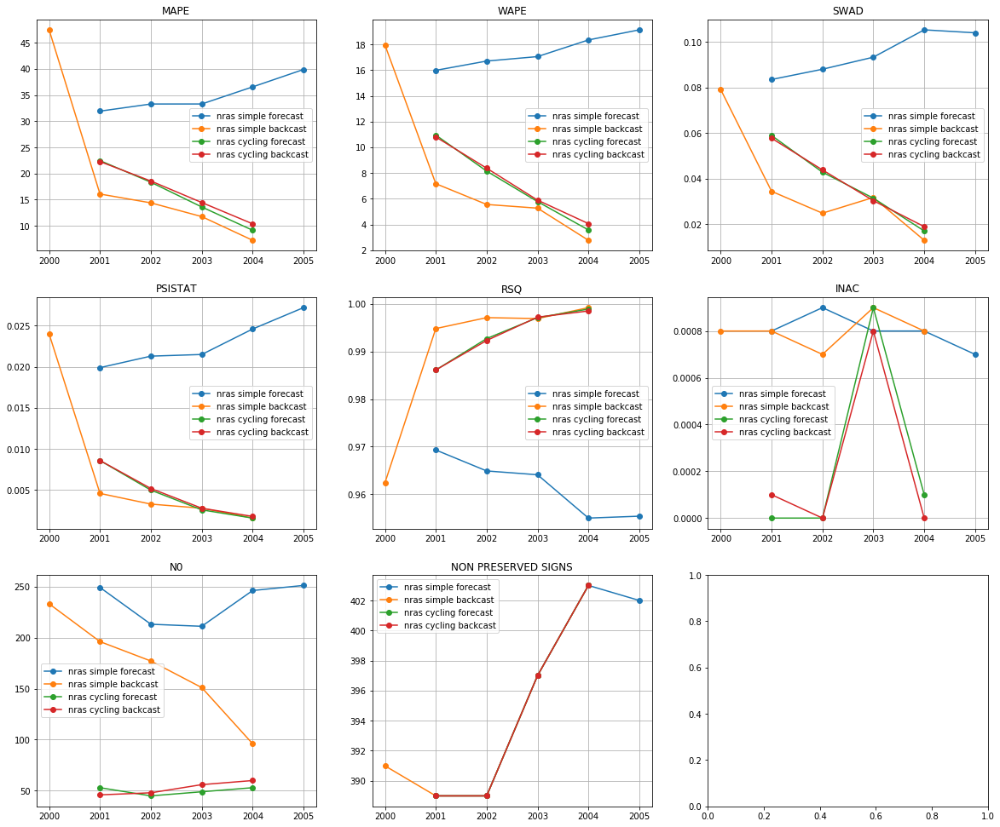

insd simple forecast
insd simple backcast
final cycle: 10
insd cycling forecast
final cycle: 10
insd cycling backcast


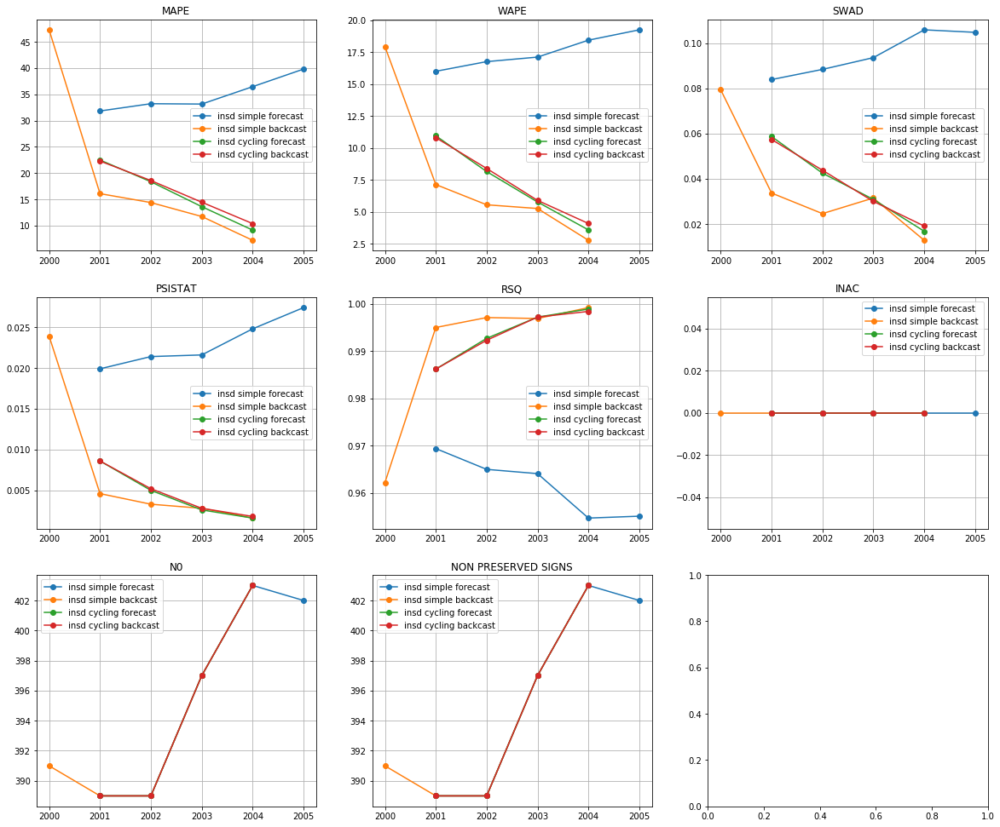

kuroda simple forecast
kuroda simple backcast
final cycle: 10
kuroda cycling forecast
final cycle: 10
kuroda cycling backcast


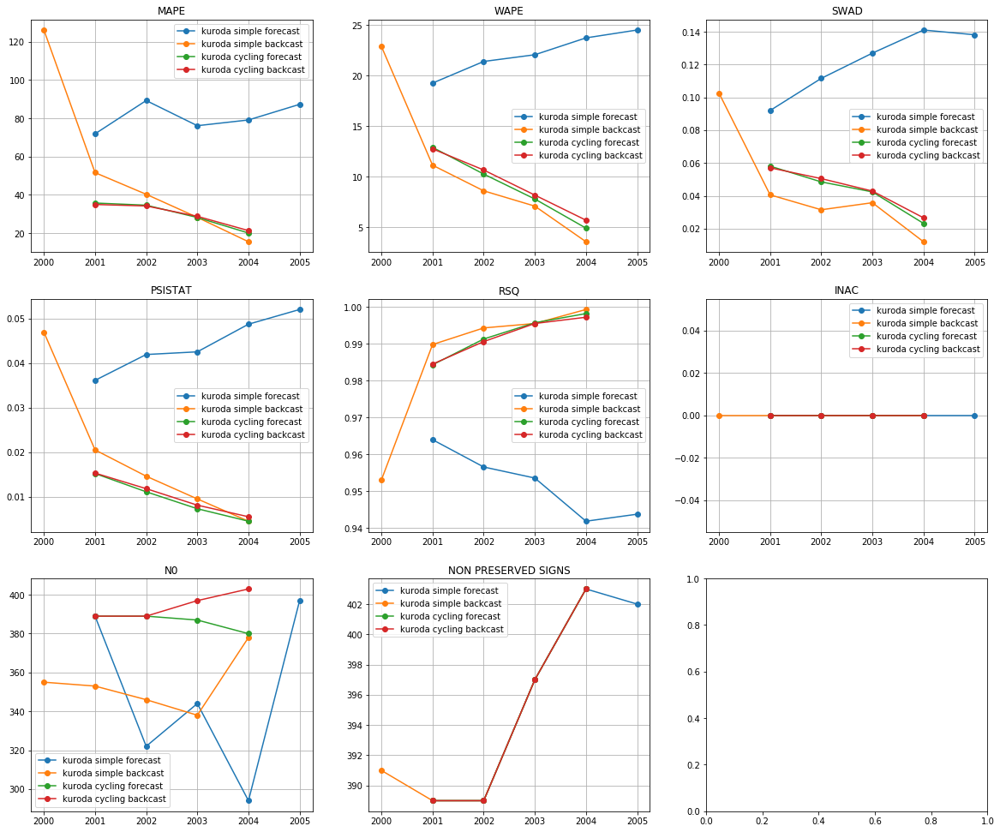

,MAPE,MAPE_R,WAPE,WAPE_R,SWAD,SWAD_R,PSISTAT,PSISTAT_R,RSQ,RSQ_R,INAC,INAC_R,N0,NON PRESERVED SIGNS,R_all,CmR
insd cycling forecast,15.901000,2,7.107225,1,0.037225,3,0.004450,1,0.993750,1,0.000000,1,394.50,394.5,9,1
nras cycling forecast,15.898400,1,7.114225,2,0.037525,4,0.004450,1,0.993700,2,0.000250,10,50.00,394.5,20,2
insd cycling backcast,16.428200,4,7.288125,4,0.037575,5,0.004600,3,0.993525,3,0.000000,1,394.50,394.5,20,2
insd simple backcast,19.337580,5,7.724200,5,0.036400,1,0.007240,5,0.990080,7,0.000000,1,393.80,393.8,24,4
nras cycling backcast,16.428075,3,7.286325,3,0.037675,6,0.004600,3,0.993525,3,0.000225,9,52.50,394.5,27,5
kuroda cycling forecast,29.691525,7,8.982700,7,0.043050,7,0.009525,7,0.992375,5,0.000000,1,386.25,394.5,34,6
nras simple backcast,19.393700,6,7.746600,6,0.036580,2,0.007260,6,0.990080,7,0.000800,11,170.60,393.8,38,7
kuroda cycling backcast,29.868750,8,9.340225,8,0.044275,8,0.010175,8,0.991950,6,0.000000,1,394.50,394.5,39,8
kuroda simple backcast,52.384420,11,10.671820,9,0.044520,9,0.019200,9,0.986400,9,0.000000,1,354.00,393.8,48,9
insd simple forecast,34.884720,9,17.514080,11,0.095320,11,0.023020,11,0.961660,11,0.000000,1,396.00,396.0,54,10


[2005 2006 2007 2008 2009 2010]
available mtypes: [0]
nras simple forecast
nras simple backcast
final cycle: 10
nras cycling forecast
final cycle: 10
nras cycling backcast


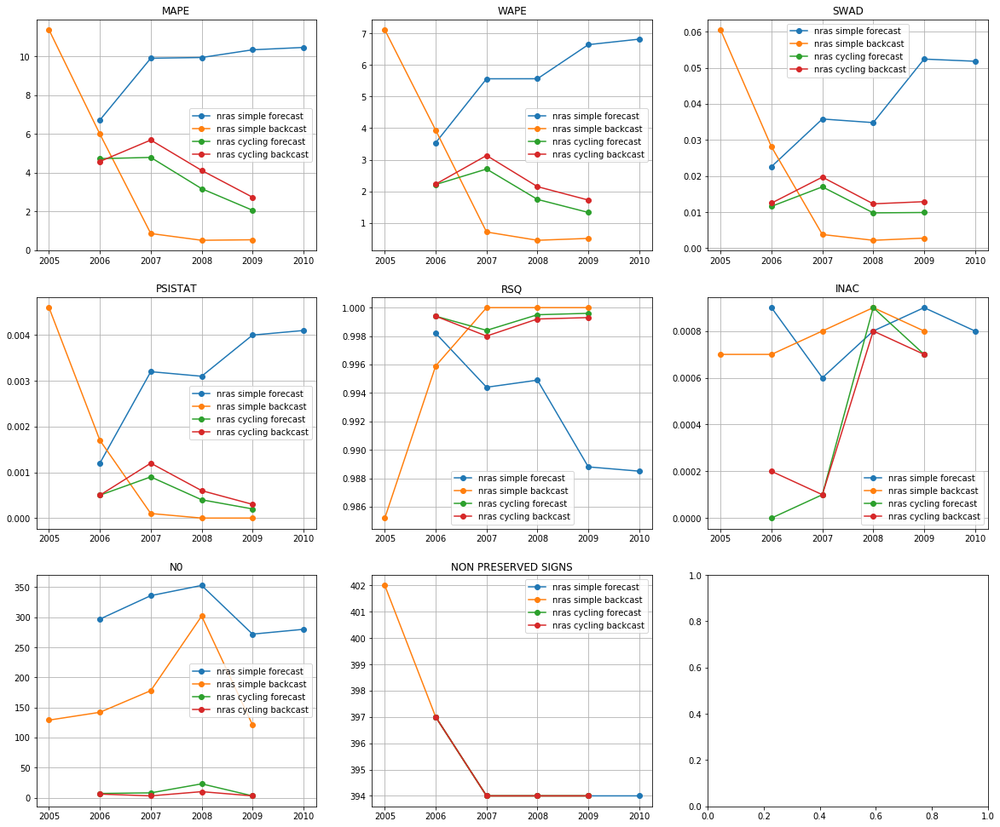

insd simple forecast
insd simple backcast
final cycle: 10
insd cycling forecast
final cycle: 10
insd cycling backcast


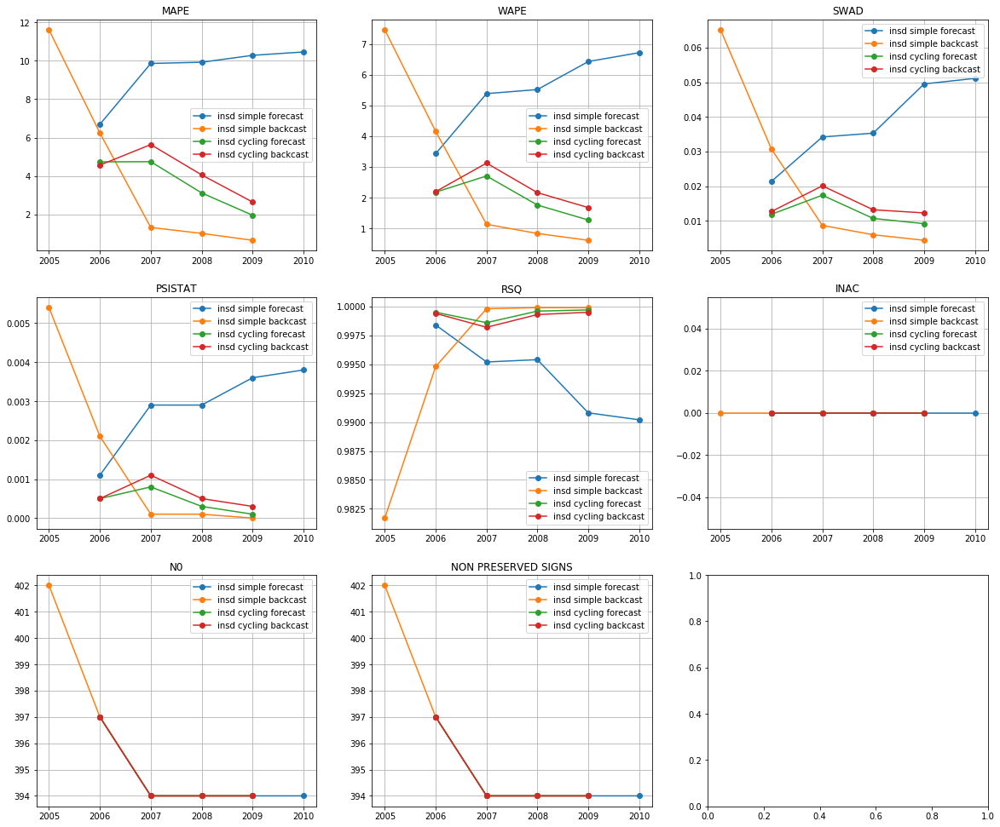

kuroda simple forecast
kuroda simple backcast
final cycle: 10
kuroda cycling forecast
final cycle: 10
kuroda cycling backcast


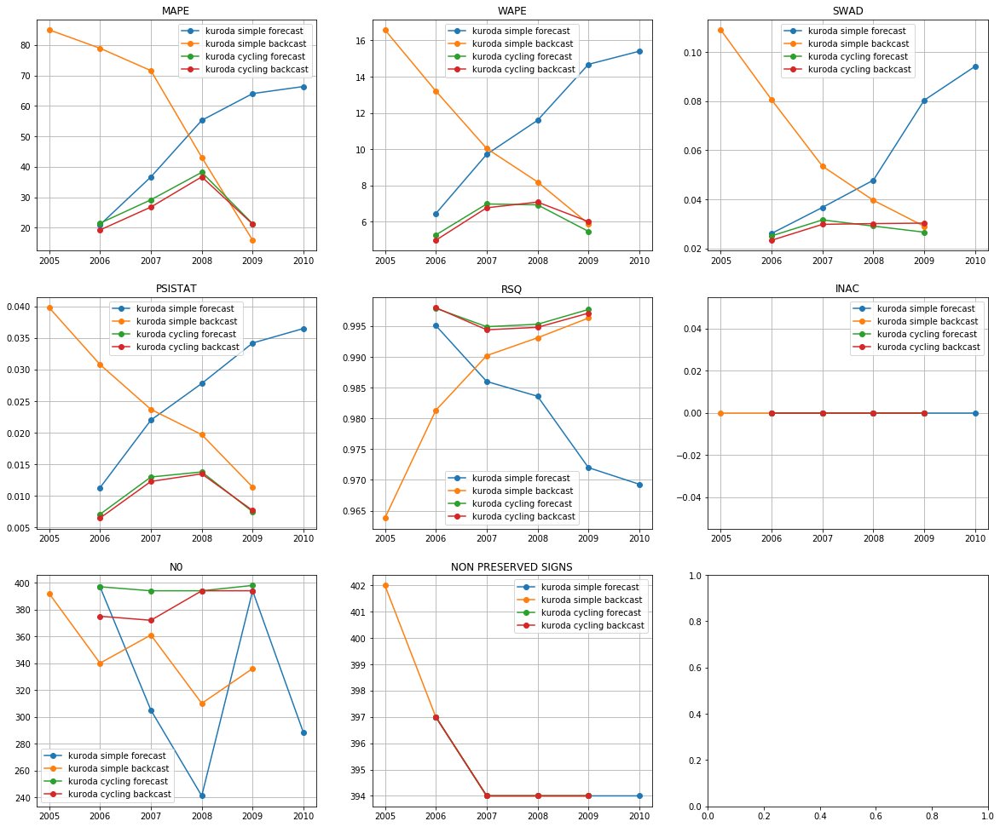

,MAPE,MAPE_R,WAPE,WAPE_R,SWAD,SWAD_R,PSISTAT,PSISTAT_R,RSQ,RSQ_R,INAC,INAC_R,N0,NON PRESERVED SIGNS,R_all,CmR
insd cycling forecast,3.641400,1,1.977675,1,0.012300,2,0.000425,1,0.999350,1,0.000000,1,394.75,394.75,7,1
nras cycling forecast,3.692150,2,2.002125,2,0.012075,1,0.000500,2,0.999225,2,0.000425,9,10.25,394.75,18,2
insd cycling backcast,4.228050,5,2.288900,3,0.014575,4,0.000600,3,0.999100,3,0.000000,1,394.75,394.75,19,3
nras cycling backcast,4.284250,6,2.310925,4,0.014350,3,0.000650,4,0.998975,4,0.000450,10,5.50,394.75,31,4
insd simple backcast,4.168700,4,2.838840,6,0.022980,6,0.001540,6,0.995220,8,0.000000,1,396.20,396.20,31,4
nras simple backcast,3.859900,3,2.546160,5,0.019480,5,0.001280,5,0.996220,6,0.000780,11,174.40,396.20,35,6
insd simple forecast,9.442260,7,5.497500,7,0.038300,9,0.002860,7,0.994000,9,0.000000,1,394.60,394.60,40,7
kuroda cycling forecast,27.514175,10,6.159225,9,0.028100,7,0.010350,10,0.996450,5,0.000000,1,395.75,394.75,42,8
kuroda cycling backcast,25.955700,9,6.206425,10,0.028375,8,0.010000,9,0.996075,7,0.000000,1,383.75,394.75,44,9
nras simple forecast,9.482020,8,5.623980,8,0.039480,10,0.003120,8,0.992960,10,0.000800,12,307.60,394.60,56,10


use purchase I+II
[2000 2001 2002 2003 2004 2005]
available mtypes: [0]
nras simple forecast
nras simple backcast
final cycle: 10
nras cycling forecast
final cycle: 10
nras cycling backcast


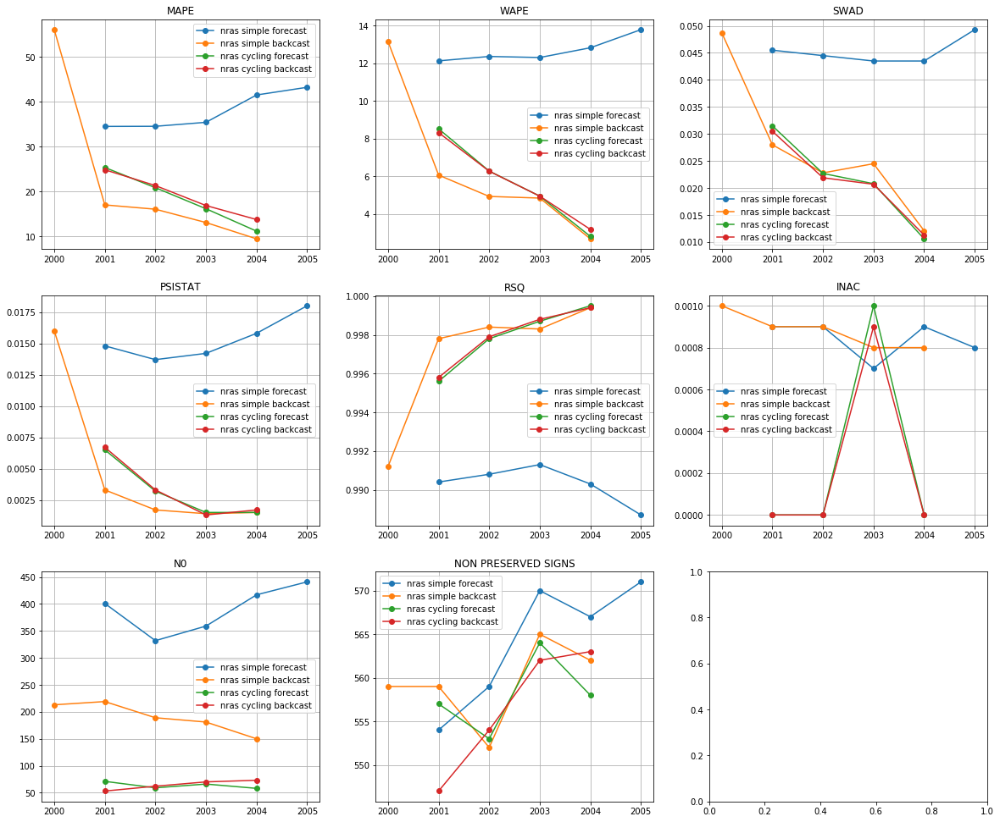

insd simple forecast
insd simple backcast
final cycle: 10
insd cycling forecast
final cycle: 10
insd cycling backcast


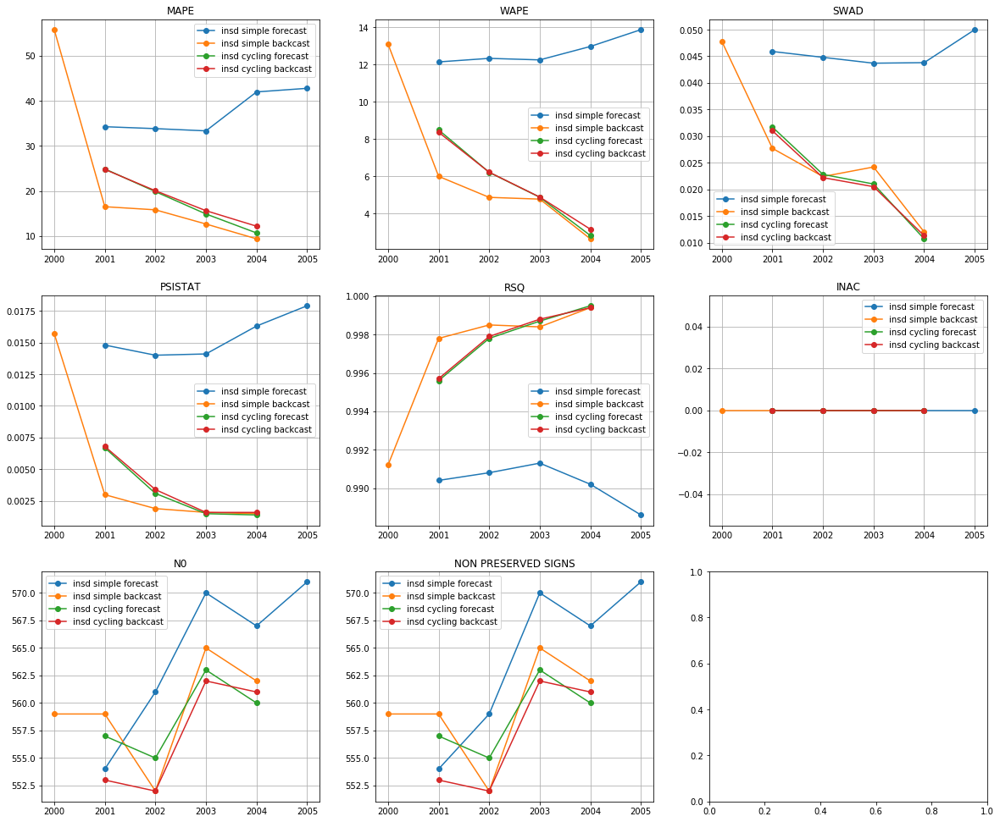

kuroda simple forecast
kuroda simple backcast
final cycle: 10
kuroda cycling forecast
final cycle: 10
kuroda cycling backcast


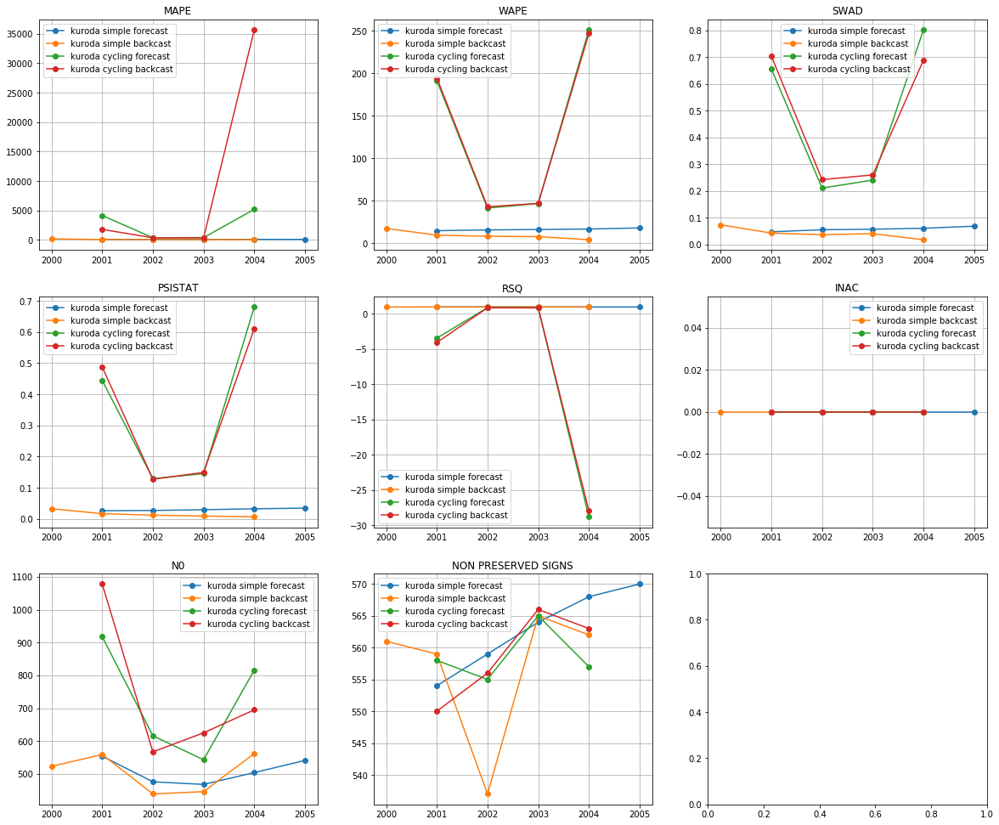

,MAPE,MAPE_R,WAPE,WAPE_R,SWAD,SWAD_R,PSISTAT,PSISTAT_R,RSQ,RSQ_R,INAC,INAC_R,N0,NON PRESERVED SIGNS,R_all,CmR
insd cycling forecast,17.600550,1,5.602975,1,0.021550,4,0.003175,1,0.997900,3,0.000000,1,558.75,558.75,11,1
insd cycling backcast,18.179525,2,5.660050,3,0.021250,2,0.003350,4,0.997950,2,0.000000,1,557.00,557.00,14,2
nras cycling forecast,18.386000,3,5.630500,2,0.021400,3,0.003175,1,0.997900,3,0.000250,10,63.50,558.00,22,3
nras cycling backcast,19.203025,4,5.670875,4,0.021100,1,0.003250,3,0.997975,1,0.000225,9,64.50,556.50,22,3
insd simple backcast,22.045880,5,6.279820,5,0.026820,5,0.004740,5,0.997060,5,0.000000,1,559.40,559.40,26,5
kuroda simple backcast,62.628080,9,9.456200,7,0.042080,7,0.015600,9,0.992720,7,0.000000,1,505.80,556.80,40,6
nras simple backcast,22.335480,6,6.327140,6,0.027220,6,0.004780,6,0.997020,6,0.000880,12,190.40,559.40,42,7
insd simple forecast,37.235300,7,12.715400,9,0.045640,9,0.015420,8,0.990260,9,0.000000,1,564.60,564.20,43,8
nras simple forecast,37.837900,8,12.684080,8,0.045260,8,0.015300,7,0.990300,8,0.000840,11,390.00,564.20,50,9
kuroda simple forecast,66.667820,10,16.312720,10,0.057640,10,0.030100,10,0.983940,10,0.000000,1,508.60,563.00,51,10


[2005 2006 2007 2008 2009 2010]
available mtypes: [0]
nras simple forecast
nras simple backcast
final cycle: 10
nras cycling forecast
final cycle: 10
nras cycling backcast


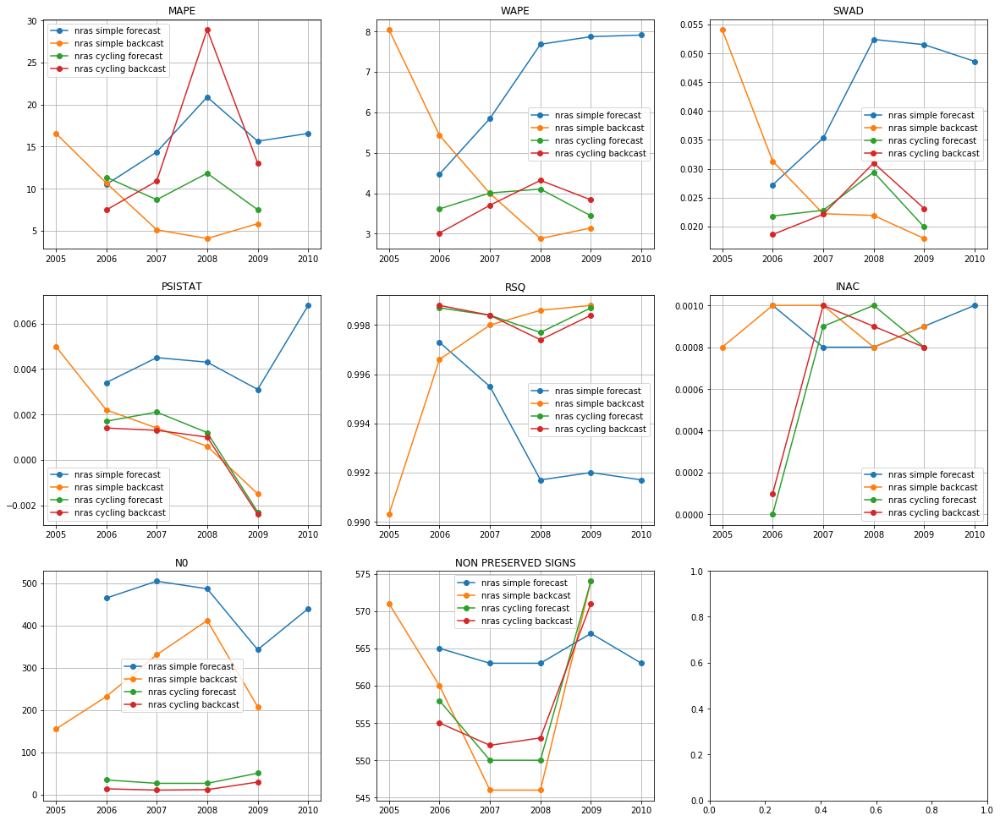

insd simple forecast
insd simple backcast
final cycle: 10
insd cycling forecast
final cycle: 10
insd cycling backcast


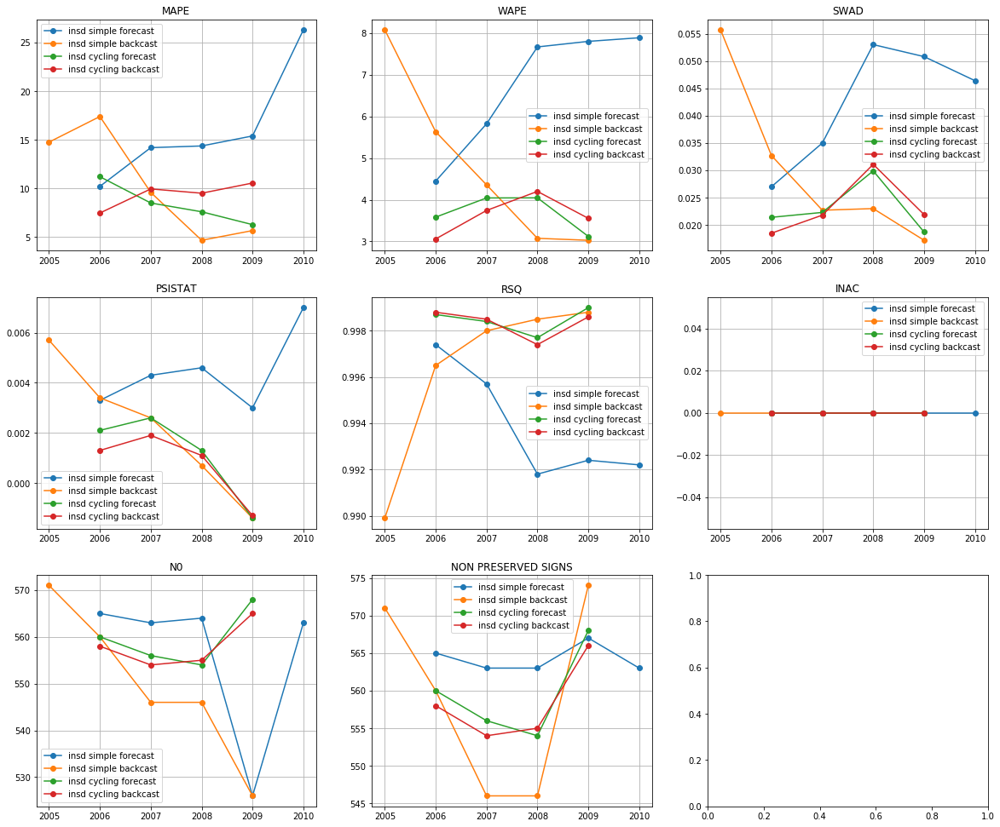

kuroda simple forecast
kuroda simple backcast
final cycle: 10
kuroda cycling forecast
final cycle: 10
kuroda cycling backcast


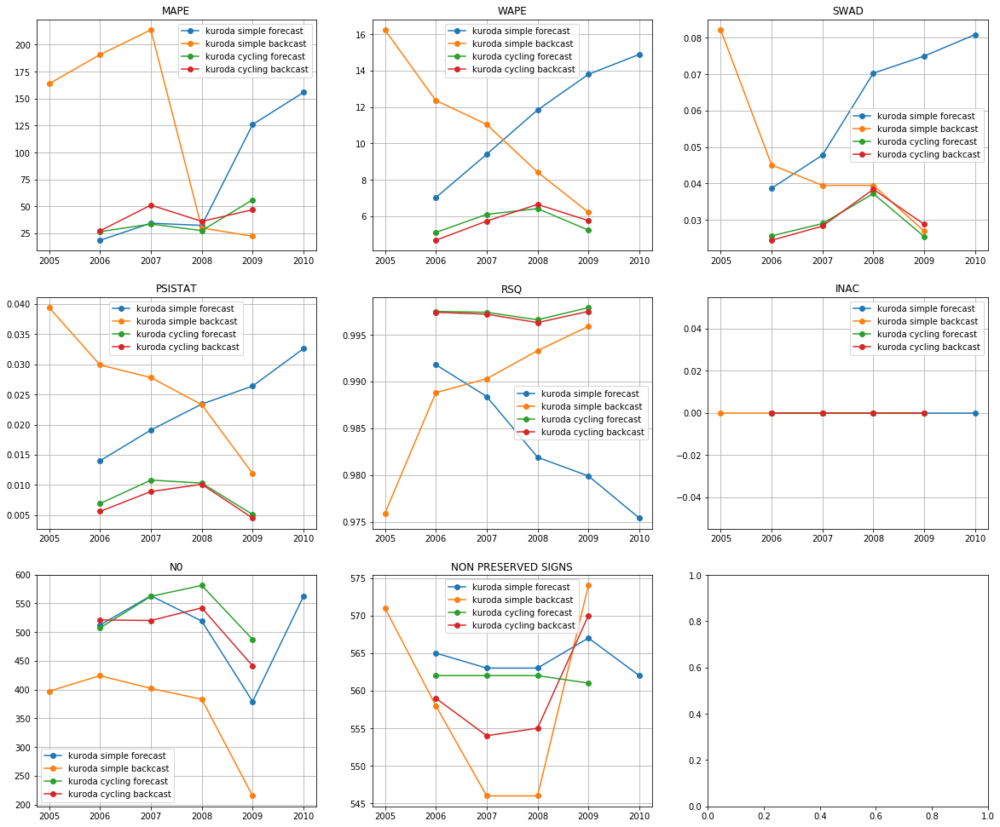

,MAPE,MAPE_R,WAPE,WAPE_R,SWAD,SWAD_R,PSISTAT,PSISTAT_R,RSQ,RSQ_R,INAC,INAC_R,N0,NON PRESERVED SIGNS,R_all,CmR
insd cycling forecast,8.40175,1,3.697225,2,0.023075,1,0.001150,4,0.998450,1,0.000000,1,559.50,559.50,10,1
insd cycling backcast,9.37645,3,3.638325,1,0.023325,2,0.000750,3,0.998325,3,0.000000,1,558.00,558.25,13,2
nras cycling forecast,9.83165,4,3.790975,4,0.023475,3,0.000675,2,0.998375,2,0.000675,9,35.00,558.00,24,3
nras cycling backcast,15.06235,6,3.718050,3,0.023700,4,0.000325,1,0.998250,4,0.000700,10,16.75,557.75,28,4
insd simple backcast,10.42082,5,4.833940,6,0.030260,8,0.002200,6,0.996340,8,0.000000,1,549.80,559.40,34,5
nras simple backcast,8.44472,2,4.698280,5,0.029480,6,0.001540,5,0.996460,7,0.000900,11,267.60,559.40,36,6
kuroda cycling forecast,35.94320,9,5.711800,8,0.029300,5,0.008275,10,0.997350,5,0.000000,1,534.25,561.75,38,7
kuroda cycling backcast,40.36760,10,5.700300,7,0.029975,7,0.007275,9,0.997100,6,0.000000,1,506.00,559.50,40,8
insd simple forecast,16.09870,8,6.726900,9,0.042440,9,0.004440,8,0.993900,9,0.000000,1,556.20,564.20,44,9
nras simple forecast,15.57776,7,6.755120,10,0.043000,10,0.004420,7,0.993640,10,0.000900,11,448.00,564.20,55,10


use purchase I
[2000 2001 2002 2003 2004 2005]
available mtypes: [0]
nras simple forecast
nras simple backcast
final cycle: 10
nras cycling forecast
final cycle: 10
nras cycling backcast


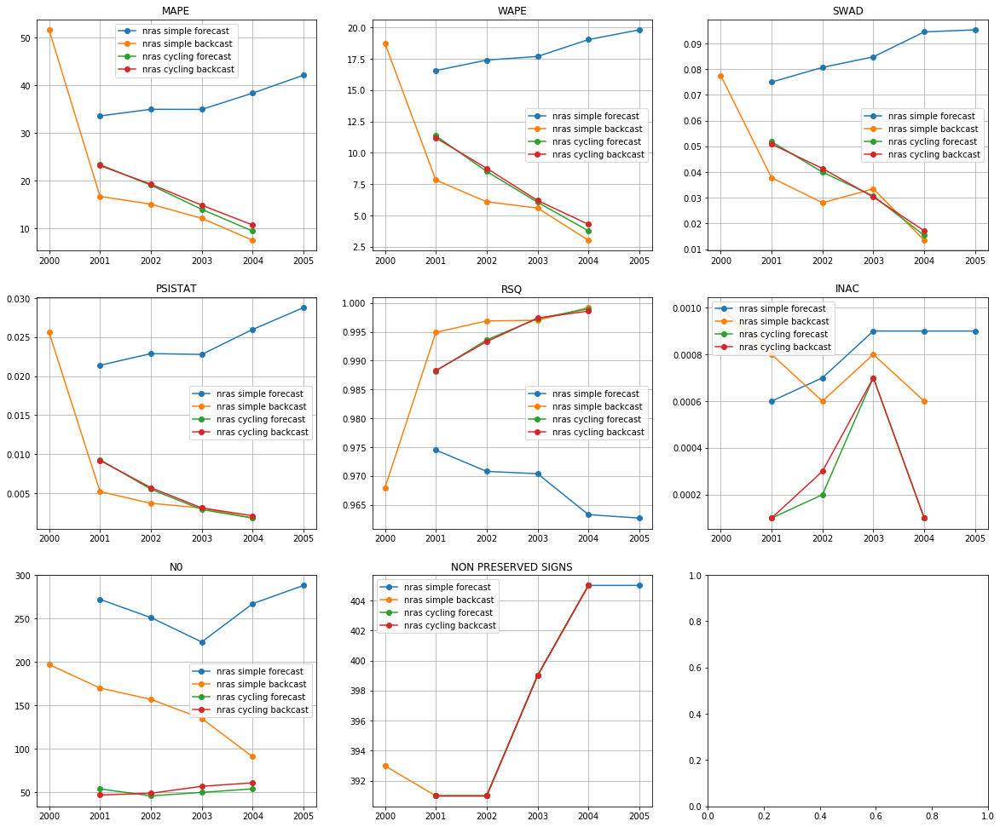

insd simple forecast
insd simple backcast
final cycle: 10
insd cycling forecast
final cycle: 10
insd cycling backcast


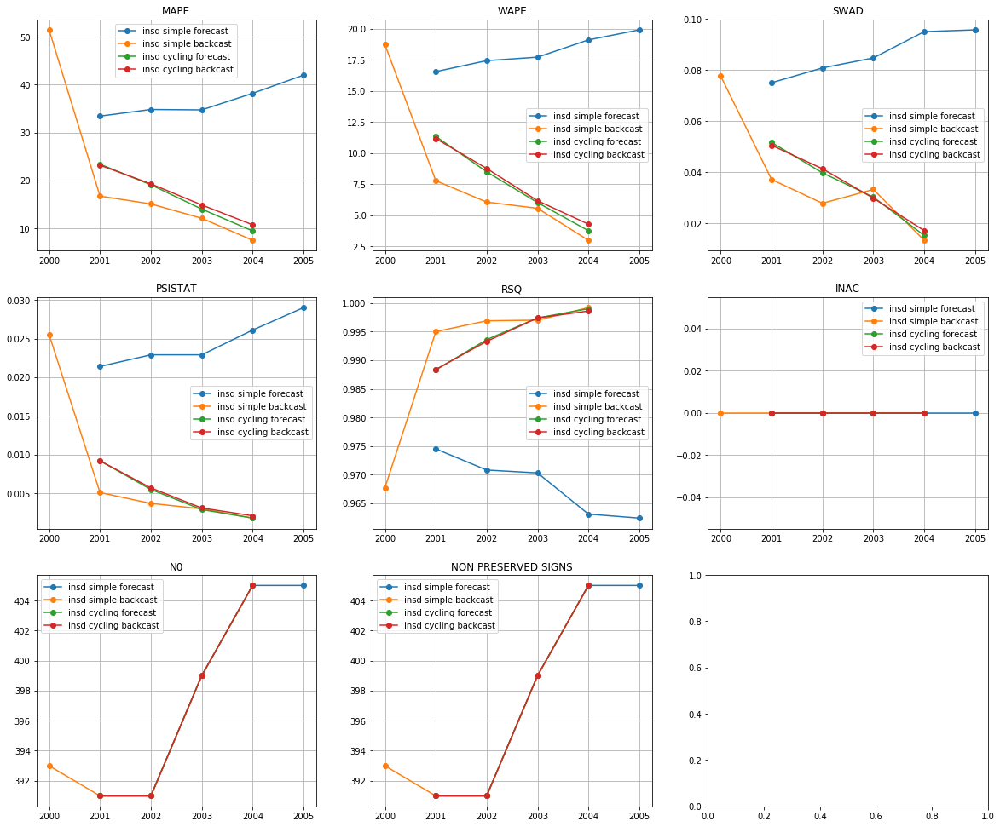

kuroda simple forecast
kuroda simple backcast
final cycle: 10
kuroda cycling forecast
final cycle: 10
kuroda cycling backcast


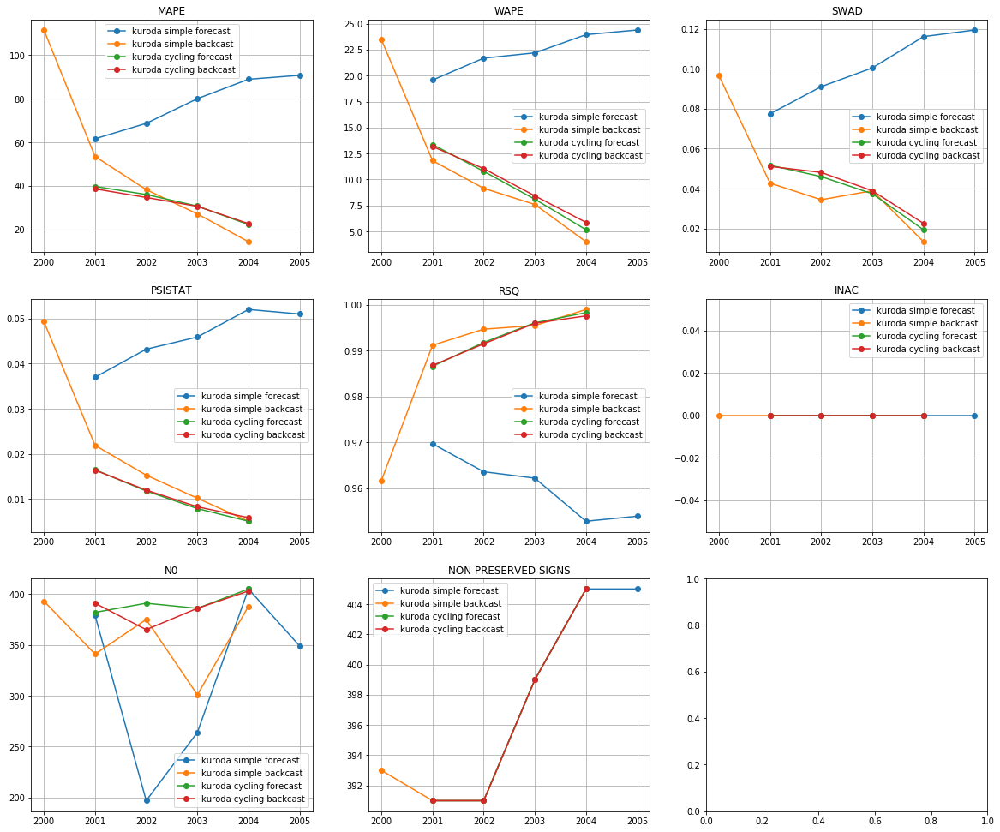

,MAPE,MAPE_R,WAPE,WAPE_R,SWAD,SWAD_R,PSISTAT,PSISTAT_R,RSQ,RSQ_R,INAC,INAC_R,N0,NON PRESERVED SIGNS,R_all,CmR
insd cycling forecast,16.486725,1,7.414150,1,0.034275,1,0.004850,1,0.994575,1,0.000000,1,396.50,396.5,6,1
insd cycling backcast,17.021400,3,7.606600,3,0.034775,3,0.005025,3,0.994425,3,0.000000,1,396.50,396.5,16,2
nras cycling forecast,16.498475,2,7.425800,2,0.034475,2,0.004875,2,0.994525,2,0.000275,9,51.00,396.5,19,3
nras cycling backcast,17.033100,4,7.612875,4,0.034950,4,0.005025,3,0.994400,4,0.000300,10,53.50,396.5,29,4
insd simple backcast,20.578320,5,8.234020,5,0.037900,5,0.007820,5,0.991160,8,0.000000,1,395.80,395.8,29,4
kuroda cycling forecast,32.125950,8,9.355800,7,0.038600,7,0.010325,7,0.993200,5,0.000000,1,391.00,396.5,35,6
kuroda cycling backcast,31.596175,7,9.630900,8,0.040150,8,0.010650,8,0.992975,6,0.000000,1,386.25,396.5,38,7
nras simple backcast,20.634140,6,8.255420,6,0.038100,6,0.007880,6,0.991180,7,0.000760,11,150.00,395.8,42,8
kuroda simple backcast,48.915160,11,11.206280,9,0.045180,9,0.020360,9,0.988420,9,0.000000,1,359.60,395.8,48,9
insd simple forecast,36.648440,9,18.148800,11,0.086340,11,0.024460,11,0.968220,11,0.000000,1,398.20,398.2,54,10


[2005 2006 2007 2008 2009 2010]
available mtypes: [0]
nras simple forecast
nras simple backcast
final cycle: 10
nras cycling forecast
final cycle: 10
nras cycling backcast


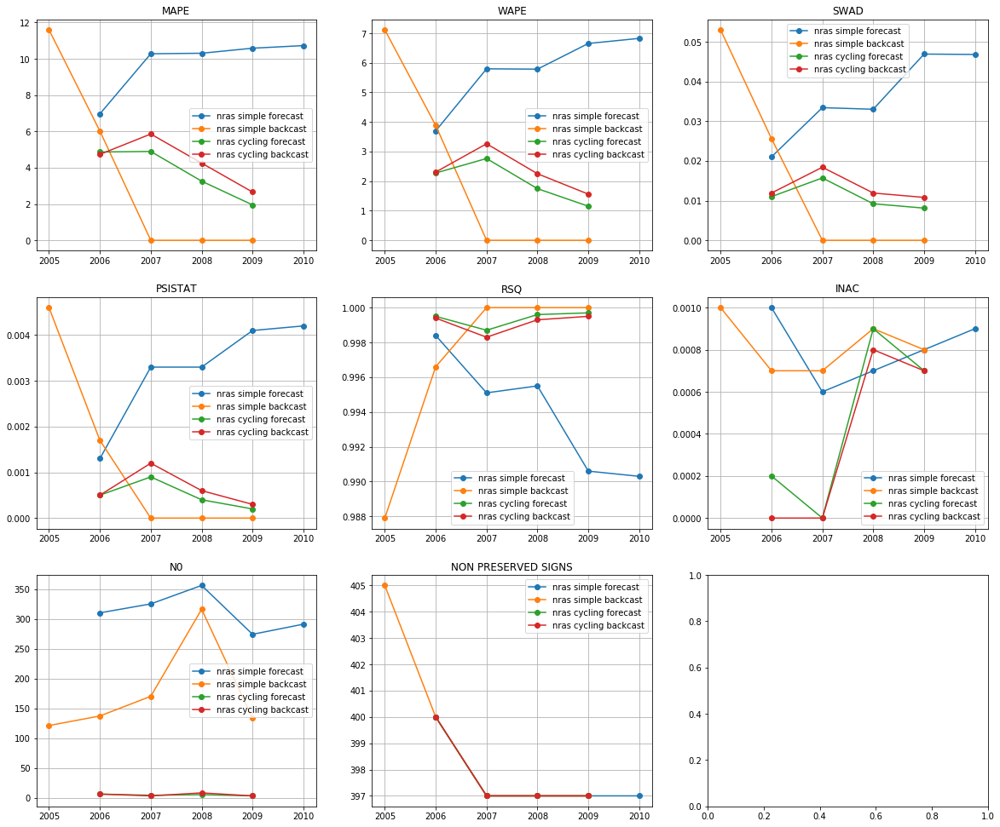

insd simple forecast
insd simple backcast
final cycle: 10
insd cycling forecast
final cycle: 10
insd cycling backcast


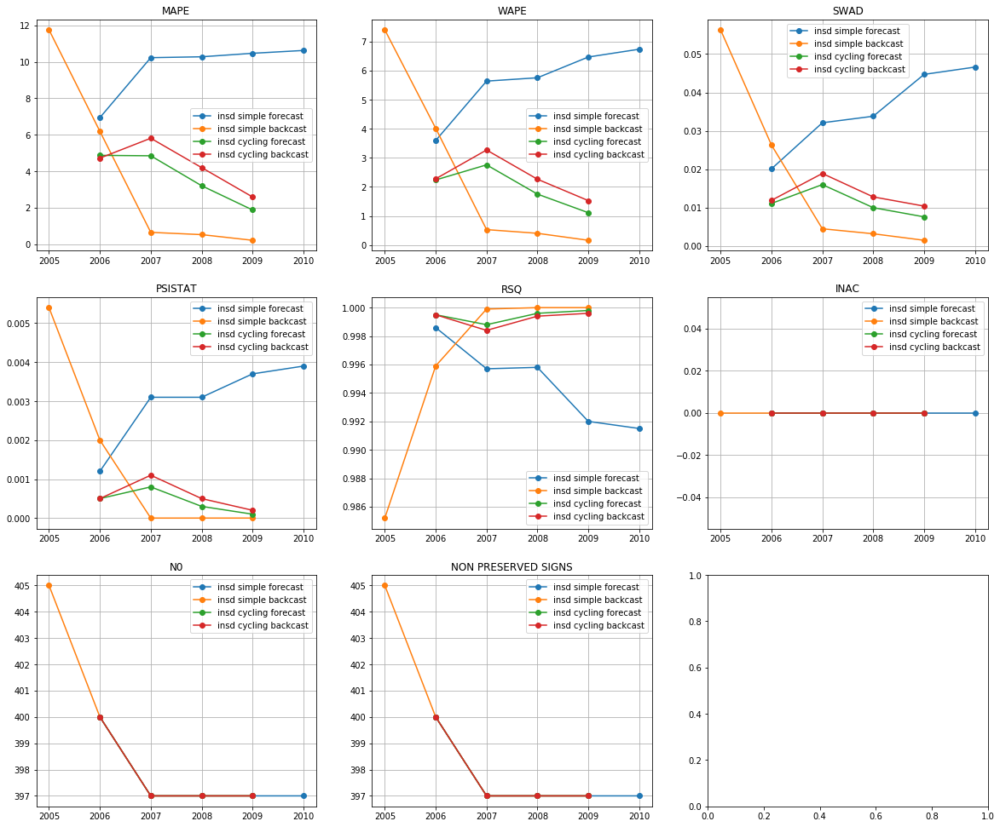

kuroda simple forecast
kuroda simple backcast
final cycle: 10
kuroda cycling forecast
final cycle: 10
kuroda cycling backcast


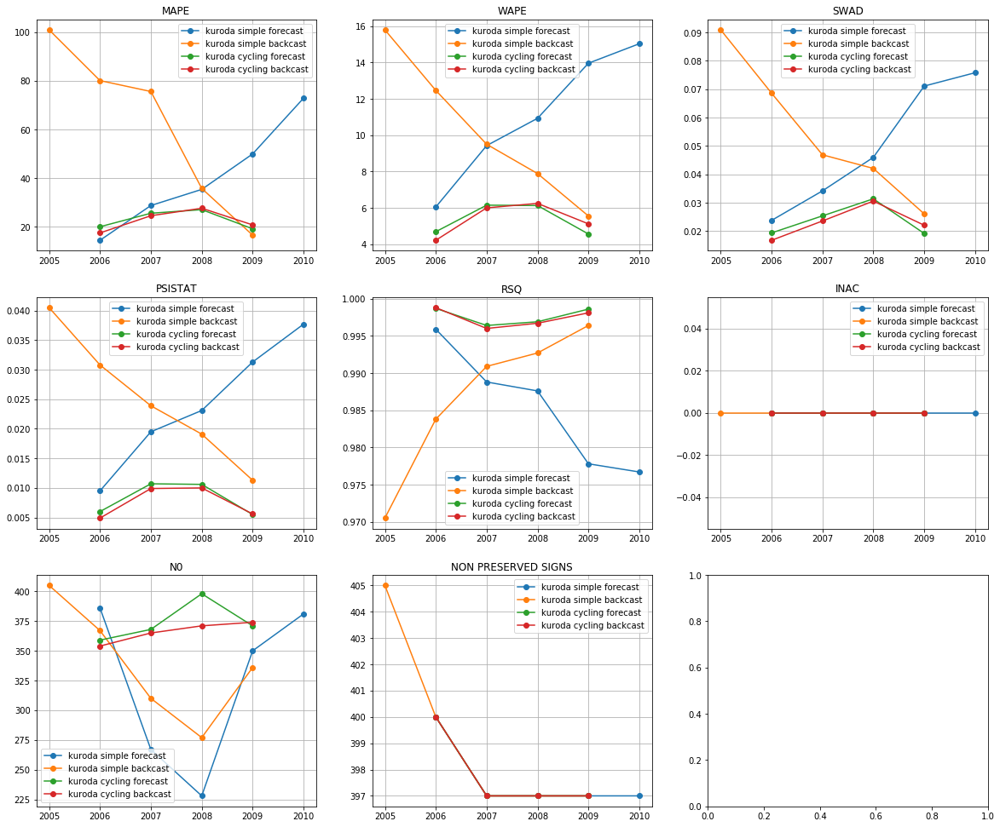

,MAPE,MAPE_R,WAPE,WAPE_R,SWAD,SWAD_R,PSISTAT,PSISTAT_R,RSQ,RSQ_R,INAC,INAC_R,N0,NON PRESERVED SIGNS,R_all,CmR
insd cycling forecast,3.698000,2,1.964100,1,0.011175,2,0.000425,1,0.999425,1,0.000000,1,397.75,397.75,8,1
nras cycling forecast,3.741775,3,1.983825,2,0.011000,1,0.000500,2,0.999375,2,0.000450,10,4.50,397.75,20,2
insd cycling backcast,4.327950,5,2.333475,4,0.013500,4,0.000575,3,0.999225,3,0.000000,1,397.75,397.75,20,2
nras cycling backcast,4.375050,6,2.344825,5,0.013250,3,0.000650,4,0.999125,4,0.000375,9,5.00,397.75,31,4
insd simple backcast,3.863700,4,2.502220,6,0.018360,6,0.001480,6,0.996200,8,0.000000,1,399.20,399.20,31,4
nras simple backcast,3.522800,1,2.199860,3,0.015720,5,0.001260,5,0.996900,7,0.000820,12,175.40,399.20,33,6
kuroda cycling backcast,22.571550,9,5.394800,8,0.023275,7,0.007600,9,0.997400,6,0.000000,1,366.00,397.75,40,7
kuroda cycling forecast,22.917700,10,5.380750,7,0.023850,8,0.008200,10,0.997650,5,0.000000,1,374.00,397.75,41,8
insd simple forecast,9.707240,7,5.637440,9,0.035460,9,0.003000,7,0.994720,9,0.000000,1,397.60,397.60,42,9
nras simple forecast,9.772000,8,5.751060,10,0.036220,10,0.003240,8,0.993980,10,0.000800,11,311.20,397.60,57,10


sup I
[2000 2001 2002 2003 2004 2005]
available mtypes: [0]
nras simple forecast
nras simple backcast
final cycle: 10
nras cycling forecast
final cycle: 10
nras cycling backcast


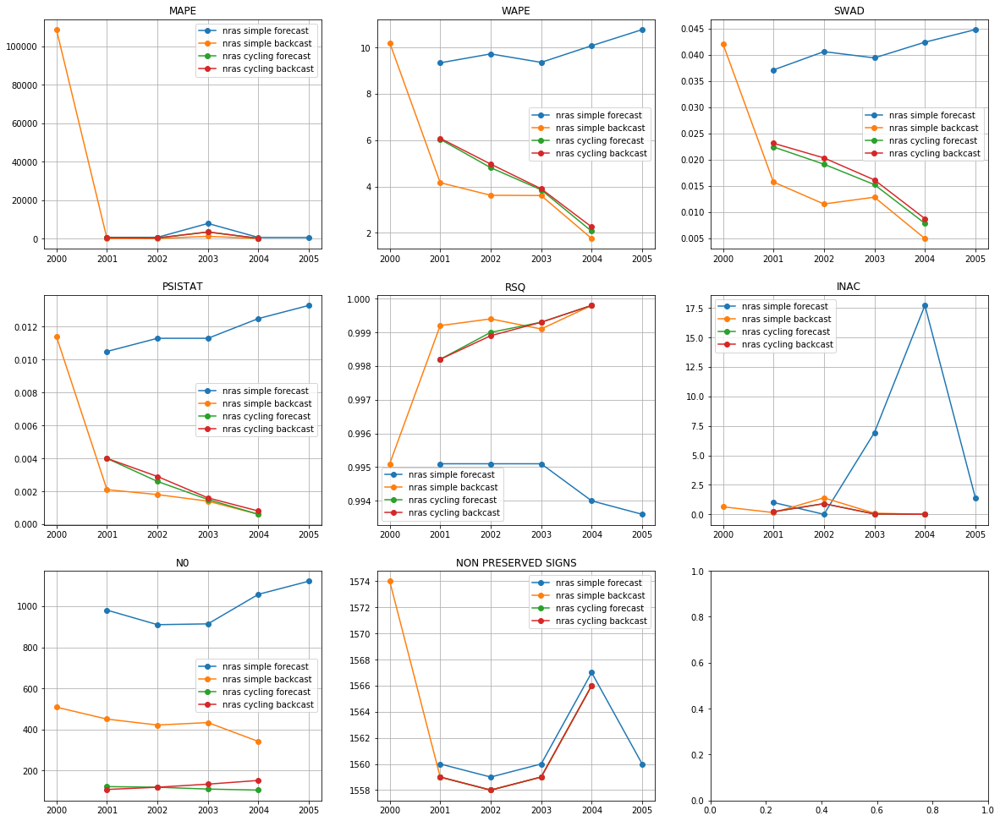

insd simple forecast
insd simple backcast
final cycle: 10
insd cycling forecast
final cycle: 10
insd cycling backcast


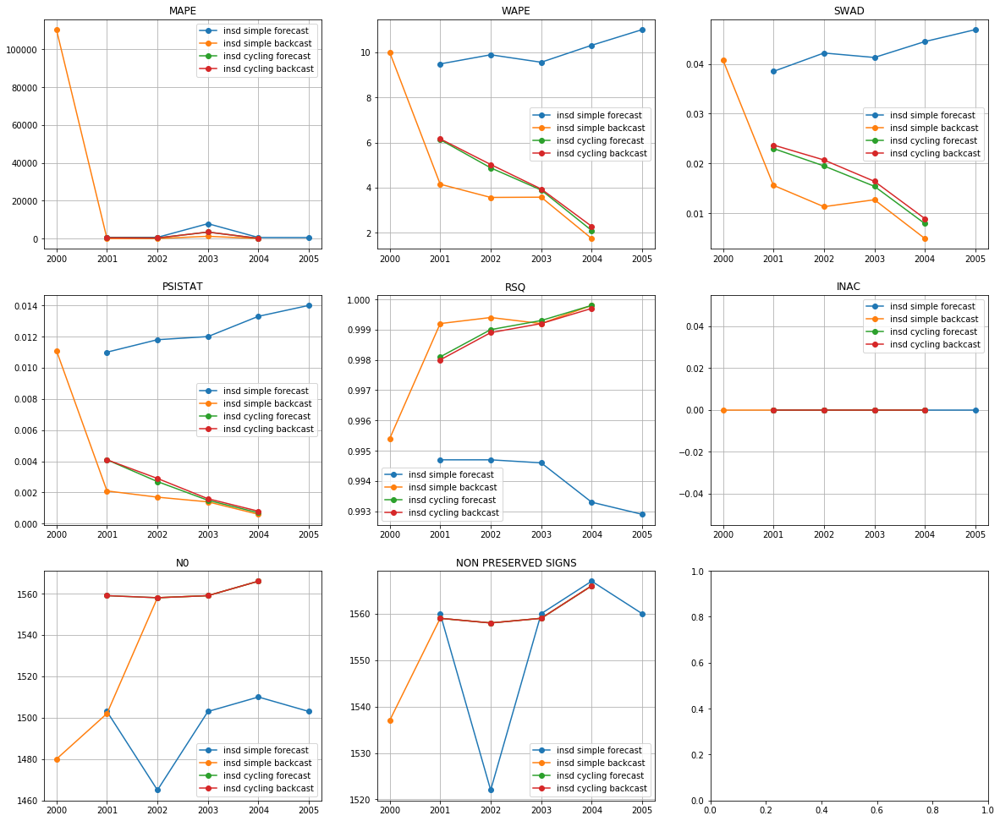

status was bad, new status: 3
status was bad twice, new status: 2
status was bad, new status: 3
status was bad twice, new status: 2
kuroda simple forecast
status was bad, new status: 3
status was bad twice, new status: 2
status was bad, new status: 3
status was bad twice, new status: 2
kuroda simple backcast
status was bad, new status: 3
status was bad twice, new status: 2
status was bad, new status: 3
status was bad twice, new status: 2
status was bad, new status: 3
status was bad twice, new status: 2
status was bad, new status: 3
status was bad twice, new status: 2
status was bad, new status: 3
status was bad twice, new status: 2
status was bad, new status: 3
status was bad twice, new status: 2
status was bad, new status: 12
status was bad twice, new status: 2
status was bad, new status: 3
status was bad twice, new status: 2
status was bad, new status: 3
status was bad twice, new status: 2
status was bad, new status: 3
status was bad twice, new status: 2
status was bad, new status: 3

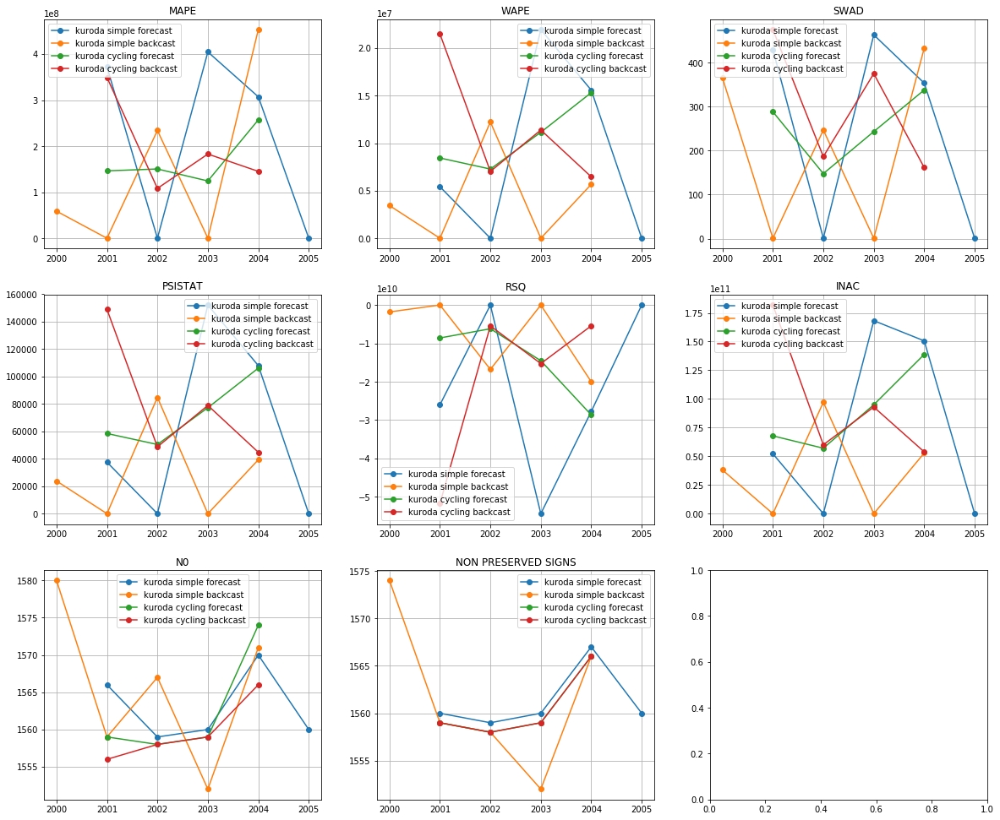

,MAPE,MAPE_R,WAPE,WAPE_R,SWAD,SWAD_R,PSISTAT,PSISTAT_R,RSQ,RSQ_R,INAC,INAC_R,N0,NON PRESERVED SIGNS,R_all,CmR
nras cycling forecast,1.060590e+03,1,4.195375e+00,1,0.016125,1,0.002175,1,9.990750e-01,1,2.891000e-01,5,113.00,1560.5,10,1
insd cycling forecast,1.063889e+03,2,4.250775e+00,2,0.016450,2,0.002250,2,9.990500e-01,2,0.000000e+00,1,1560.50,1560.5,11,2
nras cycling backcast,1.070924e+03,3,4.302375e+00,3,0.017050,3,0.002325,3,9.990500e-01,2,2.891250e-01,6,127.25,1560.5,20,3
insd cycling backcast,1.073615e+03,4,4.353900e+00,4,0.017425,6,0.002350,4,9.989500e-01,4,0.000000e+00,1,1560.50,1560.5,23,4
insd simple backcast,2.233358e+04,8,4.607980e+00,5,0.017060,4,0.003380,5,9.986000e-01,5,0.000000e+00,1,1533.00,1555.8,28,5
nras simple backcast,2.196646e+04,7,4.672180e+00,6,0.017400,5,0.003460,6,9.985200e-01,6,4.566000e-01,7,430.60,1563.2,37,6
insd simple forecast,2.045847e+03,5,1.004330e+01,8,0.042680,8,0.012420,8,9.940400e-01,8,0.000000e+00,1,1496.80,1553.8,38,7
nras simple forecast,2.046293e+03,6,9.848560e+00,7,0.040860,7,0.011780,7,9.945800e-01,7,5.408560e+00,8,997.00,1561.2,42,8
kuroda simple backcast,1.493354e+08,9,4.268063e+06,9,209.461000,9,29583.345400,9,-7.723290e+09,9,3.762624e+10,9,1565.80,1561.8,54,9
kuroda simple forecast,2.168454e+08,12,8.586808e+06,10,249.661620,10,59516.160940,10,-2.163908e+10,12,7.422420e+10,10,1563.00,1561.2,64,10


[2005 2006 2007 2008 2009 2010]
available mtypes: [0]
nras simple forecast
nras simple backcast
final cycle: 10
nras cycling forecast
final cycle: 10
nras cycling backcast


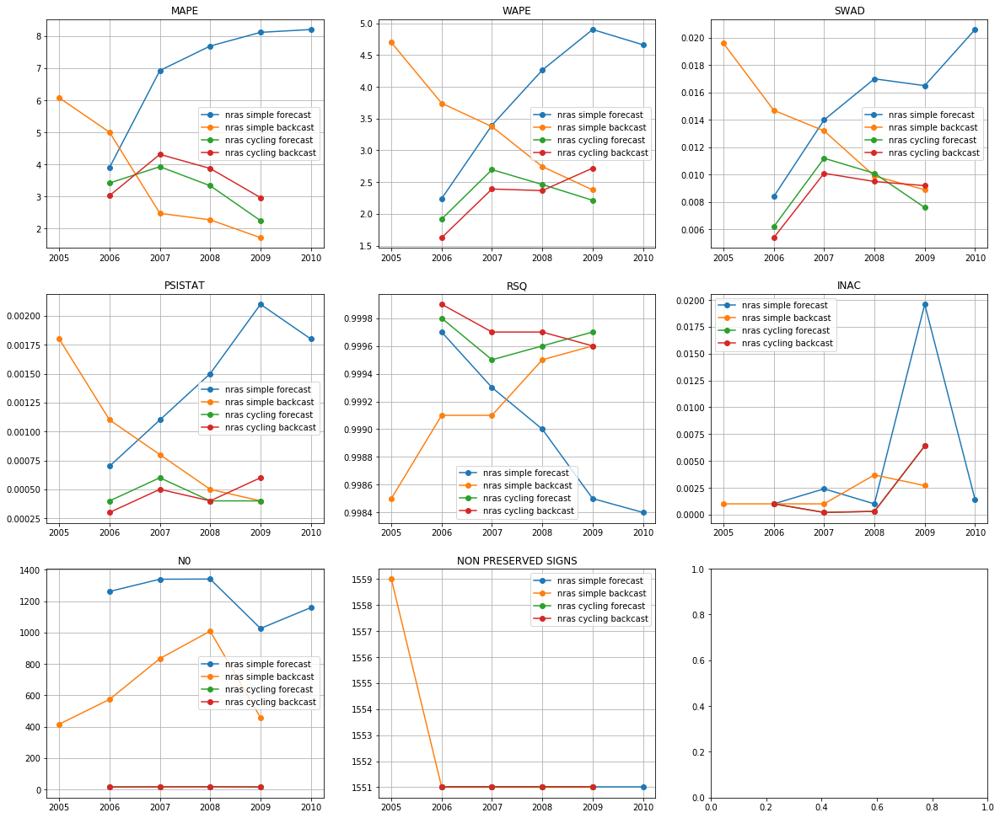

insd simple forecast
insd simple backcast
final cycle: 10
insd cycling forecast
final cycle: 10
insd cycling backcast


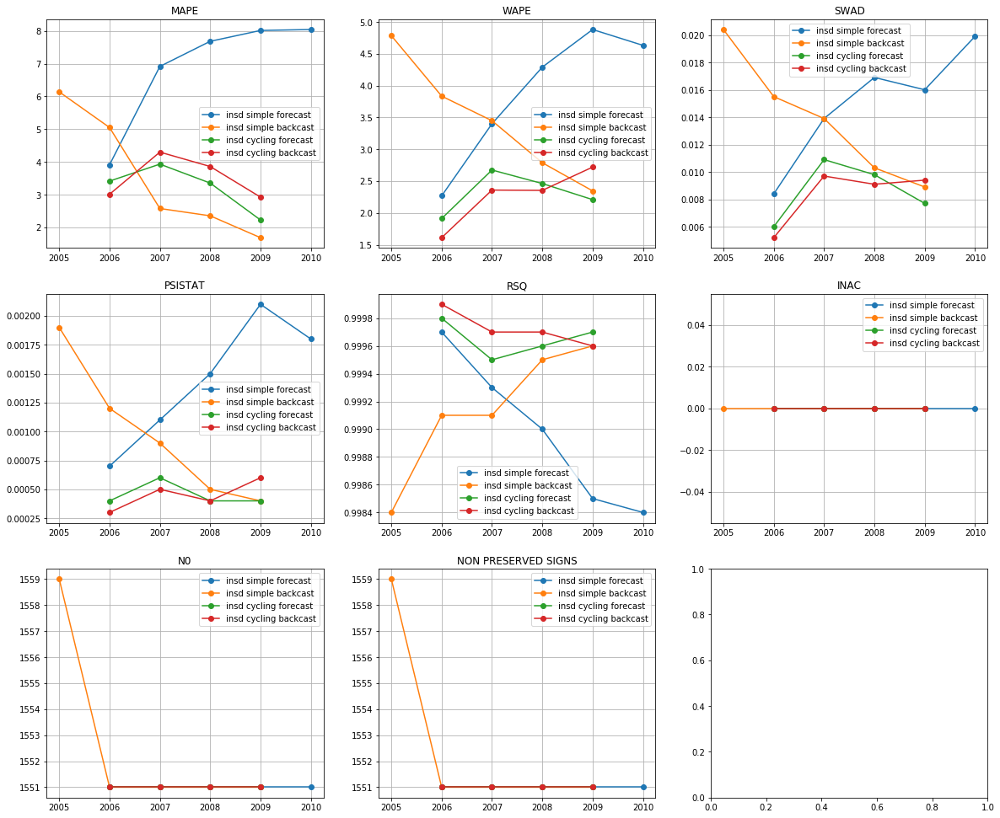

status was bad, new status: 3
status was bad twice, new status: 2
status was bad, new status: 3
status was bad twice, new status: 2
kuroda simple forecast
status was bad, new status: 3
status was bad twice, new status: 2
status was bad, new status: 3
status was bad twice, new status: 2
status was bad, new status: 12
status was bad twice, new status: 2
kuroda simple backcast
status was bad, new status: 3
status was bad twice, new status: 2
status was bad, new status: 3
status was bad twice, new status: 2
status was bad, new status: 12
status was bad twice, new status: 2
status was bad, new status: 12
status was bad twice, new status: 2


ERROR:root:Traceback (most recent call last):
  File "C:\Users\Asus\Google Диск\ДИПЛОМ\Disaggregation\scripts\kuroda.py", line 159, in kuroda
    result = np.array([v.x for v in model.getVars()])
  File "C:\Users\Asus\Google Диск\ДИПЛОМ\Disaggregation\scripts\kuroda.py", line 159, in <listcomp>
    result = np.array([v.x for v in model.getVars()])
  File "var.pxi", line 84, in gurobipy.Var.__getattr__
  File "var.pxi", line 112, in gurobipy.Var.getAttr
  File "attrutil.pxi", line 100, in gurobipy.__getattr
AttributeError: Unable to retrieve attribute 'x'

ERROR:root:Traceback (most recent call last):
  File "C:\Users\Asus\Google Диск\ДИПЛОМ\Disaggregation\scripts\vectorization.py", line 150, in tomatrix
    return a.reshape((shape[1], shape[0])).T
AttributeError: 'int' object has no attribute 'reshape'



status was bad, new status: 5
final cycle: 10
kuroda cycling forecast
status was bad, new status: 3
status was bad twice, new status: 2
status was bad, new status: 3
status was bad twice, new status: 2
status was bad, new status: 3
status was bad twice, new status: 2
status was bad, new status: 3
status was bad twice, new status: 2
status was bad, new status: 3
status was bad twice, new status: 2
status was bad, new status: 12
status was bad twice, new status: 2
status was bad, new status: 3
status was bad twice, new status: 2
status was bad, new status: 3
status was bad twice, new status: 2
status was bad, new status: 3
status was bad twice, new status: 2
status was bad, new status: 3
status was bad twice, new status: 2
status was bad, new status: 3
status was bad twice, new status: 2
status was bad, new status: 3
status was bad twice, new status: 2
status was bad, new status: 12
status was bad twice, new status: 2
status was bad, new status: 3
status was bad twice, new status: 2
stat

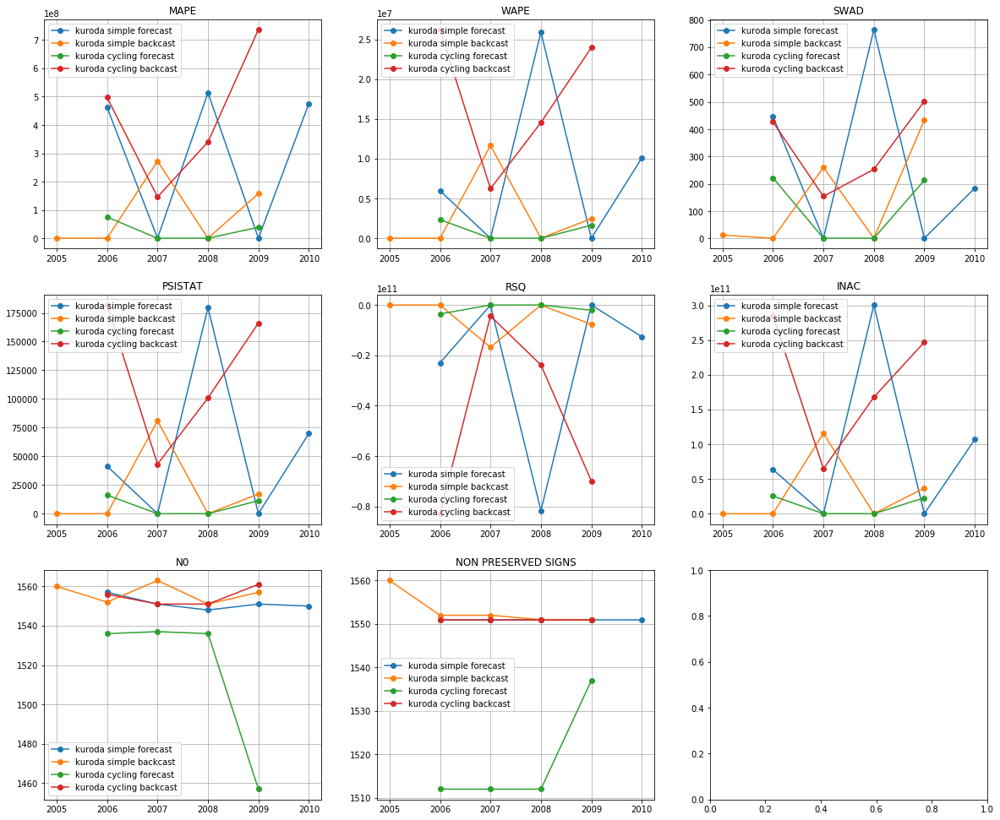

,MAPE,MAPE_R,WAPE,WAPE_R,SWAD,SWAD_R,PSISTAT,PSISTAT_R,RSQ,RSQ_R,INAC,INAC_R,N0,NON PRESERVED SIGNS,R_all,CmR
insd cycling backcast,3.522125e+00,4,2.260725e+00,1,0.008350,1,0.00045,1,9.997250e-01,1,0.000000e+00,1,1551.00,1551.00,9,1
insd cycling forecast,3.229550e+00,1,2.313750e+00,3,0.008600,3,0.00045,1,9.996500e-01,3,0.000000e+00,1,1551.00,1551.00,12,2
nras cycling backcast,3.547275e+00,5,2.275700e+00,2,0.008550,2,0.00045,1,9.997250e-01,1,1.975000e-03,6,14.00,1551.00,17,3
nras cycling forecast,3.235925e+00,2,2.322400e+00,4,0.008775,4,0.00045,1,9.996500e-01,3,1.975000e-03,6,15.25,1551.00,20,4
nras simple backcast,3.510780e+00,3,3.387620e+00,5,0.013260,5,0.00092,5,9.991600e-01,5,1.880000e-03,5,658.20,1552.60,28,5
insd simple backcast,3.559640e+00,6,3.440300e+00,6,0.013800,6,0.00098,6,9.991400e-01,6,0.000000e+00,1,1552.60,1552.60,31,6
insd simple forecast,6.912800e+00,7,3.894140e+00,8,0.015020,7,0.00144,7,9.989800e-01,7,0.000000e+00,1,1551.00,1551.00,37,7
nras simple forecast,6.968680e+00,8,3.893680e+00,7,0.015300,8,0.00144,7,9.989800e-01,7,5.080000e-03,8,1225.60,1551.00,45,8
kuroda cycling forecast,2.846090e+07,9,9.942060e+05,9,109.305875,9,6890.89980,9,-1.397162e+09,9,1.206308e+10,9,1516.50,1518.25,54,9
kuroda simple backcast,8.614326e+07,10,2.828161e+06,10,141.552420,10,19598.19726,10,-4.896167e+09,10,3.056063e+10,10,1556.60,1553.20,60,10


iot
[2000 2001 2002 2003 2004 2005 2010]
available mtypes: [0, 2]
0 LinearRegression(copy_X=True, fit_intercept=True, n_jobs=1, normalize=False) False
using mtt 0
mtt2 ridge backcast
0 Ridge(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=None,
   normalize=False, random_state=None, solver='auto', tol=0.001) False
using mtt 0
mtt2 ridge backcast
0 Lasso(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=1000,
   normalize=False, positive=False, precompute=False, random_state=None,
   selection='cyclic', tol=0.0001, warm_start=False) False
using mtt 0
mtt2 ridge backcast
2 LinearRegression(copy_X=True, fit_intercept=True, n_jobs=1, normalize=False) False
using mtt ii
mtt2 ridge backcast
2 Ridge(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=None,
   normalize=False, random_state=None, solver='auto', tol=0.001) False
using mtt ii
mtt2 ridge backcast
2 Lasso(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=1000,
   normalize=False, positive=False, precompute=False, random

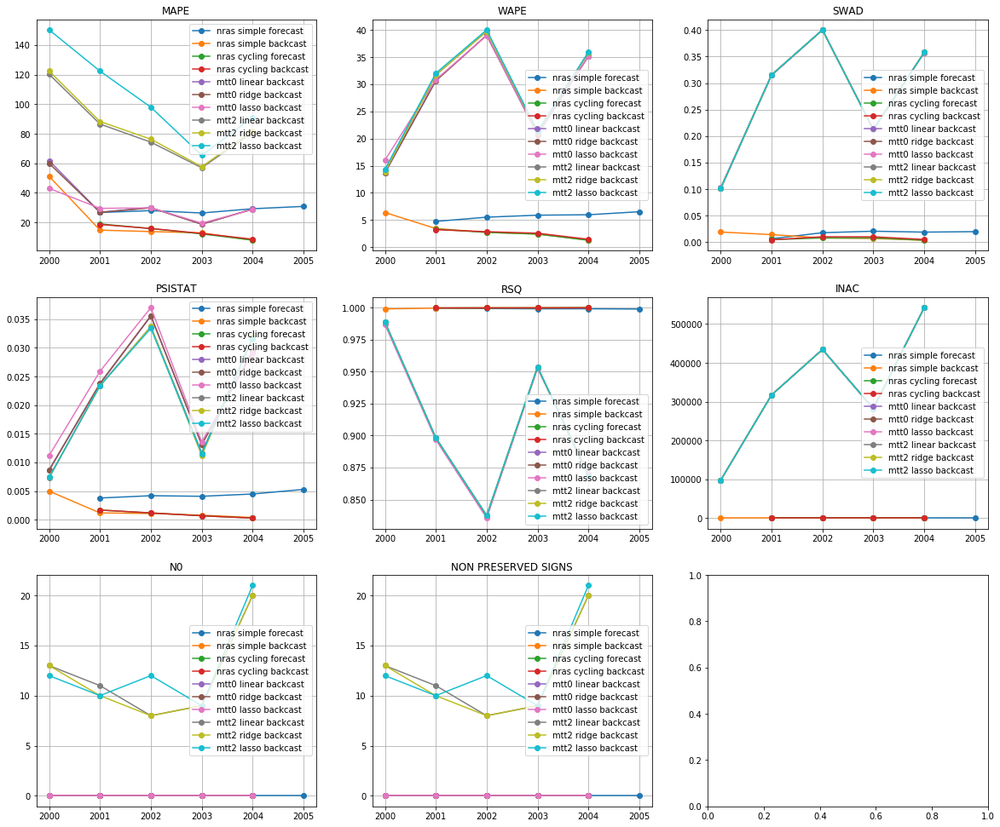

insd simple forecast
insd simple backcast
final cycle: 10
insd cycling forecast
final cycle: 10
insd cycling backcast


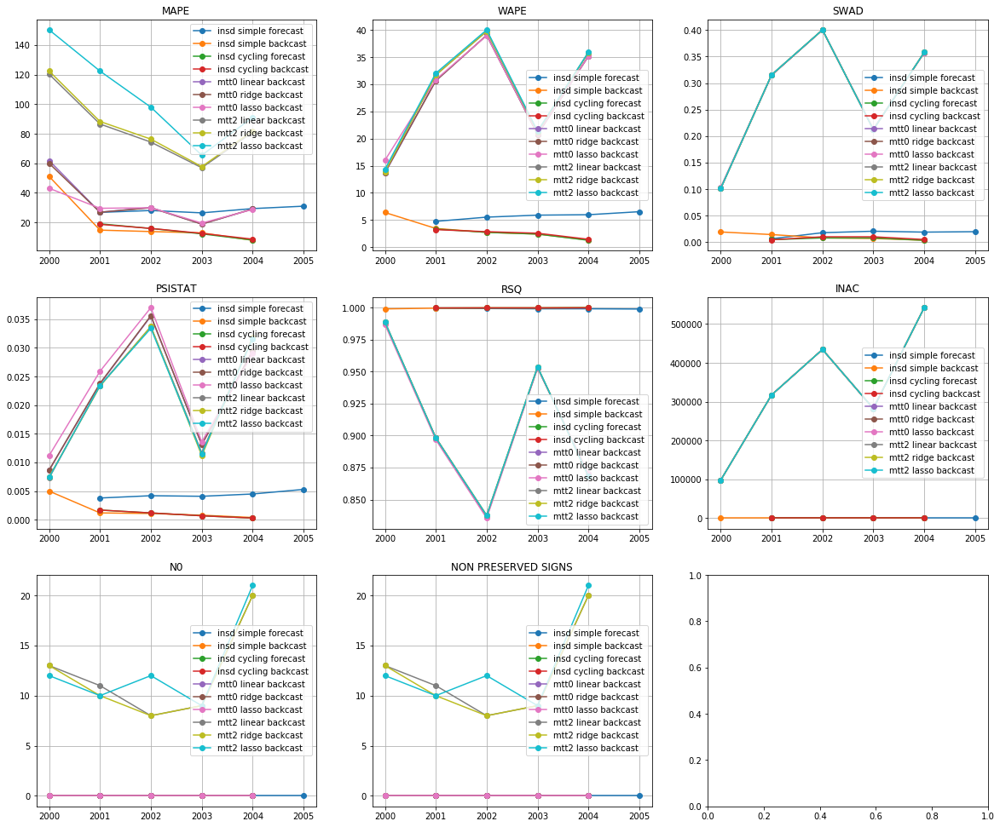

kuroda simple forecast
kuroda simple backcast
final cycle: 10
kuroda cycling forecast
final cycle: 10
kuroda cycling backcast


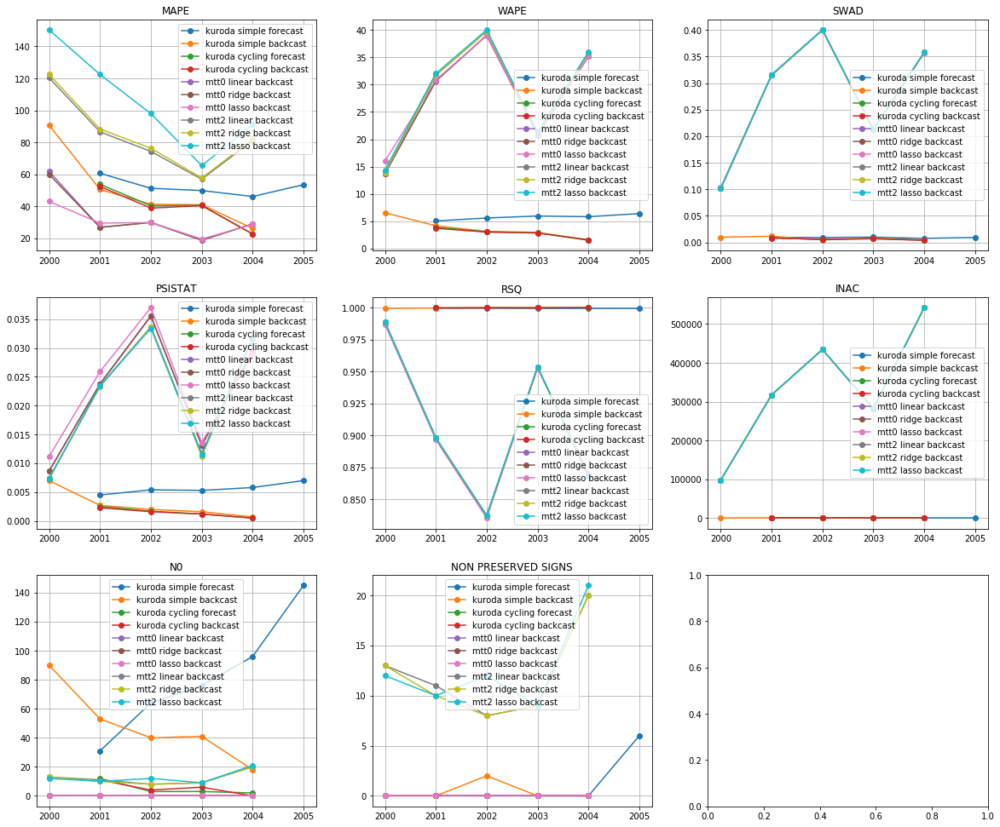

,MAPE,MAPE_R,WAPE,WAPE_R,SWAD,SWAD_R,PSISTAT,PSISTAT_R,RSQ,RSQ_R,INAC,INAC_R,N0,NON PRESERVED SIGNS,R_all,CmR
insd cycling forecast,13.750950,1,2.436400,2,0.006150,2,0.000975,1,0.999850,1,0.00000,1,0.00,0.0,8,1
nras cycling forecast,13.757450,2,2.435325,1,0.006200,3,0.000975,1,0.999850,1,0.00025,9,0.00,0.0,17,2
insd cycling backcast,13.908100,3,2.526375,4,0.007525,5,0.000975,1,0.999825,3,0.00000,1,0.00,0.0,17,2
nras cycling backcast,13.914400,4,2.525875,3,0.007550,6,0.000975,1,0.999825,3,0.00025,9,0.00,0.0,26,4
kuroda cycling backcast,38.603650,12,2.798425,5,0.006125,1,0.001400,5,0.999800,5,0.00000,1,5.25,0.0,29,5
kuroda cycling forecast,39.319725,13,2.841050,6,0.006225,4,0.001475,6,0.999800,5,0.00000,1,5.00,0.0,35,6
insd simple backcast,20.047020,5,3.260960,8,0.010520,10,0.001700,7,0.999620,9,0.00000,1,0.00,0.0,40,7
kuroda simple backcast,49.921640,14,3.683280,9,0.007700,7,0.002800,9,0.999680,7,0.00000,1,48.40,0.4,47,8
nras simple backcast,20.110340,6,3.256200,7,0.010440,9,0.001700,7,0.999640,8,0.00046,12,0.00,0.0,49,9
insd simple forecast,28.277540,8,5.738040,11,0.016780,11,0.004380,10,0.999180,11,0.00000,1,0.00,0.0,52,10


[2000 2005 2006 2007 2008 2009 2010]
available mtypes: [0, 2]
0 LinearRegression(copy_X=True, fit_intercept=True, n_jobs=1, normalize=False) True
using mtt 0
mtt2 ridge forecast
0 Ridge(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=None,
   normalize=False, random_state=None, solver='auto', tol=0.001) True
using mtt 0
mtt2 ridge forecast
0 Lasso(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=1000,
   normalize=False, positive=False, precompute=False, random_state=None,
   selection='cyclic', tol=0.0001, warm_start=False) True
using mtt 0
mtt2 ridge forecast
2 LinearRegression(copy_X=True, fit_intercept=True, n_jobs=1, normalize=False) True
using mtt ii
mtt2 ridge forecast
2 Ridge(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=None,
   normalize=False, random_state=None, solver='auto', tol=0.001) True
using mtt ii
mtt2 ridge forecast
2 Lasso(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=1000,
   normalize=False, positive=False, precompute=False, random_state=No

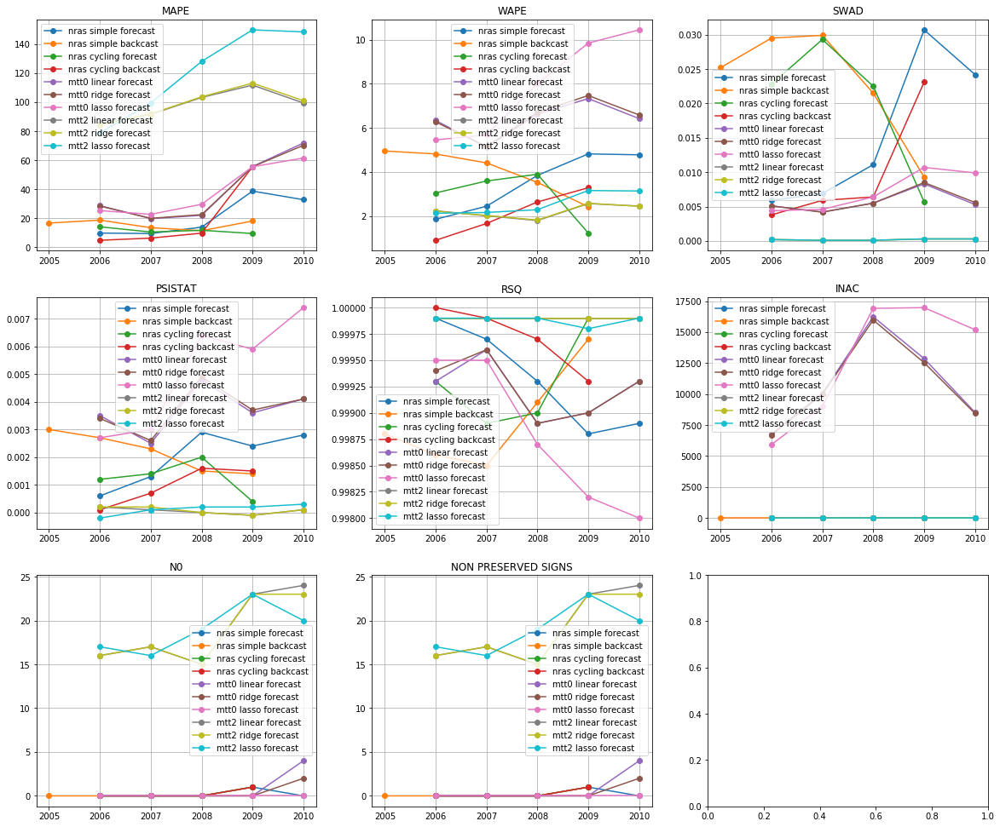

insd simple forecast
insd simple backcast
final cycle: 4
insd cycling forecast
final cycle: 4
insd cycling backcast


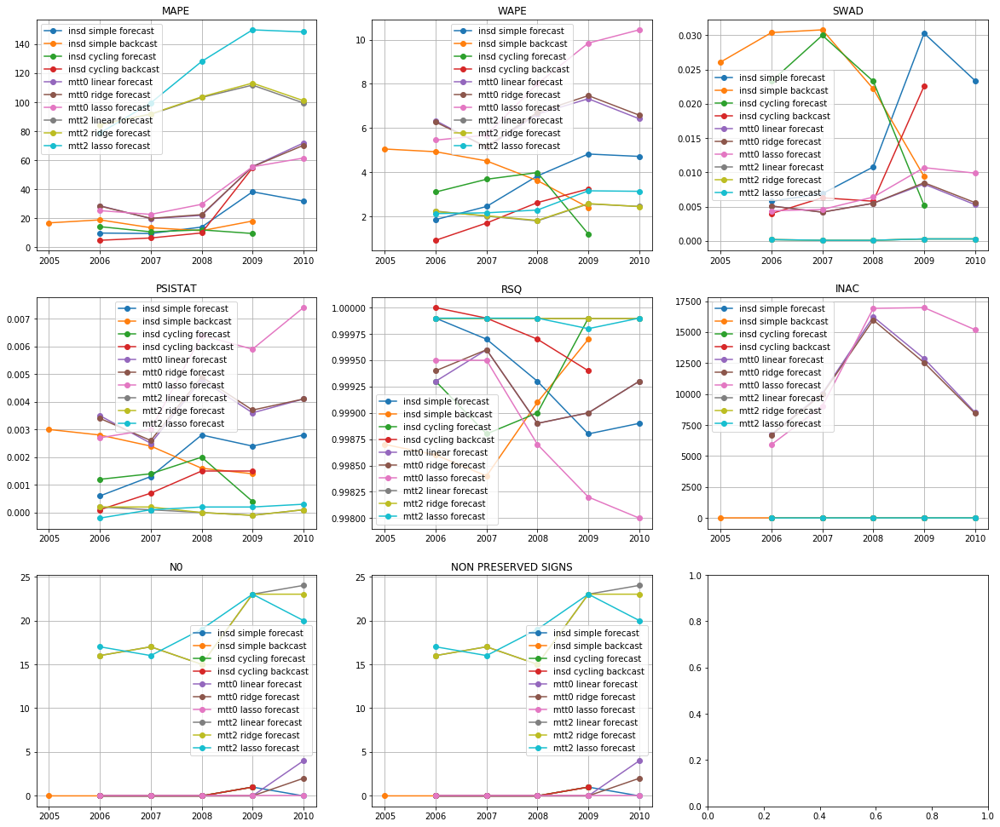

kuroda simple forecast
kuroda simple backcast
final cycle: 10
kuroda cycling forecast
final cycle: 10
kuroda cycling backcast


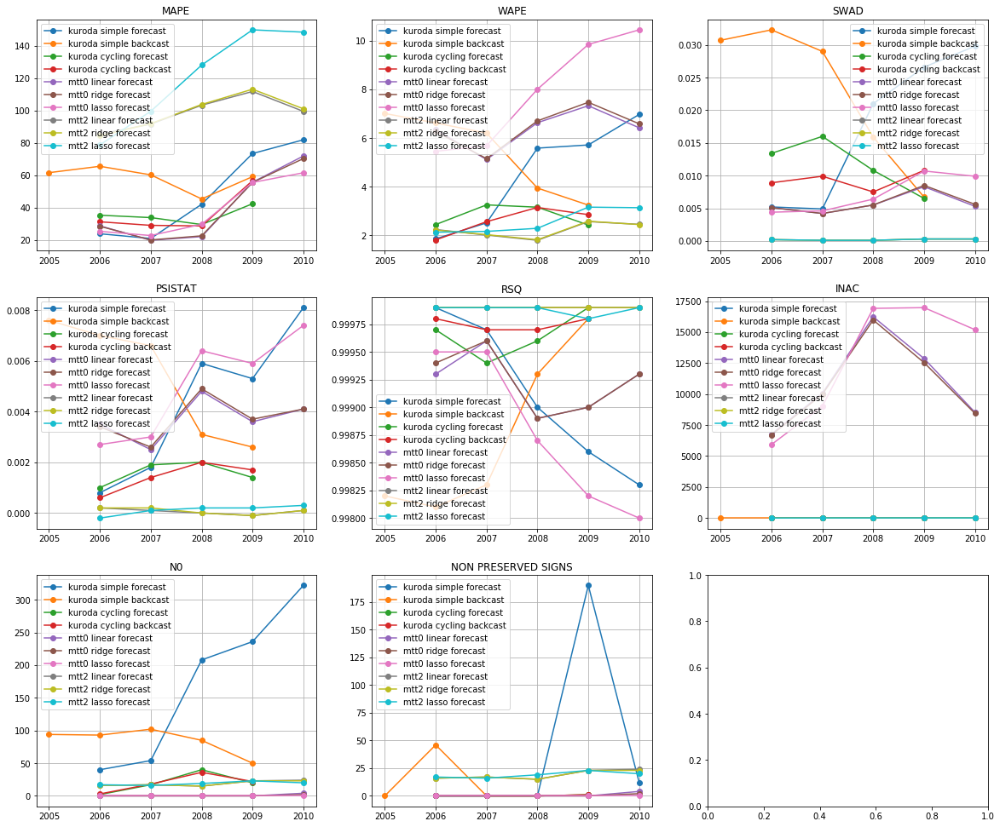

,MAPE,MAPE_R,WAPE,WAPE_R,SWAD,SWAD_R,PSISTAT,PSISTAT_R,RSQ,RSQ_R,INAC,INAC_R,N0,NON PRESERVED SIGNS,R_all,CmR
insd cycling backcast,18.939975,5,2.123525,1,0.009675,8,0.000950,4,0.999750,4,0.000000,1,0.25,0.25,23,1
mtt2 linear forecast,98.278880,16,2.214760,3,0.000200,1,0.000060,1,0.999900,1,11.897220,13,19.00,19.00,35,2
kuroda cycling backcast,36.317700,10,2.594550,6,0.009275,7,0.001425,8,0.999750,4,0.000000,1,19.75,0.25,36,3
nras cycling backcast,19.036850,6,2.124150,2,0.009800,9,0.000975,5,0.999725,6,0.000350,10,0.25,0.25,38,4
mtt2 ridge forecast,98.836840,17,2.219780,4,0.000200,1,0.000080,2,0.999900,1,11.897220,13,18.80,18.80,38,4
mtt2 lasso forecast,120.938460,18,2.576720,5,0.000200,1,0.000120,3,0.999880,3,11.897220,13,19.00,19.00,43,6
kuroda cycling forecast,35.186425,9,2.820575,7,0.011675,10,0.001575,9,0.999650,7,0.000000,1,19.75,0.25,43,6
insd cycling forecast,11.565375,2,2.995625,9,0.020450,15,0.001250,6,0.999250,11,0.000000,1,0.25,0.25,44,8
insd simple forecast,20.637680,7,3.536800,10,0.015440,11,0.001980,10,0.999320,8,0.000000,1,0.20,0.20,47,9
nras cycling forecast,11.407950,1,2.941800,8,0.020075,14,0.001250,6,0.999275,10,0.000275,9,0.25,0.25,48,10


In [35]:
metrics_res['NLD'] = get_results('NLD')

USA
use basic I+II
[1997 1998 1999 2000 2001 2002]
available mtypes: [0]
nras simple forecast
nras simple backcast
final cycle: 10
nras cycling forecast
final cycle: 10
nras cycling backcast


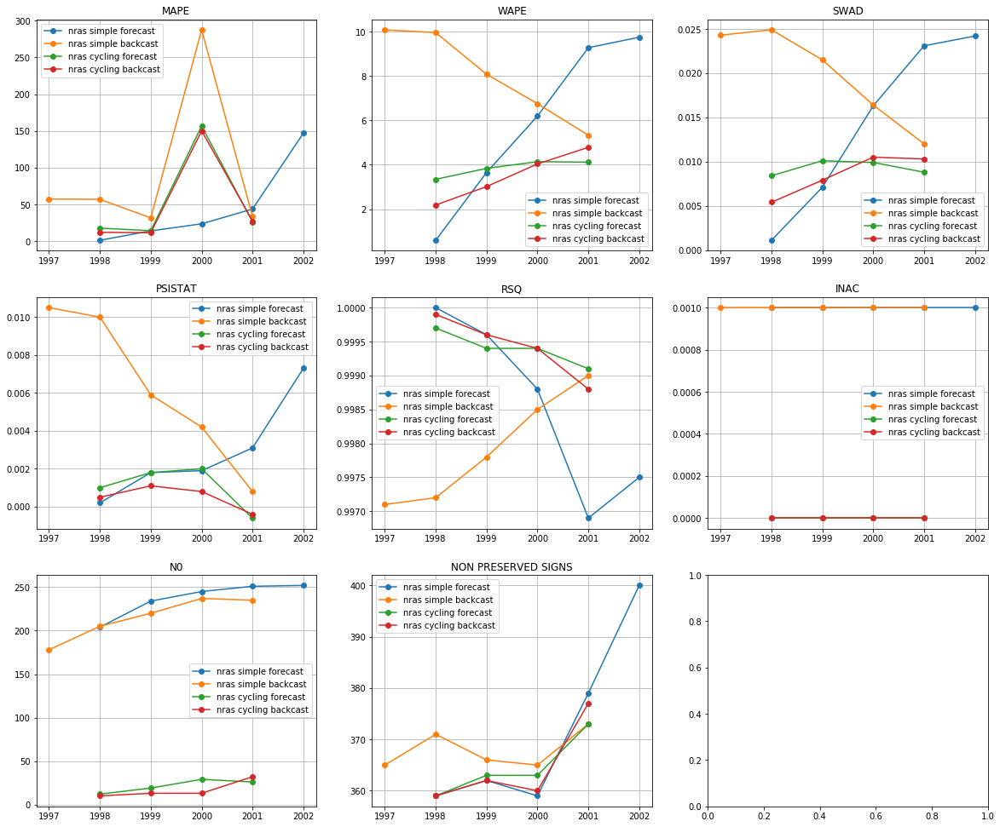

insd simple forecast
insd simple backcast
final cycle: 10
insd cycling forecast
final cycle: 10
insd cycling backcast


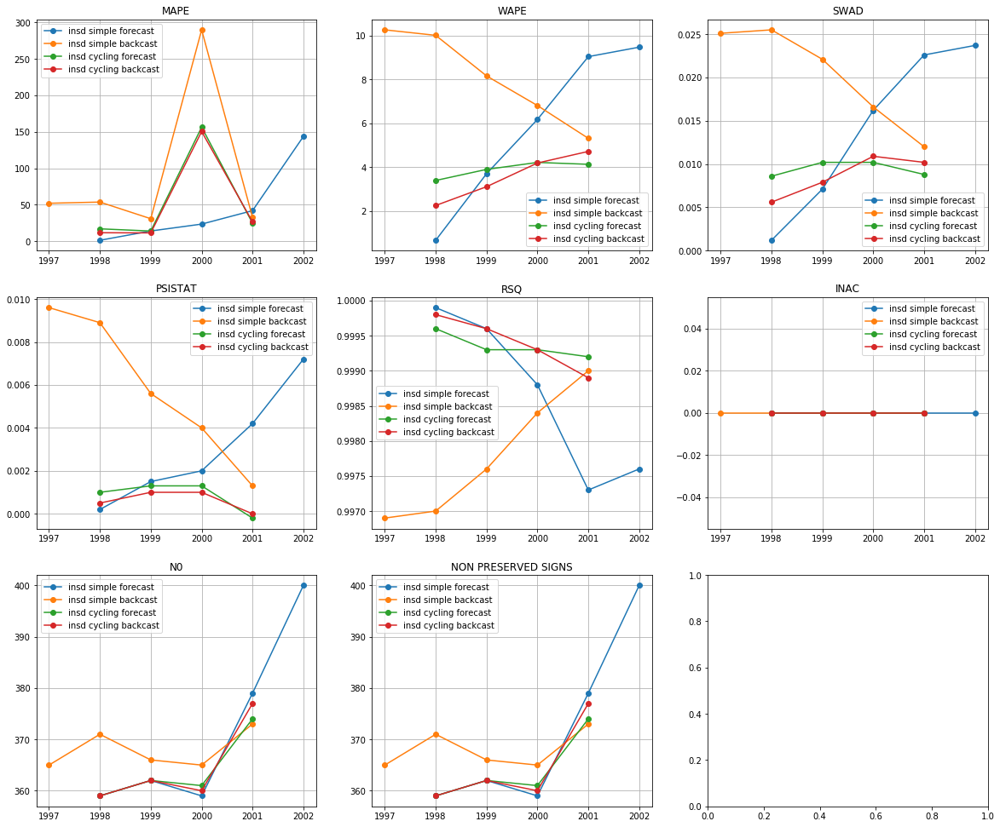

kuroda simple forecast
kuroda simple backcast
final cycle: 10
kuroda cycling forecast
final cycle: 10
kuroda cycling backcast


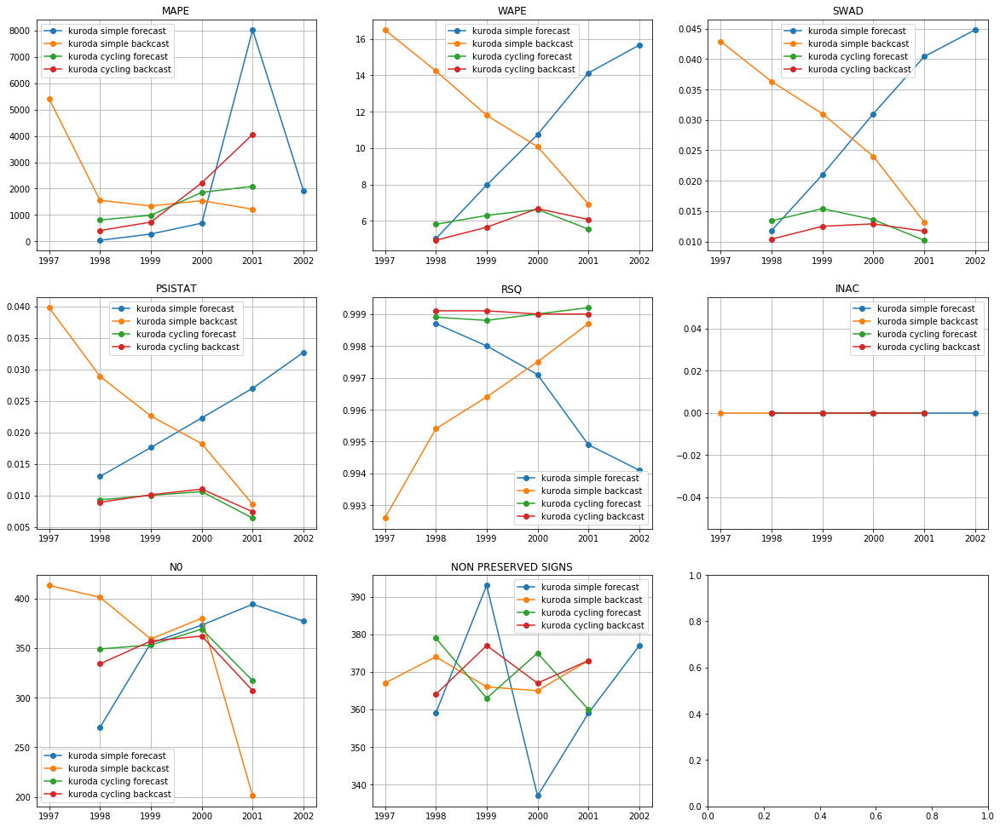

,MAPE,MAPE_R,WAPE,WAPE_R,SWAD,SWAD_R,PSISTAT,PSISTAT_R,RSQ,RSQ_R,INAC,INAC_R,N0,NON PRESERVED SIGNS,R_all,CmR
nras cycling backcast,50.282975,4,3.506625,1,0.008525,1,0.000500,1,0.999425,1,0.000,1,17.0,364.50,9,1
insd cycling backcast,50.044275,3,3.566100,2,0.008650,2,0.000625,2,0.999400,2,0.000,1,364.5,364.50,12,2
nras cycling forecast,53.747500,6,3.859500,3,0.009300,3,0.001050,4,0.999400,2,0.000,1,21.5,364.50,19,3
insd cycling forecast,53.055275,5,3.908600,4,0.009450,4,0.000850,3,0.999350,4,0.000,1,364.0,364.00,21,4
insd simple forecast,44.905460,1,5.810960,5,0.014160,7,0.003020,6,0.998640,7,0.000,1,371.8,371.80,27,5
kuroda cycling backcast,1854.502875,10,5.838150,6,0.011875,5,0.009350,10,0.999050,5,0.000,1,340.0,370.25,37,6
kuroda cycling forecast,1437.159550,9,6.075400,8,0.013150,6,0.009075,9,0.998975,6,0.000,1,347.0,369.25,39,7
nras simple forecast,45.945640,2,5.890720,7,0.014360,8,0.002860,5,0.998560,8,0.001,11,237.2,371.80,41,8
insd simple backcast,91.834240,7,8.113440,10,0.020260,10,0.005880,7,0.997780,10,0.000,1,368.0,368.00,45,9
nras simple backcast,93.438180,8,8.036220,9,0.019820,9,0.006280,8,0.997920,9,0.001,11,215.0,368.00,54,10


[2002 2003 2004 2005 2006 2007]
available mtypes: [0]
nras simple forecast
nras simple backcast
final cycle: 10
nras cycling forecast
final cycle: 10
nras cycling backcast


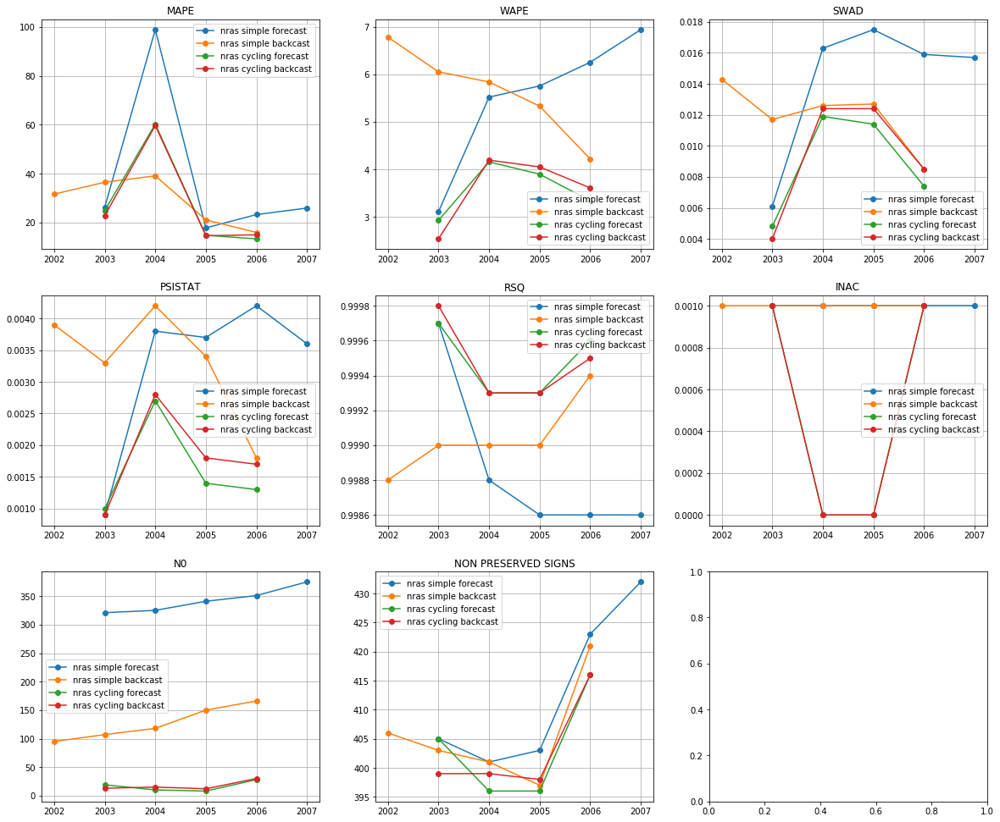

insd simple forecast
insd simple backcast
final cycle: 10
insd cycling forecast
final cycle: 10
insd cycling backcast


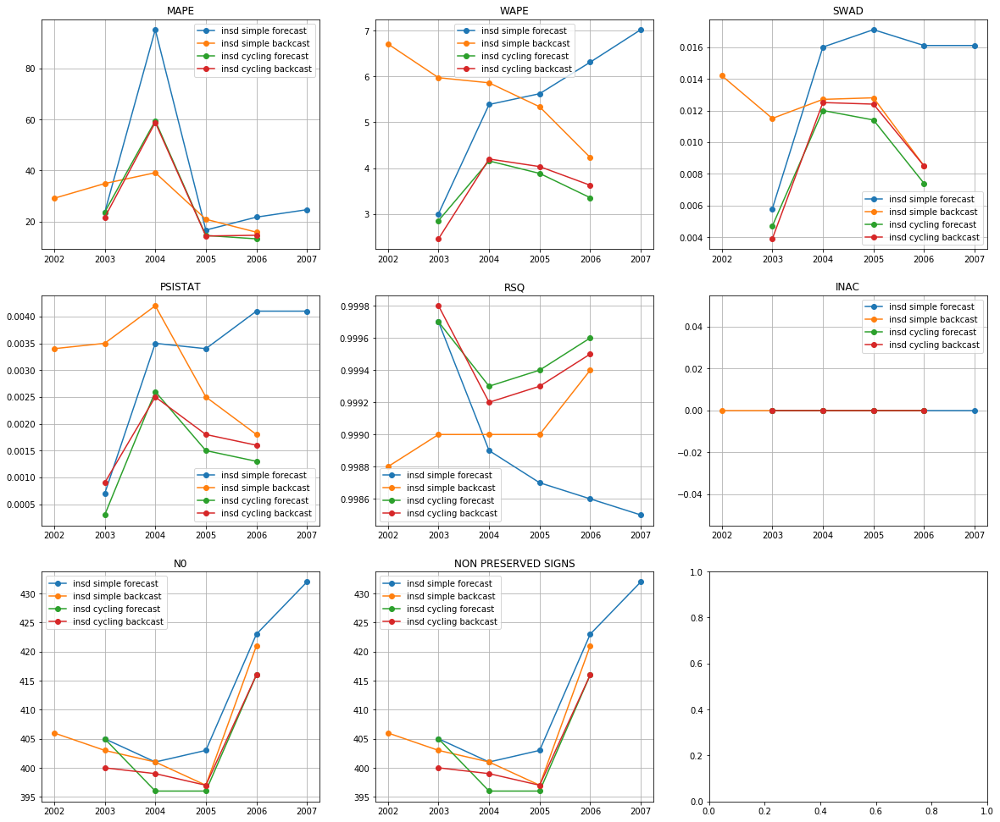

kuroda simple forecast
kuroda simple backcast
final cycle: 10
kuroda cycling forecast
final cycle: 10
kuroda cycling backcast


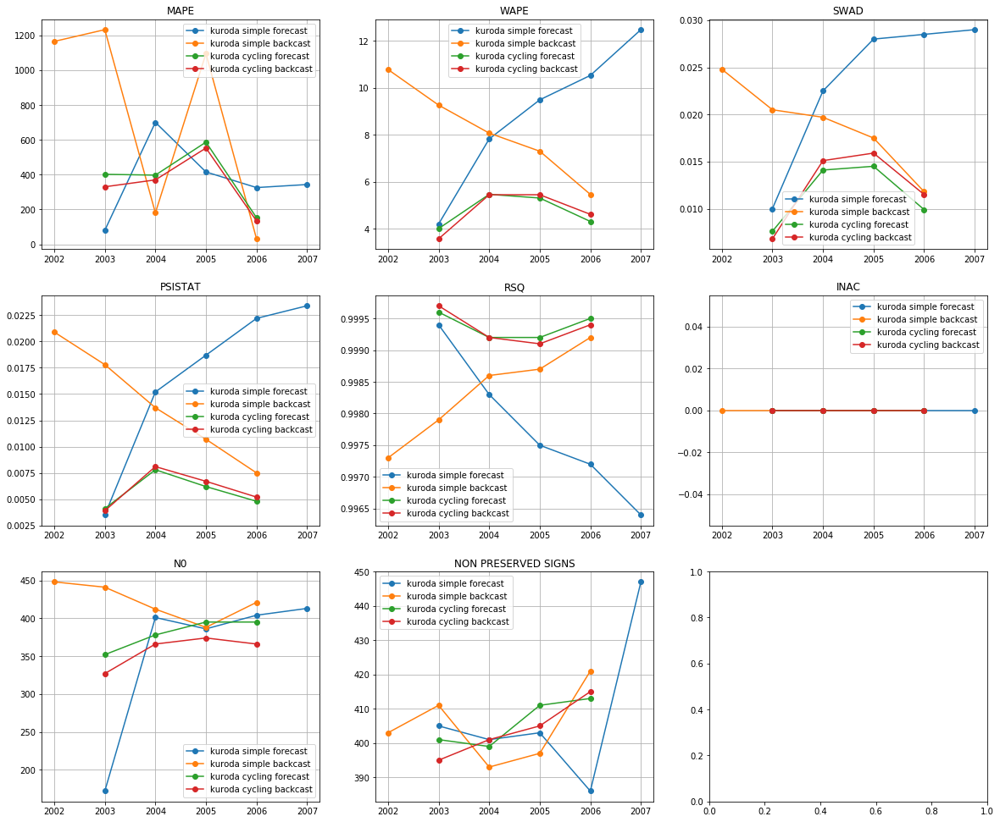

,MAPE,MAPE_R,WAPE,WAPE_R,SWAD,SWAD_R,PSISTAT,PSISTAT_R,RSQ,RSQ_R,INAC,INAC_R,N0,NON PRESERVED SIGNS,R_all,CmR
insd cycling forecast,27.727850,2,3.564225,1,0.008875,1,0.001425,1,0.999500,1,0.0000,1,403.25,403.25,7,1
insd cycling backcast,27.341800,1,3.580650,2,0.009325,3,0.001700,3,0.999450,4,0.0000,1,403.00,403.00,14,2
nras cycling forecast,28.289750,5,3.580975,3,0.008875,1,0.001600,2,0.999475,2,0.0005,9,16.25,403.25,22,3
nras cycling backcast,27.997000,4,3.598300,4,0.009325,3,0.001800,4,0.999475,3,0.0005,9,17.50,403.00,27,4
insd simple backcast,27.963040,3,5.622360,9,0.011940,6,0.003080,5,0.999040,7,0.0000,1,405.60,405.60,31,5
kuroda cycling forecast,384.782175,11,4.780800,6,0.011525,5,0.005725,9,0.999375,5,0.0000,1,380.00,406.00,37,6
insd simple forecast,36.350300,7,5.469460,7,0.014220,9,0.003160,6,0.998880,9,0.0000,1,412.80,412.80,39,7
kuroda cycling backcast,346.869725,9,4.778075,5,0.012325,8,0.005975,10,0.999350,6,0.0000,1,358.25,404.00,39,7
nras simple backcast,28.825540,6,5.645520,10,0.011960,7,0.003320,8,0.999040,7,0.0010,11,127.20,405.60,49,9
nras simple forecast,38.405940,8,5.516700,8,0.014300,10,0.003240,7,0.998860,10,0.0010,11,342.60,412.80,54,10


use basic I
[1997 1998 1999 2000 2001 2002]
available mtypes: [0]
nras simple forecast
nras simple backcast
final cycle: 10
nras cycling forecast
final cycle: 10
nras cycling backcast


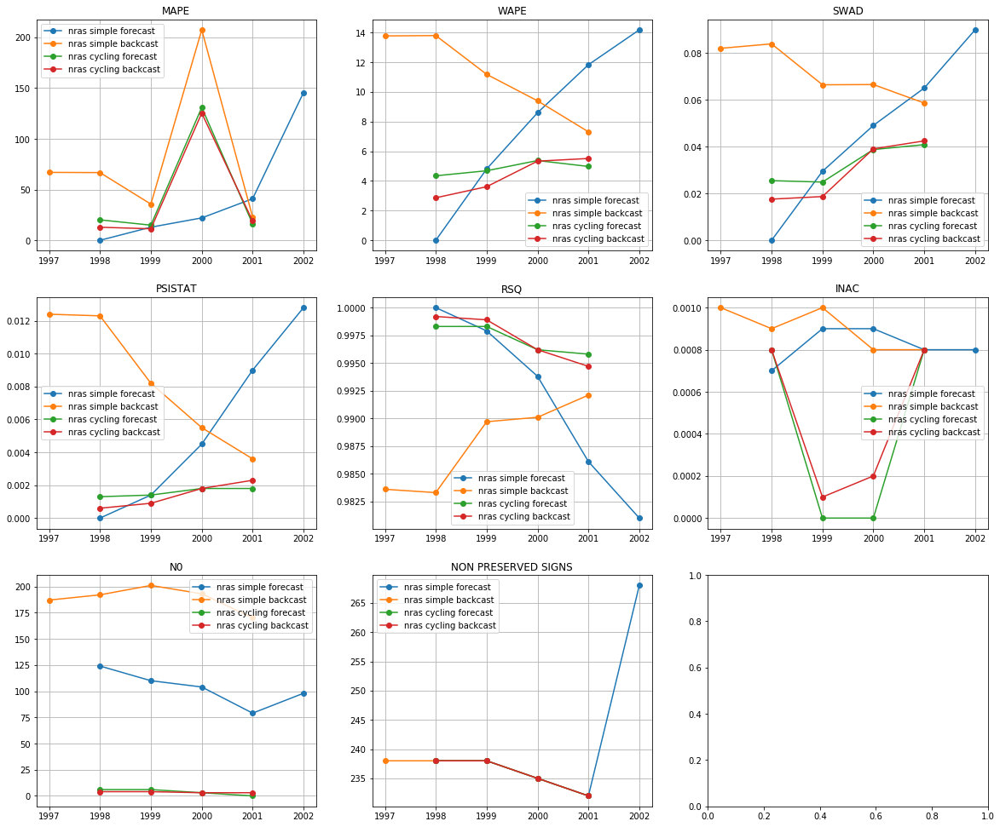

insd simple forecast
insd simple backcast
final cycle: 10
insd cycling forecast
final cycle: 10
insd cycling backcast


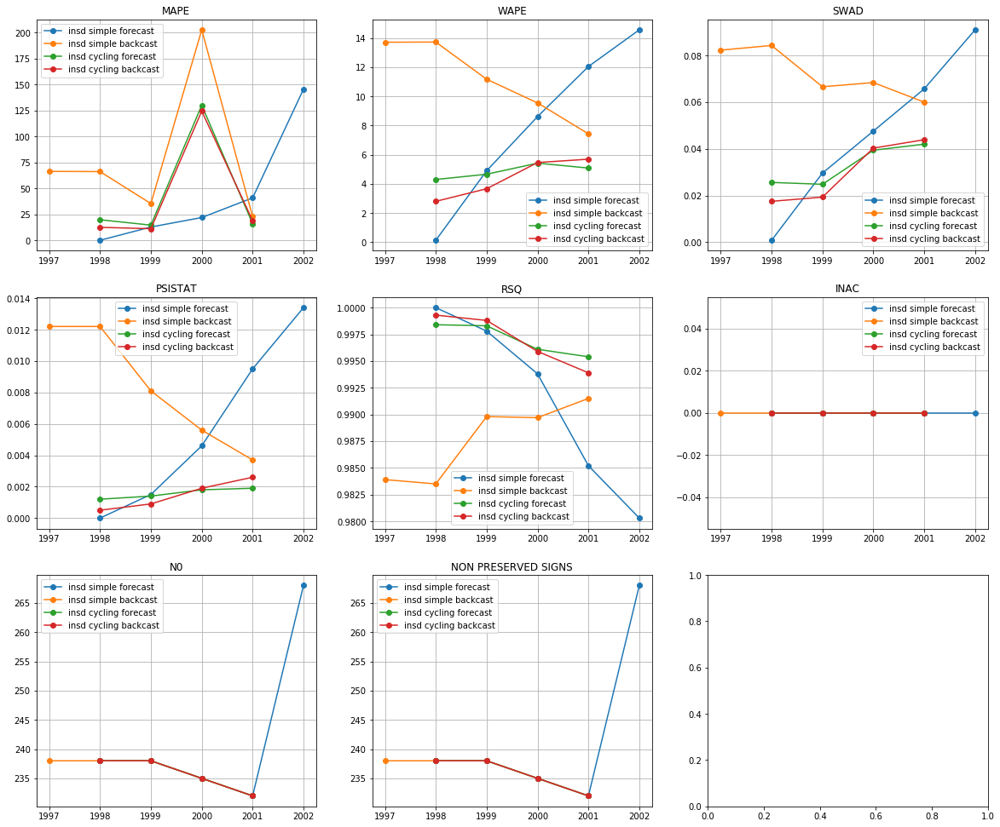

kuroda simple forecast
kuroda simple backcast
final cycle: 10
kuroda cycling forecast
final cycle: 10
kuroda cycling backcast


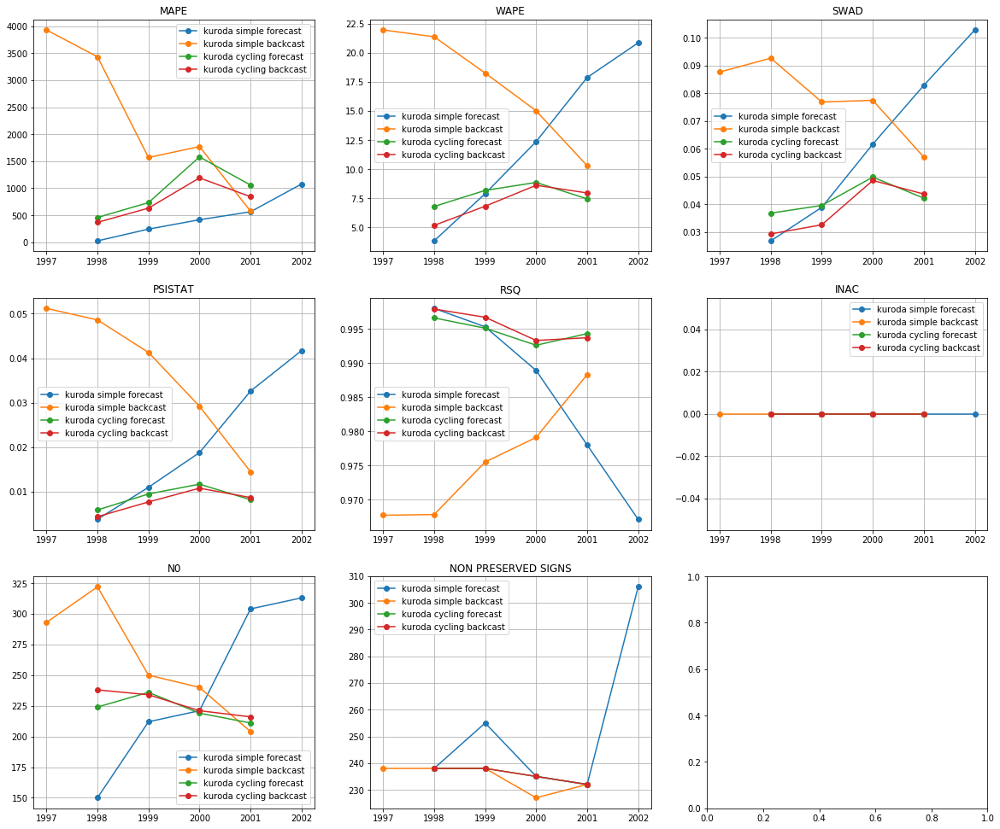

,MAPE,MAPE_R,WAPE,WAPE_R,SWAD,SWAD_R,PSISTAT,PSISTAT_R,RSQ,RSQ_R,INAC,INAC_R,N0,NON PRESERVED SIGNS,R_all,CmR
insd cycling backcast,41.920625,1,4.399125,2,0.030250,2,0.001475,2,0.996975,4,0.000000,1,235.75,235.75,12,1
nras cycling backcast,42.144425,2,4.330300,1,0.029475,1,0.001400,1,0.997250,1,0.000475,10,3.50,235.75,16,2
insd cycling forecast,45.270875,5,4.861100,4,0.032950,4,0.001575,3,0.997050,3,0.000000,1,235.75,235.75,20,3
nras cycling forecast,45.521425,6,4.845450,3,0.032525,3,0.001575,4,0.997150,2,0.000400,9,3.75,235.75,27,4
kuroda cycling backcast,759.000525,10,7.142625,5,0.038550,5,0.007900,7,0.995400,5,0.000000,1,227.25,235.75,33,5
insd simple forecast,44.381520,4,8.046240,8,0.046940,8,0.005800,6,0.991420,8,0.000000,1,242.20,242.20,35,6
nras simple forecast,44.309300,3,7.883520,7,0.046740,7,0.005540,5,0.991760,7,0.000820,11,103.00,242.20,40,7
kuroda cycling forecast,958.027300,11,7.820375,6,0.042100,6,0.008825,10,0.994650,6,0.000000,1,222.50,235.75,40,7
insd simple backcast,78.769340,7,11.117080,10,0.072320,11,0.008360,8,0.987680,10,0.000000,1,236.20,236.20,47,9
kuroda simple forecast,465.688900,9,12.565280,11,0.062640,9,0.021580,11,0.985460,11,0.000000,1,240.00,253.20,52,10


[2002 2003 2004 2005 2006 2007]
available mtypes: [0]
nras simple forecast
nras simple backcast
final cycle: 10
nras cycling forecast
final cycle: 10
nras cycling backcast


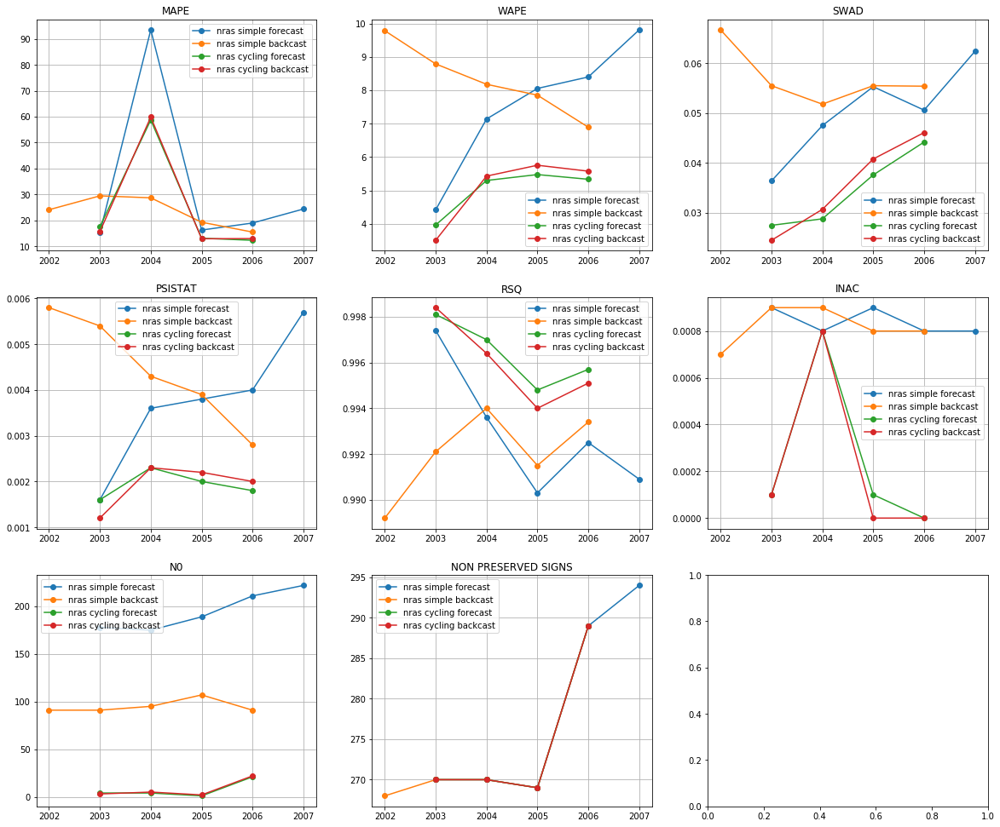

insd simple forecast
insd simple backcast
final cycle: 10
insd cycling forecast
final cycle: 10
insd cycling backcast


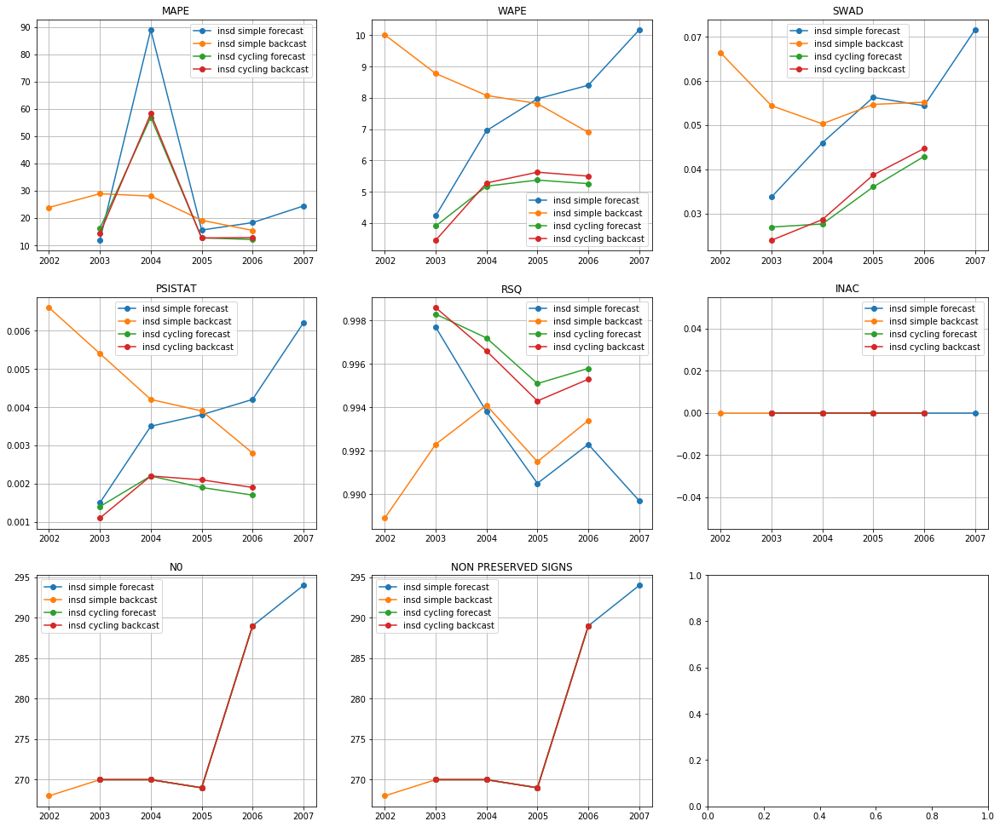

kuroda simple forecast
kuroda simple backcast
final cycle: 10
kuroda cycling forecast
final cycle: 10
kuroda cycling backcast


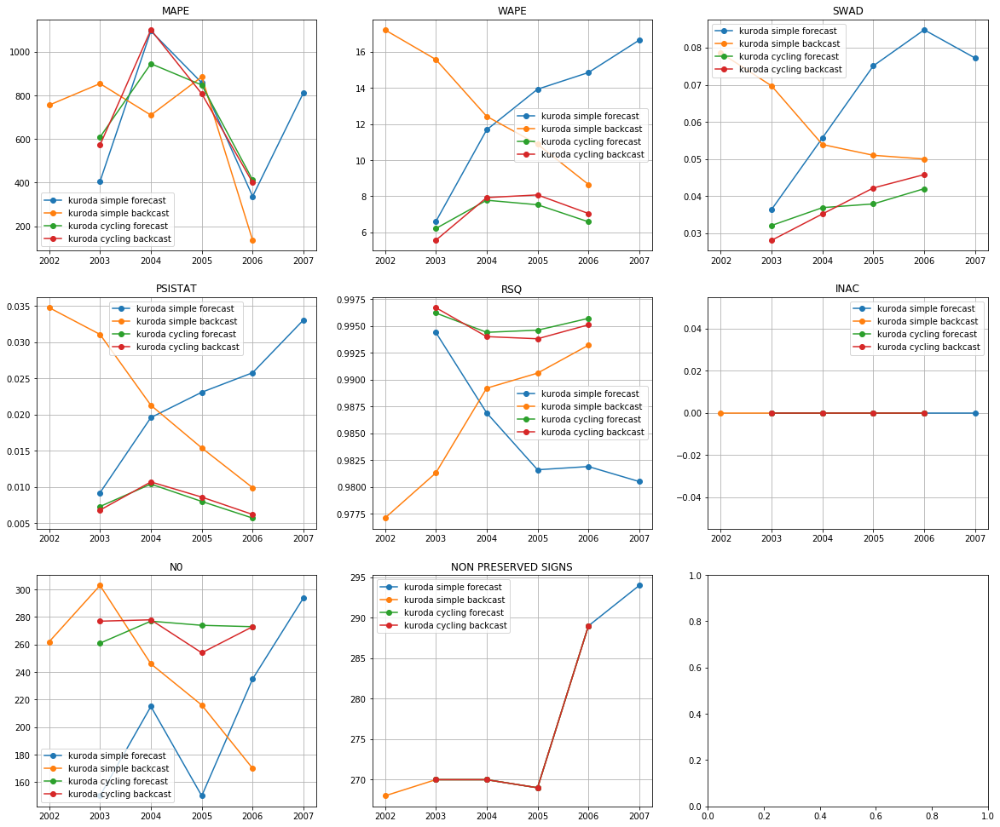

,MAPE,MAPE_R,WAPE,WAPE_R,SWAD,SWAD_R,PSISTAT,PSISTAT_R,RSQ,RSQ_R,INAC,INAC_R,N0,NON PRESERVED SIGNS,R_all,CmR
insd cycling forecast,24.496650,3,4.930325,1,0.033350,1,0.001800,1,0.996600,1,0.000000,1,274.50,274.5,8,1
insd cycling backcast,24.533775,4,4.965200,2,0.033975,2,0.001825,2,0.996200,3,0.000000,1,274.50,274.5,14,2
nras cycling forecast,25.389875,6,5.017450,3,0.034525,3,0.001925,3,0.996400,2,0.000250,10,7.50,274.5,27,3
nras cycling backcast,25.303825,5,5.066150,4,0.035525,4,0.001925,3,0.995975,4,0.000225,9,8.00,274.5,29,4
kuroda cycling forecast,703.704850,11,7.025275,5,0.037225,5,0.007850,9,0.995225,5,0.000000,1,271.25,274.5,36,5
insd simple forecast,31.830080,7,7.548120,7,0.052400,8,0.003840,6,0.992800,8,0.000000,1,278.40,278.4,37,6
insd simple backcast,23.093160,1,8.318680,10,0.056200,9,0.004580,8,0.992040,9,0.000000,1,273.20,273.2,38,7
kuroda cycling backcast,720.508450,12,7.150475,6,0.037825,6,0.008075,10,0.994900,6,0.000000,1,270.50,274.5,41,8
nras simple forecast,33.626820,8,7.563720,8,0.050440,7,0.003740,5,0.992940,7,0.000840,12,195.00,278.4,47,9
nras simple backcast,23.360040,2,8.298920,9,0.056980,10,0.004440,7,0.992040,9,0.000820,11,95.00,273.2,48,10


use purchase I+II
[1997 1998 1999 2000 2001 2002]
available mtypes: [0]
nras simple forecast
nras simple backcast
final cycle: 10
nras cycling forecast
final cycle: 10
nras cycling backcast


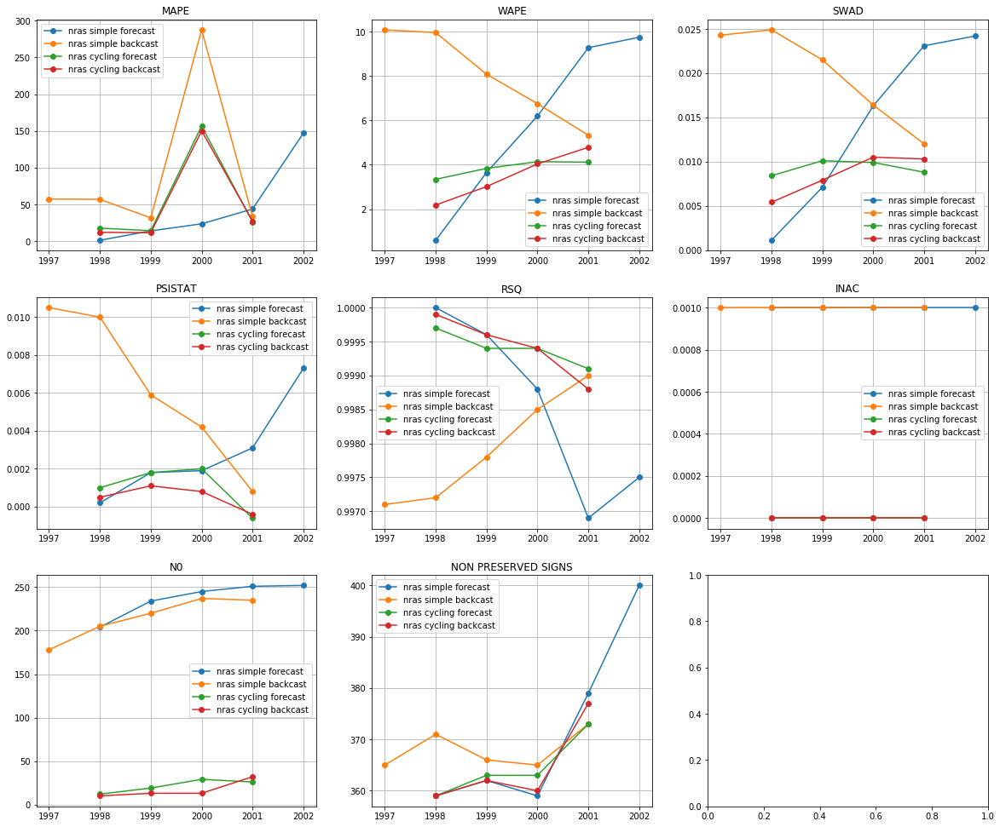

insd simple forecast
insd simple backcast
final cycle: 10
insd cycling forecast
final cycle: 10
insd cycling backcast


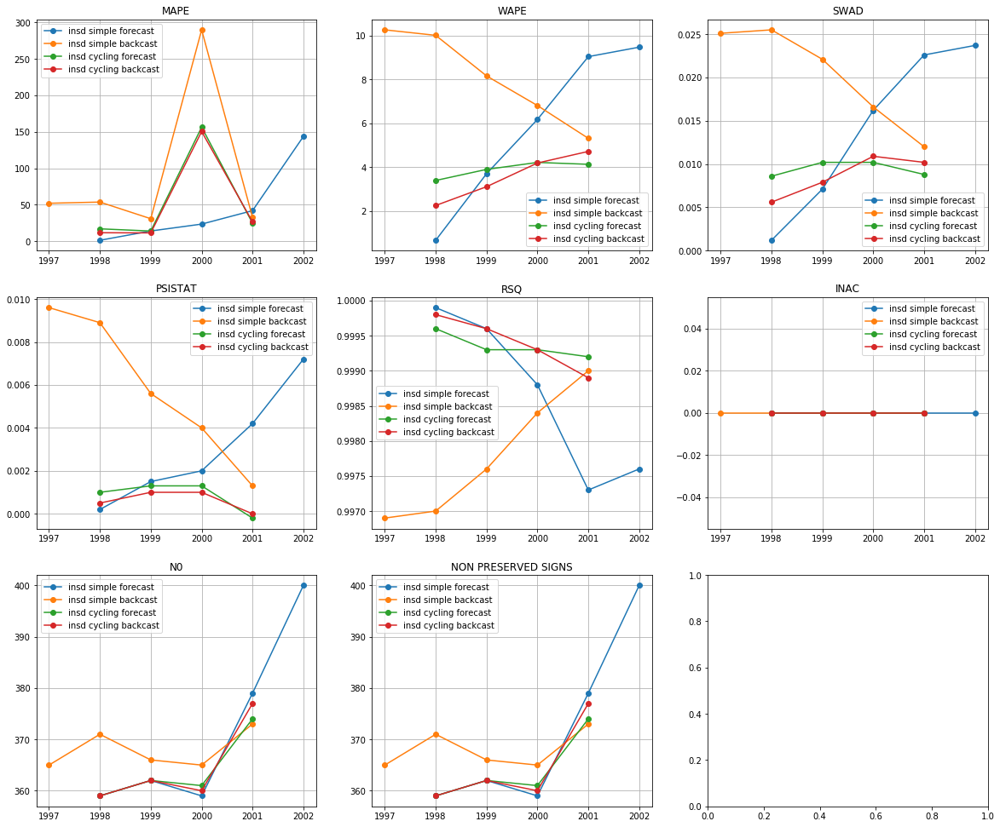

kuroda simple forecast
kuroda simple backcast
final cycle: 10
kuroda cycling forecast
final cycle: 10
kuroda cycling backcast


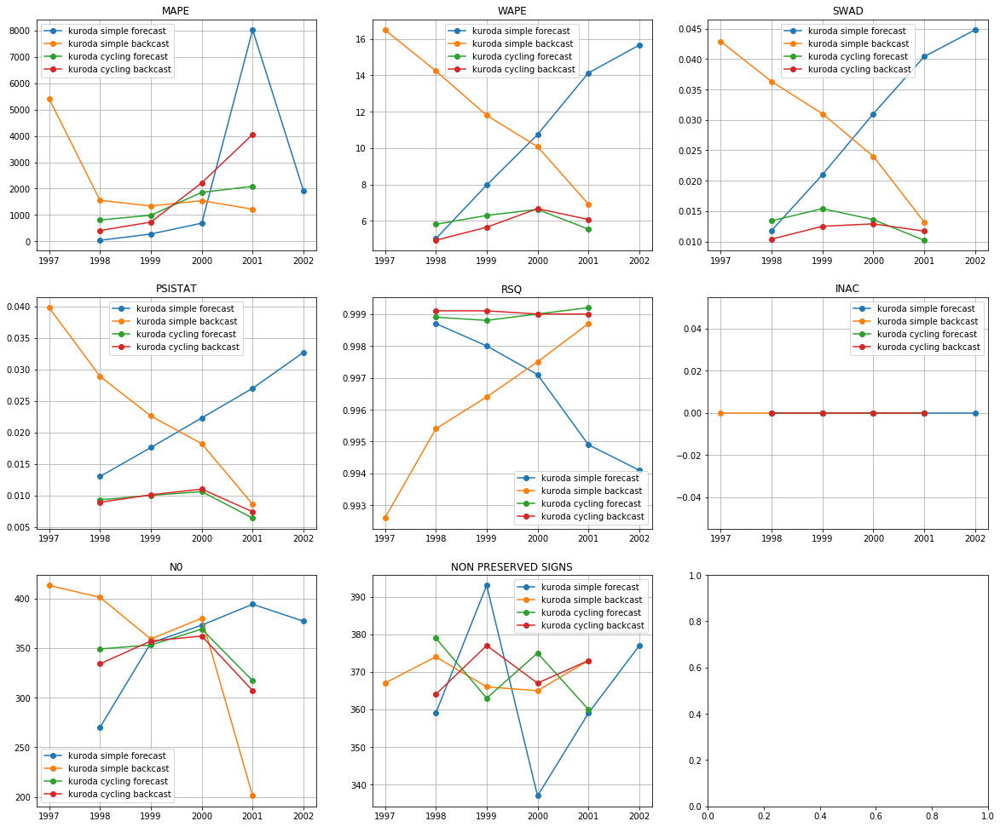

,MAPE,MAPE_R,WAPE,WAPE_R,SWAD,SWAD_R,PSISTAT,PSISTAT_R,RSQ,RSQ_R,INAC,INAC_R,N0,NON PRESERVED SIGNS,R_all,CmR
nras cycling backcast,50.282975,4,3.506625,1,0.008525,1,0.000500,1,0.999425,1,0.000,1,17.0,364.50,9,1
insd cycling backcast,50.044275,3,3.566100,2,0.008650,2,0.000625,2,0.999400,2,0.000,1,364.5,364.50,12,2
nras cycling forecast,53.747500,6,3.859500,3,0.009300,3,0.001050,4,0.999400,2,0.000,1,21.5,364.50,19,3
insd cycling forecast,53.055275,5,3.908600,4,0.009450,4,0.000850,3,0.999350,4,0.000,1,364.0,364.00,21,4
insd simple forecast,44.905460,1,5.810960,5,0.014160,7,0.003020,6,0.998640,7,0.000,1,371.8,371.80,27,5
kuroda cycling backcast,1854.502875,10,5.838150,6,0.011875,5,0.009350,10,0.999050,5,0.000,1,340.0,370.25,37,6
kuroda cycling forecast,1437.159550,9,6.075400,8,0.013150,6,0.009075,9,0.998975,6,0.000,1,347.0,369.25,39,7
nras simple forecast,45.945640,2,5.890720,7,0.014360,8,0.002860,5,0.998560,8,0.001,11,237.2,371.80,41,8
insd simple backcast,91.834240,7,8.113440,10,0.020260,10,0.005880,7,0.997780,10,0.000,1,368.0,368.00,45,9
nras simple backcast,93.438180,8,8.036220,9,0.019820,9,0.006280,8,0.997920,9,0.001,11,215.0,368.00,54,10


[2002 2003 2004 2005 2006 2007]
available mtypes: [0]
nras simple forecast
nras simple backcast
final cycle: 10
nras cycling forecast
final cycle: 10
nras cycling backcast


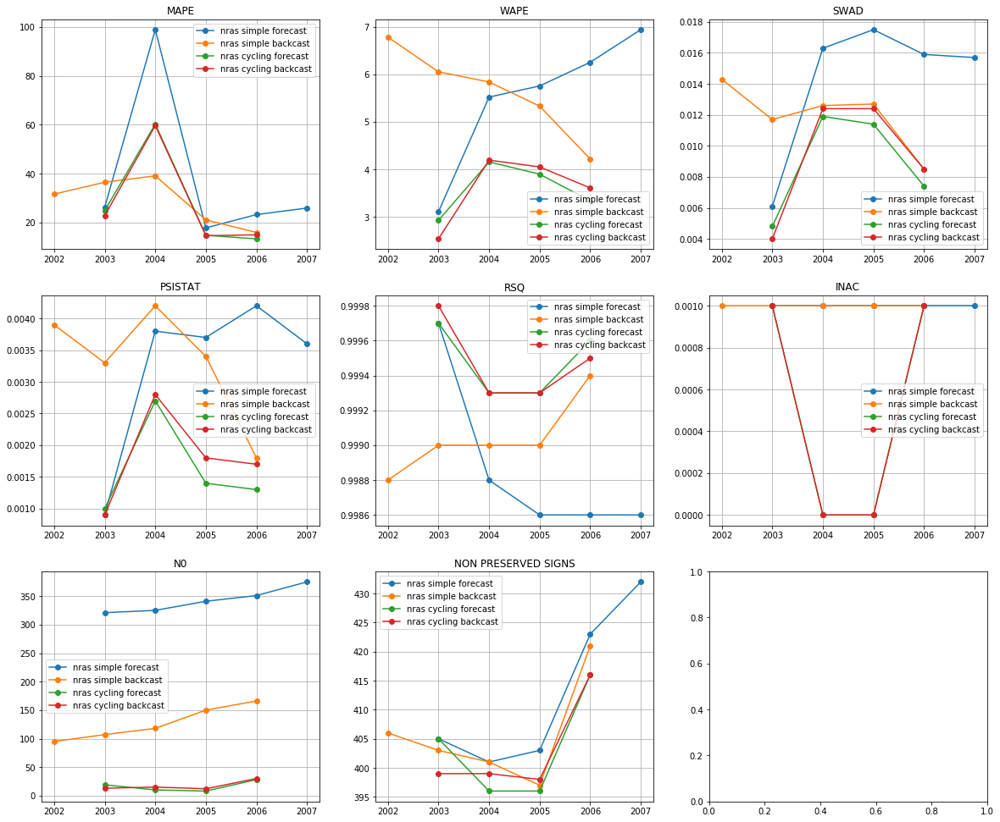

insd simple forecast
insd simple backcast
final cycle: 10
insd cycling forecast
final cycle: 10
insd cycling backcast


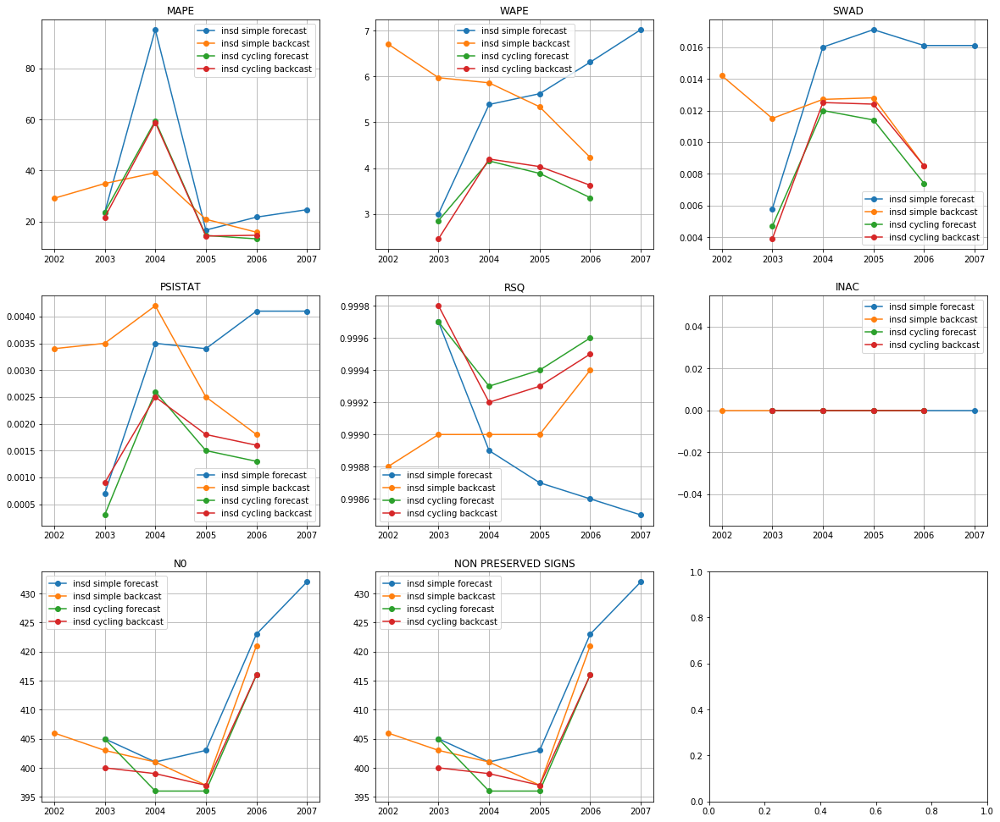

kuroda simple forecast
kuroda simple backcast
final cycle: 10
kuroda cycling forecast
final cycle: 10
kuroda cycling backcast


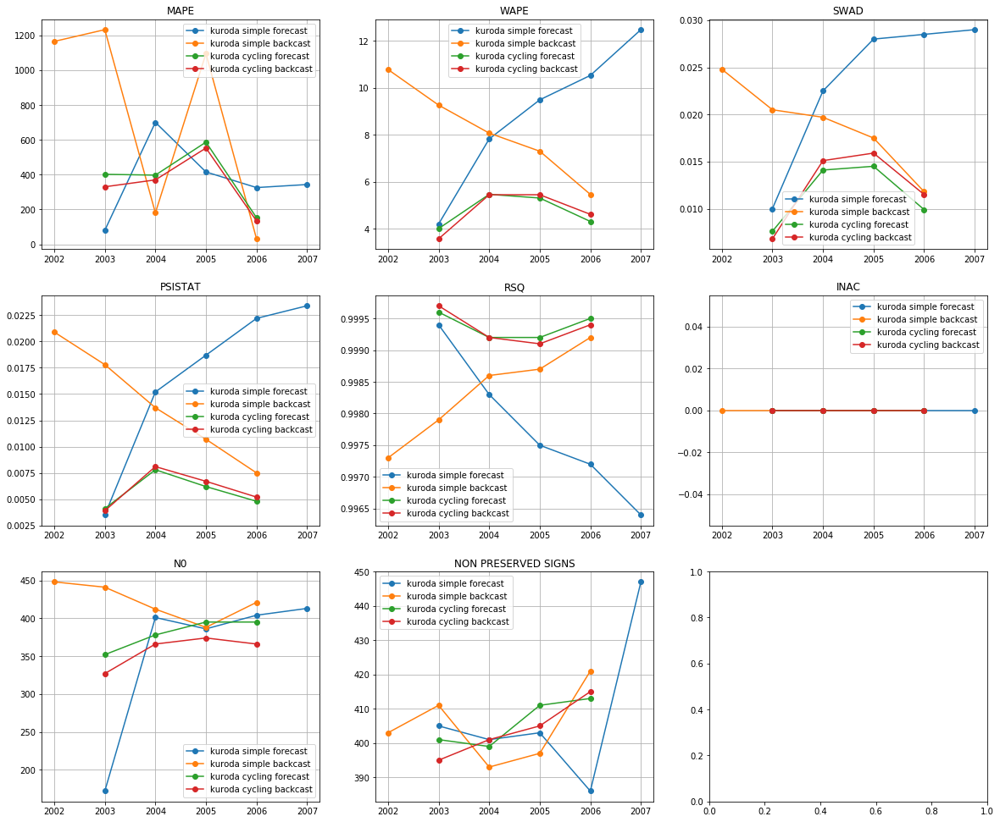

,MAPE,MAPE_R,WAPE,WAPE_R,SWAD,SWAD_R,PSISTAT,PSISTAT_R,RSQ,RSQ_R,INAC,INAC_R,N0,NON PRESERVED SIGNS,R_all,CmR
insd cycling forecast,27.727850,2,3.564225,1,0.008875,1,0.001425,1,0.999500,1,0.0000,1,403.25,403.25,7,1
insd cycling backcast,27.341800,1,3.580650,2,0.009325,3,0.001700,3,0.999450,4,0.0000,1,403.00,403.00,14,2
nras cycling forecast,28.289750,5,3.580975,3,0.008875,1,0.001600,2,0.999475,2,0.0005,9,16.25,403.25,22,3
nras cycling backcast,27.997000,4,3.598300,4,0.009325,3,0.001800,4,0.999475,3,0.0005,9,17.50,403.00,27,4
insd simple backcast,27.963040,3,5.622360,9,0.011940,6,0.003080,5,0.999040,7,0.0000,1,405.60,405.60,31,5
kuroda cycling forecast,384.782175,11,4.780800,6,0.011525,5,0.005725,9,0.999375,5,0.0000,1,380.00,406.00,37,6
insd simple forecast,36.350300,7,5.469460,7,0.014220,9,0.003160,6,0.998880,9,0.0000,1,412.80,412.80,39,7
kuroda cycling backcast,346.869725,9,4.778075,5,0.012325,8,0.005975,10,0.999350,6,0.0000,1,358.25,404.00,39,7
nras simple backcast,28.825540,6,5.645520,10,0.011960,7,0.003320,8,0.999040,7,0.0010,11,127.20,405.60,49,9
nras simple forecast,38.405940,8,5.516700,8,0.014300,10,0.003240,7,0.998860,10,0.0010,11,342.60,412.80,54,10


use purchase I
[1997 1998 1999 2000 2001 2002]
available mtypes: [0]
nras simple forecast
nras simple backcast
final cycle: 10
nras cycling forecast
final cycle: 10
nras cycling backcast


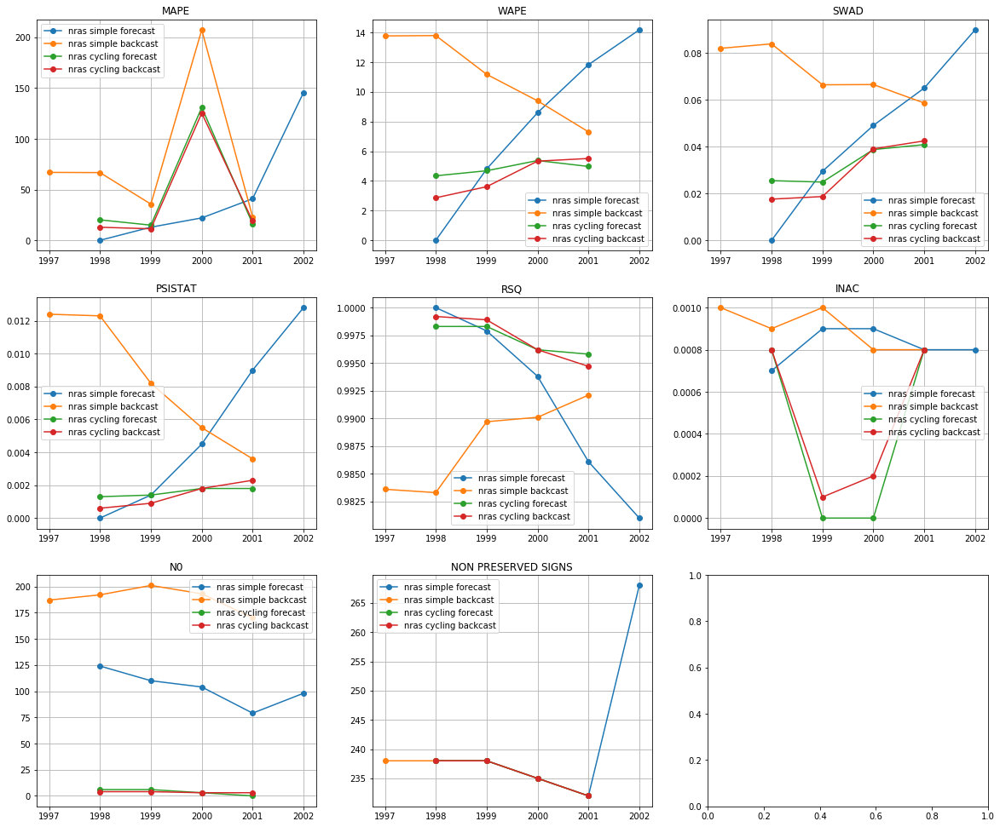

insd simple forecast
insd simple backcast
final cycle: 10
insd cycling forecast
final cycle: 10
insd cycling backcast


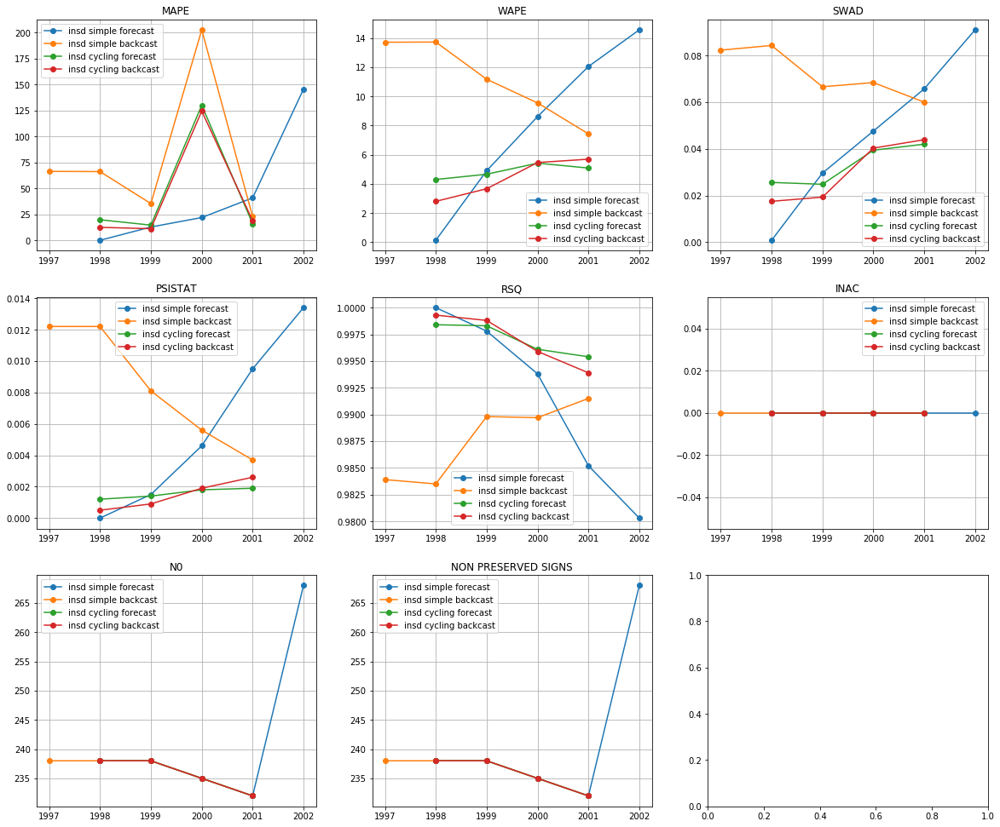

kuroda simple forecast
kuroda simple backcast
final cycle: 10
kuroda cycling forecast
final cycle: 10
kuroda cycling backcast


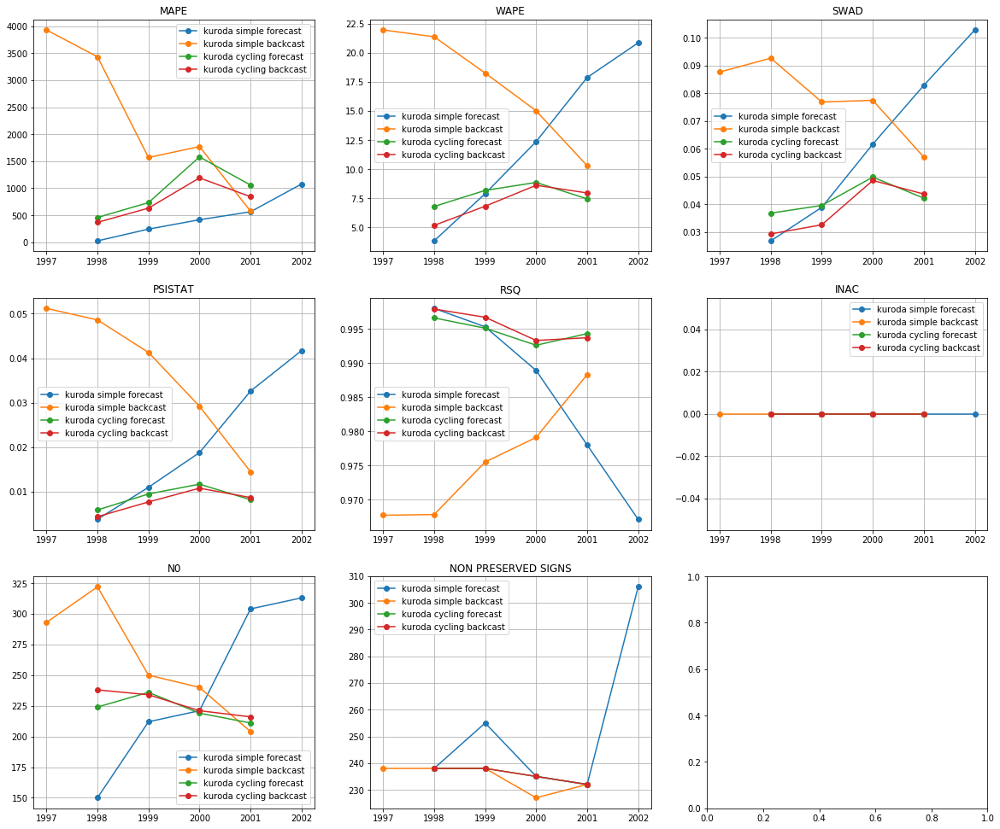

,MAPE,MAPE_R,WAPE,WAPE_R,SWAD,SWAD_R,PSISTAT,PSISTAT_R,RSQ,RSQ_R,INAC,INAC_R,N0,NON PRESERVED SIGNS,R_all,CmR
insd cycling backcast,41.920625,1,4.399125,2,0.030250,2,0.001475,2,0.996975,4,0.000000,1,235.75,235.75,12,1
nras cycling backcast,42.144425,2,4.330300,1,0.029475,1,0.001400,1,0.997250,1,0.000475,10,3.50,235.75,16,2
insd cycling forecast,45.270875,5,4.861100,4,0.032950,4,0.001575,3,0.997050,3,0.000000,1,235.75,235.75,20,3
nras cycling forecast,45.521425,6,4.845450,3,0.032525,3,0.001575,4,0.997150,2,0.000400,9,3.75,235.75,27,4
kuroda cycling backcast,759.000525,10,7.142625,5,0.038550,5,0.007900,7,0.995400,5,0.000000,1,227.25,235.75,33,5
insd simple forecast,44.381520,4,8.046240,8,0.046940,8,0.005800,6,0.991420,8,0.000000,1,242.20,242.20,35,6
nras simple forecast,44.309300,3,7.883520,7,0.046740,7,0.005540,5,0.991760,7,0.000820,11,103.00,242.20,40,7
kuroda cycling forecast,958.027300,11,7.820375,6,0.042100,6,0.008825,10,0.994650,6,0.000000,1,222.50,235.75,40,7
insd simple backcast,78.769340,7,11.117080,10,0.072320,11,0.008360,8,0.987680,10,0.000000,1,236.20,236.20,47,9
kuroda simple forecast,465.688900,9,12.565280,11,0.062640,9,0.021580,11,0.985460,11,0.000000,1,240.00,253.20,52,10


[2002 2003 2004 2005 2006 2007]
available mtypes: [0]
nras simple forecast
nras simple backcast
final cycle: 10
nras cycling forecast
final cycle: 10
nras cycling backcast


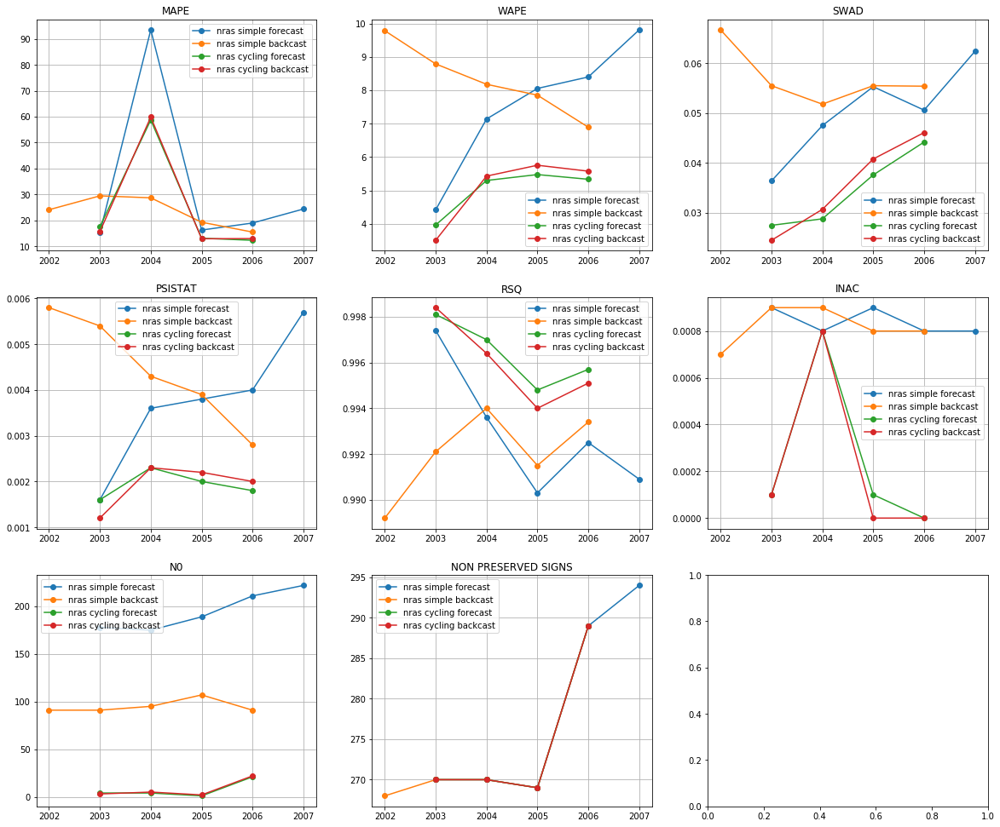

insd simple forecast
insd simple backcast
final cycle: 10
insd cycling forecast
final cycle: 10
insd cycling backcast


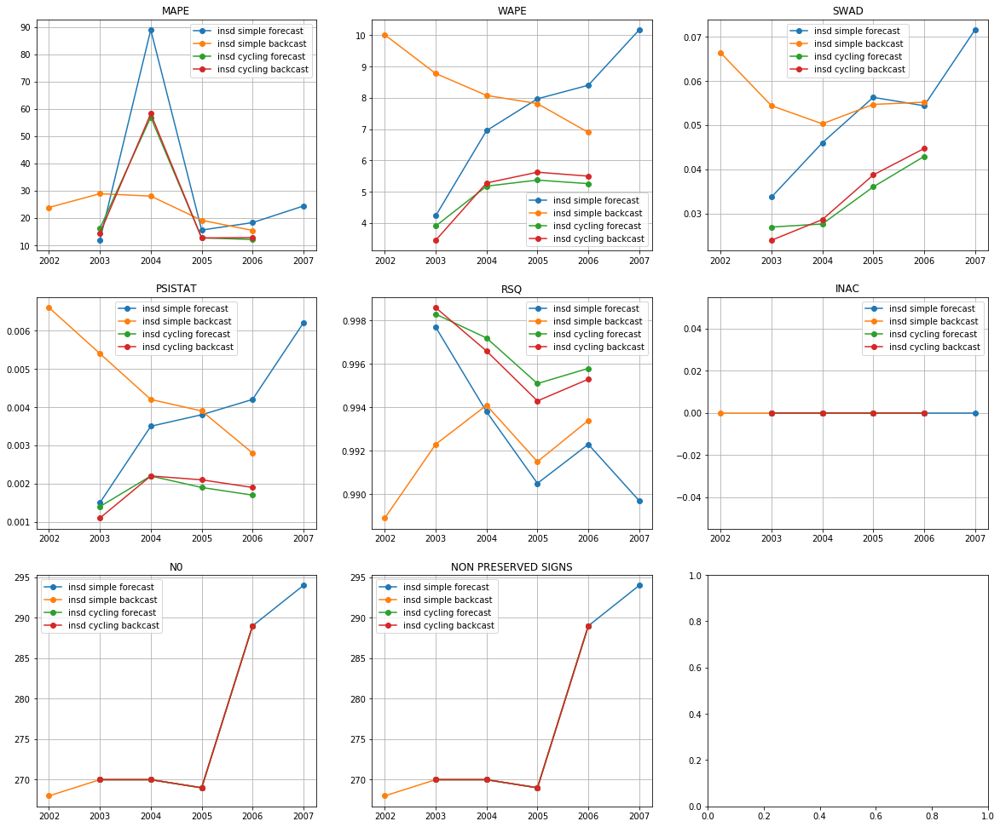

kuroda simple forecast
kuroda simple backcast
final cycle: 10
kuroda cycling forecast
final cycle: 10
kuroda cycling backcast


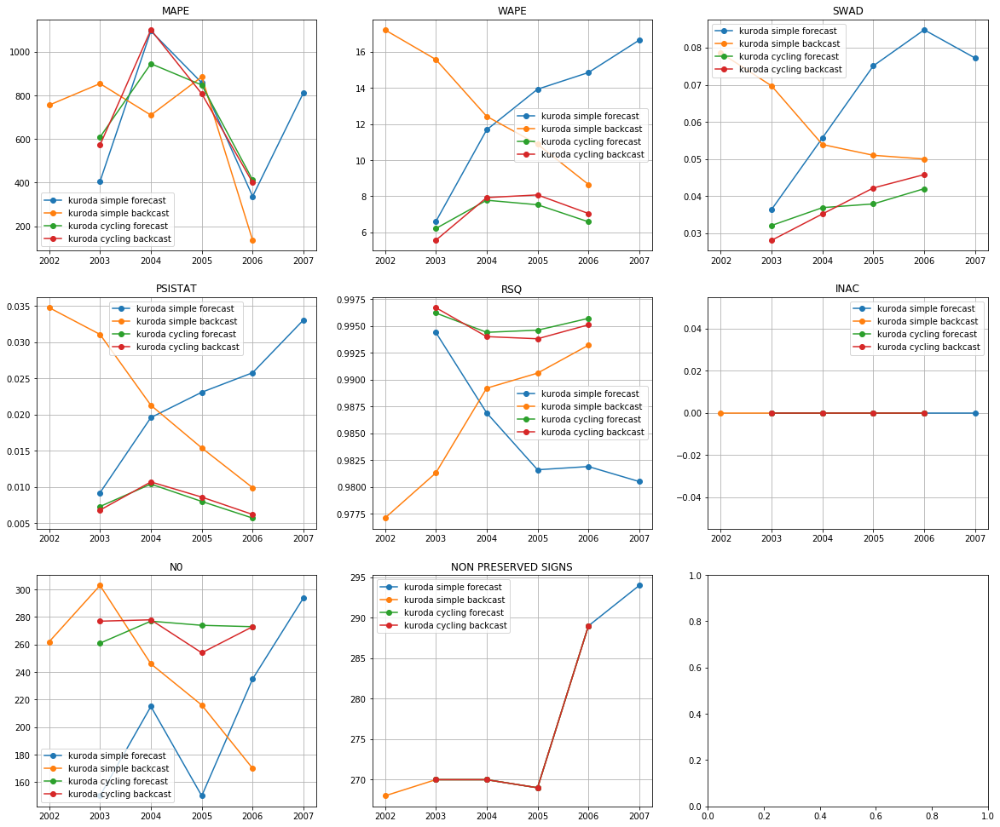

,MAPE,MAPE_R,WAPE,WAPE_R,SWAD,SWAD_R,PSISTAT,PSISTAT_R,RSQ,RSQ_R,INAC,INAC_R,N0,NON PRESERVED SIGNS,R_all,CmR
insd cycling forecast,24.496650,3,4.930325,1,0.033350,1,0.001800,1,0.996600,1,0.000000,1,274.50,274.5,8,1
insd cycling backcast,24.533775,4,4.965200,2,0.033975,2,0.001825,2,0.996200,3,0.000000,1,274.50,274.5,14,2
nras cycling forecast,25.389875,6,5.017450,3,0.034525,3,0.001925,3,0.996400,2,0.000250,10,7.50,274.5,27,3
nras cycling backcast,25.303825,5,5.066150,4,0.035525,4,0.001925,3,0.995975,4,0.000225,9,8.00,274.5,29,4
kuroda cycling forecast,703.704850,11,7.025275,5,0.037225,5,0.007850,9,0.995225,5,0.000000,1,271.25,274.5,36,5
insd simple forecast,31.830080,7,7.548120,7,0.052400,8,0.003840,6,0.992800,8,0.000000,1,278.40,278.4,37,6
insd simple backcast,23.093160,1,8.318680,10,0.056200,9,0.004580,8,0.992040,9,0.000000,1,273.20,273.2,38,7
kuroda cycling backcast,720.508450,12,7.150475,6,0.037825,6,0.008075,10,0.994900,6,0.000000,1,270.50,274.5,41,8
nras simple forecast,33.626820,8,7.563720,8,0.050440,7,0.003740,5,0.992940,7,0.000840,12,195.00,278.4,47,9
nras simple backcast,23.360040,2,8.298920,9,0.056980,10,0.004440,7,0.992040,9,0.000820,11,95.00,273.2,48,10


sup I
[1997 1998 1999 2000 2001 2002]
available mtypes: [0]
nras simple forecast
nras simple backcast
final cycle: 10
nras cycling forecast
final cycle: 10
nras cycling backcast


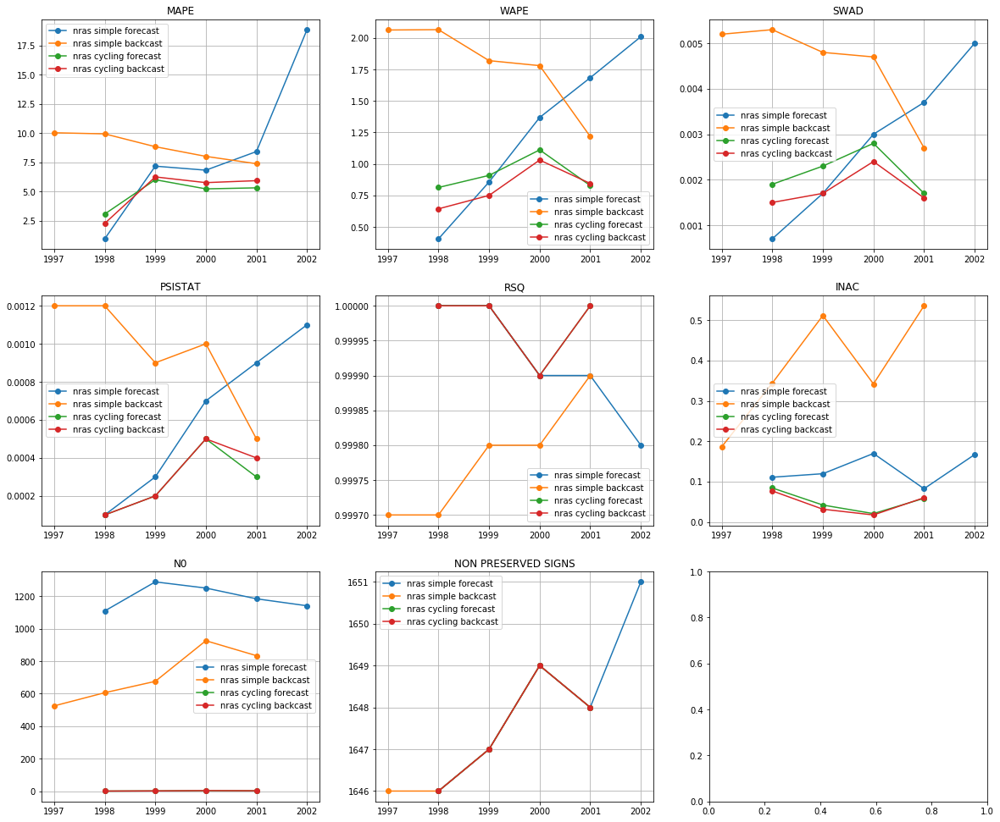

insd simple forecast
insd simple backcast
final cycle: 10
insd cycling forecast
final cycle: 10
insd cycling backcast


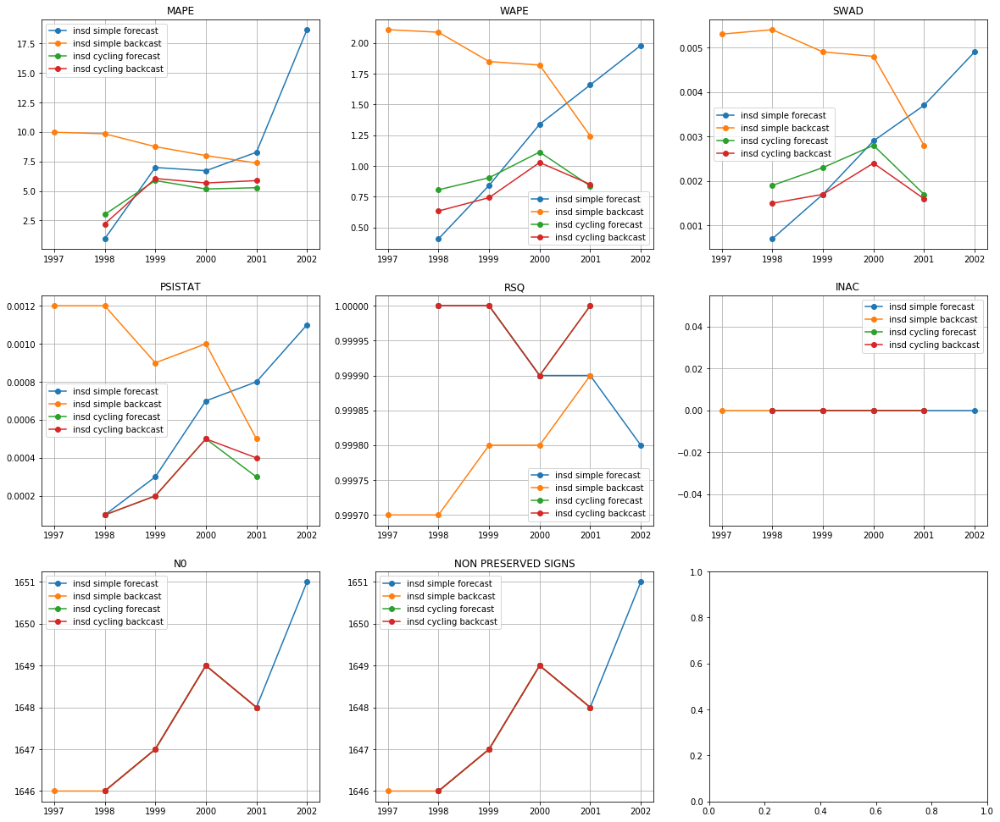

kuroda simple forecast
kuroda simple backcast
final cycle: 10
kuroda cycling forecast
final cycle: 10
kuroda cycling backcast


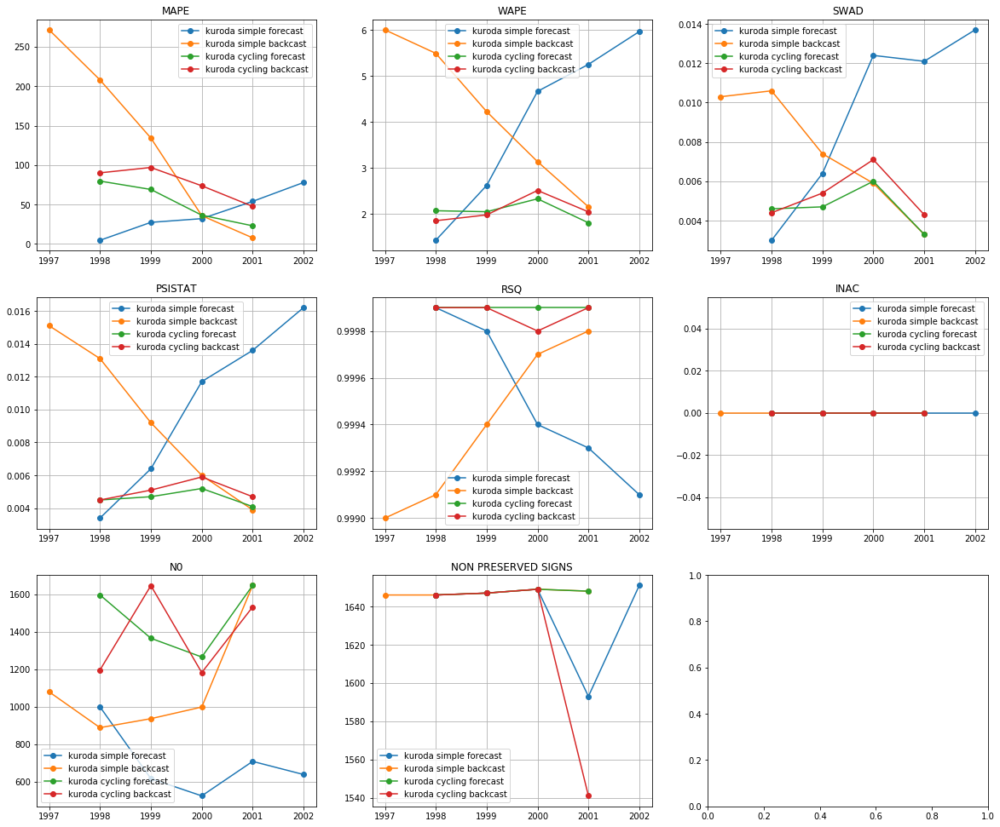

,MAPE,MAPE_R,WAPE,WAPE_R,SWAD,SWAD_R,PSISTAT,PSISTAT_R,RSQ,RSQ_R,INAC,INAC_R,N0,NON PRESERVED SIGNS,R_all,CmR
insd cycling backcast,4.956925,3,0.814375,1,0.001800,1,0.000300,3,0.999975,1,0.00000,1,1647.50,1647.50,10,1
insd cycling forecast,4.836700,1,0.915800,4,0.002175,3,0.000275,1,0.999975,1,0.00000,1,1647.50,1647.50,11,2
nras cycling forecast,4.901225,2,0.915500,3,0.002175,3,0.000275,1,0.999975,1,0.05155,10,2.50,1647.50,20,3
nras cycling backcast,5.047100,4,0.817300,2,0.001800,1,0.000300,3,0.999975,1,0.04670,9,2.50,1647.50,20,3
insd simple forecast,8.321900,5,1.245920,5,0.002780,5,0.000600,5,0.999920,5,0.00000,1,1648.20,1648.20,26,5
nras simple forecast,8.444360,6,1.264960,6,0.002820,6,0.000620,6,0.999920,5,0.13000,11,1194.40,1648.20,40,6
insd simple backcast,8.792240,7,1.821920,8,0.004640,8,0.000960,7,0.999780,9,0.00000,1,1647.20,1647.20,40,6
kuroda cycling forecast,52.132050,10,2.061375,9,0.004650,9,0.004625,9,0.999900,7,0.00000,1,1469.25,1647.50,45,8
nras simple backcast,8.837900,8,1.789620,7,0.004540,7,0.000960,7,0.999780,9,0.38386,12,713.40,1647.20,50,9
kuroda cycling backcast,77.175800,11,2.094650,10,0.005300,10,0.005050,10,0.999875,8,0.00000,1,1390.00,1620.75,50,9


[2002 2003 2004 2005 2006 2007]
available mtypes: [0]
nras simple forecast
nras simple backcast
final cycle: 10
nras cycling forecast
final cycle: 10
nras cycling backcast


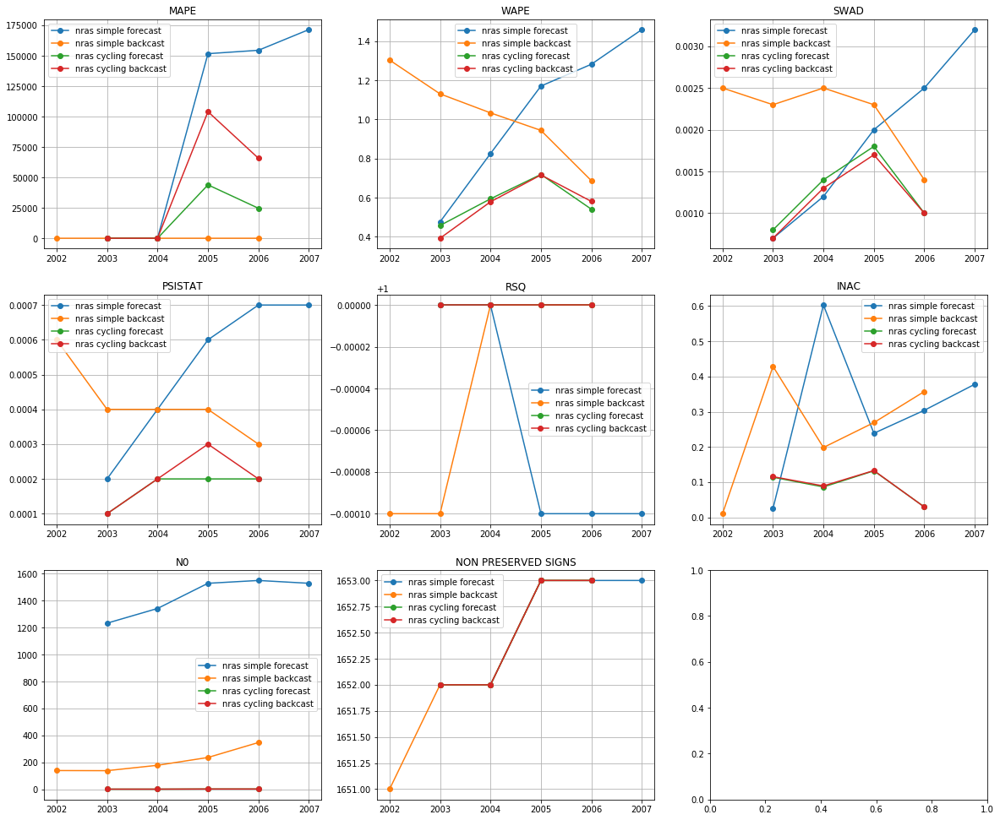

insd simple forecast
insd simple backcast
final cycle: 10
insd cycling forecast
final cycle: 10
insd cycling backcast


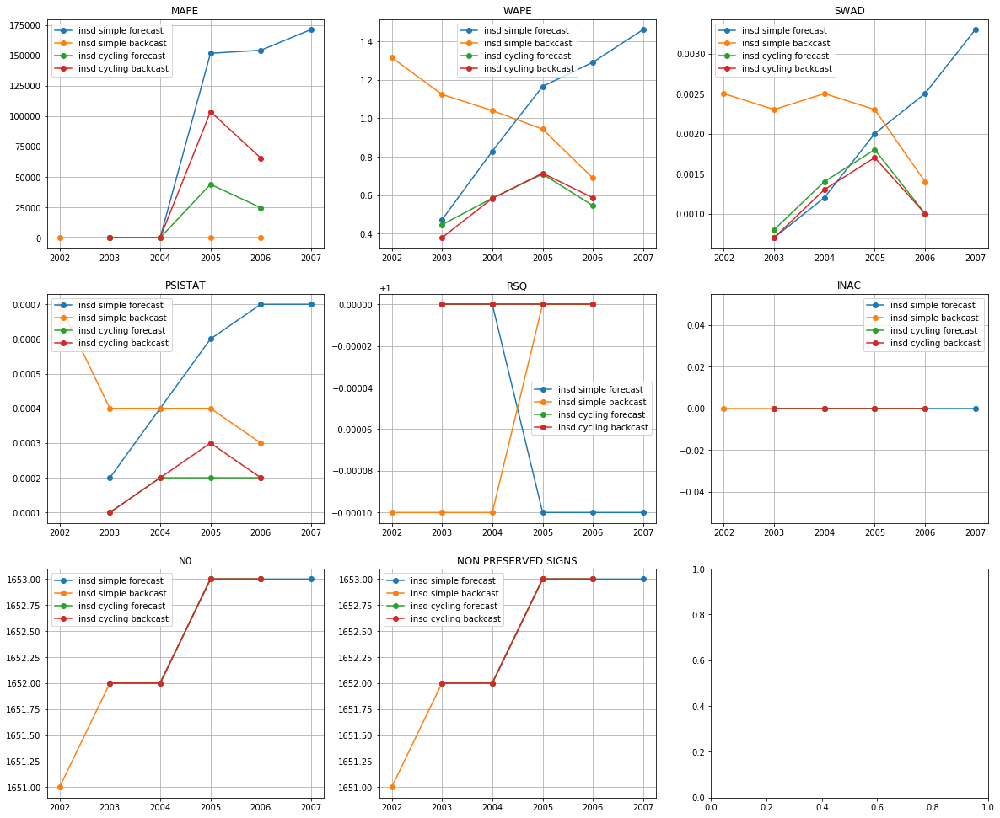

kuroda simple forecast
kuroda simple backcast
final cycle: 10
kuroda cycling forecast
final cycle: 10
kuroda cycling backcast


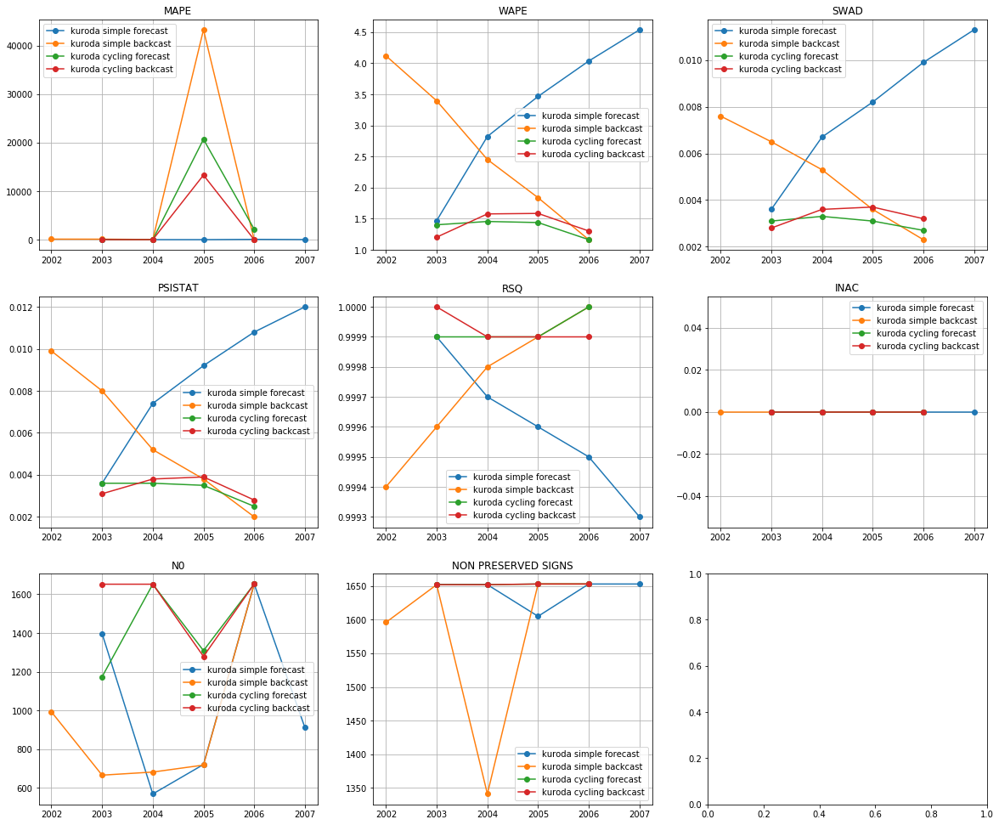

,MAPE,MAPE_R,WAPE,WAPE_R,SWAD,SWAD_R,PSISTAT,PSISTAT_R,RSQ,RSQ_R,INAC,INAC_R,N0,NON PRESERVED SIGNS,R_all,CmR
insd cycling forecast,17132.561300,7,0.571750,3,0.001250,3,0.000175,1,1.000000,1,0.000000,1,1652.5,1652.5,16,1
insd cycling backcast,42287.124500,9,0.566000,1,0.001175,1,0.000200,3,1.000000,1,0.000000,1,1652.5,1652.5,16,1
nras cycling forecast,17144.045675,8,0.577650,4,0.001250,3,0.000175,1,1.000000,1,0.090375,9,1.5,1652.5,26,3
nras cycling backcast,42447.584275,10,0.566825,2,0.001175,1,0.000200,3,1.000000,1,0.091600,10,1.5,1652.5,27,4
insd simple backcast,12.307980,1,1.022480,6,0.002200,7,0.000440,6,0.999940,8,0.000000,1,1652.2,1652.2,29,5
nras simple backcast,12.335780,2,1.019320,5,0.002200,7,0.000420,5,0.999960,5,0.252720,11,207.6,1652.2,35,6
insd simple forecast,95418.161360,11,1.043820,8,0.001940,6,0.000520,7,0.999940,6,0.000000,1,1652.6,1652.6,39,7
kuroda cycling forecast,5737.964600,5,1.365850,9,0.003050,9,0.003300,9,0.999925,9,0.000000,1,1447.0,1652.5,42,8
kuroda cycling backcast,3348.541800,4,1.417950,10,0.003325,10,0.003400,10,0.999925,9,0.000000,1,1559.0,1652.5,44,9
nras simple forecast,95532.389540,12,1.042320,7,0.001920,5,0.000520,7,0.999940,6,0.309740,12,1436.6,1652.6,49,10


iot
[1997 1998 1999 2000 2001 2002 2007]
available mtypes: [0, 2]
0 LinearRegression(copy_X=True, fit_intercept=True, n_jobs=1, normalize=False) False
using mtt 0
mtt2 ridge backcast
0 Ridge(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=None,
   normalize=False, random_state=None, solver='auto', tol=0.001) False
using mtt 0
mtt2 ridge backcast
0 Lasso(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=1000,
   normalize=False, positive=False, precompute=False, random_state=None,
   selection='cyclic', tol=0.0001, warm_start=False) False
using mtt 0
mtt2 ridge backcast
2 LinearRegression(copy_X=True, fit_intercept=True, n_jobs=1, normalize=False) False
using mtt ii
mtt2 ridge backcast
2 Ridge(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=None,
   normalize=False, random_state=None, solver='auto', tol=0.001) False
using mtt ii
mtt2 ridge backcast
2 Lasso(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=1000,
   normalize=False, positive=False, precompute=False, random

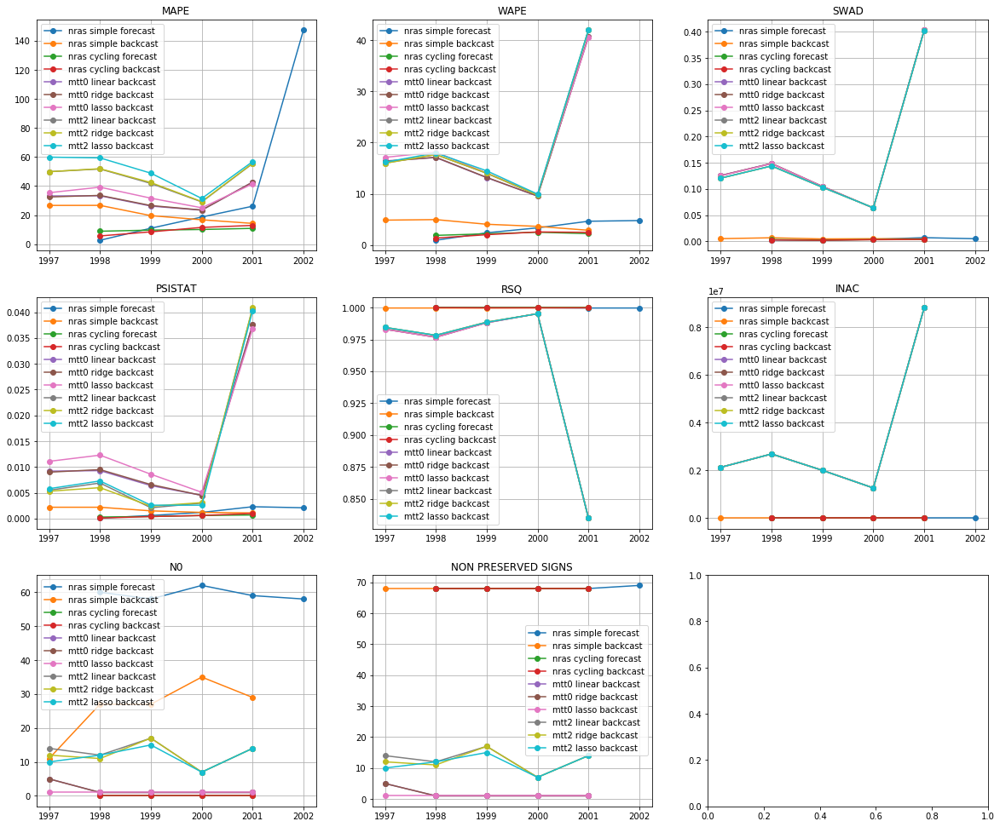

insd simple forecast
insd simple backcast
final cycle: 10
insd cycling forecast
final cycle: 10
insd cycling backcast


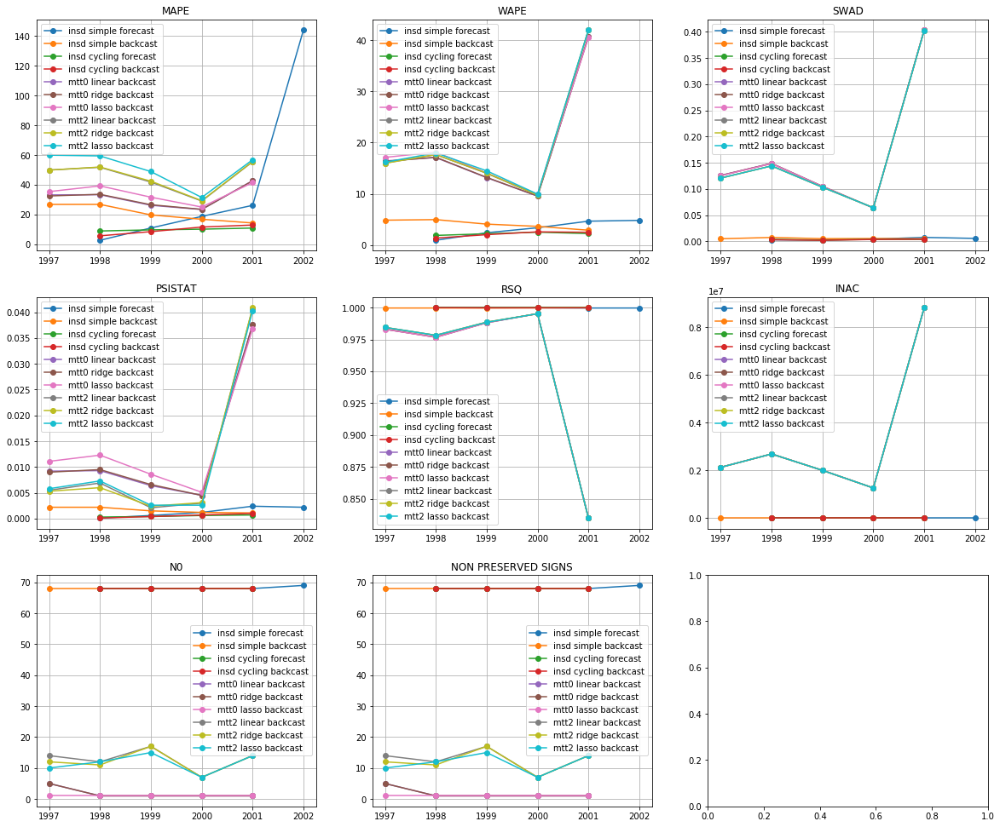

kuroda simple forecast
kuroda simple backcast
final cycle: 10
kuroda cycling forecast
final cycle: 10
kuroda cycling backcast


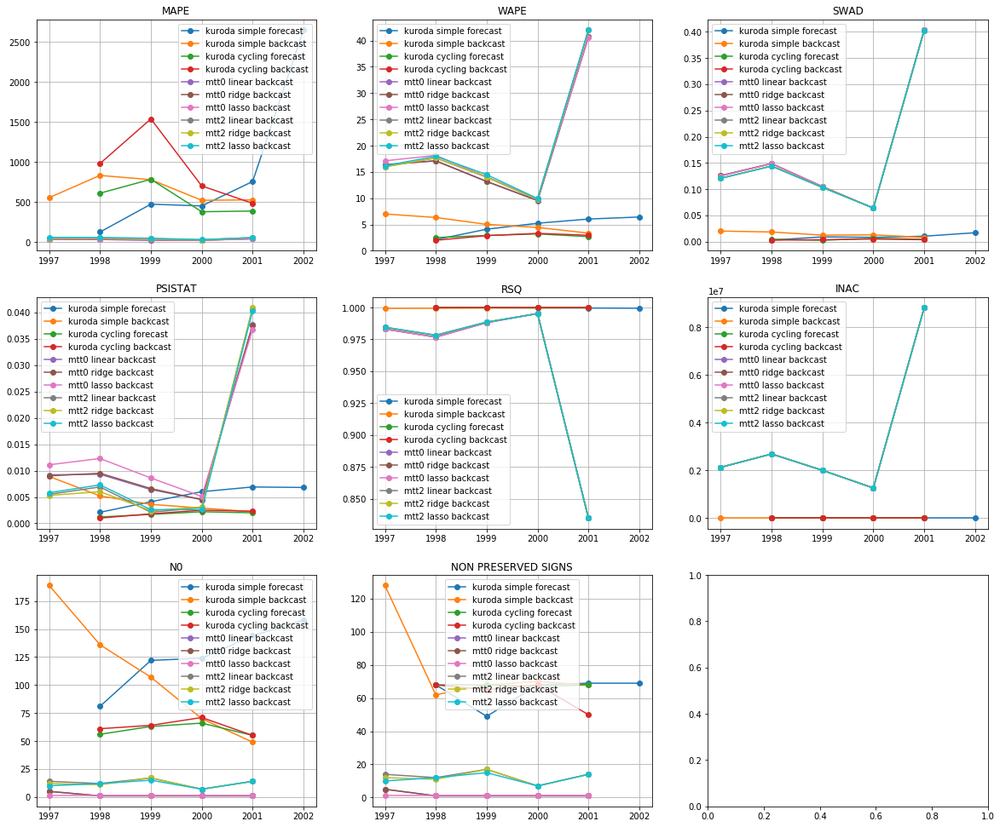

,MAPE,MAPE_R,WAPE,WAPE_R,SWAD,SWAD_R,PSISTAT,PSISTAT_R,RSQ,RSQ_R,INAC,INAC_R,N0,NON PRESERVED SIGNS,R_all,CmR
insd cycling backcast,9.701450,2,2.092575,2,0.003200,2,0.000550,4,0.999925,1,0.000000e+00,1,68.00,68.00,12,1
nras cycling backcast,9.667375,1,2.083825,1,0.003100,1,0.000525,3,0.999925,1,7.500000e-05,9,0.00,68.00,16,2
insd cycling forecast,9.942800,4,2.187800,4,0.003425,4,0.000500,1,0.999900,3,0.000000e+00,1,68.00,68.00,17,3
nras cycling forecast,9.902625,3,2.181050,3,0.003325,3,0.000500,1,0.999900,3,7.500000e-05,9,0.00,68.00,22,4
insd simple forecast,40.559540,10,3.216220,8,0.004520,7,0.001300,6,0.999840,7,0.000000e+00,1,68.20,68.20,39,5
kuroda cycling backcast,926.314675,18,2.774500,5,0.003825,5,0.001900,10,0.999900,3,0.000000e+00,1,62.75,62.75,42,6
insd simple backcast,20.923340,6,4.072200,10,0.005520,10,0.001640,7,0.999760,9,0.000000e+00,1,68.00,68.00,43,7
kuroda cycling forecast,540.996900,15,2.820800,6,0.004525,8,0.001775,9,0.999875,6,0.000000e+00,1,60.00,67.75,45,8
nras simple forecast,41.217280,11,3.200460,7,0.004300,6,0.001260,5,0.999840,7,6.400000e-04,12,59.40,68.20,48,9
nras simple backcast,20.836740,5,4.065320,9,0.005400,9,0.001640,7,0.999760,9,4.400000e-04,11,25.80,68.00,50,10


[1997 2002 2003 2004 2005 2006 2007]
available mtypes: [0, 2]
0 LinearRegression(copy_X=True, fit_intercept=True, n_jobs=1, normalize=False) True
using mtt 0
mtt2 ridge forecast
0 Ridge(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=None,
   normalize=False, random_state=None, solver='auto', tol=0.001) True
using mtt 0
mtt2 ridge forecast
0 Lasso(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=1000,
   normalize=False, positive=False, precompute=False, random_state=None,
   selection='cyclic', tol=0.0001, warm_start=False) True
using mtt 0
mtt2 ridge forecast
2 LinearRegression(copy_X=True, fit_intercept=True, n_jobs=1, normalize=False) True
using mtt ii
mtt2 ridge forecast
2 Ridge(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=None,
   normalize=False, random_state=None, solver='auto', tol=0.001) True
using mtt ii
mtt2 ridge forecast
2 Lasso(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=1000,
   normalize=False, positive=False, precompute=False, random_state=No

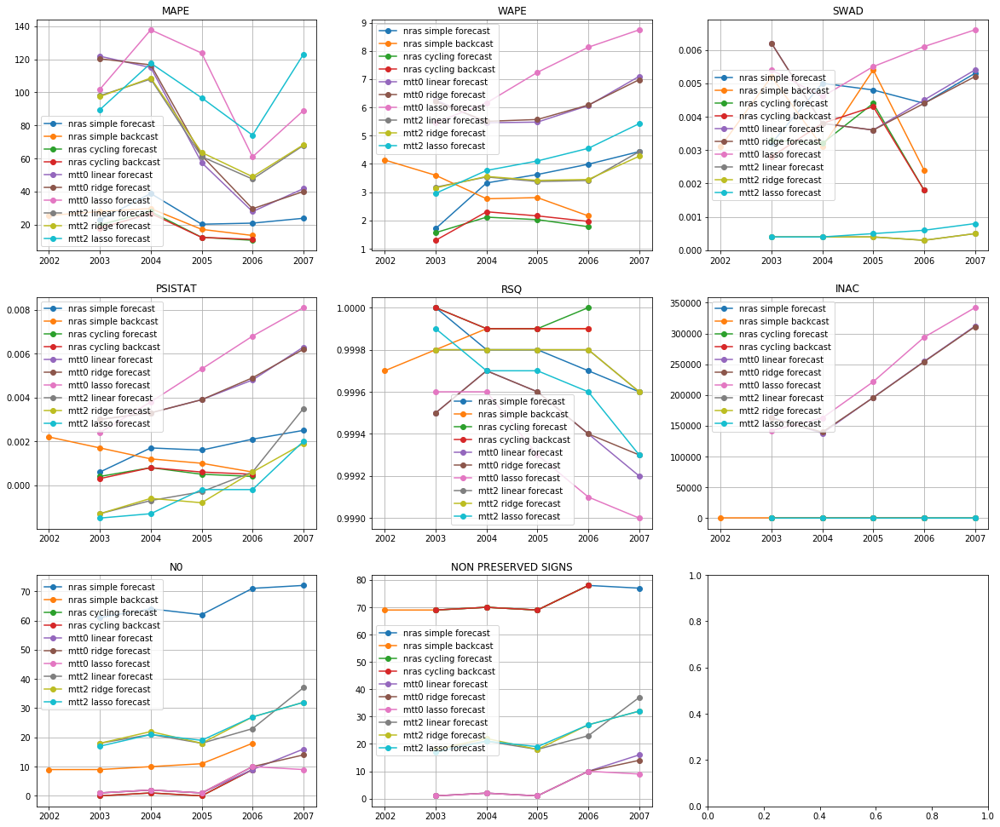

insd simple forecast
insd simple backcast
final cycle: 10
insd cycling forecast
final cycle: 10
insd cycling backcast


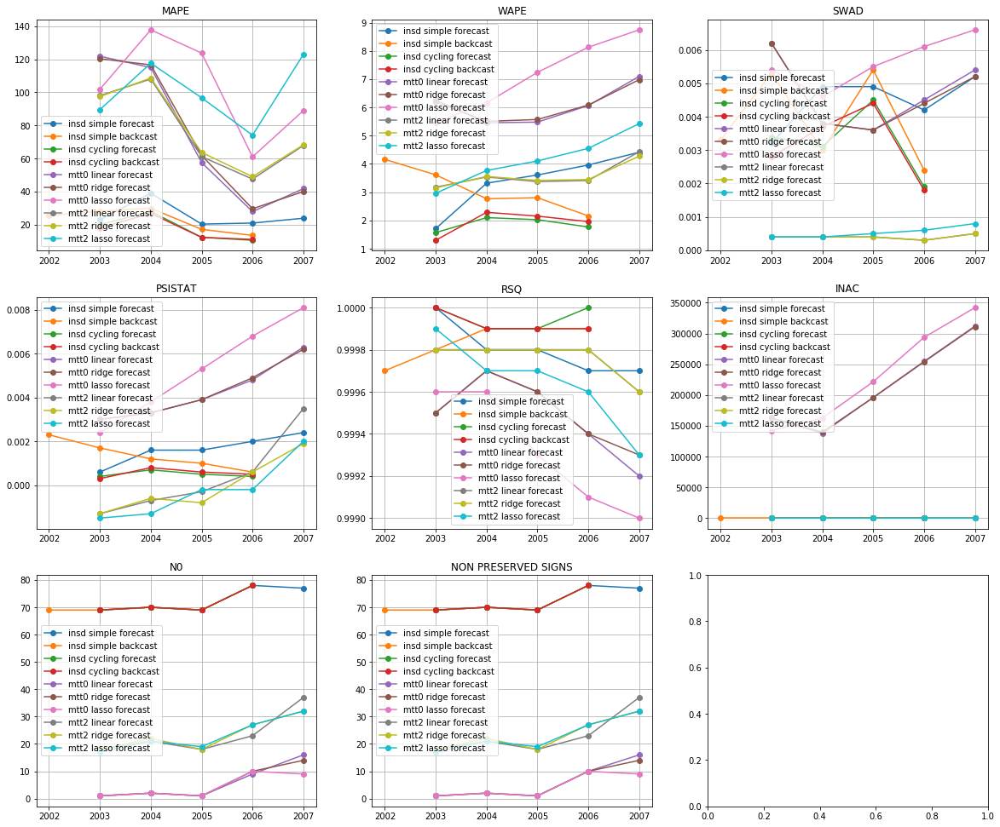

kuroda simple forecast
kuroda simple backcast
final cycle: 10
kuroda cycling forecast
final cycle: 10
kuroda cycling backcast


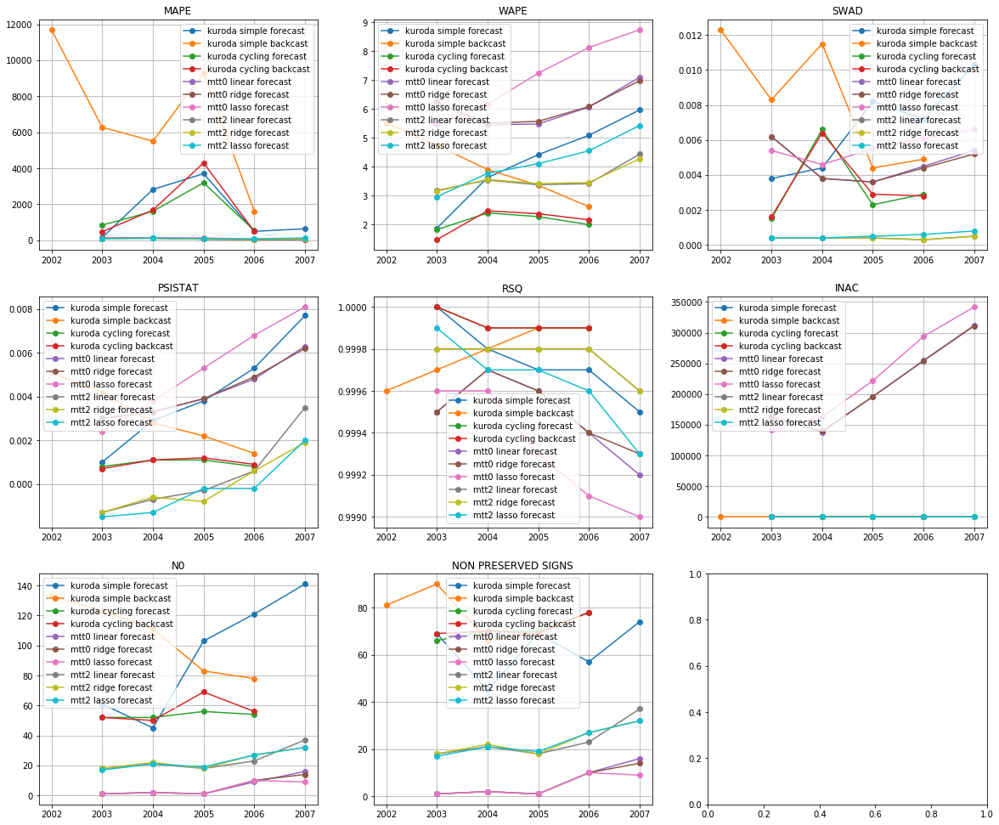

,MAPE,MAPE_R,WAPE,WAPE_R,SWAD,SWAD_R,PSISTAT,PSISTAT_R,RSQ,RSQ_R,INAC,INAC_R,N0,NON PRESERVED SIGNS,R_all,CmR
insd cycling forecast,17.735875,4,1.867700,1,0.003225,7,0.000500,4,0.999950,1,0.00000,1,71.50,71.5,18,1
insd cycling backcast,17.068400,2,1.925200,3,0.003175,4,0.000550,6,0.999925,3,0.00000,1,71.50,71.5,19,2
nras cycling forecast,17.686175,3,1.872850,2,0.003175,4,0.000525,5,0.999950,1,0.00020,10,2.50,71.5,25,3
nras cycling backcast,17.042400,1,1.932800,4,0.003175,4,0.000550,6,0.999925,3,0.00015,9,2.50,71.5,27,4
kuroda cycling forecast,1542.756400,15,2.120825,6,0.003325,8,0.000950,8,0.999925,3,0.00000,1,53.50,71.0,41,5
insd simple backcast,22.873120,6,3.102600,8,0.003880,11,0.001360,11,0.999840,7,0.00000,1,71.00,71.0,44,6
kuroda cycling backcast,1732.018875,17,2.119625,5,0.003425,9,0.000975,9,0.999925,3,0.00000,1,56.75,71.5,44,6
nras simple backcast,22.787000,5,3.094320,7,0.003840,10,0.001340,10,0.999840,7,0.00044,11,11.40,71.0,50,8
insd simple forecast,25.428600,8,3.403260,9,0.004480,12,0.001640,12,0.999800,9,0.00000,1,72.60,72.6,51,9
mtt2 ridge forecast,77.438700,12,3.570140,11,0.000400,1,-0.000040,2,0.999760,12,0.14940,13,23.40,23.4,51,9


In [36]:
metrics_res['USA'] = get_results('USA')

ESP
use basic I+II
[1995 1996 1997 1998 1999 2000]
available mtypes: [0]
nras simple forecast
nras simple backcast
final cycle: 10
nras cycling forecast
final cycle: 10
nras cycling backcast


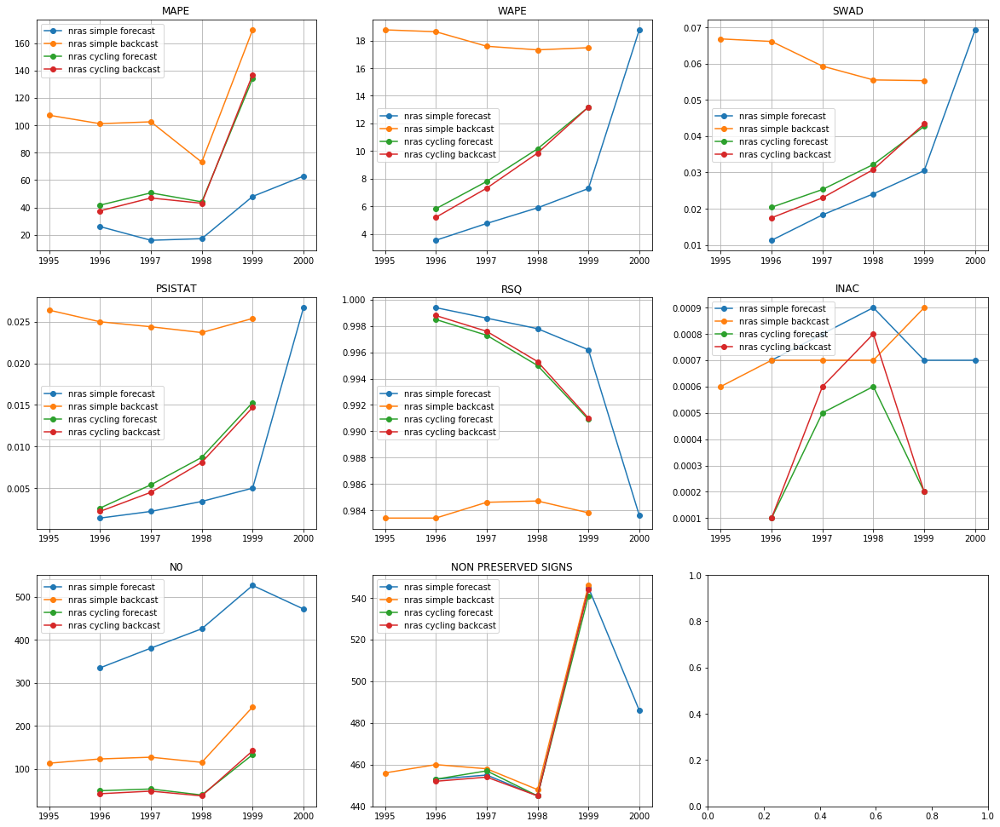

insd simple forecast
insd simple backcast
final cycle: 10
insd cycling forecast
final cycle: 10
insd cycling backcast


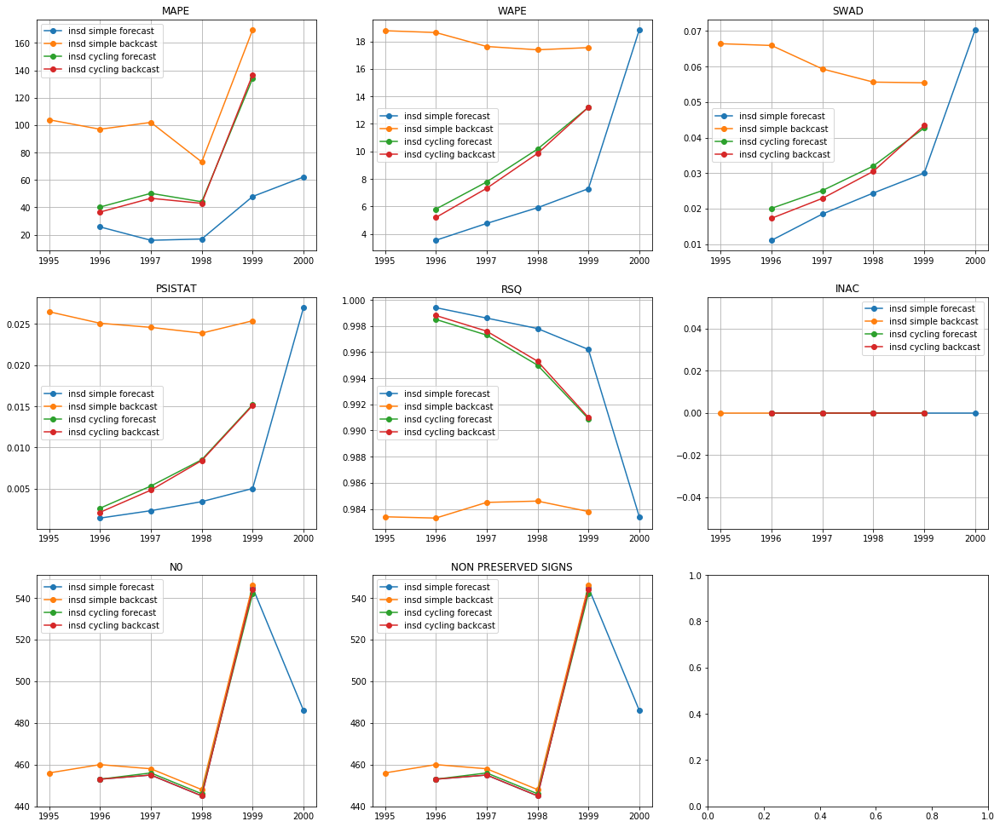

kuroda simple forecast
kuroda simple backcast
final cycle: 10
kuroda cycling forecast
final cycle: 10
kuroda cycling backcast


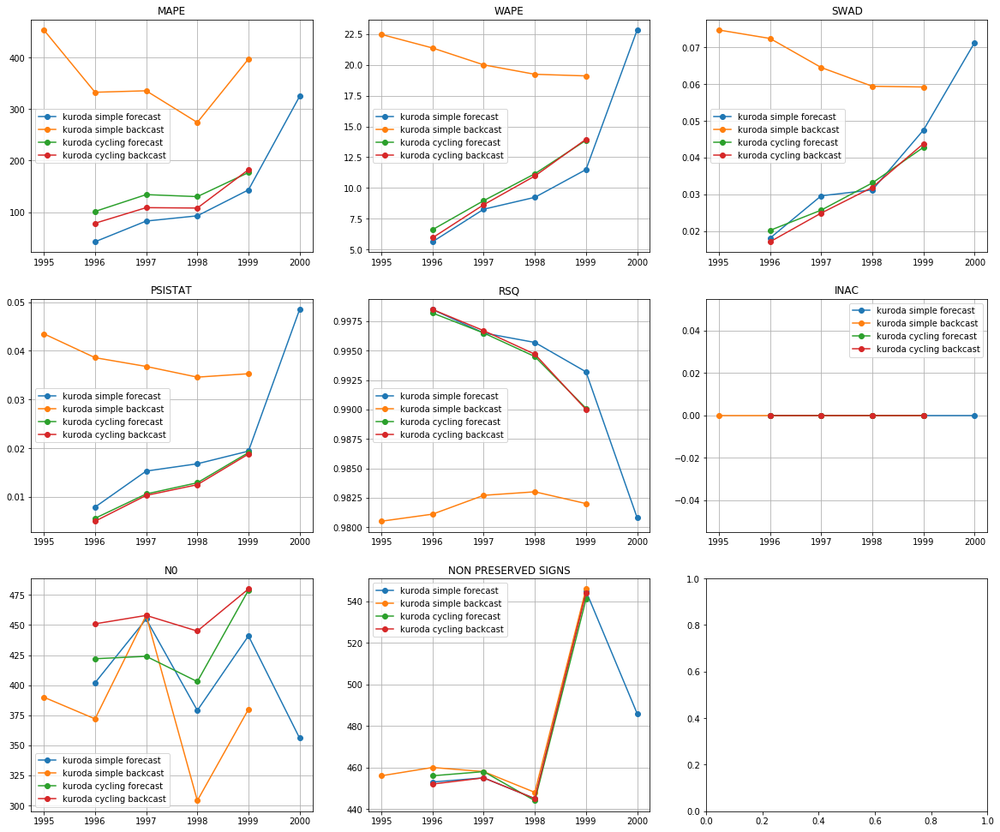

,MAPE,MAPE_R,WAPE,WAPE_R,SWAD,SWAD_R,PSISTAT,PSISTAT_R,RSQ,RSQ_R,INAC,INAC_R,N0,NON PRESERVED SIGNS,R_all,CmR
insd cycling backcast,65.765675,3,8.891275,4,0.028525,1,0.007600,2,0.995675,1,0.000000,1,474.25,474.25,12,1
nras cycling backcast,66.130300,4,8.884475,3,0.028675,2,0.007375,1,0.995675,1,0.000425,10,67.25,473.75,21,2
insd simple forecast,33.748080,1,8.064920,2,0.030860,8,0.007820,4,0.995080,6,0.000000,1,476.80,476.80,22,3
insd cycling forecast,67.178525,5,9.238300,6,0.029975,4,0.007900,5,0.995425,3,0.000000,1,474.25,474.25,24,4
nras simple forecast,34.032440,2,8.046960,1,0.030700,7,0.007740,3,0.995120,5,0.000760,12,428.20,476.80,30,5
nras cycling forecast,67.636000,6,9.238200,5,0.030150,5,0.008000,6,0.995425,3,0.000350,9,68.50,474.00,34,6
kuroda cycling backcast,119.313775,9,9.881150,7,0.029425,3,0.011650,7,0.994975,7,0.000000,1,458.50,474.00,34,6
kuroda cycling forecast,135.524250,10,10.154375,8,0.030450,6,0.012050,8,0.994825,8,0.000000,1,432.00,474.75,41,8
kuroda simple forecast,137.145660,11,11.495520,9,0.039540,9,0.021580,9,0.992940,9,0.000000,1,406.60,476.80,48,9
insd simple backcast,109.158880,7,18.001120,11,0.060520,10,0.025100,11,0.983920,11,0.000000,1,473.60,473.60,51,10


[2000 2001 2002 2003 2004 2005]
available mtypes: [0]
nras simple forecast
nras simple backcast
final cycle: 10
nras cycling forecast
final cycle: 10
nras cycling backcast


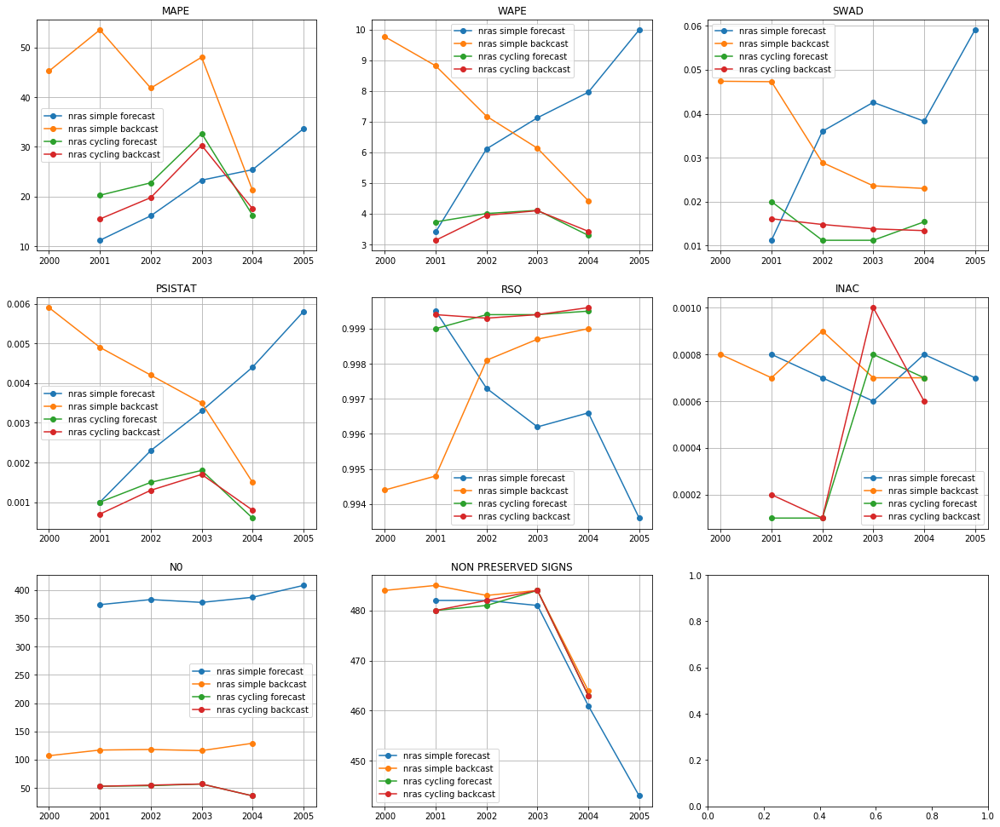

insd simple forecast
insd simple backcast
final cycle: 10
insd cycling forecast
final cycle: 10
insd cycling backcast


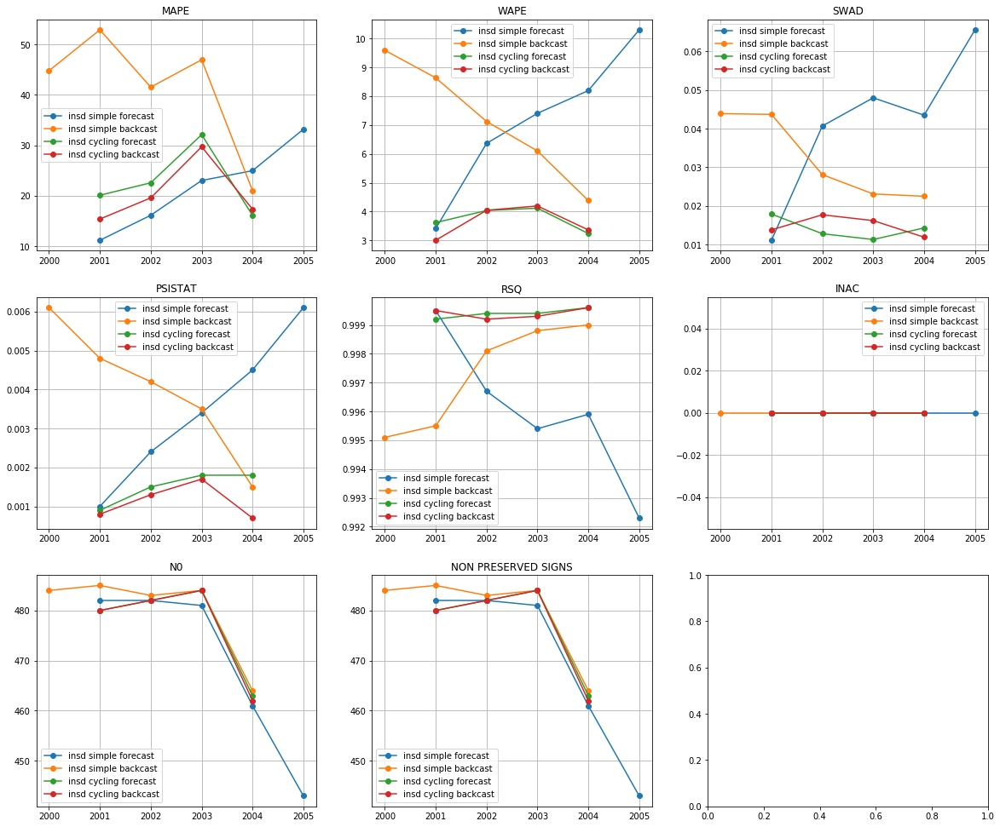

kuroda simple forecast
kuroda simple backcast
final cycle: 10
kuroda cycling forecast
final cycle: 10
kuroda cycling backcast


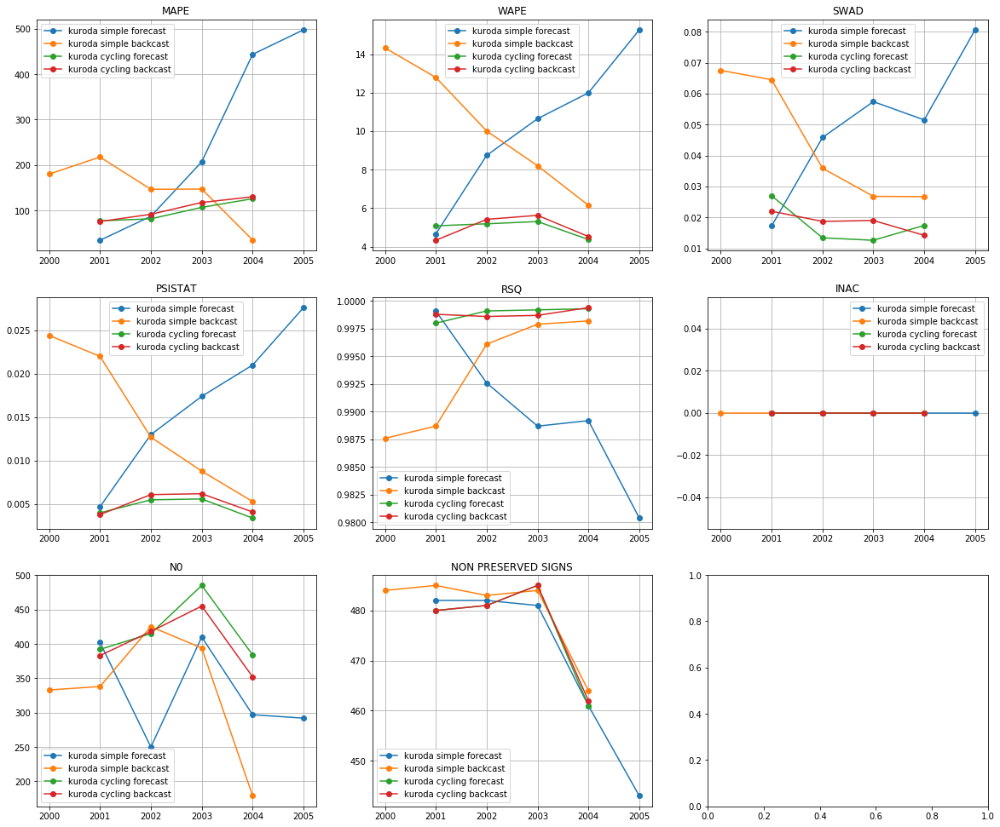

,MAPE,MAPE_R,WAPE,WAPE_R,SWAD,SWAD_R,PSISTAT,PSISTAT_R,RSQ,RSQ_R,INAC,INAC_R,N0,NON PRESERVED SIGNS,R_all,CmR
insd cycling backcast,20.517850,1,3.653775,2,0.014900,4,0.001125,1,0.999400,2,0.000000,1,477.00,477.00,11,1
insd cycling forecast,22.734000,5,3.754750,3,0.014075,1,0.001500,4,0.999400,2,0.000000,1,477.25,477.25,16,2
nras cycling backcast,20.788225,2,3.652600,1,0.014525,3,0.001125,2,0.999425,1,0.000475,10,50.25,477.25,19,3
nras cycling forecast,22.994475,6,3.787350,4,0.014450,2,0.001225,3,0.999325,4,0.000425,9,50.00,477.00,28,4
kuroda cycling forecast,97.944875,9,4.985950,6,0.017600,5,0.004625,9,0.998900,5,0.000000,1,419.00,476.75,35,5
insd simple forecast,21.710720,3,7.136160,8,0.041780,10,0.003480,6,0.995960,10,0.000000,1,469.80,469.80,38,6
kuroda cycling backcast,103.820425,10,4.975225,5,0.018475,6,0.005050,10,0.998875,6,0.000000,1,402.00,477.00,38,6
insd simple backcast,41.427500,7,7.169000,9,0.032260,7,0.004020,8,0.997300,7,0.000000,1,480.00,480.00,39,8
nras simple forecast,21.936880,4,6.921260,7,0.037440,9,0.003360,5,0.996640,9,0.000720,11,386.00,469.80,45,9
nras simple backcast,41.968160,8,7.265140,10,0.034040,8,0.004000,7,0.997000,8,0.000760,12,117.40,480.00,53,10


use basic I
[1995 1996 1997 1998 1999 2000]
available mtypes: [0]
nras simple forecast
nras simple backcast
final cycle: 10
nras cycling forecast
final cycle: 10
nras cycling backcast


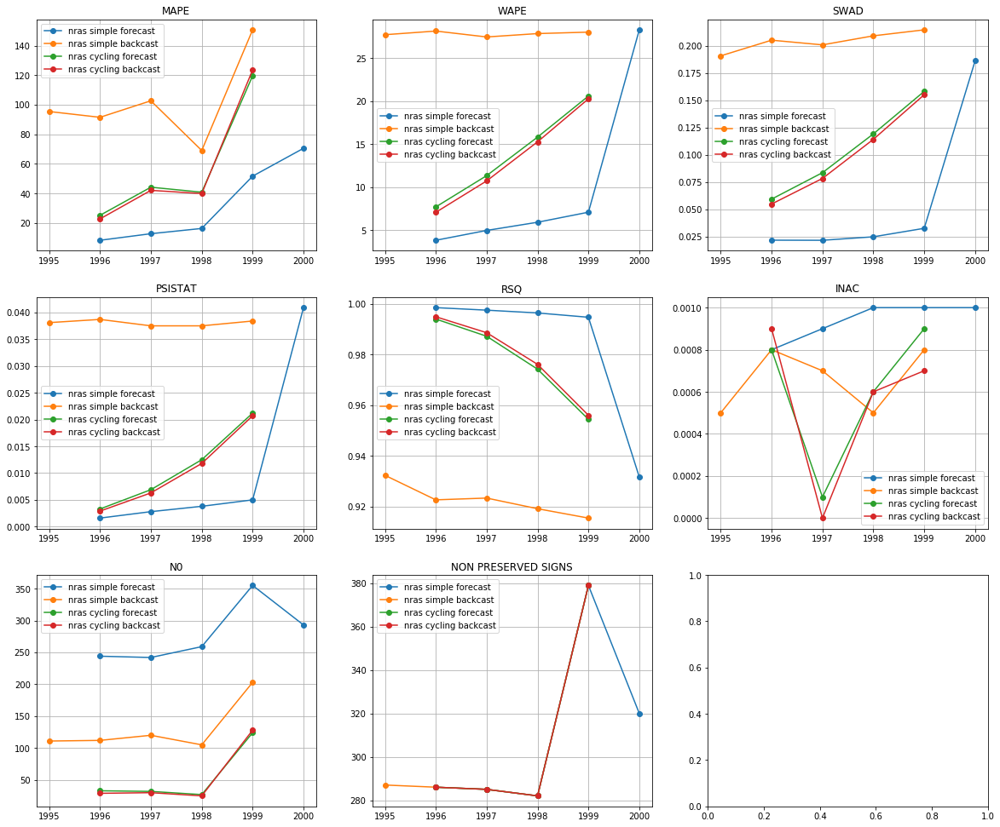

insd simple forecast
insd simple backcast
final cycle: 10
insd cycling forecast
final cycle: 10
insd cycling backcast


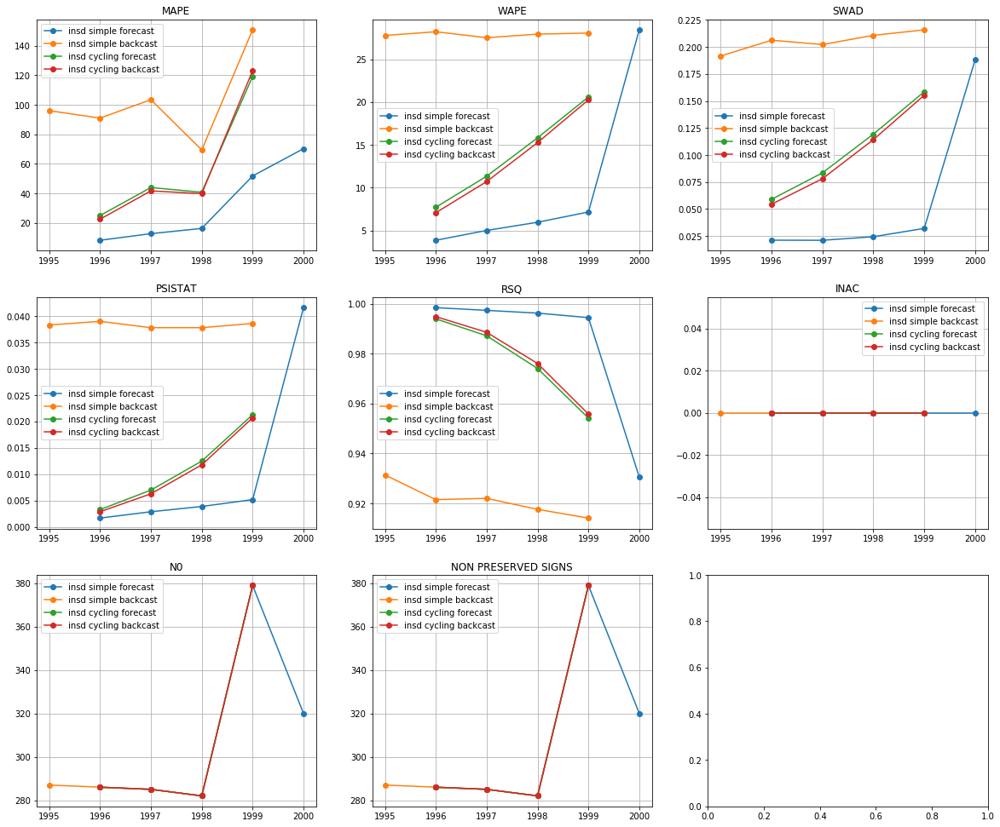

kuroda simple forecast
kuroda simple backcast
final cycle: 10
kuroda cycling forecast
final cycle: 10
kuroda cycling backcast


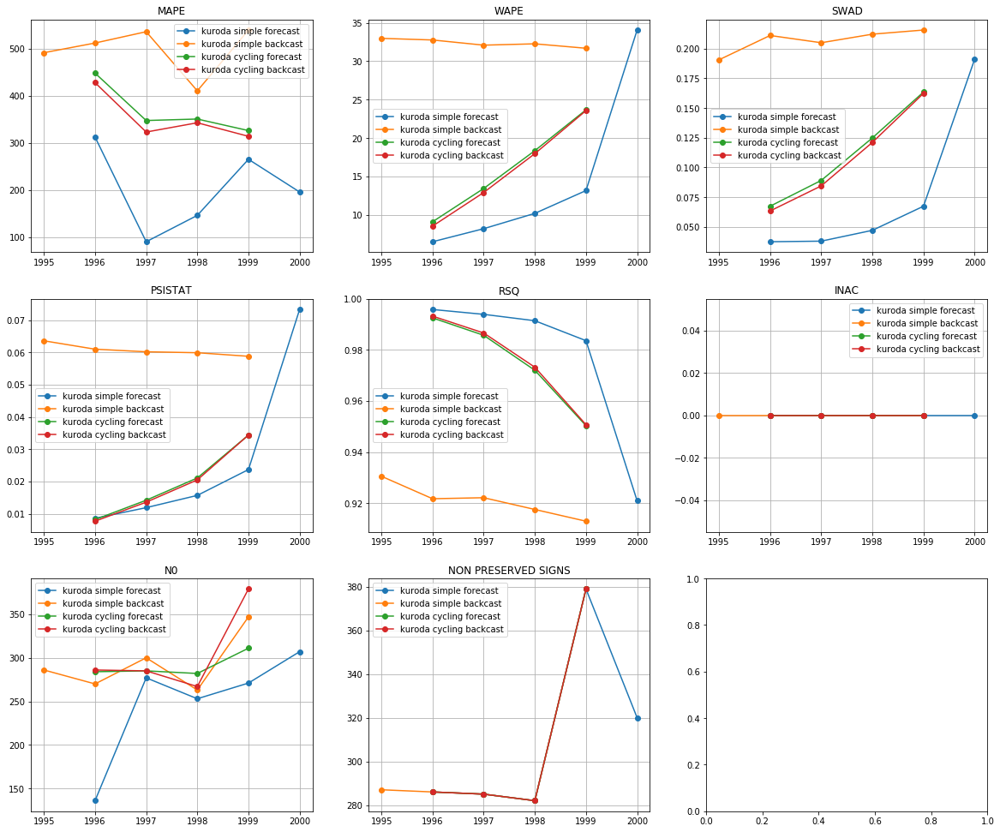

,MAPE,MAPE_R,WAPE,WAPE_R,SWAD,SWAD_R,PSISTAT,PSISTAT_R,RSQ,RSQ_R,INAC,INAC_R,N0,NON PRESERVED SIGNS,R_all,CmR
insd simple forecast,31.856980,2,10.087940,2,0.057340,2,0.011060,6,0.983440,2,0.00000,1,310.40,310.4,15,1
insd cycling backcast,56.777150,3,13.330125,3,0.100525,4,0.010425,1,0.978850,4,0.00000,1,308.00,308.0,16,2
nras simple forecast,31.853500,1,10.032660,1,0.057320,1,0.010820,3,0.983740,1,0.00094,12,278.60,310.4,19,3
nras cycling backcast,57.032575,4,13.342025,4,0.100625,5,0.010425,1,0.978900,3,0.00055,9,53.00,308.0,26,4
insd cycling forecast,57.235475,5,13.868725,5,0.105075,6,0.011025,5,0.977375,6,0.00000,1,308.00,308.0,28,5
kuroda simple forecast,201.696220,9,14.422080,7,0.076220,3,0.026640,9,0.977120,7,0.00000,1,248.80,310.4,36,6
nras cycling forecast,57.402450,6,13.870100,6,0.105100,7,0.010975,4,0.977450,5,0.00060,10,54.00,308.0,38,7
kuroda cycling backcast,351.579150,10,15.745625,8,0.107850,8,0.019050,7,0.975925,8,0.00000,1,304.25,308.0,42,8
kuroda cycling forecast,367.769975,11,16.139525,9,0.111225,9,0.019475,8,0.975125,9,0.00000,1,290.50,308.0,47,9
insd simple backcast,102.125200,8,27.896020,11,0.205300,11,0.038300,11,0.921320,11,0.00000,1,303.80,303.8,53,10


[2000 2001 2002 2003 2004 2005]
available mtypes: [0]
nras simple forecast
nras simple backcast
final cycle: 10
nras cycling forecast
final cycle: 10
nras cycling backcast


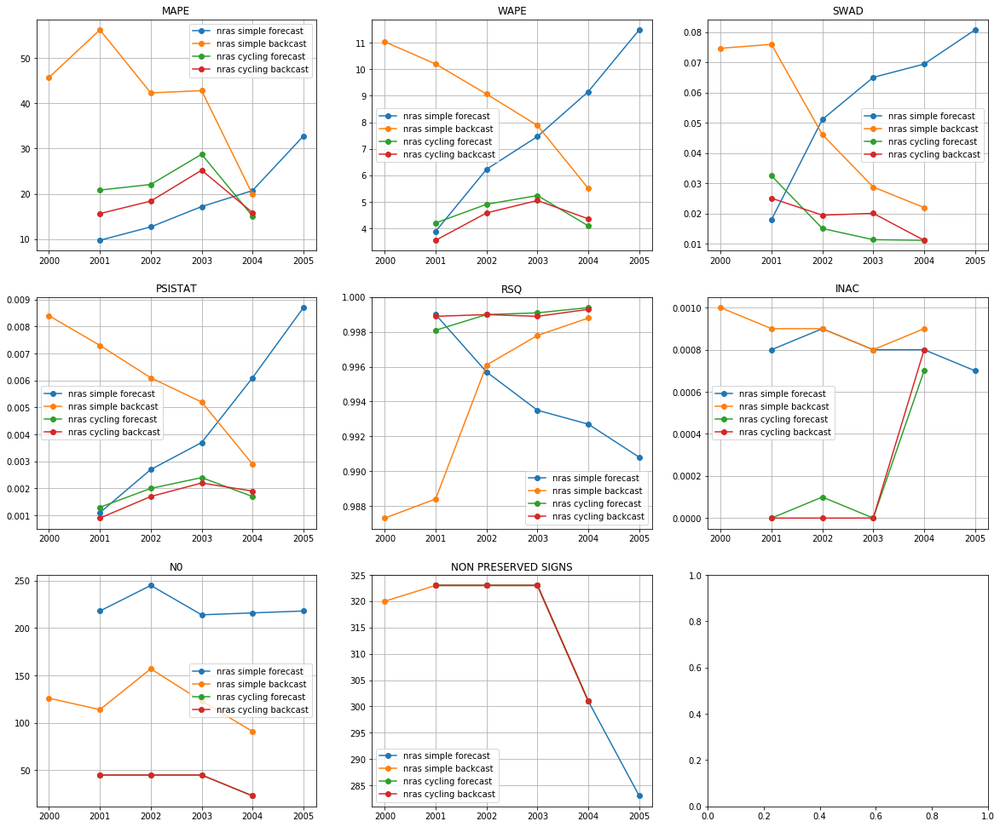

insd simple forecast
insd simple backcast
final cycle: 10
insd cycling forecast
final cycle: 10
insd cycling backcast


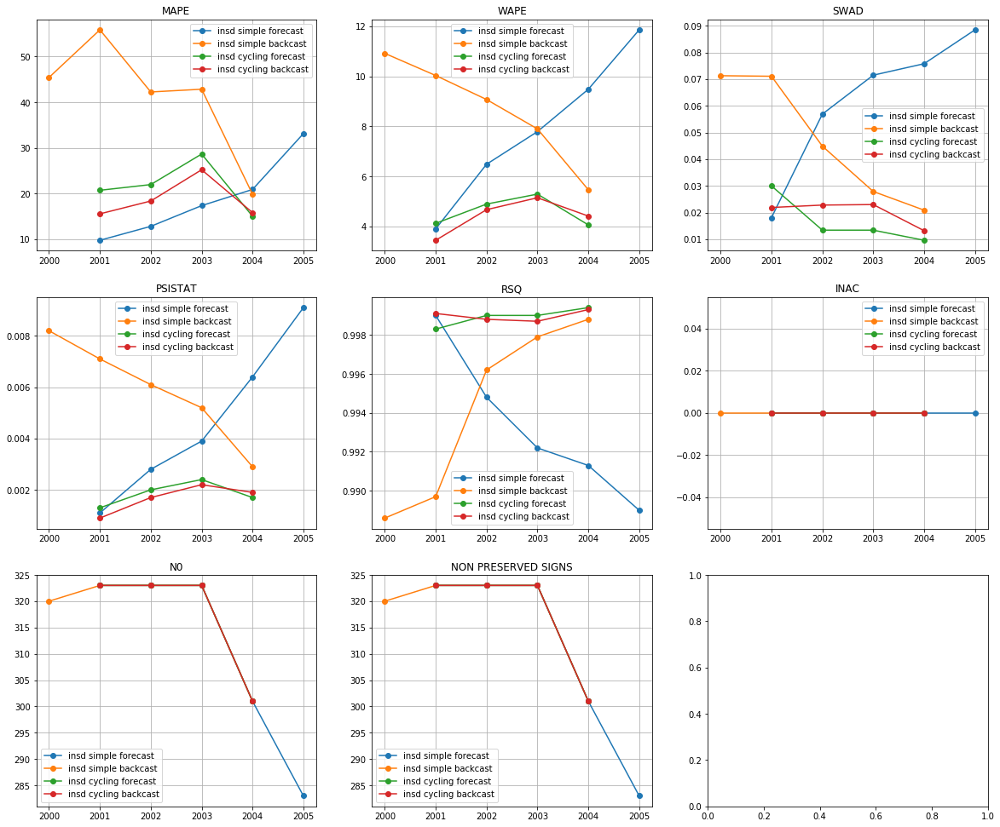

kuroda simple forecast
kuroda simple backcast
final cycle: 10
kuroda cycling forecast
final cycle: 10
kuroda cycling backcast


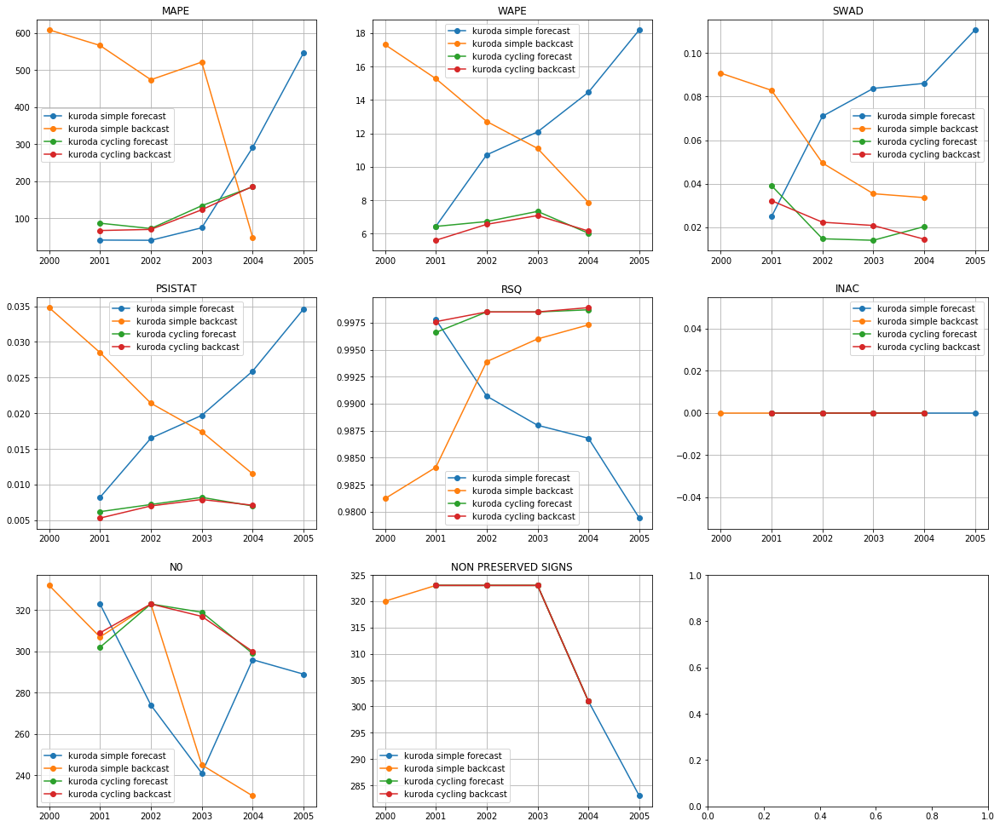

,MAPE,MAPE_R,WAPE,WAPE_R,SWAD,SWAD_R,PSISTAT,PSISTAT_R,RSQ,RSQ_R,INAC,INAC_R,N0,NON PRESERVED SIGNS,R_all,CmR
insd cycling backcast,18.707225,2,4.415075,2,0.020225,4,0.001675,1,0.998975,2,0.0000,1,317.50,317.5,12,1
insd cycling forecast,21.562950,5,4.588325,3,0.016600,1,0.001850,3,0.998925,3,0.0000,1,317.50,317.5,16,2
nras cycling backcast,18.765575,4,4.389775,1,0.018975,3,0.001675,1,0.999025,1,0.0002,9,39.50,317.5,19,3
nras cycling forecast,21.671575,6,4.614700,4,0.017550,2,0.001850,3,0.998900,4,0.0002,9,39.50,317.5,28,4
kuroda cycling backcast,111.746675,9,6.349375,5,0.022450,6,0.006825,9,0.998375,5,0.0000,1,312.25,317.5,35,5
kuroda cycling forecast,119.660450,10,6.627525,6,0.022025,5,0.007150,10,0.998075,6,0.0000,1,310.75,317.5,38,6
insd simple forecast,18.759340,3,7.900300,8,0.062160,11,0.004660,6,0.993260,10,0.0000,1,310.60,310.6,39,7
insd simple backcast,41.248180,7,8.675000,9,0.047220,7,0.005900,7,0.994240,8,0.0000,1,318.00,318.0,39,7
nras simple forecast,18.611140,1,7.646840,7,0.056840,9,0.004460,5,0.994340,7,0.0008,11,222.20,310.6,40,9
nras simple backcast,41.406900,8,8.736540,10,0.049480,8,0.005980,8,0.993680,9,0.0009,12,122.20,318.0,55,10


use purchase I+II
[1995 1996 1997 1998 1999 2000]
available mtypes: [0]
nras simple forecast
nras simple backcast
final cycle: 10
nras cycling forecast
final cycle: 10
nras cycling backcast


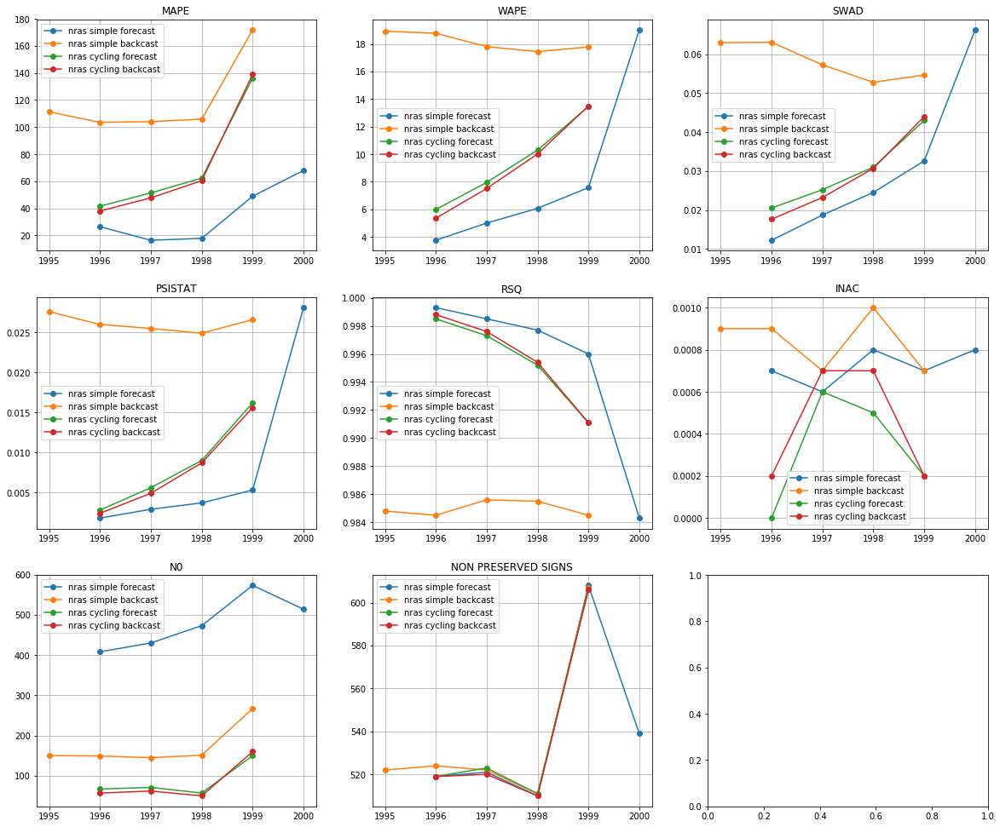

insd simple forecast
insd simple backcast
final cycle: 10
insd cycling forecast
final cycle: 10
insd cycling backcast


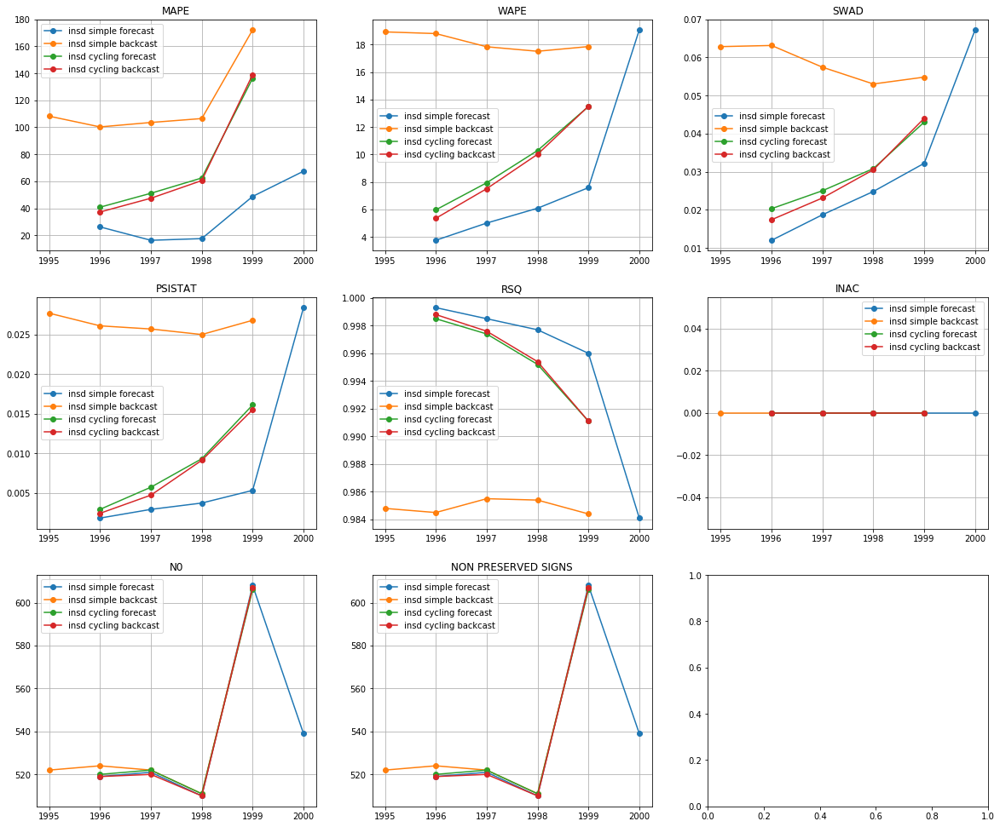

kuroda simple forecast
kuroda simple backcast
final cycle: 10
kuroda cycling forecast
final cycle: 10
kuroda cycling backcast


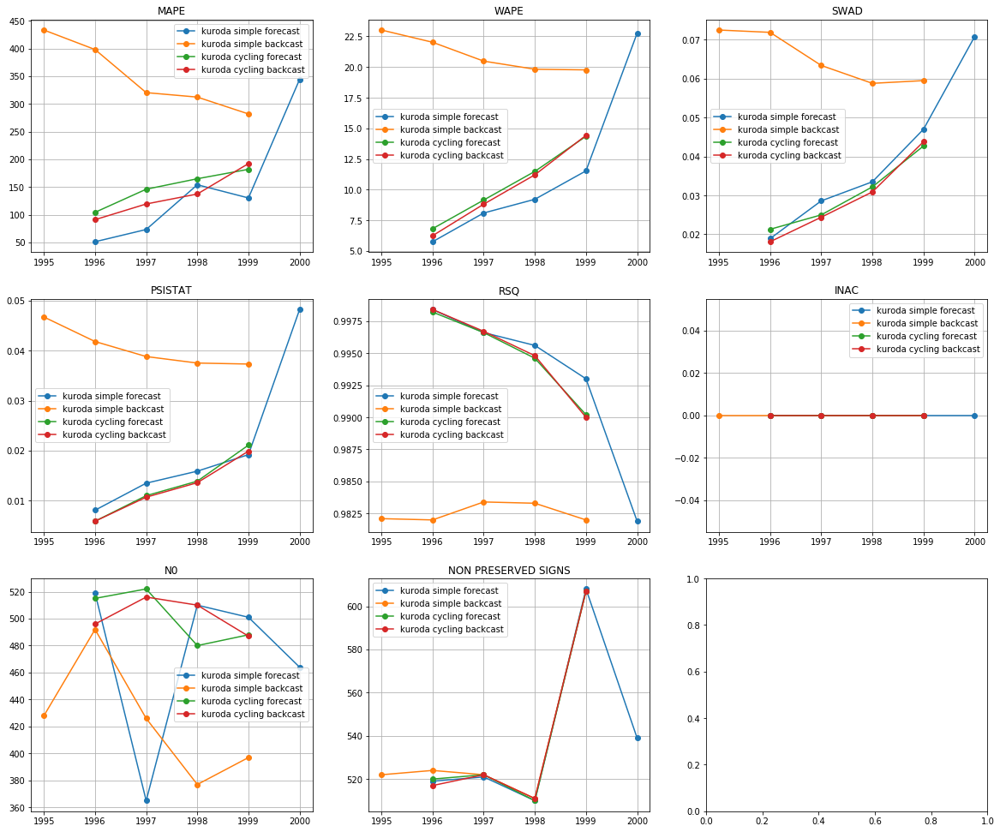

,MAPE,MAPE_R,WAPE,WAPE_R,SWAD,SWAD_R,PSISTAT,PSISTAT_R,RSQ,RSQ_R,INAC,INAC_R,N0,NON PRESERVED SIGNS,R_all,CmR
insd cycling backcast,71.058375,3,9.093775,3,0.028750,1,0.007925,2,0.995725,1,0.000000,1,539.00,539.00,11,1
nras cycling backcast,71.276675,4,9.094525,4,0.028875,2,0.007900,1,0.995725,1,0.000450,10,82.25,538.75,22,2
insd simple forecast,35.268520,1,8.299280,2,0.030980,8,0.008420,5,0.995120,6,0.000000,1,539.40,539.40,23,3
insd cycling forecast,72.661475,5,9.419650,5,0.029775,4,0.008500,6,0.995550,3,0.000000,1,539.75,539.75,24,4
nras simple forecast,35.467860,2,8.285980,1,0.030860,7,0.008360,3,0.995160,5,0.000720,11,479.60,539.40,29,5
nras cycling forecast,72.849475,6,9.424950,6,0.029925,5,0.008400,4,0.995525,4,0.000325,9,86.25,539.75,34,6
kuroda cycling backcast,134.954025,9,10.177600,7,0.029300,3,0.012525,7,0.994975,7,0.000000,1,502.25,539.25,34,6
kuroda cycling forecast,149.235450,10,10.456275,8,0.030300,6,0.012975,8,0.994900,8,0.000000,1,501.25,539.75,41,8
kuroda simple forecast,150.577160,11,11.473680,9,0.039760,9,0.020980,9,0.993100,9,0.000000,1,471.80,539.40,48,9
insd simple backcast,118.132200,7,18.185320,11,0.058220,11,0.026260,11,0.984920,11,0.000000,1,537.20,537.20,52,10


[2000 2001 2002 2003 2004 2005]
available mtypes: [0]
nras simple forecast
nras simple backcast
final cycle: 10
nras cycling forecast
final cycle: 10
nras cycling backcast


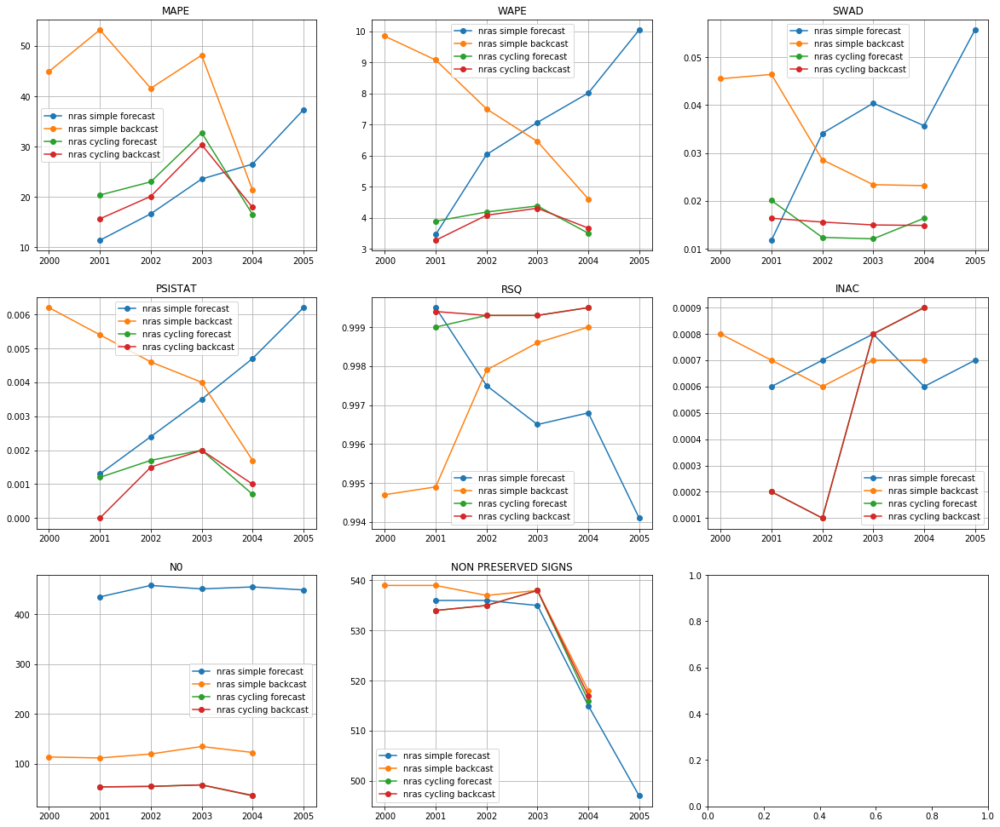

insd simple forecast
insd simple backcast
final cycle: 10
insd cycling forecast
final cycle: 10
insd cycling backcast


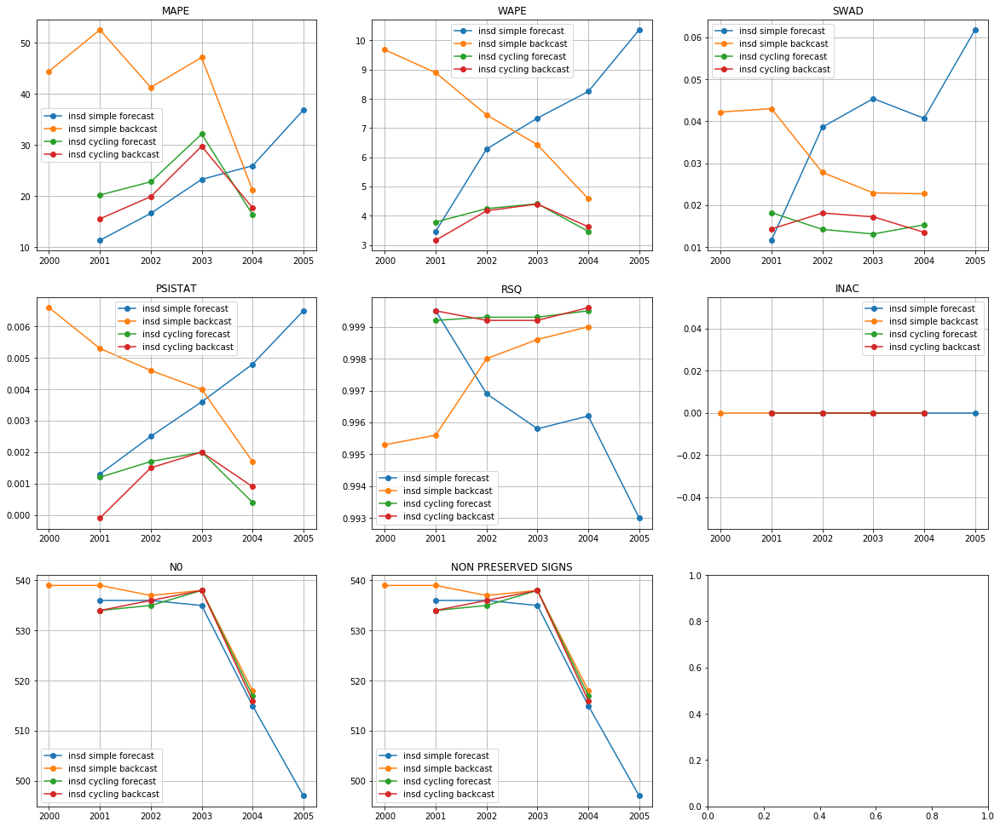

kuroda simple forecast
kuroda simple backcast
final cycle: 10
kuroda cycling forecast
final cycle: 10
kuroda cycling backcast


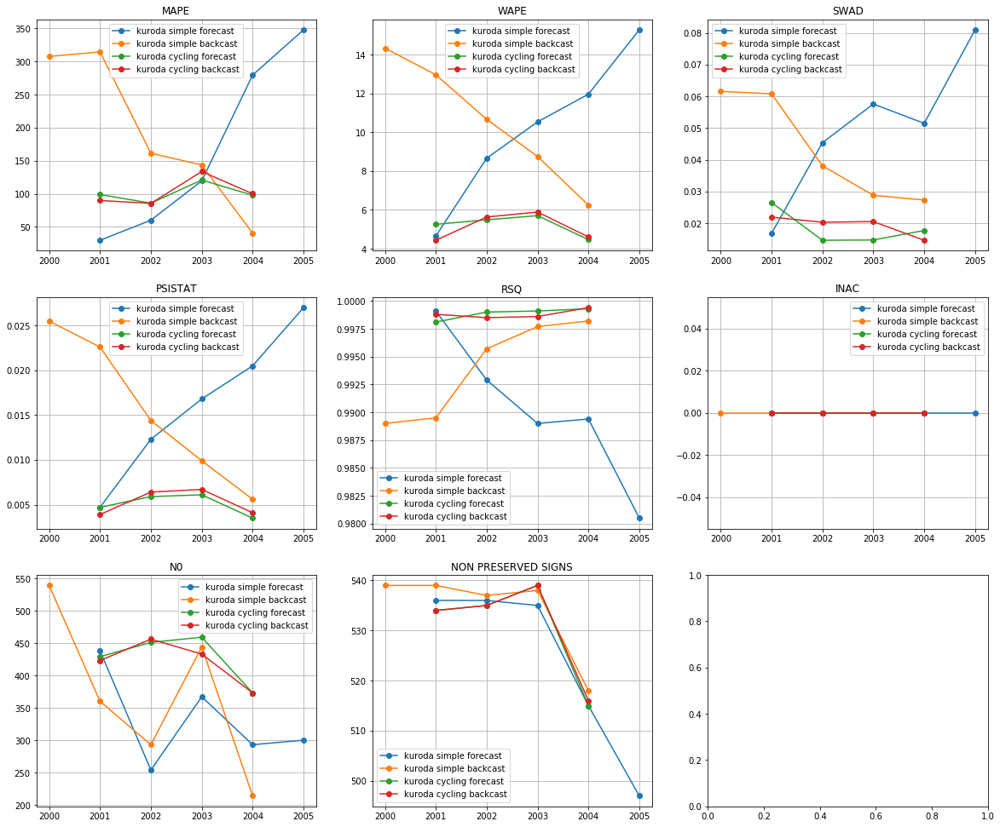

,MAPE,MAPE_R,WAPE,WAPE_R,SWAD,SWAD_R,PSISTAT,PSISTAT_R,RSQ,RSQ_R,INAC,INAC_R,N0,NON PRESERVED SIGNS,R_all,CmR
insd cycling backcast,20.717825,1,3.836475,1,0.015775,4,0.001075,1,0.999375,1,0.00000,1,531.00,531.00,9,1
insd cycling forecast,22.868775,4,3.974200,3,0.015200,1,0.001325,3,0.999325,3,0.00000,1,531.00,531.00,15,2
nras cycling backcast,20.994900,2,3.840175,2,0.015475,3,0.001125,2,0.999375,2,0.00050,9,51.00,531.00,20,3
nras cycling forecast,23.140450,6,3.997150,4,0.015250,2,0.001400,4,0.999275,4,0.00050,9,50.75,530.75,29,4
kuroda cycling forecast,100.930900,9,5.230175,6,0.018375,5,0.005050,9,0.998875,5,0.00000,1,428.00,530.75,35,5
insd simple forecast,22.797480,3,7.139480,8,0.039620,10,0.003740,6,0.996280,10,0.00000,1,523.80,523.80,38,6
kuroda cycling backcast,102.352525,10,5.141600,5,0.019325,6,0.005275,10,0.998825,6,0.00000,1,421.25,531.00,38,6
insd simple backcast,41.304680,7,7.406340,9,0.031720,7,0.004440,8,0.997300,7,0.00000,1,534.20,534.20,39,8
nras simple forecast,23.066520,5,6.930600,7,0.035540,9,0.003620,5,0.996880,9,0.00068,11,449.60,523.80,46,9
nras simple backcast,41.842560,8,7.503120,10,0.033420,8,0.004380,7,0.997020,8,0.00070,12,120.80,534.20,53,10


use purchase I
[1995 1996 1997 1998 1999 2000]
available mtypes: [0]
nras simple forecast
nras simple backcast
final cycle: 10
nras cycling forecast
final cycle: 10
nras cycling backcast


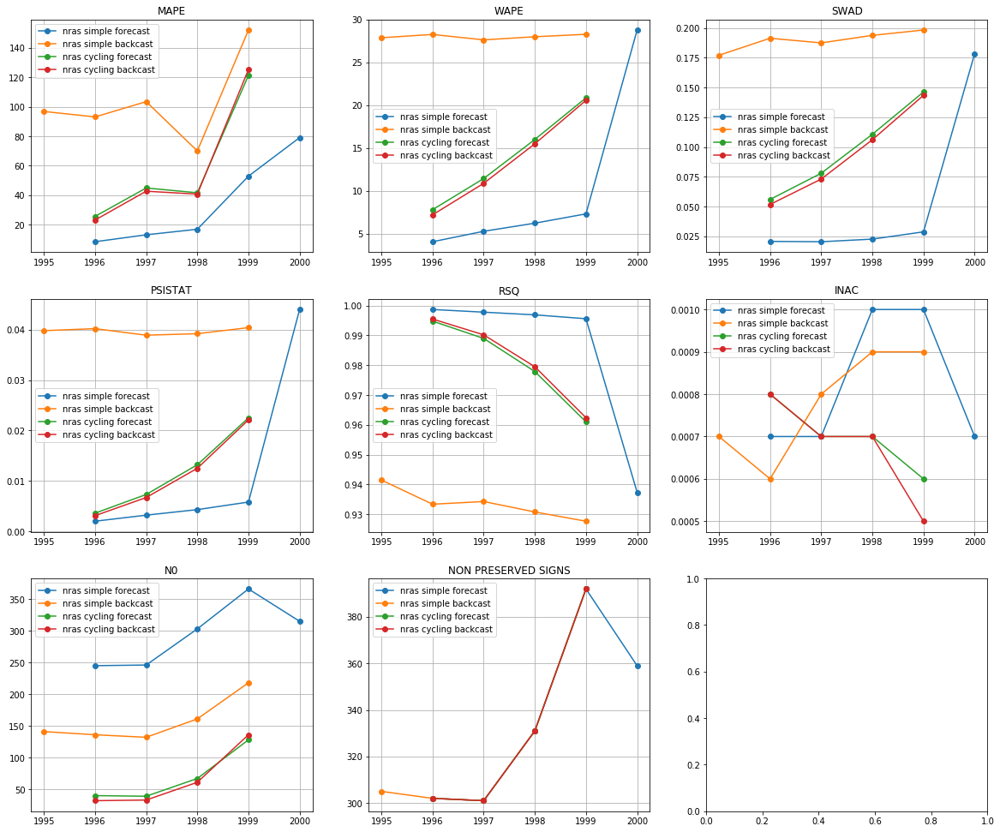

insd simple forecast
insd simple backcast
final cycle: 10
insd cycling forecast
final cycle: 10
insd cycling backcast


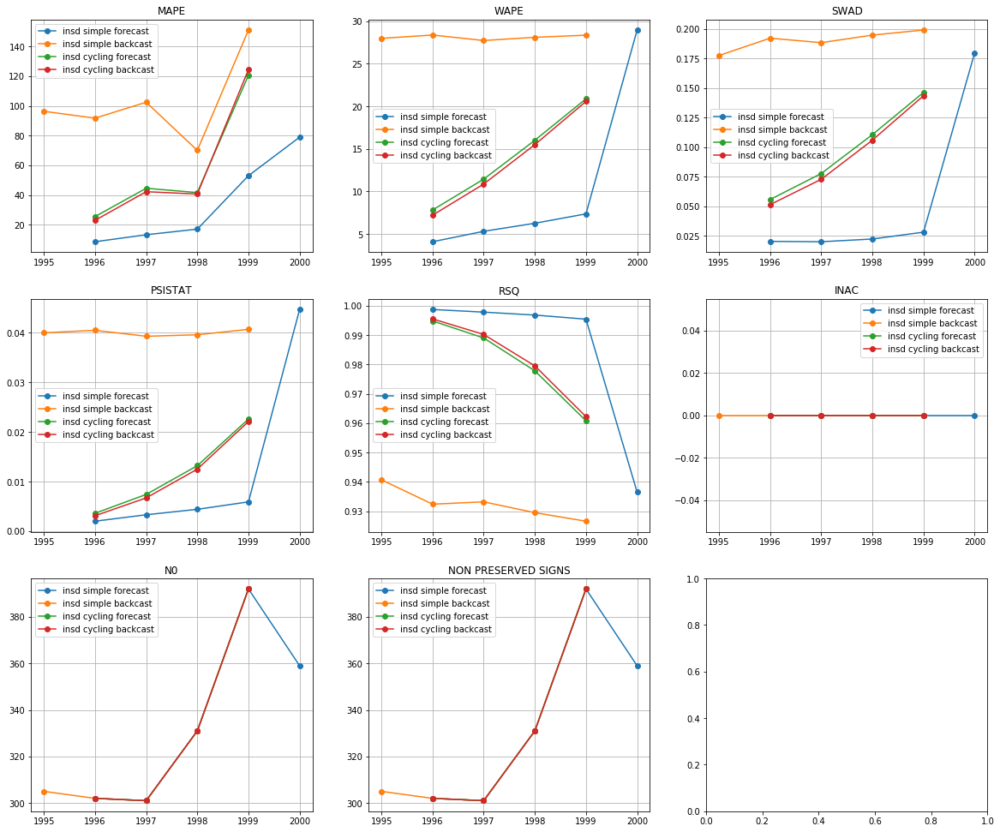

kuroda simple forecast
kuroda simple backcast
final cycle: 10
kuroda cycling forecast
final cycle: 10
kuroda cycling backcast


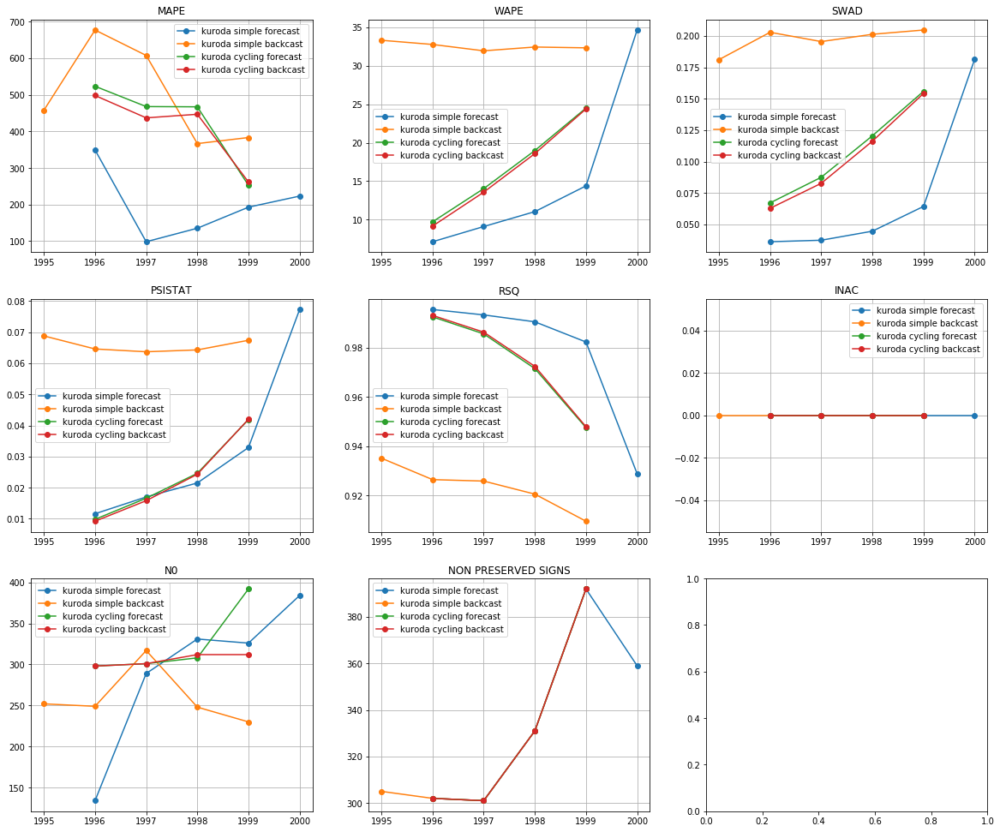

,MAPE,MAPE_R,WAPE,WAPE_R,SWAD,SWAD_R,PSISTAT,PSISTAT_R,RSQ,RSQ_R,INAC,INAC_R,N0,NON PRESERVED SIGNS,R_all,CmR
insd simple forecast,34.143940,1,10.401300,2,0.054180,1,0.012060,6,0.985040,2,0.000000,1,337.00,337.0,13,1
insd cycling backcast,57.564500,3,13.538275,3,0.093500,4,0.011100,1,0.981850,4,0.000000,1,331.50,331.5,16,2
nras simple forecast,34.160340,2,10.349260,1,0.054220,2,0.011860,5,0.985280,1,0.000820,12,295.00,337.0,23,3
nras cycling backcast,57.998225,4,13.549650,4,0.093600,5,0.011100,1,0.981900,3,0.000675,9,65.50,331.5,26,4
insd cycling forecast,58.067050,5,14.039675,6,0.097675,6,0.011700,4,0.980600,6,0.000000,1,331.50,331.5,28,5
nras cycling forecast,58.405875,6,14.038750,5,0.097725,7,0.011650,3,0.980675,5,0.000700,10,68.50,331.5,36,6
kuroda simple forecast,199.819040,9,15.257280,7,0.072780,3,0.032060,9,0.978080,7,0.000000,1,292.80,337.0,36,6
kuroda cycling backcast,410.846450,10,16.420550,8,0.103975,8,0.022825,7,0.974925,8,0.000000,1,305.75,331.5,42,8
kuroda cycling forecast,427.657900,11,16.802650,9,0.107750,9,0.023225,8,0.974275,9,0.000000,1,324.75,331.5,47,9
insd simple backcast,102.329840,7,28.099300,11,0.190500,11,0.040020,11,0.932480,11,0.000000,1,326.20,326.2,52,10


[2000 2001 2002 2003 2004 2005]
available mtypes: [0]
nras simple forecast
nras simple backcast
final cycle: 10
nras cycling forecast
final cycle: 10
nras cycling backcast


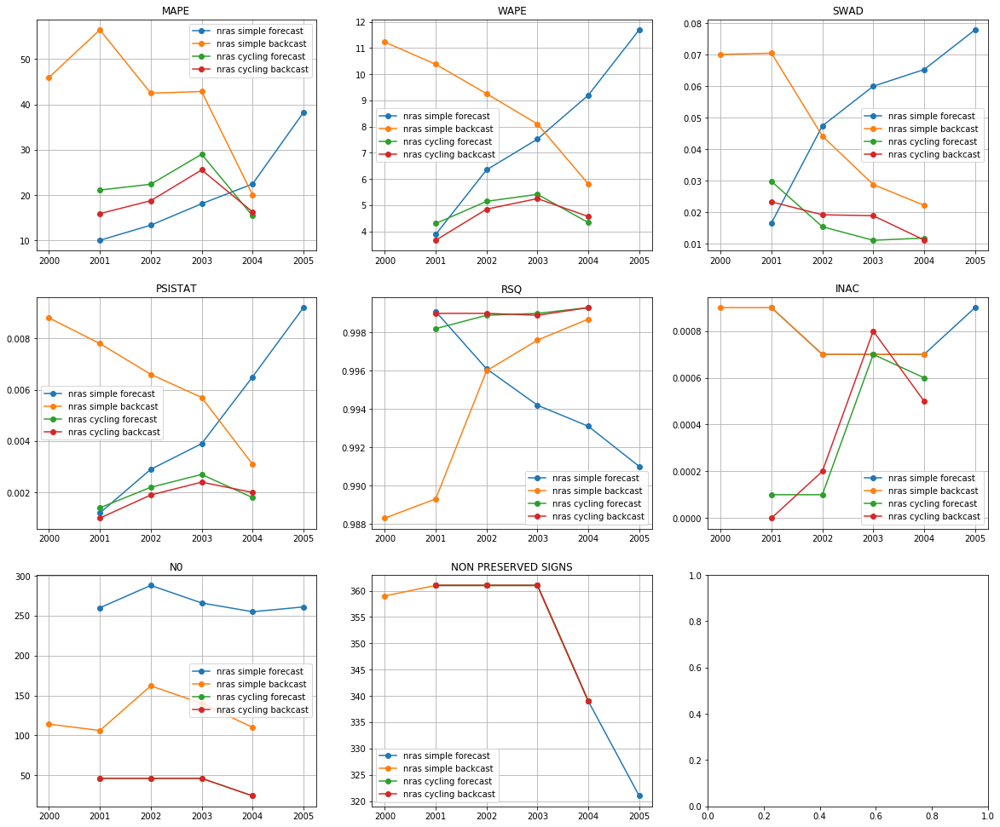

insd simple forecast
insd simple backcast
final cycle: 10
insd cycling forecast
final cycle: 10
insd cycling backcast


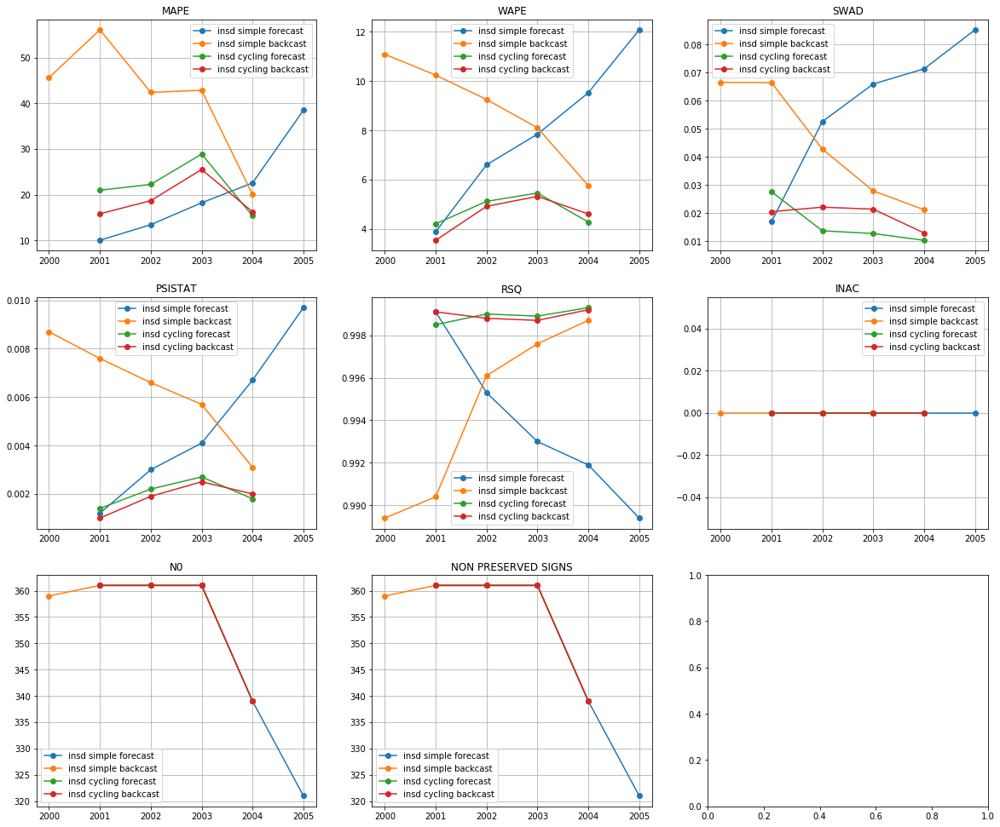

kuroda simple forecast
kuroda simple backcast
final cycle: 10
kuroda cycling forecast
final cycle: 10
kuroda cycling backcast


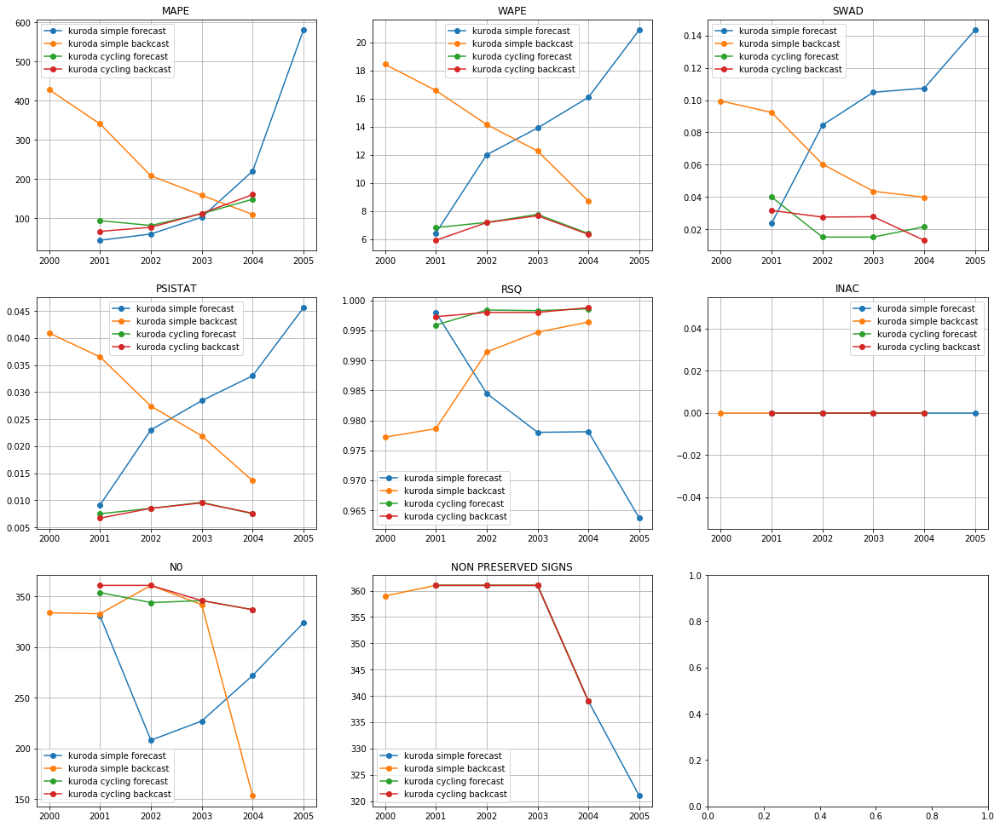

,MAPE,MAPE_R,WAPE,WAPE_R,SWAD,SWAD_R,PSISTAT,PSISTAT_R,RSQ,RSQ_R,INAC,INAC_R,N0,NON PRESERVED SIGNS,R_all,CmR
insd cycling backcast,19.058400,1,4.600425,2,0.019225,4,0.001850,2,0.998950,2,0.000000,1,355.50,355.5,12,1
insd cycling forecast,21.855725,5,4.769750,3,0.016075,1,0.002025,3,0.998925,3,0.000000,1,355.50,355.5,16,2
nras cycling backcast,19.127950,2,4.578200,1,0.018150,3,0.001825,1,0.999050,1,0.000375,9,40.50,355.5,17,3
nras cycling forecast,21.978925,6,4.795650,4,0.017025,2,0.002025,3,0.998850,4,0.000375,9,40.50,355.5,28,4
kuroda cycling backcast,104.183825,9,6.768700,5,0.024975,6,0.008075,9,0.998025,5,0.000000,1,351.25,355.5,35,5
kuroda cycling forecast,109.014300,10,7.036525,6,0.022900,5,0.008275,10,0.997800,6,0.000000,1,345.25,355.5,38,6
insd simple forecast,20.532980,4,7.986660,8,0.058440,10,0.004940,6,0.993740,10,0.000000,1,348.60,348.6,39,7
insd simple backcast,41.374660,7,8.886400,9,0.045000,7,0.006340,7,0.994440,8,0.000000,1,356.20,356.2,39,7
nras simple forecast,20.422400,3,7.726280,7,0.053440,9,0.004740,5,0.994700,7,0.000780,11,266.00,348.6,42,9
nras simple backcast,41.563200,8,8.951160,10,0.047160,8,0.006400,8,0.993980,9,0.000780,12,126.40,356.2,55,10


sup I
[1995 1996 1997 1998 1999 2000]
available mtypes: [0]
nras simple forecast
nras simple backcast
final cycle: 10
nras cycling forecast
final cycle: 10
nras cycling backcast


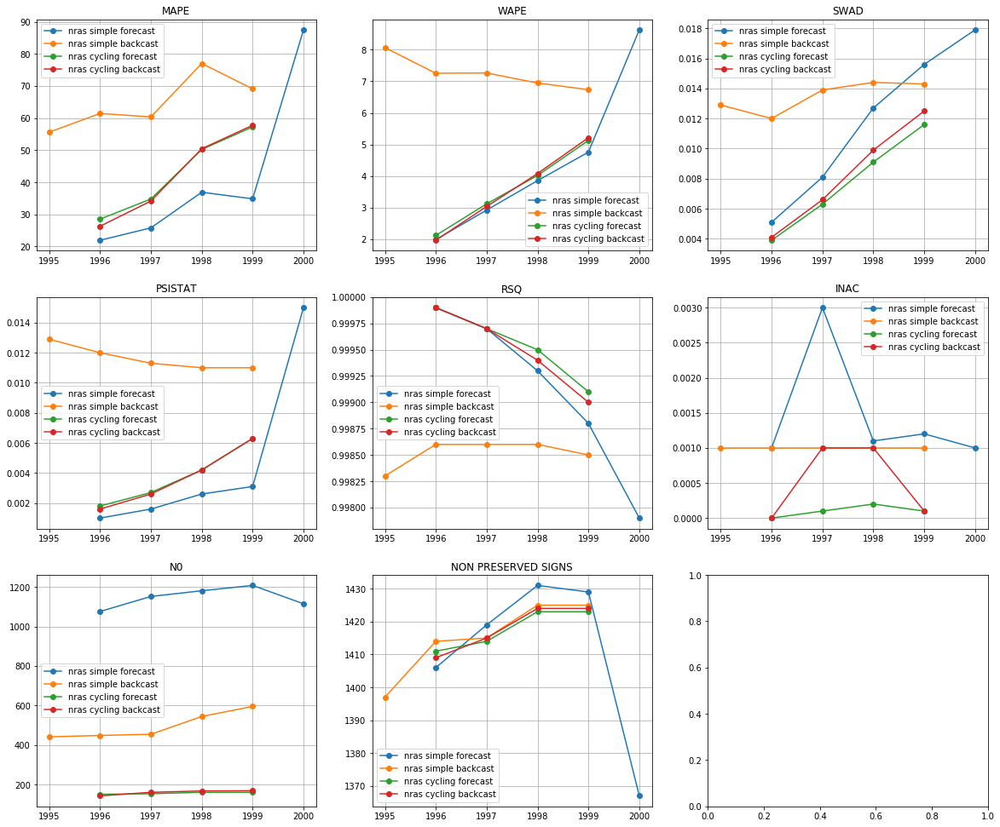

insd simple forecast
insd simple backcast
final cycle: 10
insd cycling forecast
final cycle: 10
insd cycling backcast


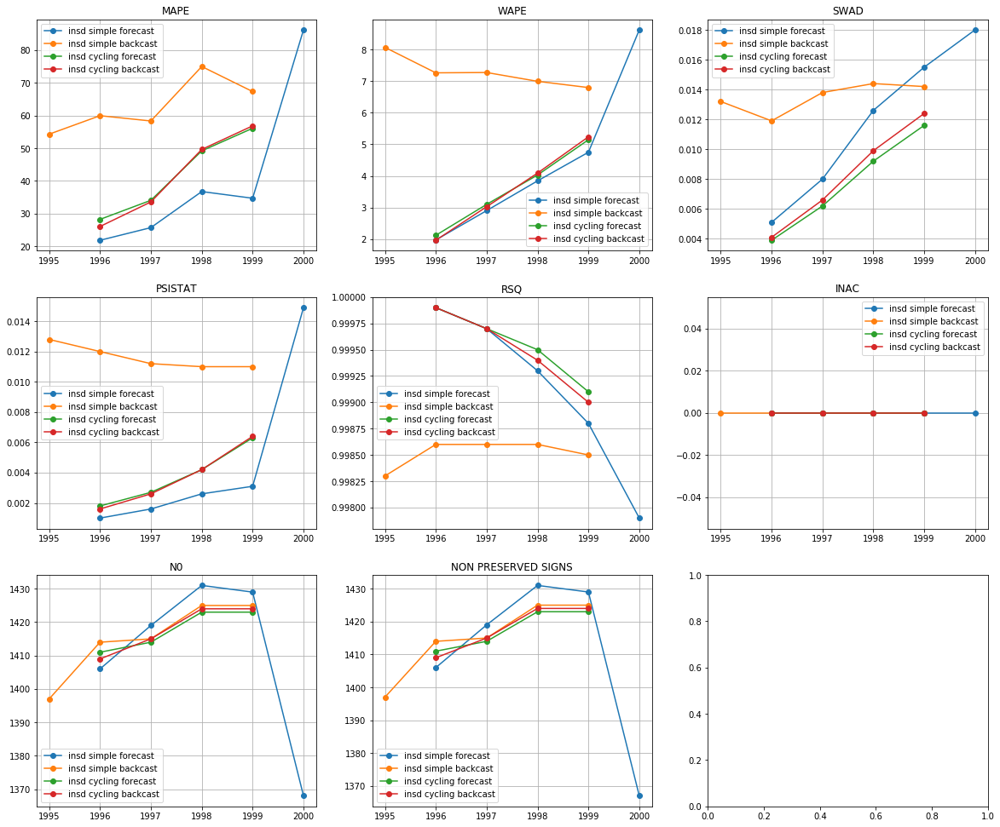

kuroda simple forecast
kuroda simple backcast
final cycle: 10
kuroda cycling forecast
final cycle: 10
kuroda cycling backcast


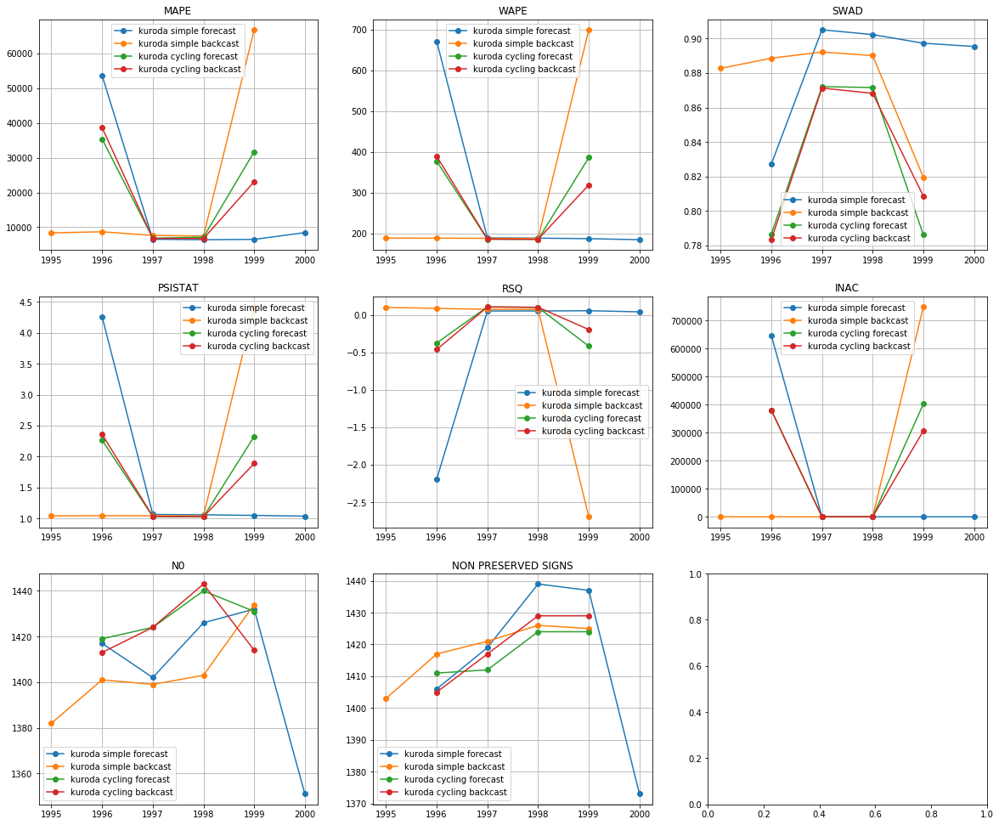

,MAPE,MAPE_R,WAPE,WAPE_R,SWAD,SWAD_R,PSISTAT,PSISTAT_R,RSQ,RSQ_R,INAC,INAC_R,N0,NON PRESERVED SIGNS,R_all,CmR
insd cycling forecast,41.913650,4,3.598450,4,0.007725,1,0.003750,3,0.999550,1,0.000000,1,1417.75,1417.75,14,1
insd cycling backcast,41.540950,3,3.579450,2,0.008250,3,0.003700,2,0.999500,3,0.000000,1,1418.00,1418.00,14,1
nras cycling forecast,42.689150,6,3.592150,3,0.007725,2,0.003750,3,0.999550,1,0.000100,5,155.75,1417.75,20,3
nras cycling backcast,42.163250,5,3.569850,1,0.008275,4,0.003675,1,0.999500,3,0.000525,6,159.25,1418.00,20,3
insd simple forecast,41.058340,1,4.418080,5,0.011840,5,0.004640,5,0.999120,5,0.000000,1,1410.60,1410.40,22,5
nras simple forecast,41.385800,2,4.427420,6,0.011880,6,0.004660,6,0.999120,5,0.001460,8,1146.40,1410.40,33,6
insd simple backcast,62.939720,7,7.276960,8,0.013500,7,0.011600,7,0.998520,7,0.000000,1,1415.20,1415.20,37,7
nras simple backcast,64.700400,8,7.254100,7,0.013500,7,0.011640,8,0.998520,7,0.001000,7,496.40,1415.20,44,8
kuroda cycling backcast,18823.643475,10,270.454025,9,0.832850,10,1.575550,9,-0.112625,9,171916.218300,11,1423.50,1420.00,58,9
kuroda simple forecast,16321.727540,9,284.541900,11,0.885440,12,1.692320,11,-0.398700,11,129501.969080,9,1405.60,1414.80,63,10


[2000 2001 2002 2003 2004 2005]
available mtypes: [0]
nras simple forecast
nras simple backcast
final cycle: 10
nras cycling forecast
final cycle: 10
nras cycling backcast


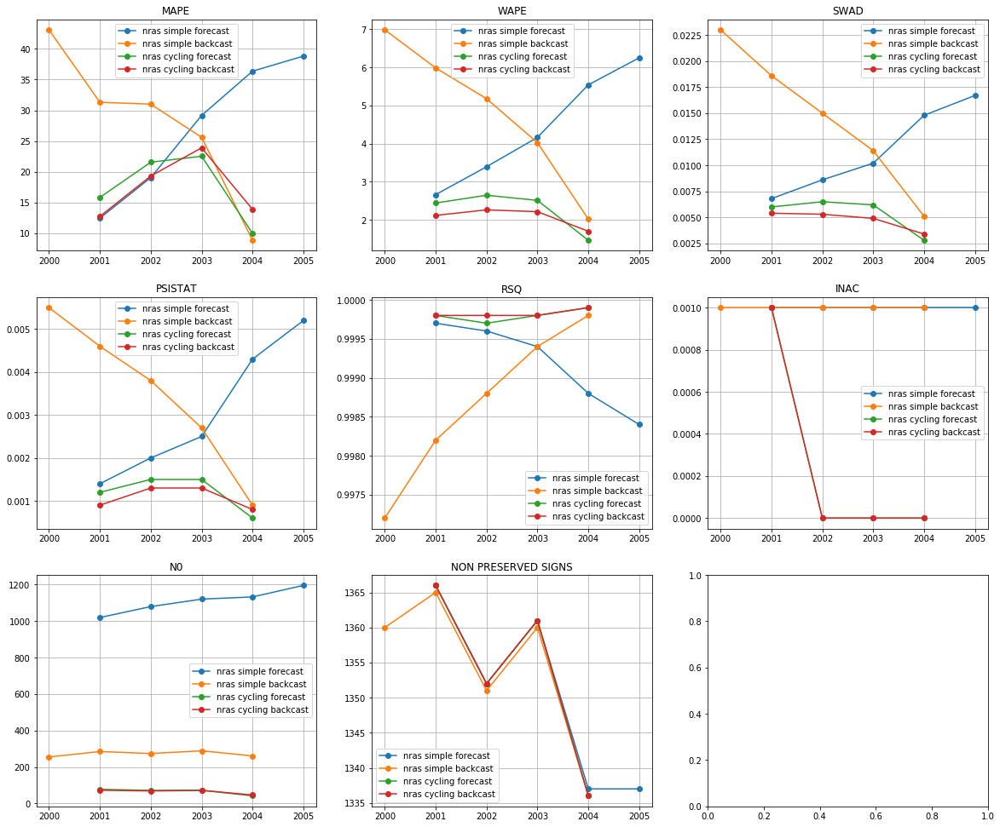

insd simple forecast
insd simple backcast
final cycle: 10
insd cycling forecast
final cycle: 10
insd cycling backcast


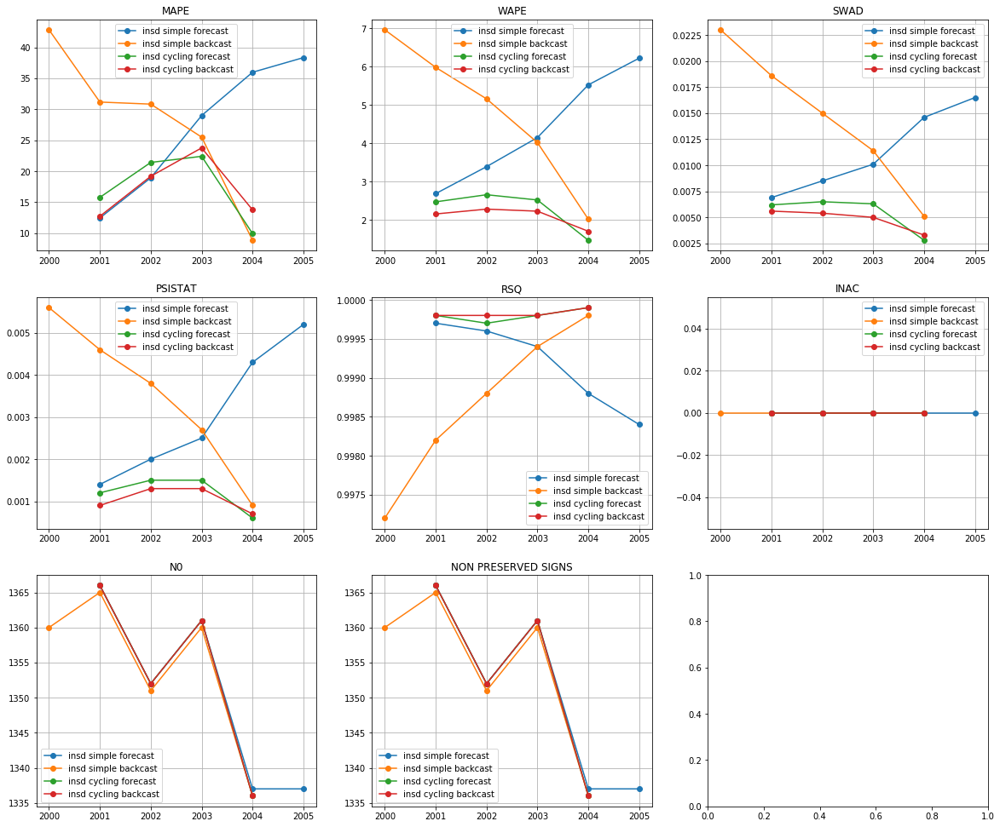

kuroda simple forecast
status was bad, new status: 3
status was bad twice, new status: 2
kuroda simple backcast
final cycle: 10
kuroda cycling forecast
final cycle: 10
kuroda cycling backcast


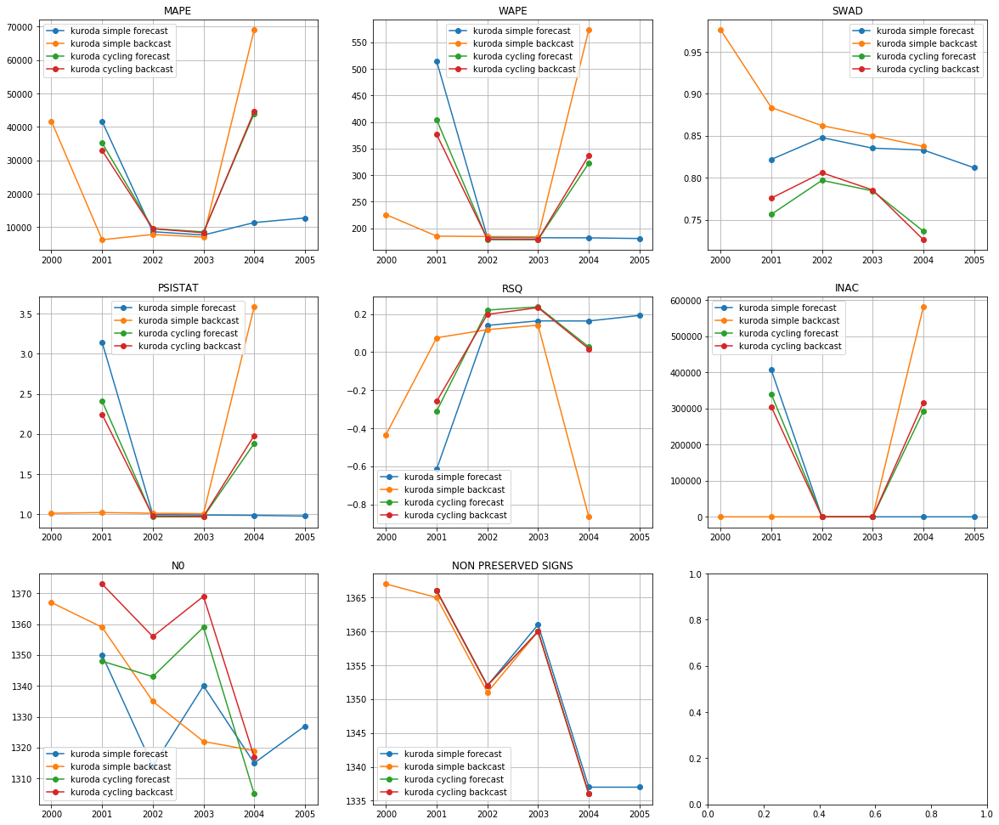

,MAPE,MAPE_R,WAPE,WAPE_R,SWAD,SWAD_R,PSISTAT,PSISTAT_R,RSQ,RSQ_R,INAC,INAC_R,N0,NON PRESERVED SIGNS,R_all,CmR
insd cycling backcast,17.355000,1,2.089975,2,0.004825,2,0.001050,1,0.999825,1,0.000000,1,1353.75,1353.75,8,1
nras cycling backcast,17.452125,3,2.076000,1,0.004750,1,0.001075,2,0.999825,1,0.000250,5,65.25,1353.75,13,2
insd cycling forecast,17.378450,2,2.277350,4,0.005450,4,0.001200,3,0.999800,3,0.000000,1,1353.75,1353.75,17,3
nras cycling forecast,17.464950,4,2.267775,3,0.005375,3,0.001200,3,0.999800,3,0.000250,5,66.25,1353.75,21,4
insd simple forecast,26.936740,5,4.394600,5,0.011320,5,0.003080,5,0.999180,5,0.000000,1,1350.60,1350.60,26,5
nras simple forecast,27.171020,6,4.401640,6,0.011420,6,0.003080,5,0.999180,5,0.001000,7,1109.00,1350.60,35,6
insd simple backcast,27.833120,7,4.828540,7,0.014620,7,0.003520,8,0.998680,7,0.000000,1,1354.40,1354.40,37,7
nras simple backcast,27.973500,8,4.837600,8,0.014620,7,0.003500,7,0.998680,7,0.001000,7,272.80,1354.40,44,8
kuroda simple forecast,16419.744920,9,248.522400,9,0.830040,11,1.419200,9,0.008940,11,81327.631320,9,1329.20,1350.60,58,9
kuroda cycling backcast,23876.655800,10,268.098325,10,0.773400,10,1.544550,11,0.047500,9,155406.336700,11,1353.75,1353.50,61,10


iot
[1995 1996 1997 1998 1999 2000 2005]
available mtypes: [0, 2]
0 LinearRegression(copy_X=True, fit_intercept=True, n_jobs=1, normalize=False) False
using mtt 0
mtt2 ridge backcast
0 Ridge(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=None,
   normalize=False, random_state=None, solver='auto', tol=0.001) False
using mtt 0
mtt2 ridge backcast
0 Lasso(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=1000,
   normalize=False, positive=False, precompute=False, random_state=None,
   selection='cyclic', tol=0.0001, warm_start=False) False
using mtt 0
mtt2 ridge backcast
2 LinearRegression(copy_X=True, fit_intercept=True, n_jobs=1, normalize=False) False
using mtt ii
mtt2 ridge backcast
2 Ridge(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=None,
   normalize=False, random_state=None, solver='auto', tol=0.001) False
using mtt ii
mtt2 ridge backcast
2 Lasso(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=1000,
   normalize=False, positive=False, precompute=False, random

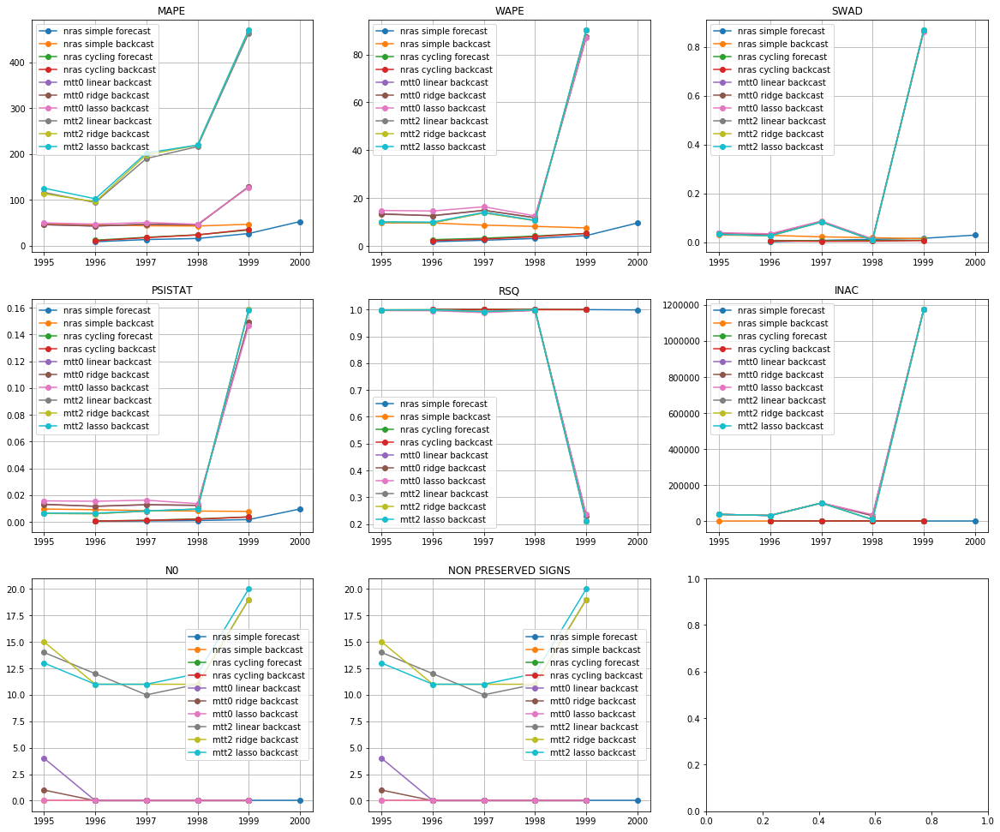

insd simple forecast
insd simple backcast
final cycle: 10
insd cycling forecast
final cycle: 10
insd cycling backcast


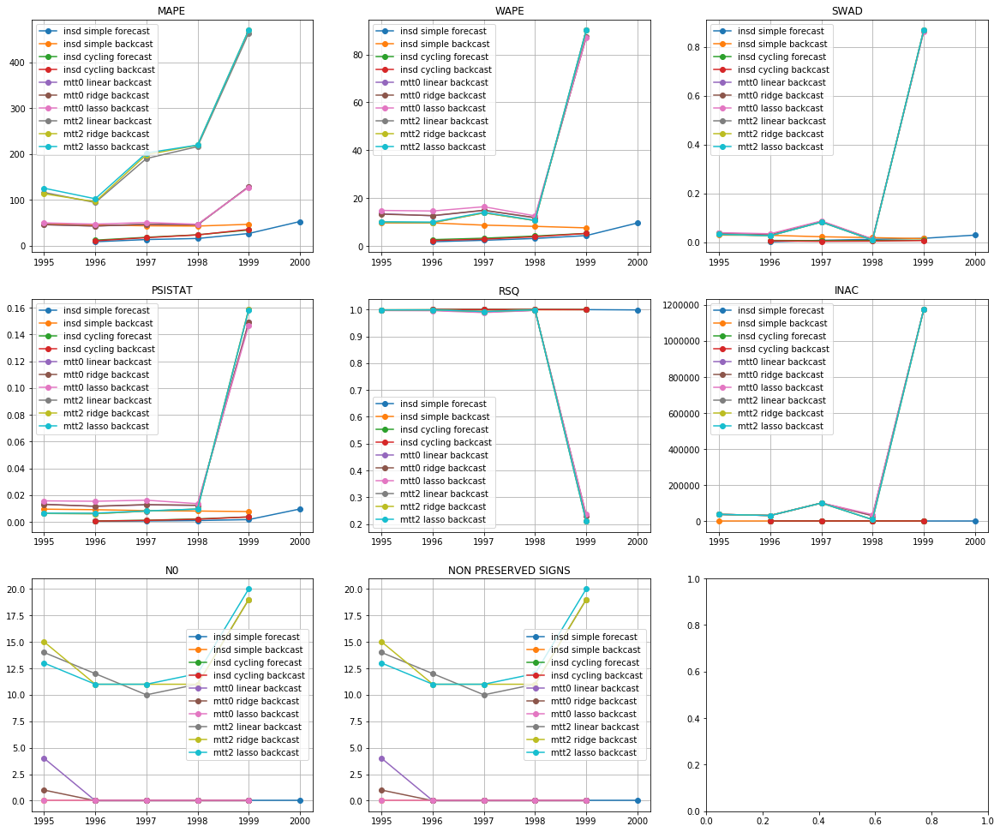

kuroda simple forecast
kuroda simple backcast
final cycle: 10
kuroda cycling forecast
final cycle: 10
kuroda cycling backcast


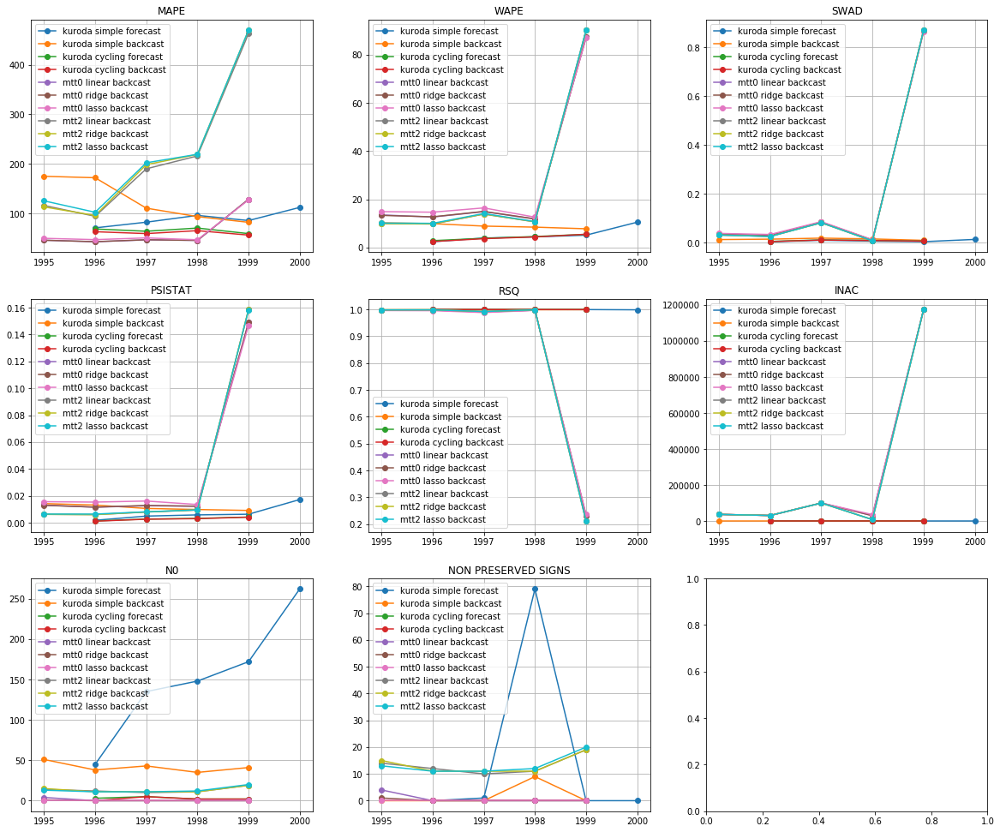

,MAPE,MAPE_R,WAPE,WAPE_R,SWAD,SWAD_R,PSISTAT,PSISTAT_R,RSQ,RSQ_R,INAC,INAC_R,N0,NON PRESERVED SIGNS,R_all,CmR
insd cycling backcast,21.700650,1,3.561450,1,0.004900,1,0.00185,1,0.999800,1,0.000000,1,0.00,0.0,6,1
nras cycling backcast,21.708800,2,3.565575,2,0.004900,1,0.00185,1,0.999800,1,0.000275,9,0.00,0.0,16,2
insd cycling forecast,21.958500,3,3.834175,4,0.006875,4,0.00195,3,0.999800,1,0.000000,1,0.00,0.0,16,2
nras cycling forecast,21.968525,4,3.834000,3,0.006850,3,0.00195,3,0.999800,1,0.000275,9,0.00,0.0,23,4
kuroda cycling backcast,60.838125,9,3.974575,5,0.008450,6,0.00280,7,0.999750,5,0.000000,1,2.25,0.0,33,5
insd simple forecast,23.292100,6,4.253920,7,0.013000,8,0.00270,5,0.999520,7,0.000000,1,0.00,0.0,34,6
kuroda cycling forecast,65.454425,13,4.139575,6,0.008975,7,0.00295,8,0.999725,6,0.000000,1,3.00,0.0,41,7
nras simple forecast,23.235600,5,4.259480,8,0.013040,9,0.00270,5,0.999520,7,0.000500,11,0.00,0.0,45,8
kuroda simple forecast,89.281200,14,5.237300,9,0.008380,5,0.00730,9,0.999520,7,0.000000,1,152.40,16.0,45,8
insd simple backcast,45.069360,7,8.754580,11,0.022340,12,0.00856,10,0.998780,11,0.000000,1,0.00,0.0,52,10


[1995 2000 2001 2002 2003 2004 2005]
available mtypes: [0, 2]
0 LinearRegression(copy_X=True, fit_intercept=True, n_jobs=1, normalize=False) True
using mtt 0
mtt2 ridge forecast
0 Ridge(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=None,
   normalize=False, random_state=None, solver='auto', tol=0.001) True
using mtt 0
mtt2 ridge forecast
0 Lasso(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=1000,
   normalize=False, positive=False, precompute=False, random_state=None,
   selection='cyclic', tol=0.0001, warm_start=False) True
using mtt 0
mtt2 ridge forecast
2 LinearRegression(copy_X=True, fit_intercept=True, n_jobs=1, normalize=False) True
using mtt ii
mtt2 ridge forecast
2 Ridge(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=None,
   normalize=False, random_state=None, solver='auto', tol=0.001) True
using mtt ii
mtt2 ridge forecast
2 Lasso(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=1000,
   normalize=False, positive=False, precompute=False, random_state=No

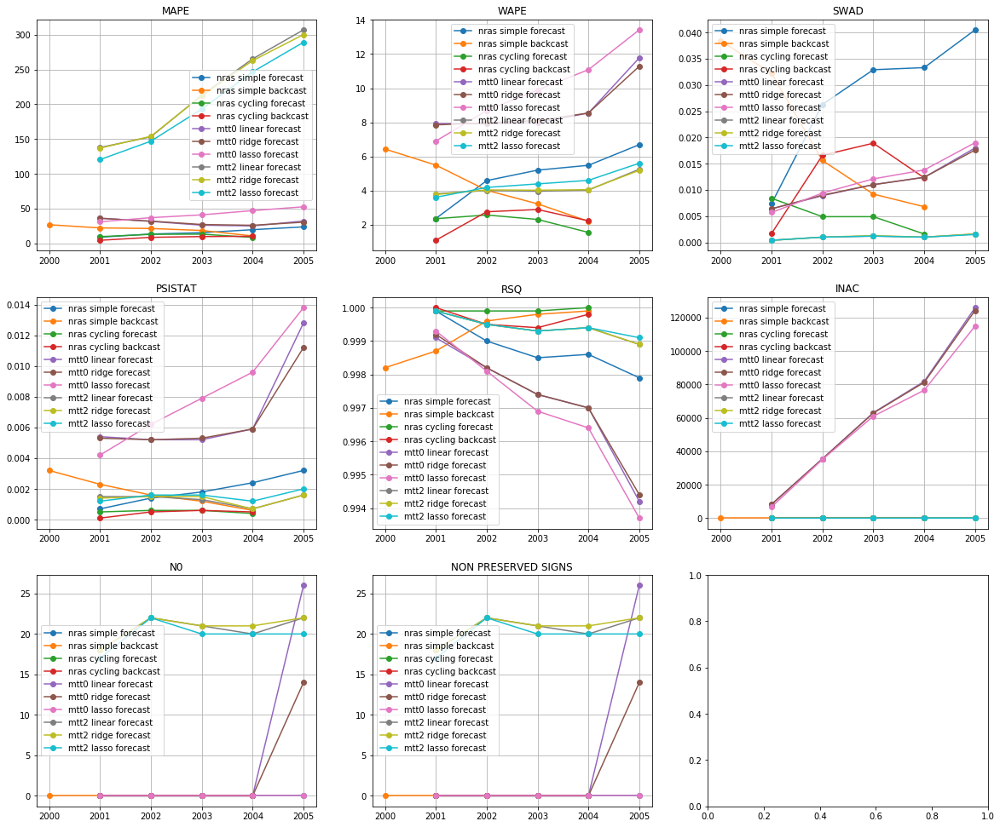

insd simple forecast
insd simple backcast
final cycle: 10
insd cycling forecast
final cycle: 4
insd cycling backcast


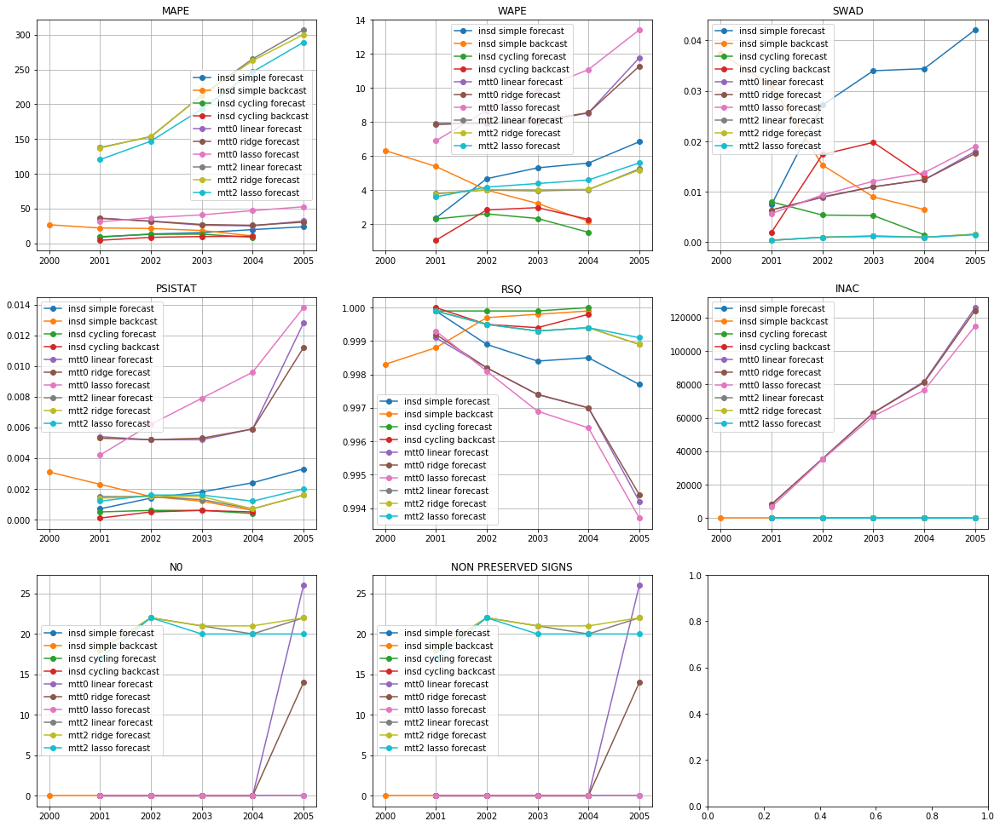

kuroda simple forecast
kuroda simple backcast
final cycle: 10
kuroda cycling forecast
final cycle: 10
kuroda cycling backcast


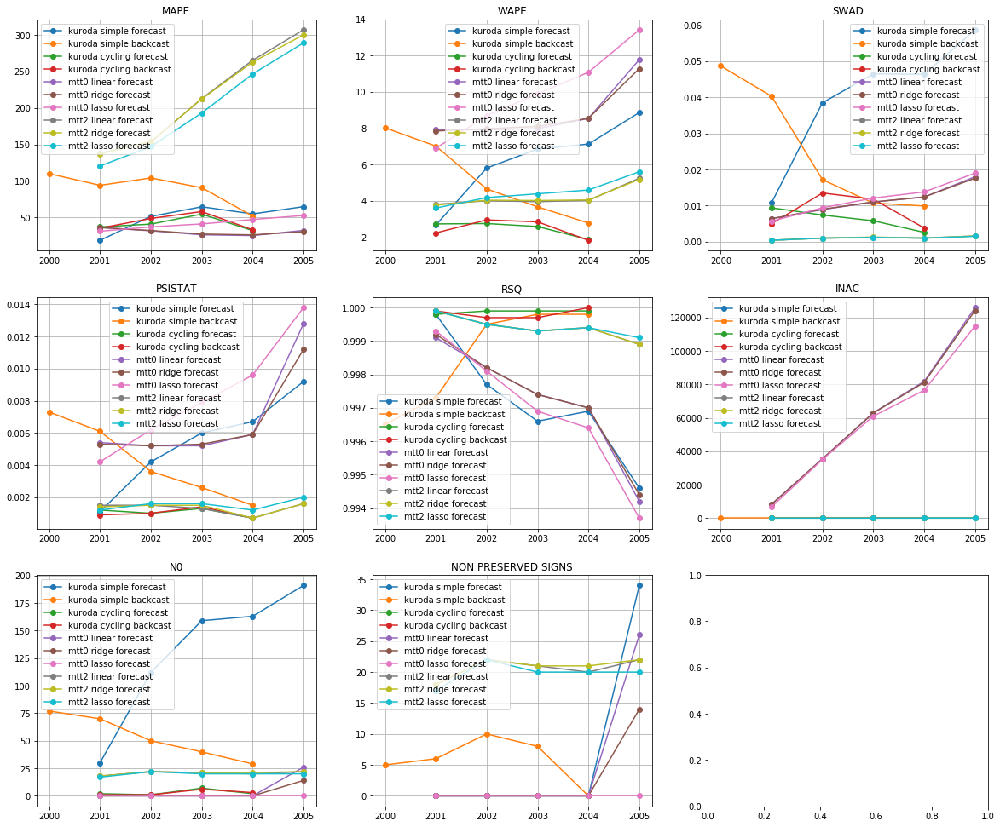

,MAPE,MAPE_R,WAPE,WAPE_R,SWAD,SWAD_R,PSISTAT,PSISTAT_R,RSQ,RSQ_R,INAC,INAC_R,N0,NON PRESERVED SIGNS,R_all,CmR
insd cycling forecast,10.983600,3,2.194825,2,0.005050,5,0.000525,3,0.999925,1,0.00000,1,0.00,0.0,15,1
nras cycling forecast,11.003375,4,2.194425,1,0.004950,4,0.000525,3,0.999925,1,0.00015,9,0.00,0.0,22,2
insd cycling backcast,8.139375,2,2.288475,4,0.013050,12,0.000425,1,0.999675,5,0.00000,1,0.00,0.0,25,3
nras cycling backcast,8.126125,1,2.240475,3,0.012375,11,0.000425,1,0.999675,5,0.00020,10,0.00,0.0,31,4
kuroda cycling forecast,40.910225,11,2.487075,6,0.006300,6,0.001050,6,0.999875,3,0.00000,1,3.00,0.0,33,5
kuroda cycling backcast,43.561675,13,2.467325,5,0.008525,7,0.001000,5,0.999825,4,0.00000,1,2.75,0.0,35,6
insd simple backcast,19.766820,7,4.225680,9,0.019860,13,0.001740,10,0.999300,10,0.00000,1,0.00,0.0,50,7
mtt2 linear forecast,215.298500,18,4.209900,7,0.001040,2,0.001320,7,0.999400,8,0.34264,13,20.60,20.6,55,8
mtt2 lasso forecast,199.280940,16,4.475640,11,0.001020,1,0.001520,9,0.999440,7,0.34264,13,19.80,19.8,57,9
mtt2 ridge forecast,213.304660,17,4.212920,8,0.001060,3,0.001340,8,0.999400,8,0.34264,13,20.80,20.8,57,9


In [37]:
metrics_res['ESP'] = get_results('ESP')

CHN
use basic I+II
[1997 1998 1999 2000 2001 2002]
available mtypes: [0]
nras simple forecast
nras simple backcast
final cycle: 10
nras cycling forecast
final cycle: 10
nras cycling backcast


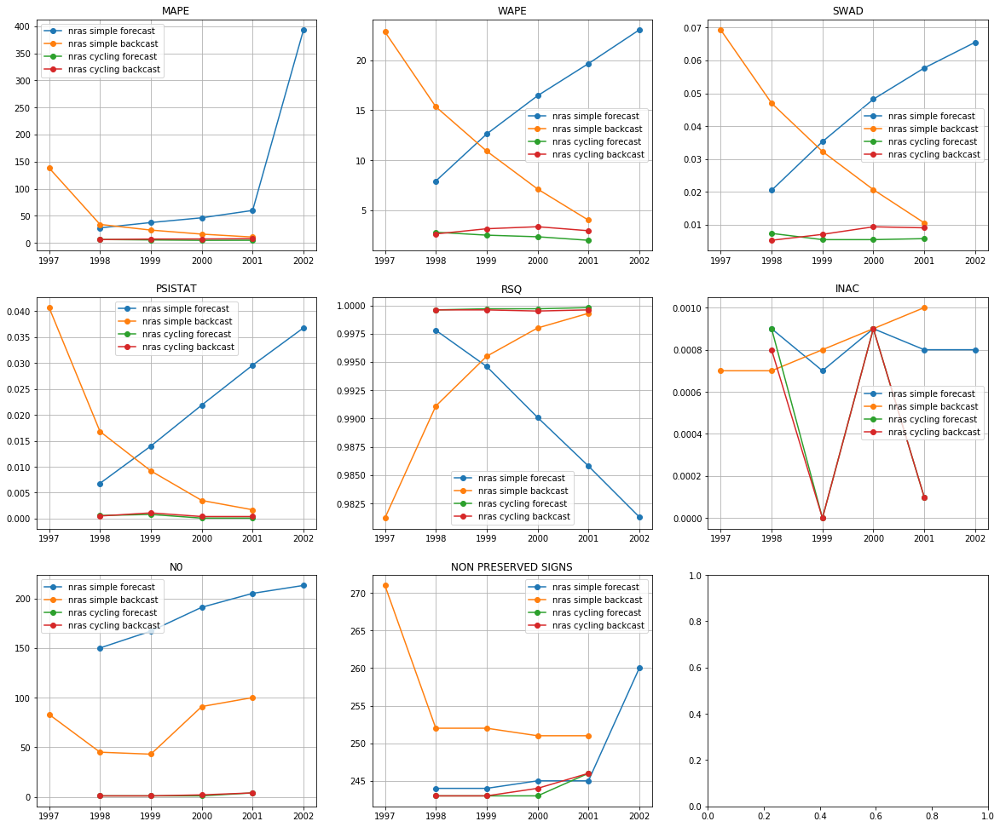

insd simple forecast
insd simple backcast
final cycle: 10
insd cycling forecast
final cycle: 10
insd cycling backcast


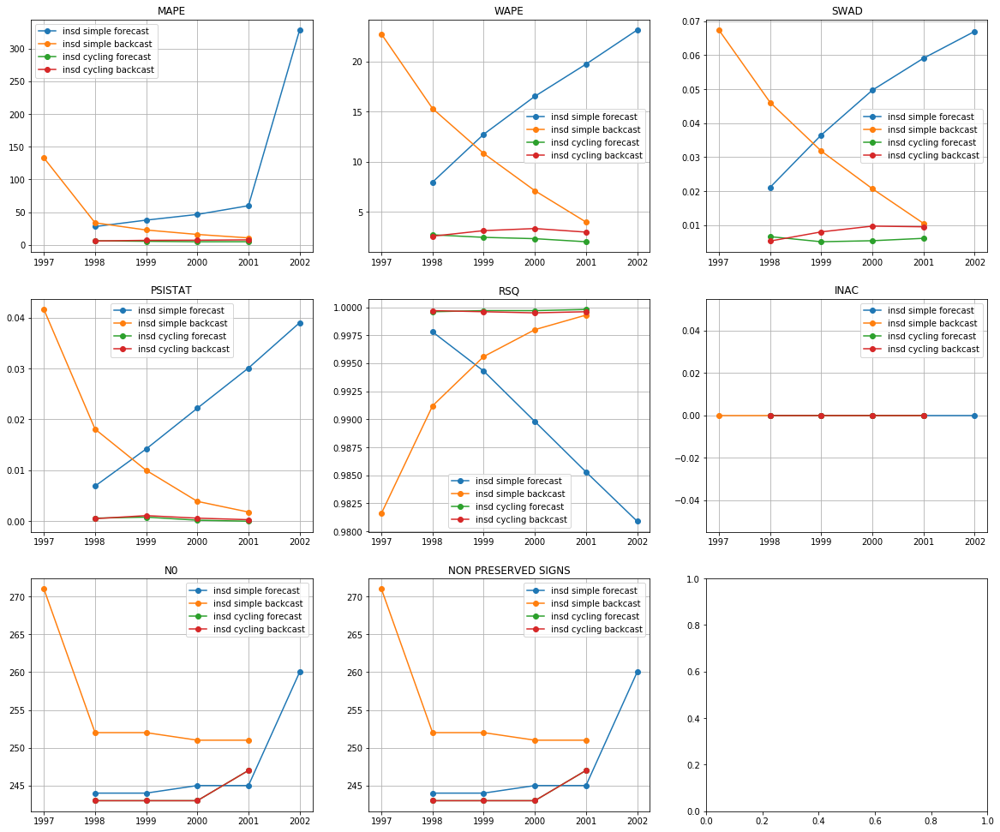

kuroda simple forecast
kuroda simple backcast
final cycle: 10
kuroda cycling forecast
final cycle: 10
kuroda cycling backcast


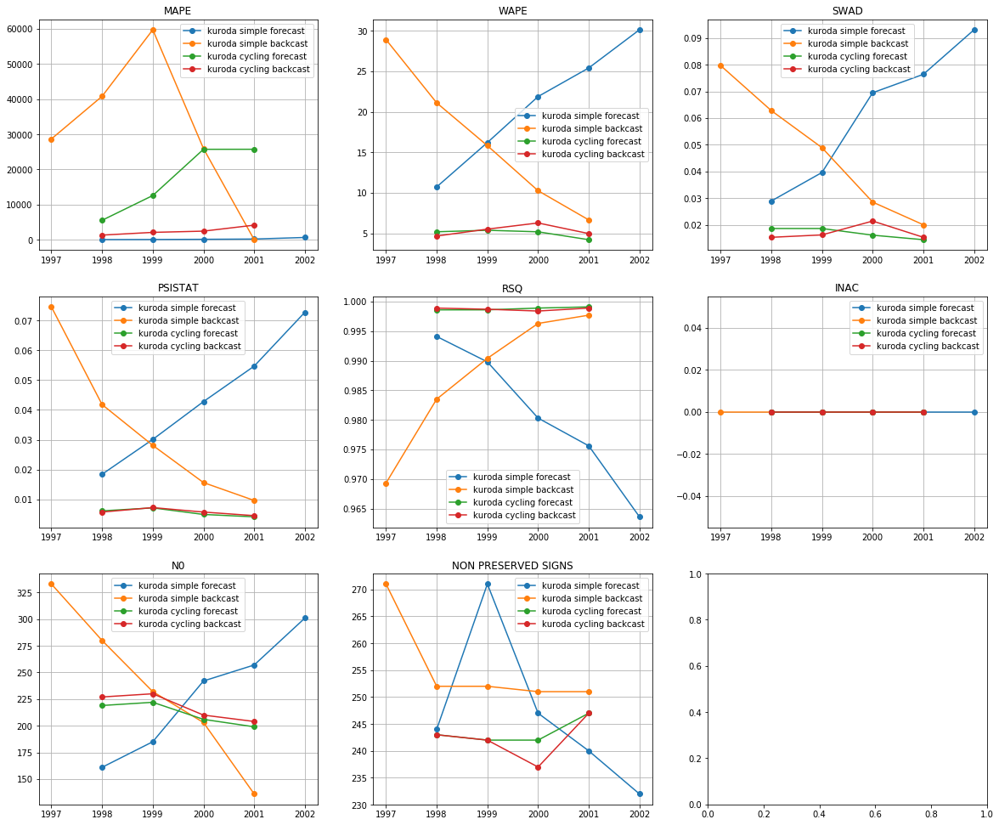

,MAPE,MAPE_R,WAPE,WAPE_R,SWAD,SWAD_R,PSISTAT,PSISTAT_R,RSQ,RSQ_R,INAC,INAC_R,N0,NON PRESERVED SIGNS,R_all,CmR
insd cycling forecast,5.392400,2,2.399825,1,0.005800,1,0.000400,1,0.999700,1,0.000000,1,244.00,244.00,7,1
nras cycling forecast,5.309550,1,2.403225,2,0.006050,2,0.000400,1,0.999700,1,0.000475,10,1.75,243.75,17,2
insd cycling backcast,6.992125,4,3.025575,4,0.008125,4,0.000625,4,0.999600,3,0.000000,1,244.00,244.00,20,3
nras cycling backcast,6.973050,3,3.010775,3,0.007725,3,0.000600,3,0.999575,4,0.000450,9,2.00,244.00,25,4
kuroda cycling forecast,17393.022825,11,4.987875,5,0.016925,5,0.005550,5,0.998800,5,0.000000,1,211.50,243.50,32,5
insd simple backcast,43.251800,5,12.006140,7,0.035300,7,0.015080,8,0.993140,7,0.000000,1,255.40,255.40,35,6
kuroda cycling backcast,2509.750775,10,5.353600,6,0.017050,6,0.005775,6,0.998725,6,0.000000,1,217.75,242.25,35,6
insd simple forecast,100.099420,7,16.031560,10,0.046680,10,0.022480,10,0.989620,10,0.000000,1,247.60,247.60,48,8
nras simple backcast,44.546760,6,12.038180,8,0.035980,8,0.014380,7,0.993020,8,0.000820,12,72.40,255.40,49,9
nras simple forecast,112.929240,8,15.928620,9,0.045440,9,0.021820,9,0.989920,9,0.000820,11,185.20,247.60,55,10


[2002 2003 2004 2005 2006 2007]
available mtypes: [0]
nras simple forecast
nras simple backcast
final cycle: 10
nras cycling forecast
final cycle: 10
nras cycling backcast


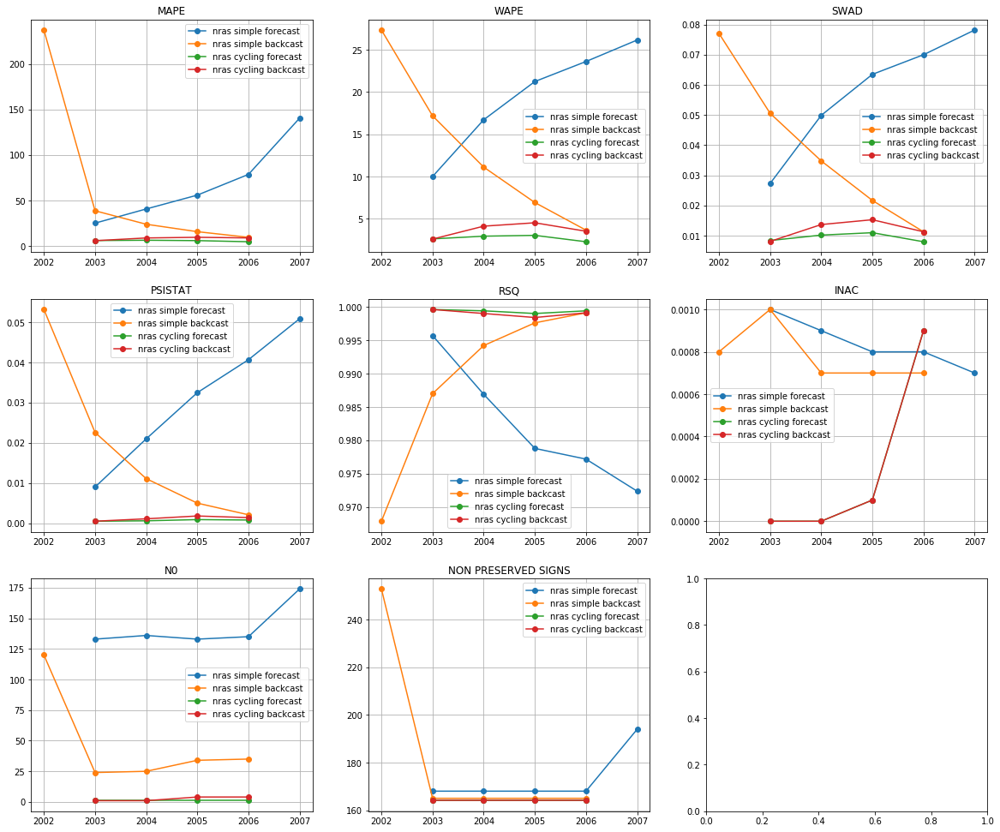

insd simple forecast
insd simple backcast
final cycle: 10
insd cycling forecast
final cycle: 10
insd cycling backcast


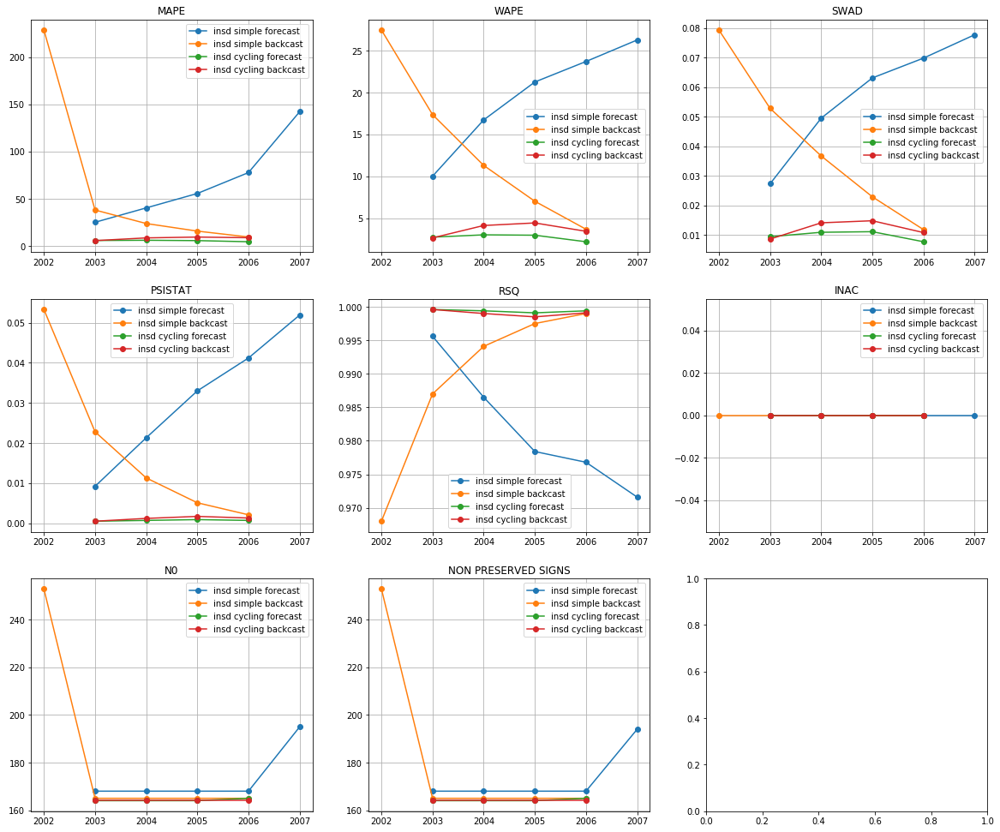

kuroda simple forecast
kuroda simple backcast
final cycle: 10
kuroda cycling forecast
final cycle: 10
kuroda cycling backcast


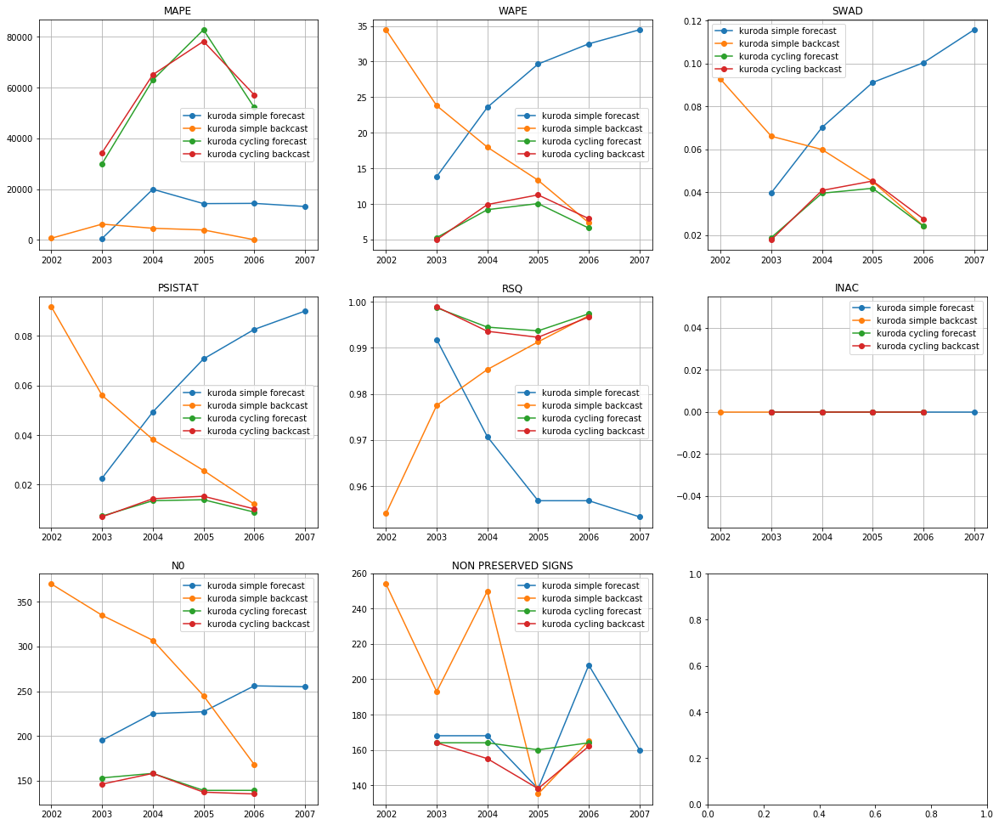

,MAPE,MAPE_R,WAPE,WAPE_R,SWAD,SWAD_R,PSISTAT,PSISTAT_R,RSQ,RSQ_R,INAC,INAC_R,N0,NON PRESERVED SIGNS,R_all,CmR
insd cycling forecast,5.631425,1,2.746925,2,0.009775,2,0.000700,2,0.999375,1,0.00000,1,164.25,164.25,9,1
nras cycling forecast,5.835400,2,2.726075,1,0.009400,1,0.000700,1,0.999350,2,0.00025,9,1.00,164.00,16,2
insd cycling backcast,8.234850,3,3.680525,3,0.012075,3,0.001175,3,0.999050,3,0.00000,1,164.00,164.00,16,2
nras cycling backcast,8.382150,4,3.697550,4,0.012100,4,0.001200,4,0.999025,4,0.00025,9,2.50,164.00,29,4
kuroda cycling forecast,57021.373800,11,7.778250,5,0.031050,5,0.010900,5,0.996075,5,0.00000,1,147.25,163.00,32,5
kuroda cycling backcast,58721.358700,12,8.523150,6,0.032825,6,0.011700,6,0.995375,6,0.00000,1,144.00,154.75,37,6
insd simple backcast,63.269000,5,13.376420,8,0.040700,8,0.018920,8,0.989120,8,0.00000,1,182.60,182.60,38,7
nras simple backcast,65.125840,6,13.241880,7,0.039100,7,0.018800,7,0.989160,7,0.00078,11,47.60,182.60,45,8
insd simple forecast,68.267940,8,19.601120,11,0.057480,9,0.031320,10,0.981780,10,0.00000,1,173.40,173.20,49,9
kuroda simple backcast,3057.743980,9,19.385160,9,0.057580,10,0.044740,11,0.981020,11,0.00000,1,285.00,199.40,51,10


use basic I
[1997 1998 1999 2000 2001 2002]
available mtypes: [0]
nras simple forecast
nras simple backcast
final cycle: 10
nras cycling forecast
final cycle: 10
nras cycling backcast


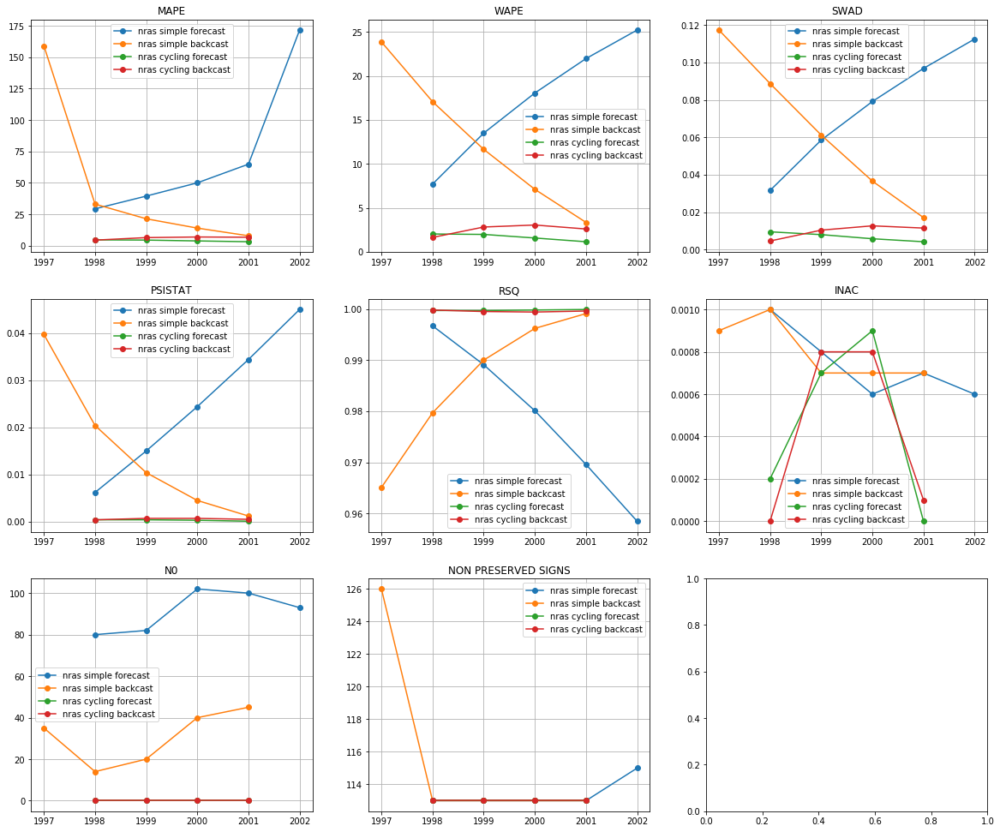

insd simple forecast
insd simple backcast
final cycle: 10
insd cycling forecast
final cycle: 10
insd cycling backcast


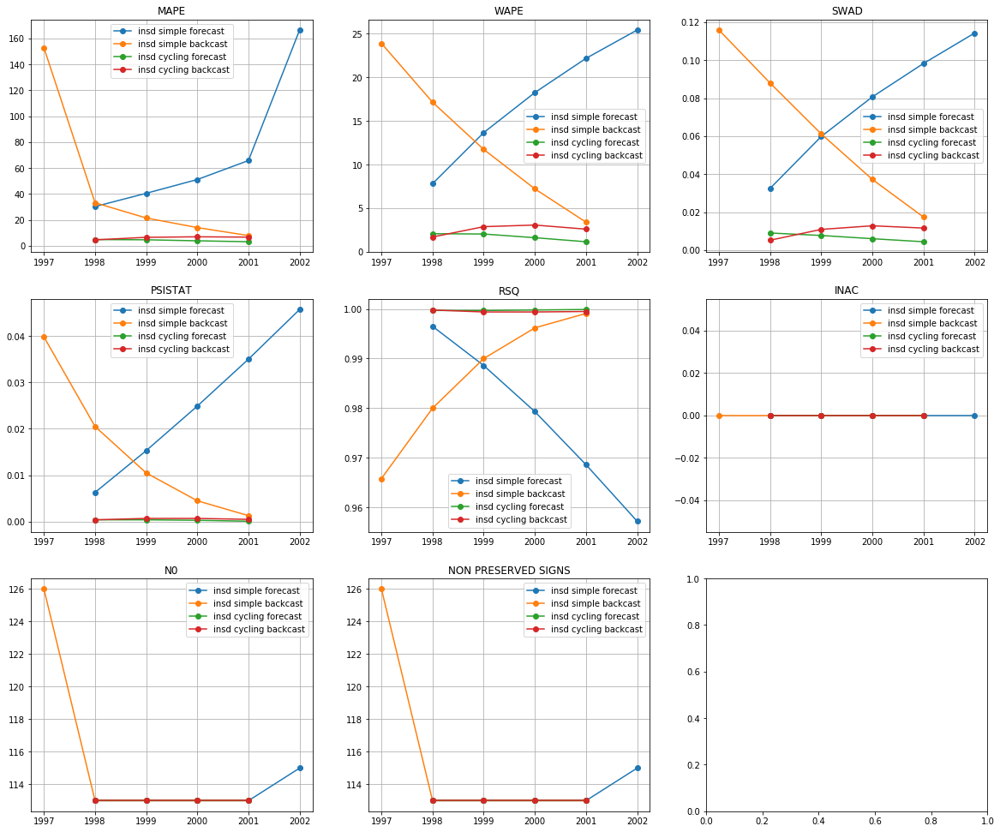

kuroda simple forecast
kuroda simple backcast
final cycle: 10
kuroda cycling forecast
final cycle: 10
kuroda cycling backcast


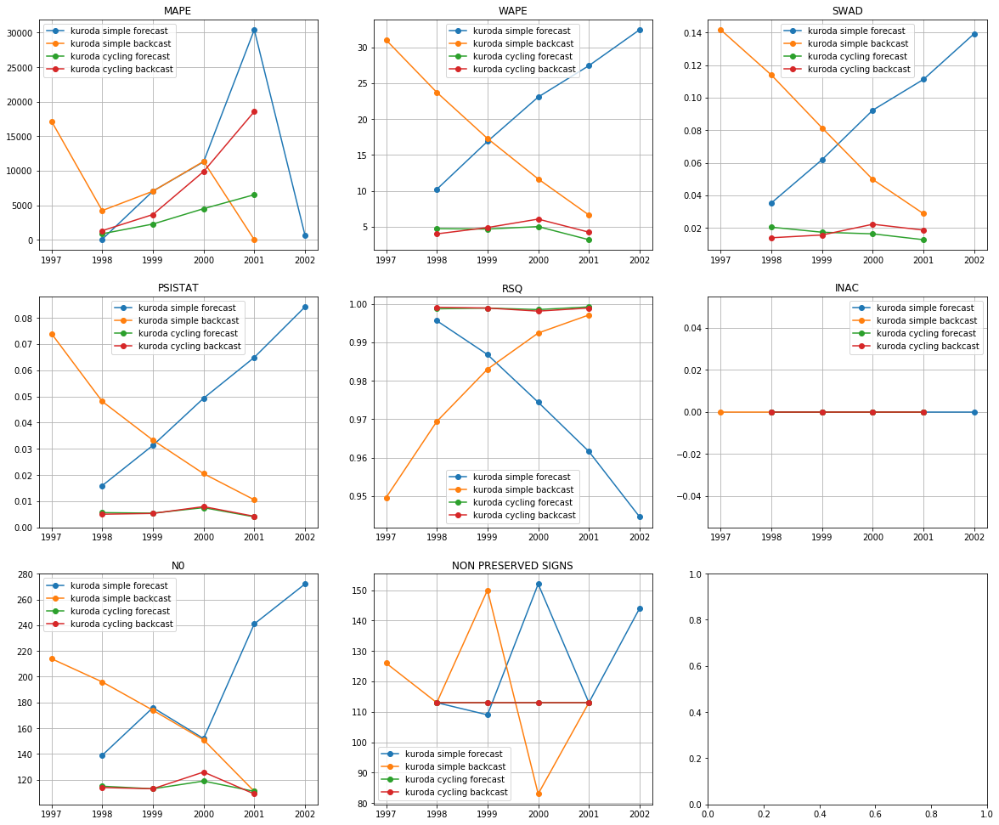

,MAPE,MAPE_R,WAPE,WAPE_R,SWAD,SWAD_R,PSISTAT,PSISTAT_R,RSQ,RSQ_R,INAC,INAC_R,N0,NON PRESERVED SIGNS,R_all,CmR
insd cycling forecast,4.116200,2,1.726275,2,0.006775,1,0.000300,1,0.999775,1,0.000000,1,113.0,113.0,8,1
nras cycling forecast,3.985050,1,1.687775,1,0.006875,2,0.000300,1,0.999775,1,0.000450,10,0.0,113.0,16,2
insd cycling backcast,6.199050,4,2.565050,4,0.010125,4,0.000575,3,0.999525,4,0.000000,1,113.0,113.0,20,3
nras cycling backcast,6.107475,3,2.531625,3,0.009800,3,0.000575,3,0.999575,3,0.000425,9,0.0,113.0,24,4
kuroda cycling forecast,3551.339825,9,4.415600,5,0.016675,5,0.005625,6,0.998825,5,0.000000,1,114.5,113.0,31,5
kuroda cycling backcast,8360.166725,11,4.809950,6,0.017575,6,0.005600,5,0.998750,6,0.000000,1,115.5,113.0,35,6
insd simple backcast,45.889620,5,12.666660,8,0.063940,7,0.015320,8,0.986220,7,0.000000,1,115.6,115.6,36,7
nras simple backcast,47.064500,6,12.609980,7,0.064180,8,0.015240,7,0.986020,8,0.000800,12,30.8,115.6,48,8
insd simple forecast,70.836220,7,17.445060,10,0.077120,10,0.025440,10,0.978040,11,0.000000,1,113.4,113.4,49,9
kuroda simple backcast,7965.745260,10,18.068860,11,0.083080,11,0.037280,11,0.978300,10,0.000000,1,169.2,117.0,54,10


[2002 2003 2004 2005 2006 2007]
available mtypes: [0]
nras simple forecast
nras simple backcast
final cycle: 10
nras cycling forecast
final cycle: 10
nras cycling backcast


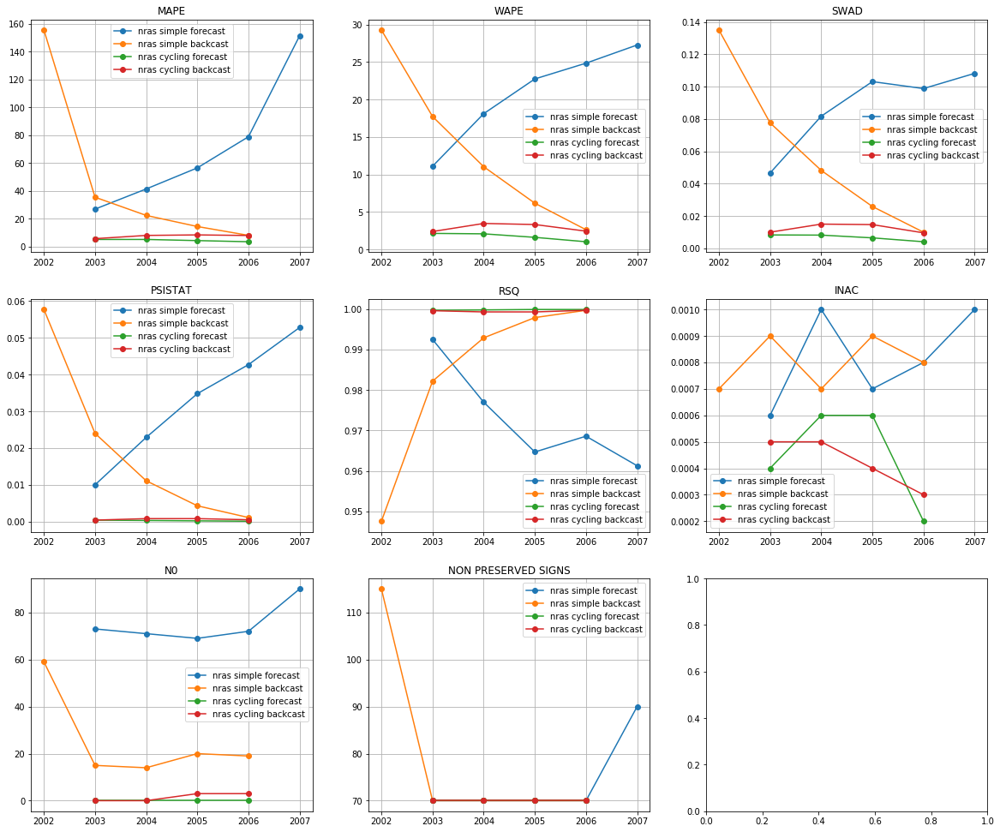

insd simple forecast
insd simple backcast
final cycle: 10
insd cycling forecast
final cycle: 10
insd cycling backcast


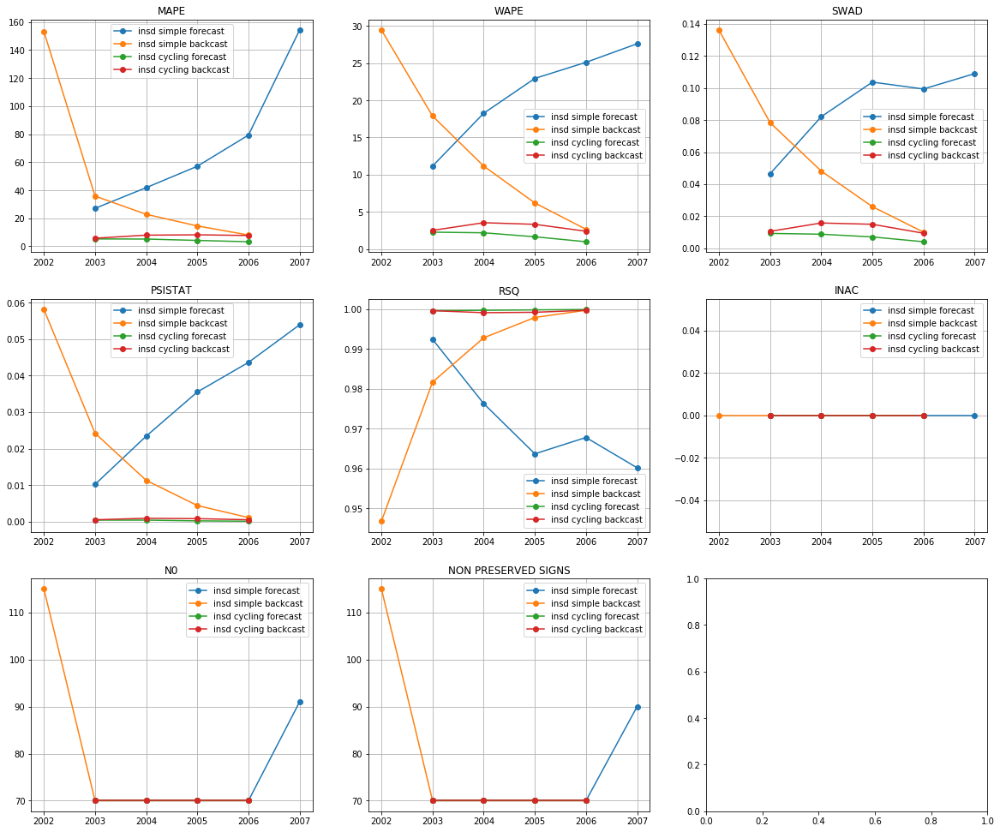

kuroda simple forecast
kuroda simple backcast
final cycle: 10
kuroda cycling forecast
final cycle: 10
kuroda cycling backcast


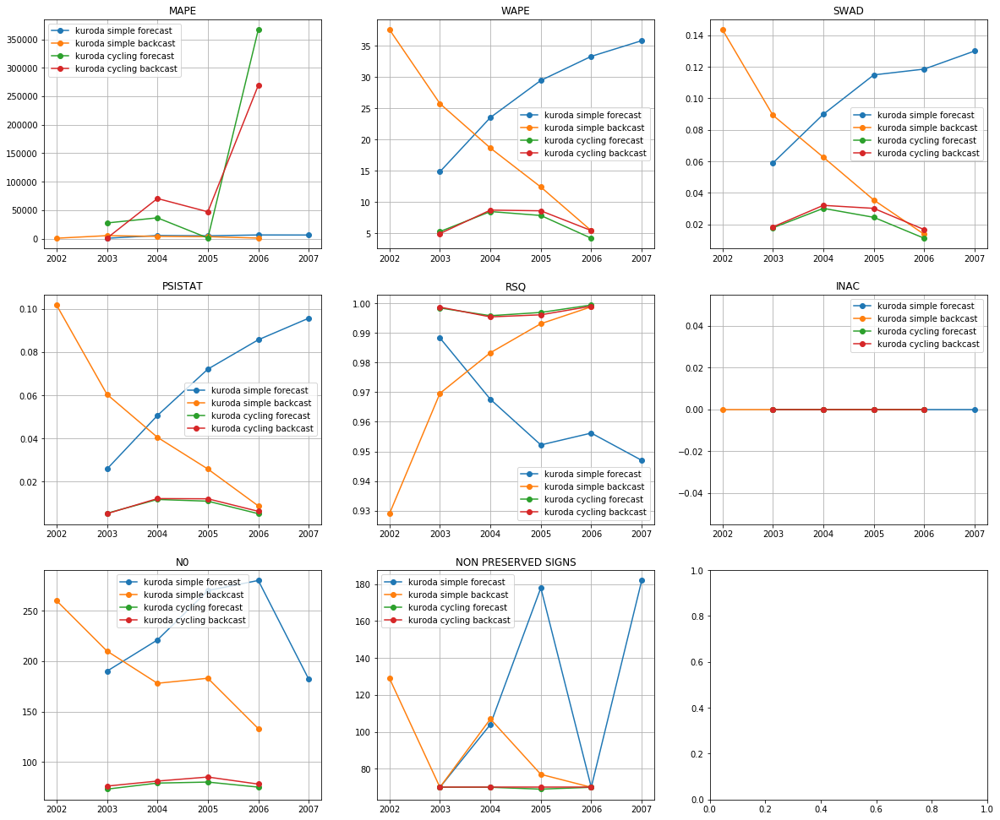

,MAPE,MAPE_R,WAPE,WAPE_R,SWAD,SWAD_R,PSISTAT,PSISTAT_R,RSQ,RSQ_R,INAC,INAC_R,N0,NON PRESERVED SIGNS,R_all,CmR
insd cycling forecast,4.486025,2,1.784000,2,0.007325,2,0.000275,2,0.999750,2,0.000000,1,70.00,70.00,11,1
nras cycling forecast,4.425425,1,1.703525,1,0.006775,1,0.000250,1,0.999825,1,0.000450,10,0.00,70.00,15,2
insd cycling backcast,7.423900,3,2.953125,4,0.012700,4,0.000675,4,0.999400,4,0.000000,1,70.00,70.00,20,3
nras cycling backcast,7.432950,4,2.893600,3,0.012325,3,0.000625,3,0.999475,3,0.000425,9,1.50,70.00,25,4
kuroda cycling forecast,107988.695275,12,6.471725,5,0.020825,5,0.008250,5,0.997625,5,0.000000,1,76.75,69.75,33,5
kuroda cycling backcast,96868.060700,11,6.943975,6,0.024250,6,0.008850,6,0.997300,6,0.000000,1,80.00,70.00,36,6
insd simple backcast,46.870120,5,13.468240,8,0.059780,8,0.019820,8,0.983780,8,0.000000,1,79.00,79.00,38,7
nras simple backcast,47.111620,6,13.358700,7,0.059340,7,0.019640,7,0.984060,7,0.000800,11,25.40,79.00,45,8
kuroda simple backcast,2776.648280,9,19.984980,9,0.068920,9,0.047440,11,0.974760,9,0.000000,1,192.80,90.60,48,9
insd simple forecast,71.895080,8,21.006460,11,0.088140,11,0.033320,10,0.972080,11,0.000000,1,74.20,74.00,52,10


use purchase I+II
[1997 1998 1999 2000 2001 2002]
available mtypes: [0]
nras simple forecast
nras simple backcast
final cycle: 10
nras cycling forecast
final cycle: 10
nras cycling backcast


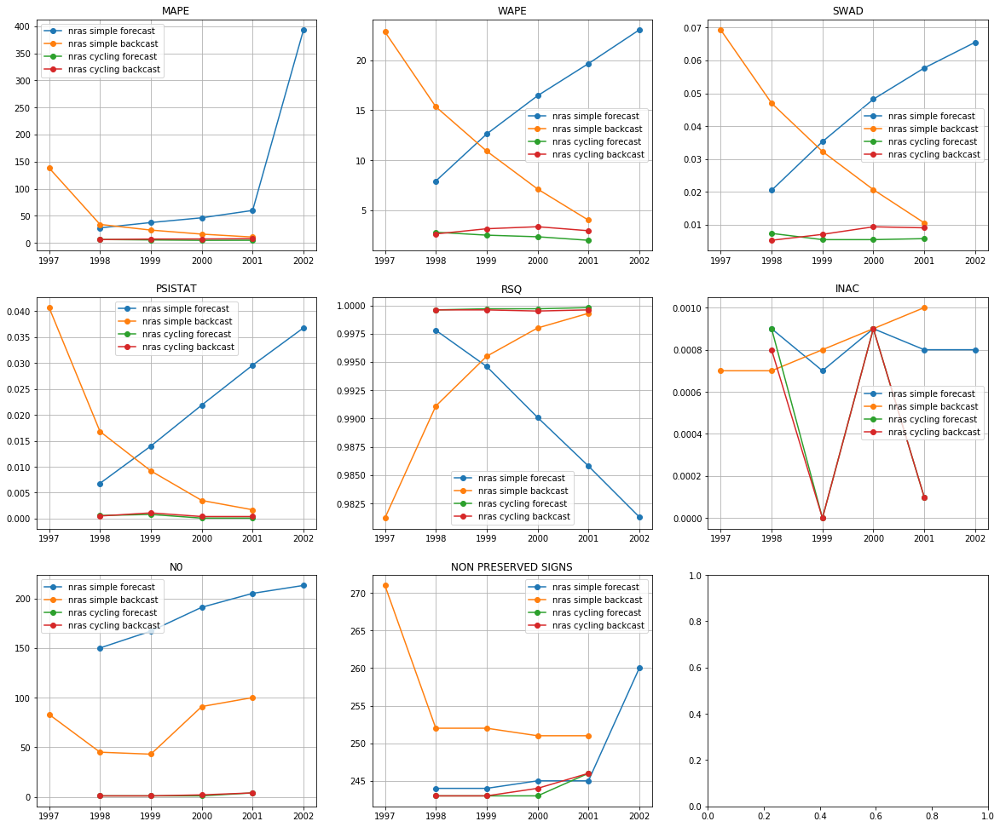

insd simple forecast
insd simple backcast
final cycle: 10
insd cycling forecast
final cycle: 10
insd cycling backcast


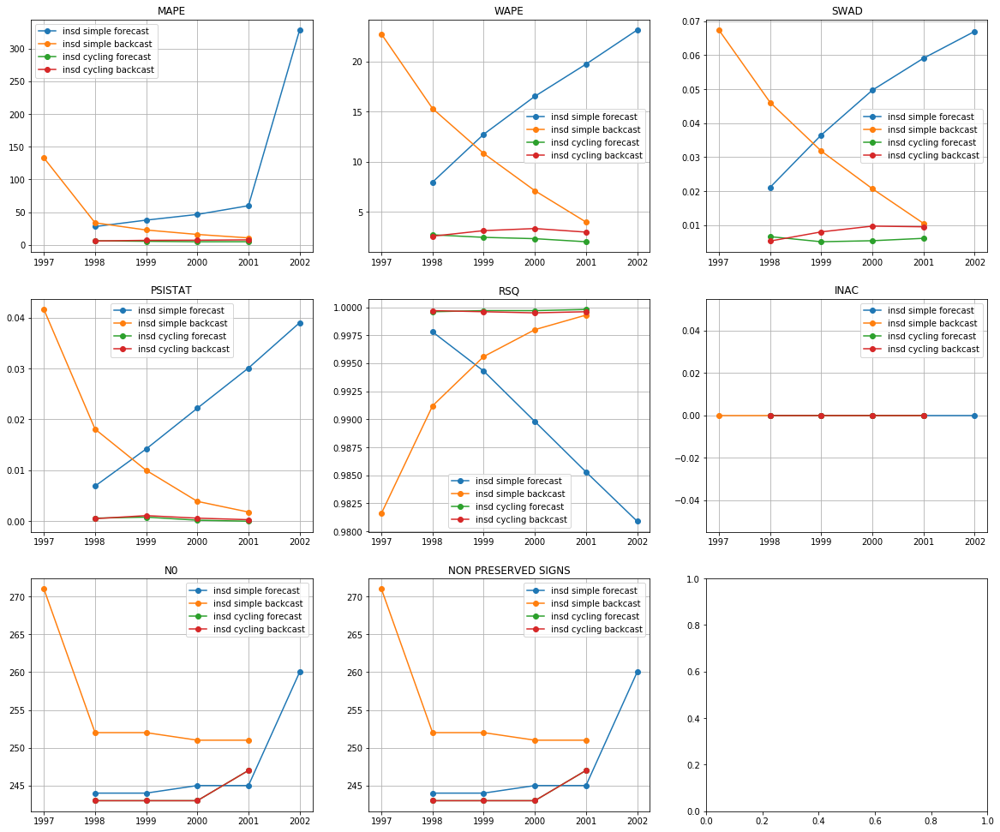

kuroda simple forecast
kuroda simple backcast
final cycle: 10
kuroda cycling forecast
final cycle: 10
kuroda cycling backcast


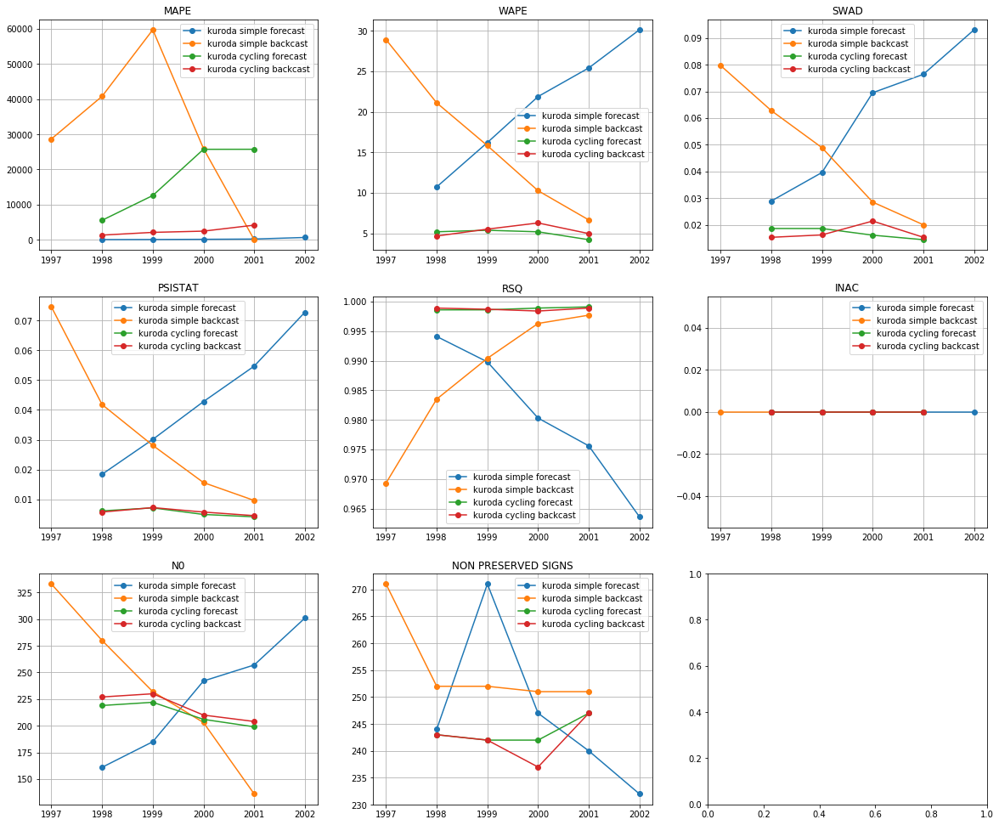

,MAPE,MAPE_R,WAPE,WAPE_R,SWAD,SWAD_R,PSISTAT,PSISTAT_R,RSQ,RSQ_R,INAC,INAC_R,N0,NON PRESERVED SIGNS,R_all,CmR
insd cycling forecast,5.392400,2,2.399825,1,0.005800,1,0.000400,1,0.999700,1,0.000000,1,244.00,244.00,7,1
nras cycling forecast,5.309550,1,2.403225,2,0.006050,2,0.000400,1,0.999700,1,0.000475,10,1.75,243.75,17,2
insd cycling backcast,6.992125,4,3.025575,4,0.008125,4,0.000625,4,0.999600,3,0.000000,1,244.00,244.00,20,3
nras cycling backcast,6.973050,3,3.010775,3,0.007725,3,0.000600,3,0.999575,4,0.000450,9,2.00,244.00,25,4
kuroda cycling forecast,17393.022825,11,4.987875,5,0.016925,5,0.005550,5,0.998800,5,0.000000,1,211.50,243.50,32,5
insd simple backcast,43.251800,5,12.006140,7,0.035300,7,0.015080,8,0.993140,7,0.000000,1,255.40,255.40,35,6
kuroda cycling backcast,2509.750775,10,5.353600,6,0.017050,6,0.005775,6,0.998725,6,0.000000,1,217.75,242.25,35,6
insd simple forecast,100.099420,7,16.031560,10,0.046680,10,0.022480,10,0.989620,10,0.000000,1,247.60,247.60,48,8
nras simple backcast,44.546760,6,12.038180,8,0.035980,8,0.014380,7,0.993020,8,0.000820,12,72.40,255.40,49,9
nras simple forecast,112.929240,8,15.928620,9,0.045440,9,0.021820,9,0.989920,9,0.000820,11,185.20,247.60,55,10


[2002 2003 2004 2005 2006 2007]
available mtypes: [0]
nras simple forecast
nras simple backcast
final cycle: 10
nras cycling forecast
final cycle: 10
nras cycling backcast


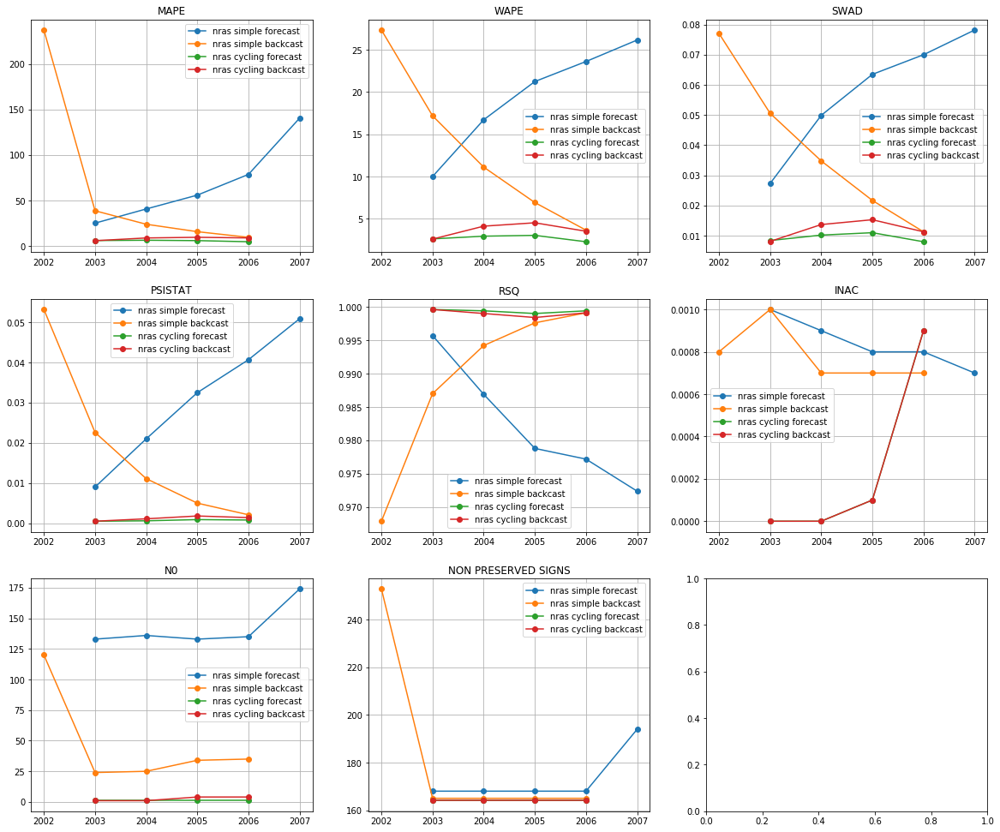

insd simple forecast
insd simple backcast
final cycle: 10
insd cycling forecast
final cycle: 10
insd cycling backcast


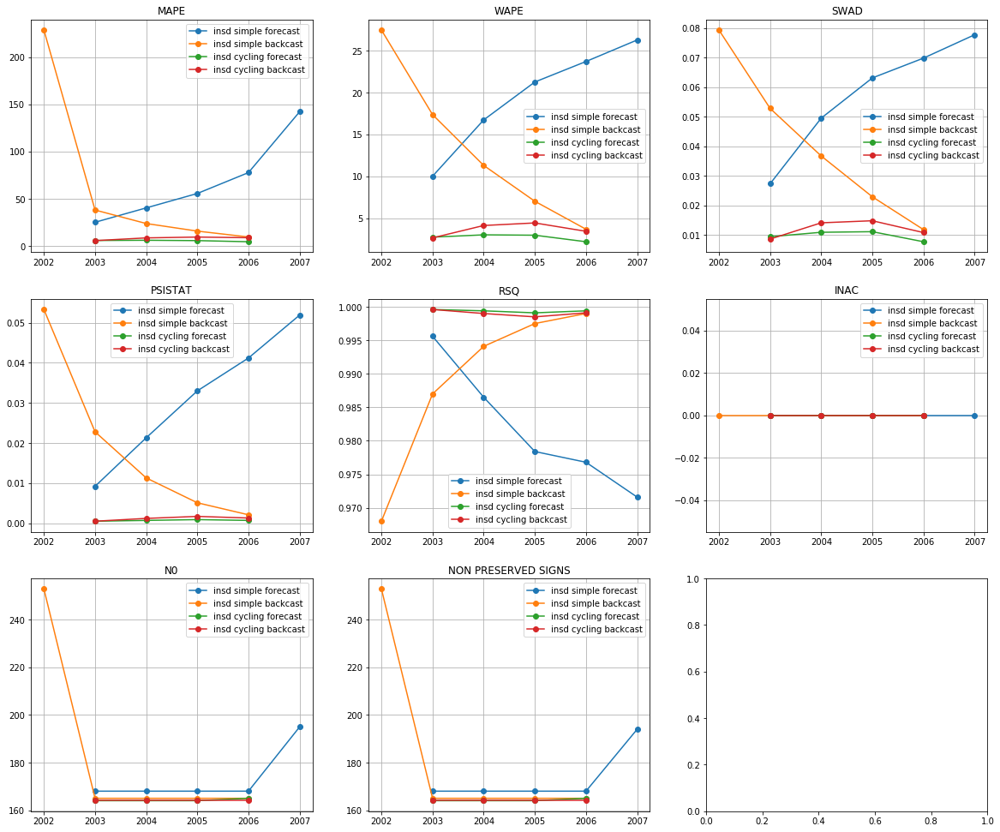

kuroda simple forecast
kuroda simple backcast
final cycle: 10
kuroda cycling forecast
final cycle: 10
kuroda cycling backcast


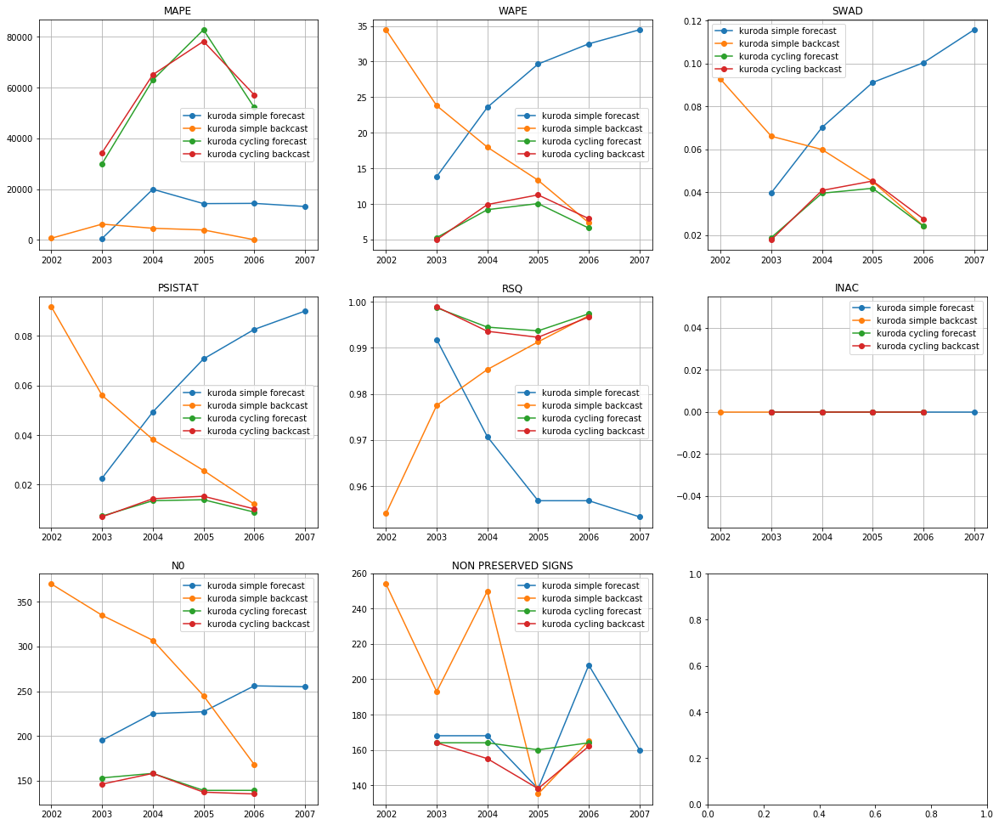

,MAPE,MAPE_R,WAPE,WAPE_R,SWAD,SWAD_R,PSISTAT,PSISTAT_R,RSQ,RSQ_R,INAC,INAC_R,N0,NON PRESERVED SIGNS,R_all,CmR
insd cycling forecast,5.631425,1,2.746925,2,0.009775,2,0.000700,2,0.999375,1,0.00000,1,164.25,164.25,9,1
nras cycling forecast,5.835400,2,2.726075,1,0.009400,1,0.000700,1,0.999350,2,0.00025,9,1.00,164.00,16,2
insd cycling backcast,8.234850,3,3.680525,3,0.012075,3,0.001175,3,0.999050,3,0.00000,1,164.00,164.00,16,2
nras cycling backcast,8.382150,4,3.697550,4,0.012100,4,0.001200,4,0.999025,4,0.00025,9,2.50,164.00,29,4
kuroda cycling forecast,57021.373800,11,7.778250,5,0.031050,5,0.010900,5,0.996075,5,0.00000,1,147.25,163.00,32,5
kuroda cycling backcast,58721.358700,12,8.523150,6,0.032825,6,0.011700,6,0.995375,6,0.00000,1,144.00,154.75,37,6
insd simple backcast,63.269000,5,13.376420,8,0.040700,8,0.018920,8,0.989120,8,0.00000,1,182.60,182.60,38,7
nras simple backcast,65.125840,6,13.241880,7,0.039100,7,0.018800,7,0.989160,7,0.00078,11,47.60,182.60,45,8
insd simple forecast,68.267940,8,19.601120,11,0.057480,9,0.031320,10,0.981780,10,0.00000,1,173.40,173.20,49,9
kuroda simple backcast,3057.743980,9,19.385160,9,0.057580,10,0.044740,11,0.981020,11,0.00000,1,285.00,199.40,51,10


use purchase I
[1997 1998 1999 2000 2001 2002]
available mtypes: [0]
nras simple forecast
nras simple backcast
final cycle: 10
nras cycling forecast
final cycle: 10
nras cycling backcast


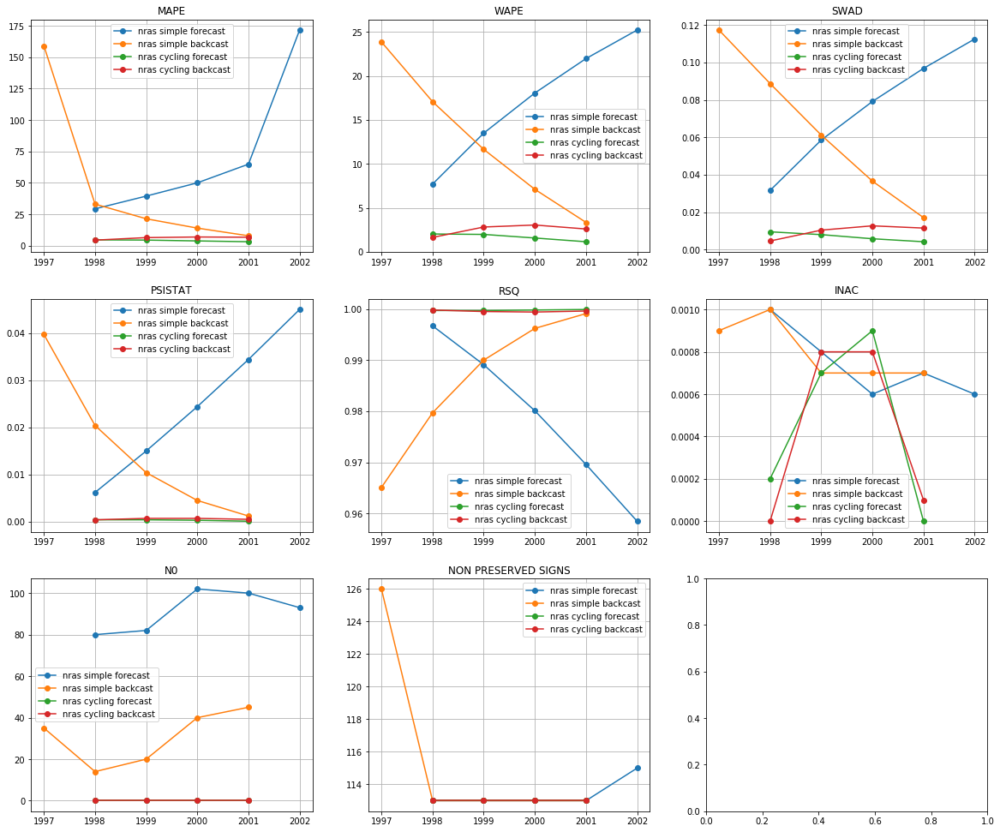

insd simple forecast
insd simple backcast
final cycle: 10
insd cycling forecast
final cycle: 10
insd cycling backcast


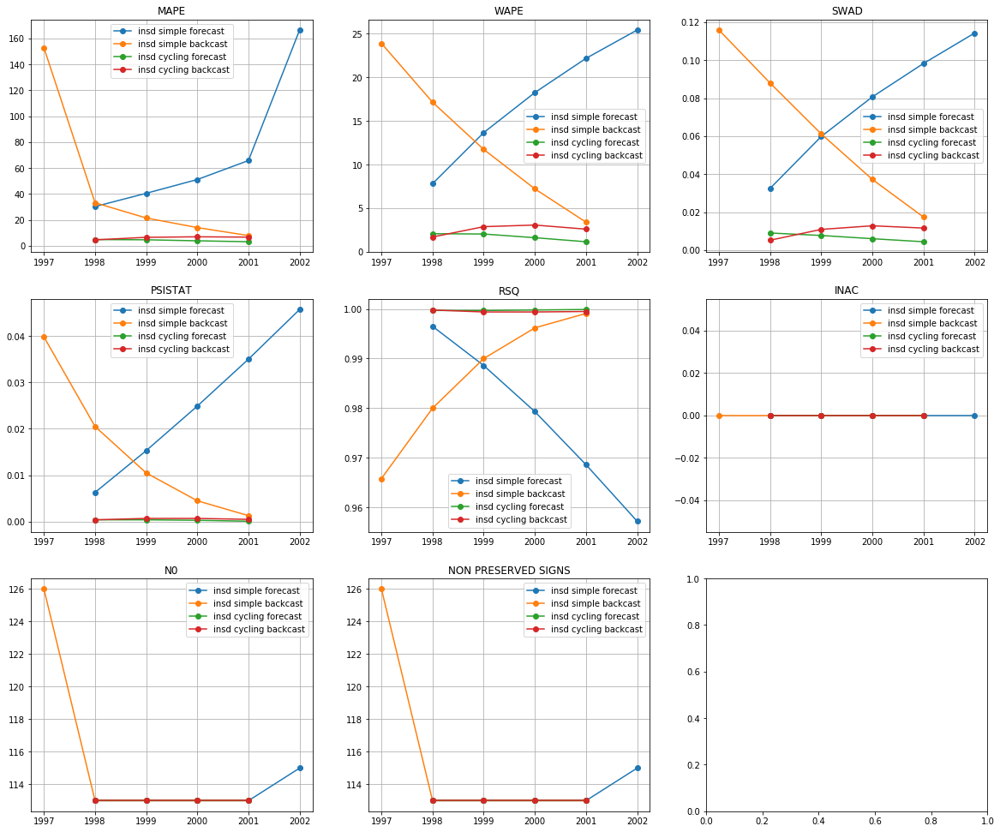

kuroda simple forecast
kuroda simple backcast
final cycle: 10
kuroda cycling forecast
final cycle: 10
kuroda cycling backcast


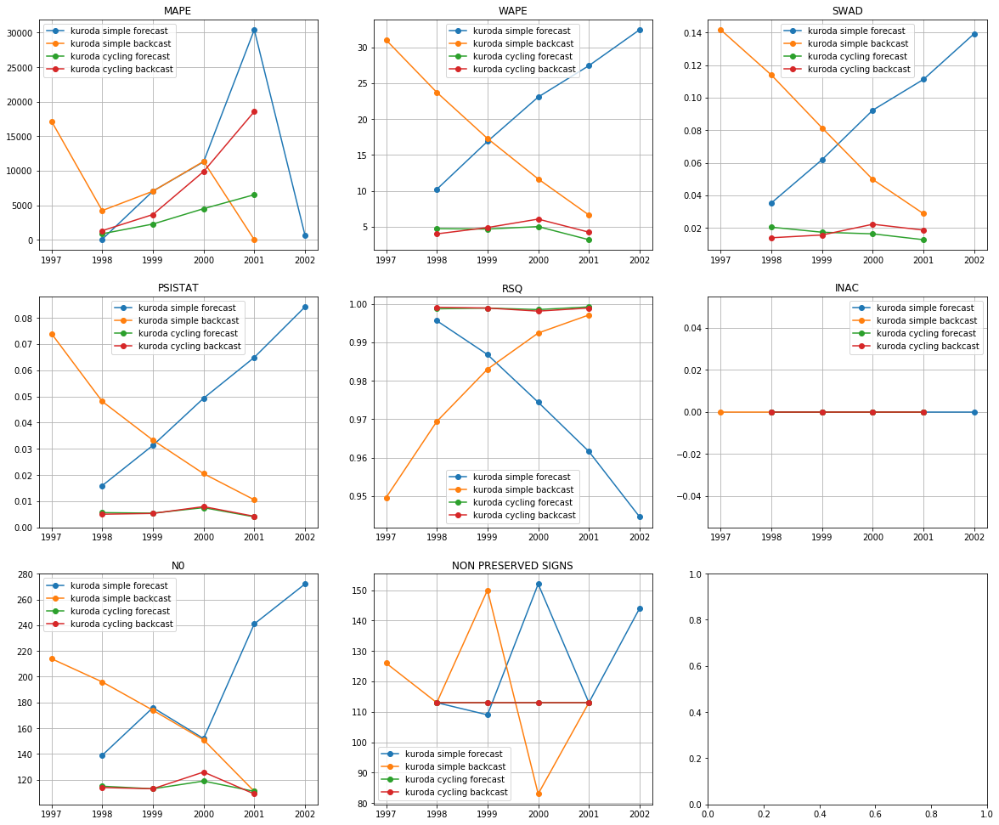

,MAPE,MAPE_R,WAPE,WAPE_R,SWAD,SWAD_R,PSISTAT,PSISTAT_R,RSQ,RSQ_R,INAC,INAC_R,N0,NON PRESERVED SIGNS,R_all,CmR
insd cycling forecast,4.116200,2,1.726275,2,0.006775,1,0.000300,1,0.999775,1,0.000000,1,113.0,113.0,8,1
nras cycling forecast,3.985050,1,1.687775,1,0.006875,2,0.000300,1,0.999775,1,0.000450,10,0.0,113.0,16,2
insd cycling backcast,6.199050,4,2.565050,4,0.010125,4,0.000575,3,0.999525,4,0.000000,1,113.0,113.0,20,3
nras cycling backcast,6.107475,3,2.531625,3,0.009800,3,0.000575,3,0.999575,3,0.000425,9,0.0,113.0,24,4
kuroda cycling forecast,3551.339825,9,4.415600,5,0.016675,5,0.005625,6,0.998825,5,0.000000,1,114.5,113.0,31,5
kuroda cycling backcast,8360.166725,11,4.809950,6,0.017575,6,0.005600,5,0.998750,6,0.000000,1,115.5,113.0,35,6
insd simple backcast,45.889620,5,12.666660,8,0.063940,7,0.015320,8,0.986220,7,0.000000,1,115.6,115.6,36,7
nras simple backcast,47.064500,6,12.609980,7,0.064180,8,0.015240,7,0.986020,8,0.000800,12,30.8,115.6,48,8
insd simple forecast,70.836220,7,17.445060,10,0.077120,10,0.025440,10,0.978040,11,0.000000,1,113.4,113.4,49,9
kuroda simple backcast,7965.745260,10,18.068860,11,0.083080,11,0.037280,11,0.978300,10,0.000000,1,169.2,117.0,54,10


[2002 2003 2004 2005 2006 2007]
available mtypes: [0]
nras simple forecast
nras simple backcast
final cycle: 10
nras cycling forecast
final cycle: 10
nras cycling backcast


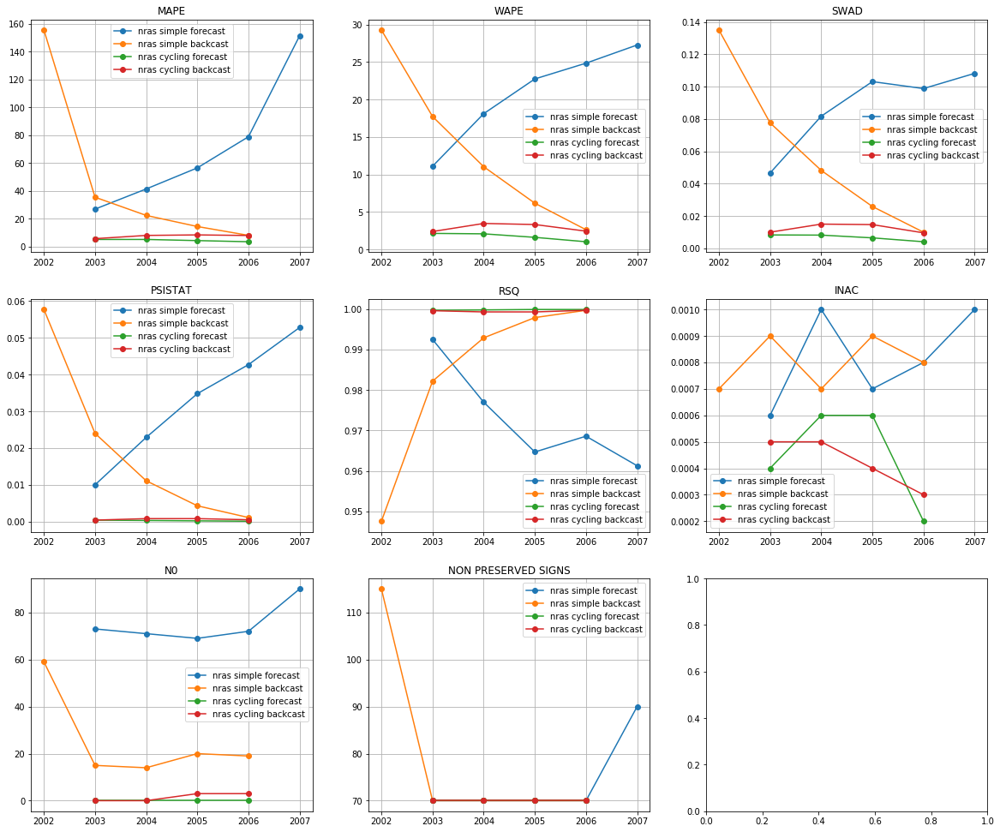

insd simple forecast
insd simple backcast
final cycle: 10
insd cycling forecast
final cycle: 10
insd cycling backcast


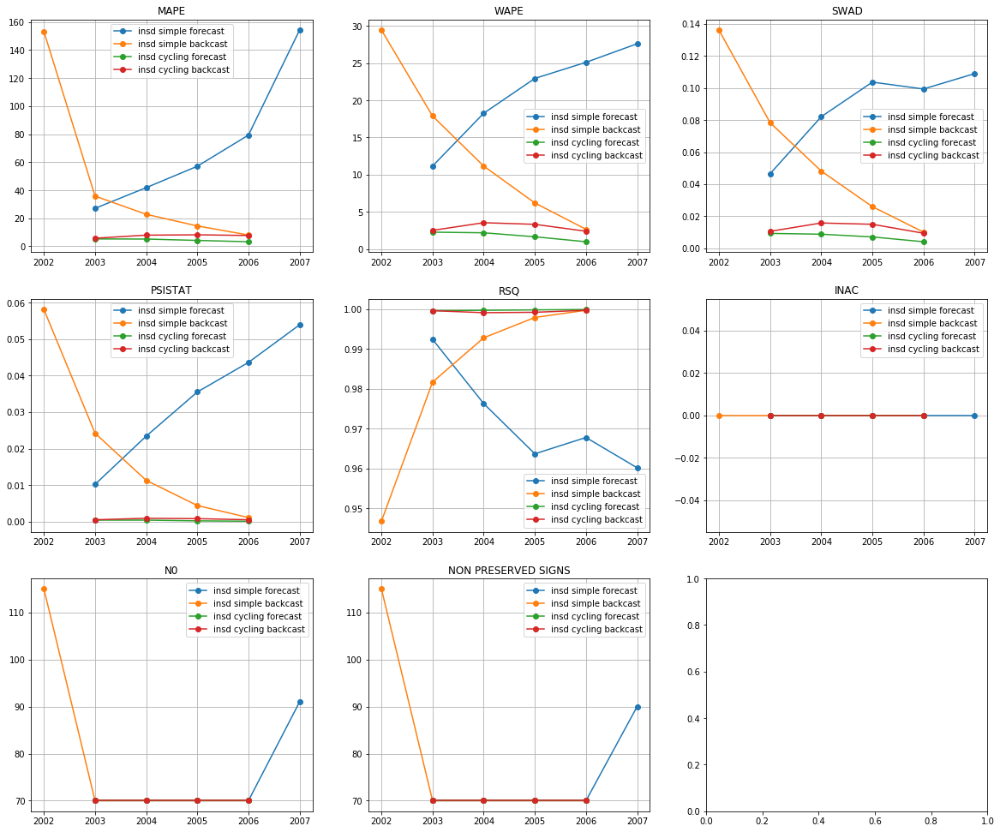

kuroda simple forecast
kuroda simple backcast
final cycle: 10
kuroda cycling forecast
final cycle: 10
kuroda cycling backcast


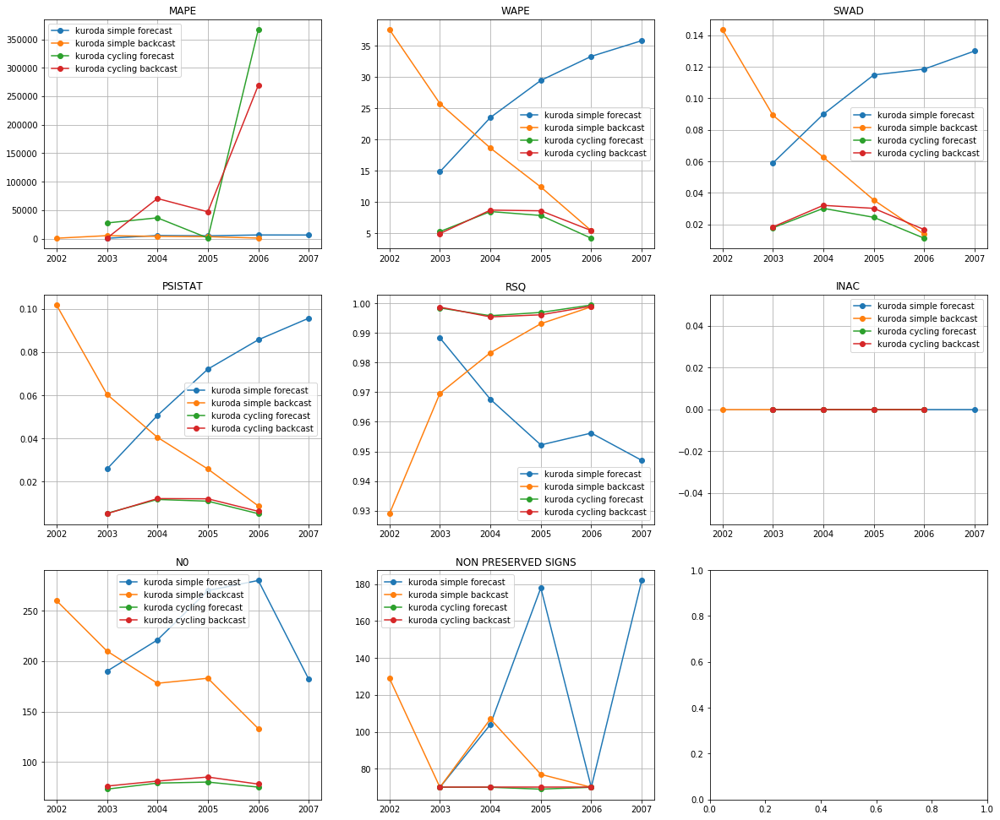

,MAPE,MAPE_R,WAPE,WAPE_R,SWAD,SWAD_R,PSISTAT,PSISTAT_R,RSQ,RSQ_R,INAC,INAC_R,N0,NON PRESERVED SIGNS,R_all,CmR
insd cycling forecast,4.486025,2,1.784000,2,0.007325,2,0.000275,2,0.999750,2,0.000000,1,70.00,70.00,11,1
nras cycling forecast,4.425425,1,1.703525,1,0.006775,1,0.000250,1,0.999825,1,0.000450,10,0.00,70.00,15,2
insd cycling backcast,7.423900,3,2.953125,4,0.012700,4,0.000675,4,0.999400,4,0.000000,1,70.00,70.00,20,3
nras cycling backcast,7.432950,4,2.893600,3,0.012325,3,0.000625,3,0.999475,3,0.000425,9,1.50,70.00,25,4
kuroda cycling forecast,107988.695275,12,6.471725,5,0.020825,5,0.008250,5,0.997625,5,0.000000,1,76.75,69.75,33,5
kuroda cycling backcast,96868.060700,11,6.943975,6,0.024250,6,0.008850,6,0.997300,6,0.000000,1,80.00,70.00,36,6
insd simple backcast,46.870120,5,13.468240,8,0.059780,8,0.019820,8,0.983780,8,0.000000,1,79.00,79.00,38,7
nras simple backcast,47.111620,6,13.358700,7,0.059340,7,0.019640,7,0.984060,7,0.000800,11,25.40,79.00,45,8
kuroda simple backcast,2776.648280,9,19.984980,9,0.068920,9,0.047440,11,0.974760,9,0.000000,1,192.80,90.60,48,9
insd simple forecast,71.895080,8,21.006460,11,0.088140,11,0.033320,10,0.972080,11,0.000000,1,74.20,74.00,52,10


sup I
[1997 1998 1999 2000 2001 2002]
available mtypes: [0]
nras simple forecast
nras simple backcast
final cycle: 10
nras cycling forecast
final cycle: 10
nras cycling backcast


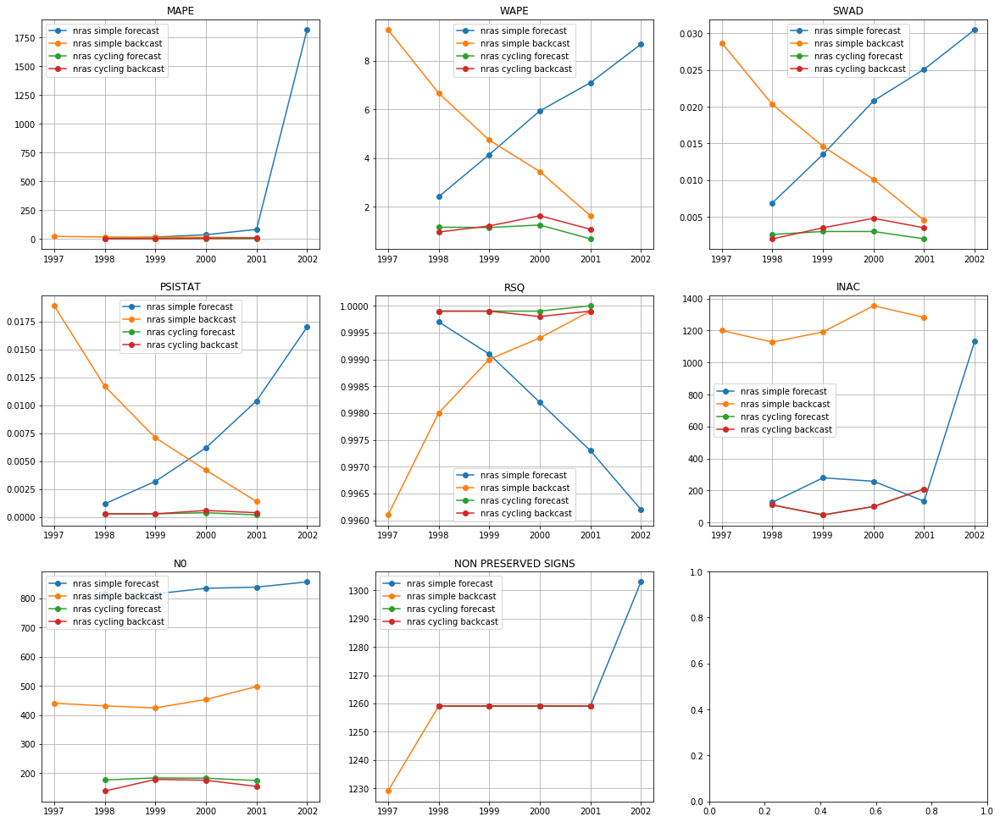

insd simple forecast
insd simple backcast
final cycle: 10
insd cycling forecast
final cycle: 10
insd cycling backcast


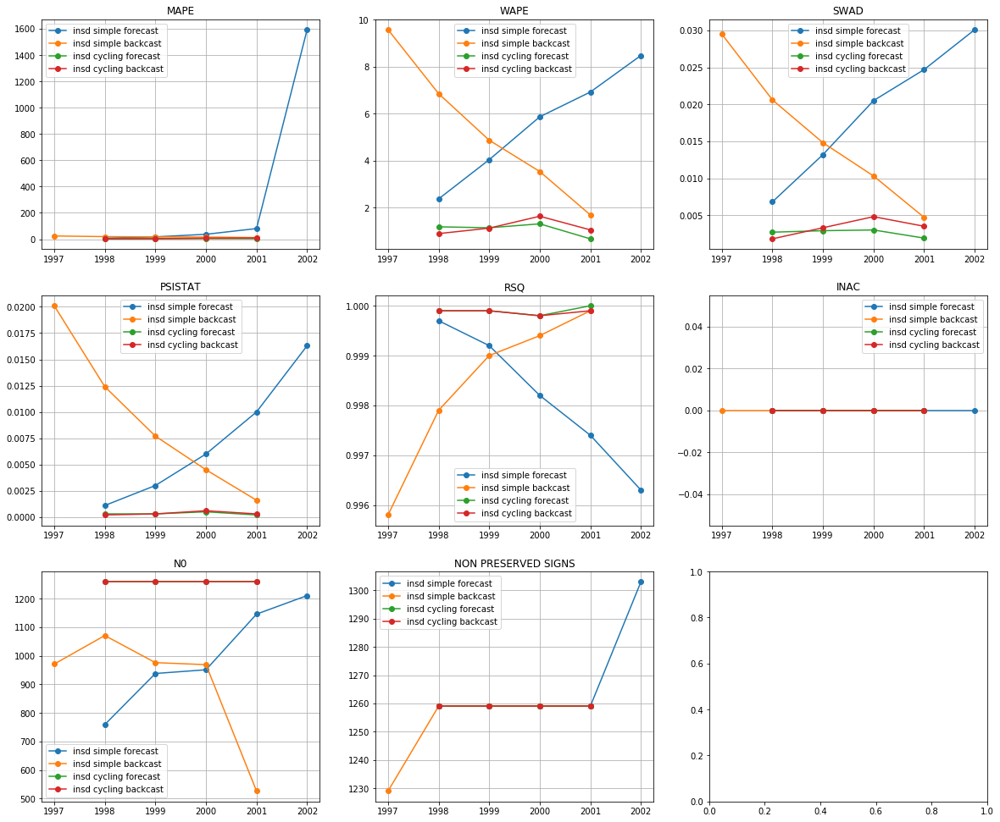

kuroda simple forecast
kuroda simple backcast
final cycle: 10
kuroda cycling forecast
final cycle: 10
kuroda cycling backcast


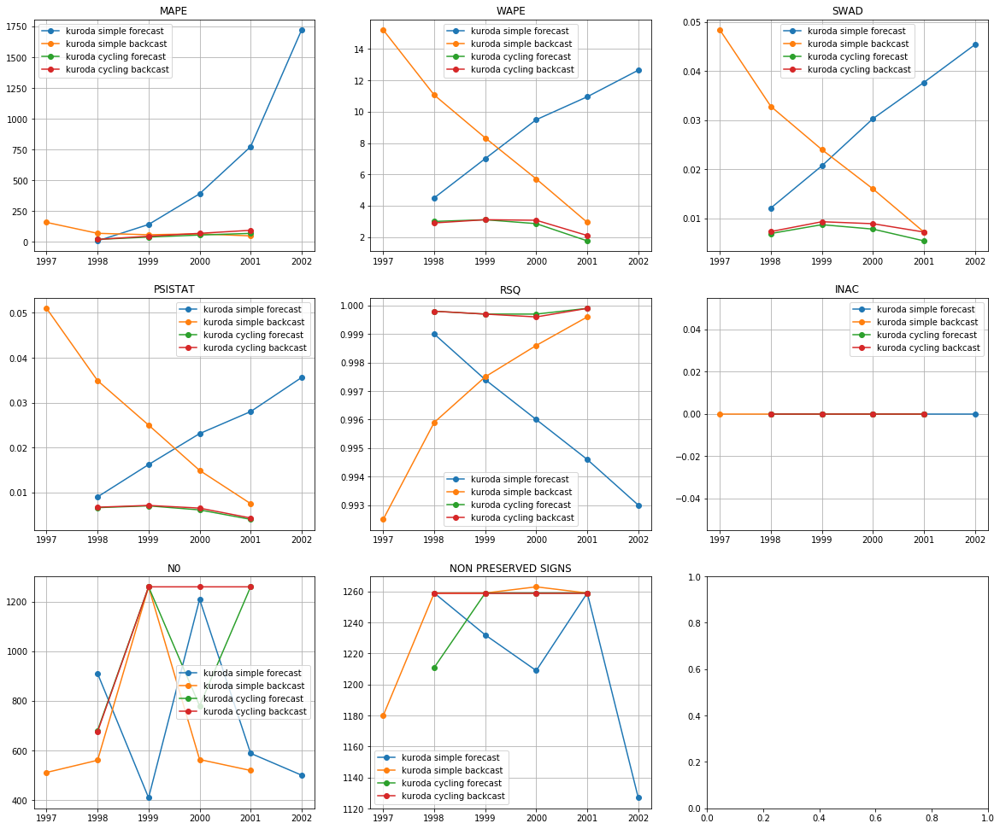

,MAPE,MAPE_R,WAPE,WAPE_R,SWAD,SWAD_R,PSISTAT,PSISTAT_R,RSQ,RSQ_R,INAC,INAC_R,N0,NON PRESERVED SIGNS,R_all,CmR
insd cycling forecast,3.681550,1,1.076925,2,0.002625,1,0.000325,2,0.999900,2,0.00000,1,1259.00,1259.0,9,1
insd cycling backcast,5.682725,3,1.176850,3,0.003350,3,0.000350,3,0.999875,3,0.00000,1,1259.00,1259.0,16,2
nras cycling forecast,3.852900,2,1.050575,1,0.002650,2,0.000300,1,0.999925,1,117.06585,10,179.75,1259.0,17,3
nras cycling backcast,6.225925,4,1.211350,4,0.003450,4,0.000400,4,0.999875,3,117.01290,9,162.25,1259.0,28,4
kuroda cycling forecast,46.981975,7,2.671650,5,0.007200,5,0.005925,5,0.999775,5,0.00000,1,994.75,1247.0,28,4
kuroda cycling backcast,58.409050,8,2.787975,6,0.008175,6,0.006150,6,0.999750,6,0.00000,1,1113.25,1259.0,33,6
insd simple backcast,17.719760,6,5.308420,8,0.015980,8,0.009260,10,0.998400,8,0.00000,1,902.60,1253.0,41,7
insd simple forecast,347.127800,10,5.538080,9,0.019060,9,0.007280,7,0.998160,9,0.00000,1,1001.00,1267.8,45,8
nras simple backcast,17.408120,5,5.151220,7,0.015640,7,0.008660,9,0.998480,7,1231.41170,12,449.00,1253.0,47,9
kuroda simple backcast,80.936380,9,8.650240,11,0.025680,11,0.026660,12,0.996820,11,0.00000,1,683.20,1244.0,55,10


[2002 2003 2004 2005 2006 2007]
available mtypes: [0]
nras simple forecast
nras simple backcast
final cycle: 10
nras cycling forecast
final cycle: 10
nras cycling backcast


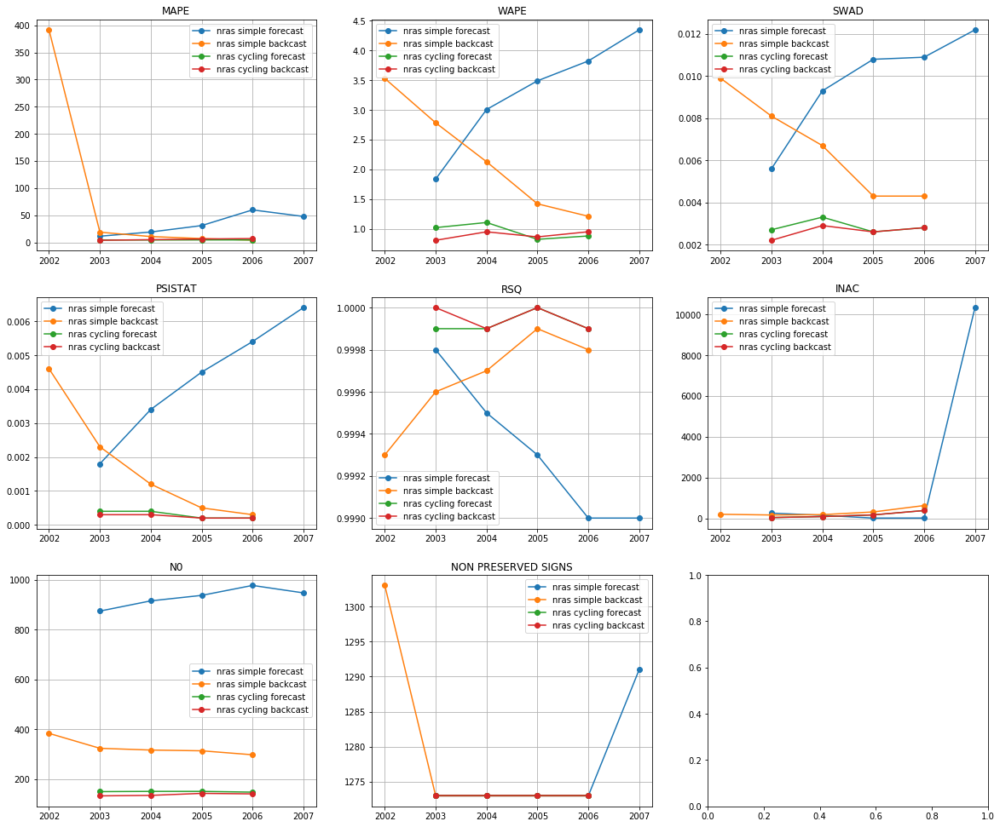

insd simple forecast
insd simple backcast
final cycle: 10
insd cycling forecast
final cycle: 10
insd cycling backcast


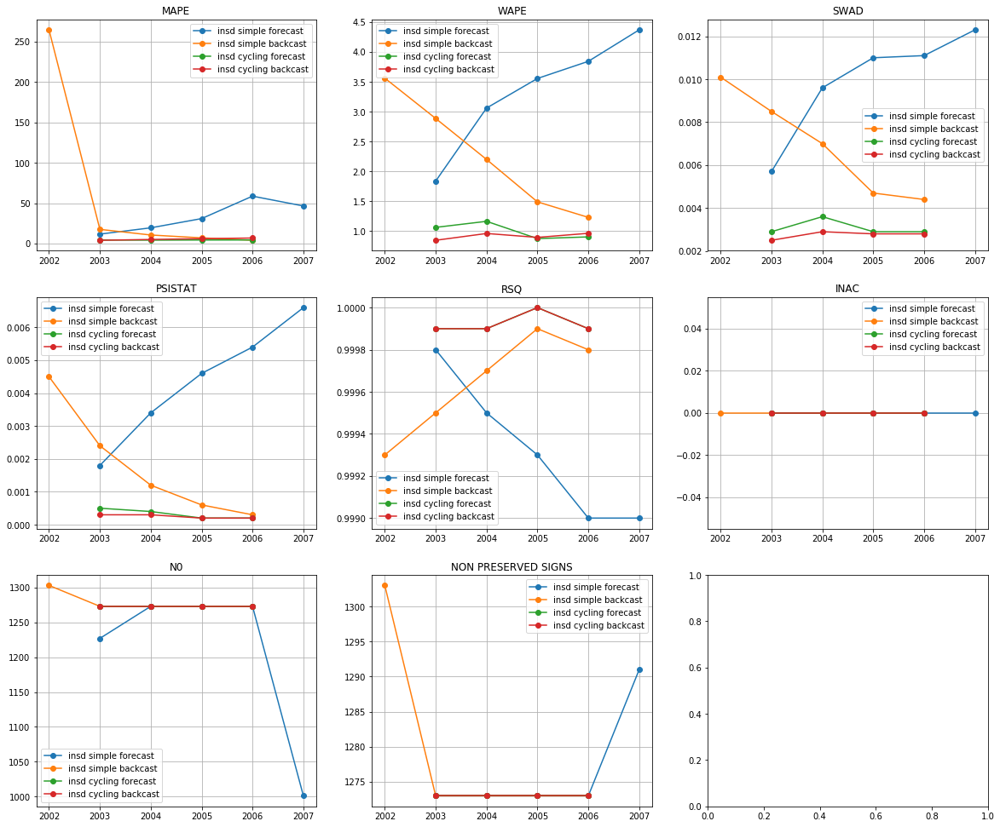

kuroda simple forecast
kuroda simple backcast
final cycle: 10
kuroda cycling forecast
final cycle: 10
kuroda cycling backcast


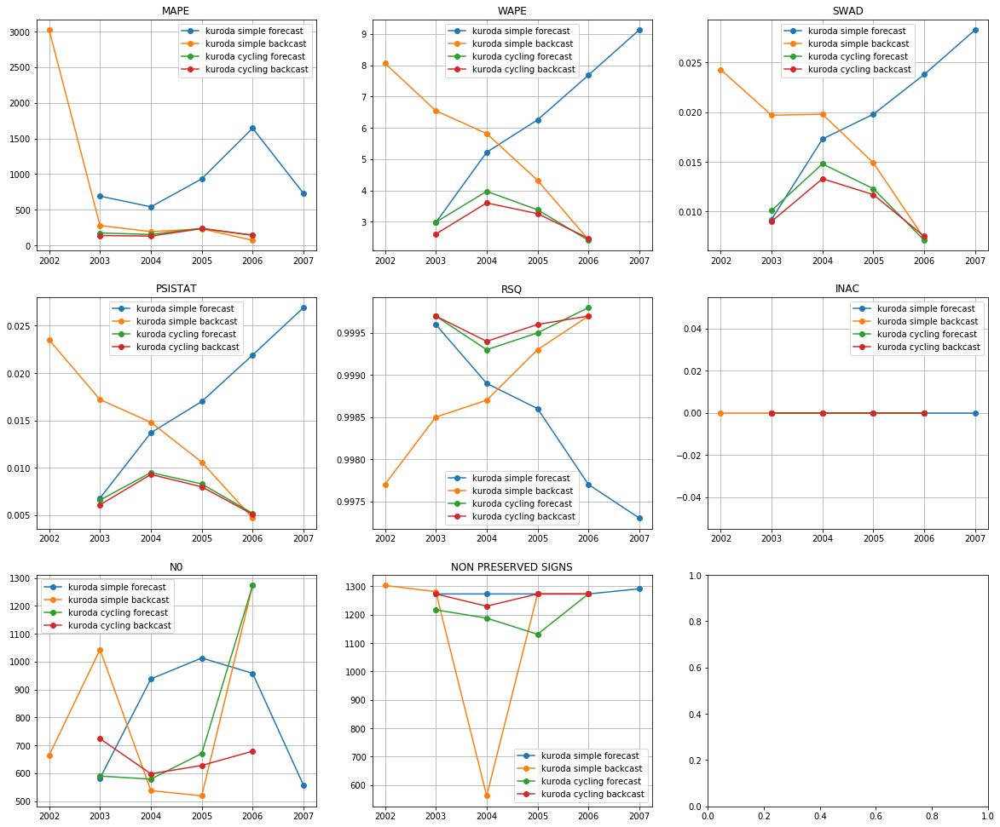

,MAPE,MAPE_R,WAPE,WAPE_R,SWAD,SWAD_R,PSISTAT,PSISTAT_R,RSQ,RSQ_R,INAC,INAC_R,N0,NON PRESERVED SIGNS,R_all,CmR
insd cycling backcast,5.447975,3,0.916125,2,0.002750,2,0.000250,1,0.999925,2,0.00000,1,1273.00,1273.00,11,1
insd cycling forecast,4.325625,1,1.001000,4,0.003075,4,0.000325,4,0.999925,2,0.00000,1,1273.00,1273.00,16,2
nras cycling backcast,5.512600,4,0.891375,1,0.002625,1,0.000250,1,0.999950,1,168.32210,9,138.00,1273.00,17,3
nras cycling forecast,4.485375,2,0.955950,3,0.002850,3,0.000300,3,0.999925,2,168.57555,10,150.00,1273.00,23,4
insd simple backcast,60.761400,7,2.273040,6,0.006940,6,0.001800,6,0.999640,6,0.00000,1,1279.00,1279.00,32,5
nras simple backcast,86.429400,8,2.213960,5,0.006660,5,0.001780,5,0.999660,5,296.30828,11,327.40,1279.00,39,6
insd simple forecast,33.421860,5,3.332720,10,0.009940,8,0.004360,8,0.999320,9,0.00000,1,1209.40,1276.60,41,7
kuroda cycling backcast,162.941100,9,2.985700,7,0.010375,9,0.007125,9,0.999600,7,0.00000,1,657.25,1262.25,42,8
kuroda cycling forecast,177.630725,10,3.188825,8,0.011075,10,0.007400,10,0.999575,8,0.00000,1,778.25,1202.25,47,9
nras simple forecast,33.791000,6,3.301060,9,0.009760,7,0.004300,7,0.999320,9,2153.07226,12,931.00,1276.60,50,10


iot
[1997 1998 1999 2000 2001 2002 2007]
available mtypes: [0]
0 LinearRegression(copy_X=True, fit_intercept=True, n_jobs=1, normalize=False) False
using mtt 0
mtt0 ridge backcast
0 Ridge(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=None,
   normalize=False, random_state=None, solver='auto', tol=0.001) False
using mtt 0
mtt0 ridge backcast
0 Lasso(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=1000,
   normalize=False, positive=False, precompute=False, random_state=None,
   selection='cyclic', tol=0.0001, warm_start=False) False
using mtt 0
mtt0 ridge backcast
nras simple forecast
nras simple backcast
final cycle: 10
nras cycling forecast
final cycle: 10
nras cycling backcast


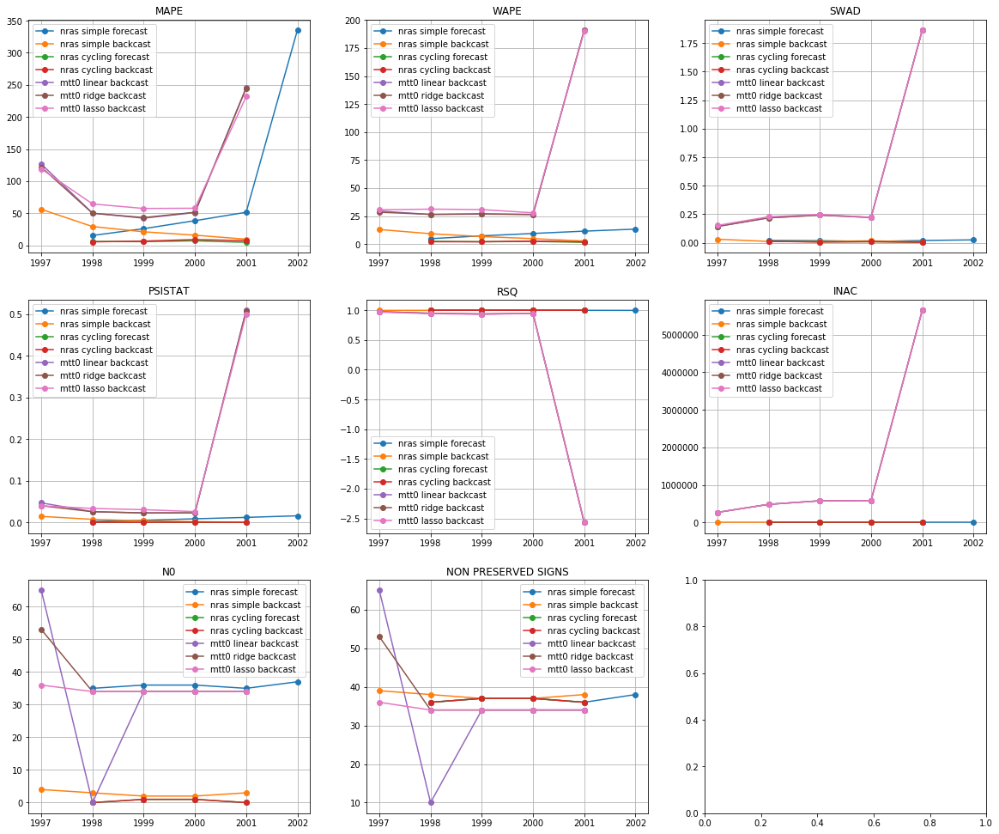

insd simple forecast
insd simple backcast
final cycle: 10
insd cycling forecast
final cycle: 10
insd cycling backcast


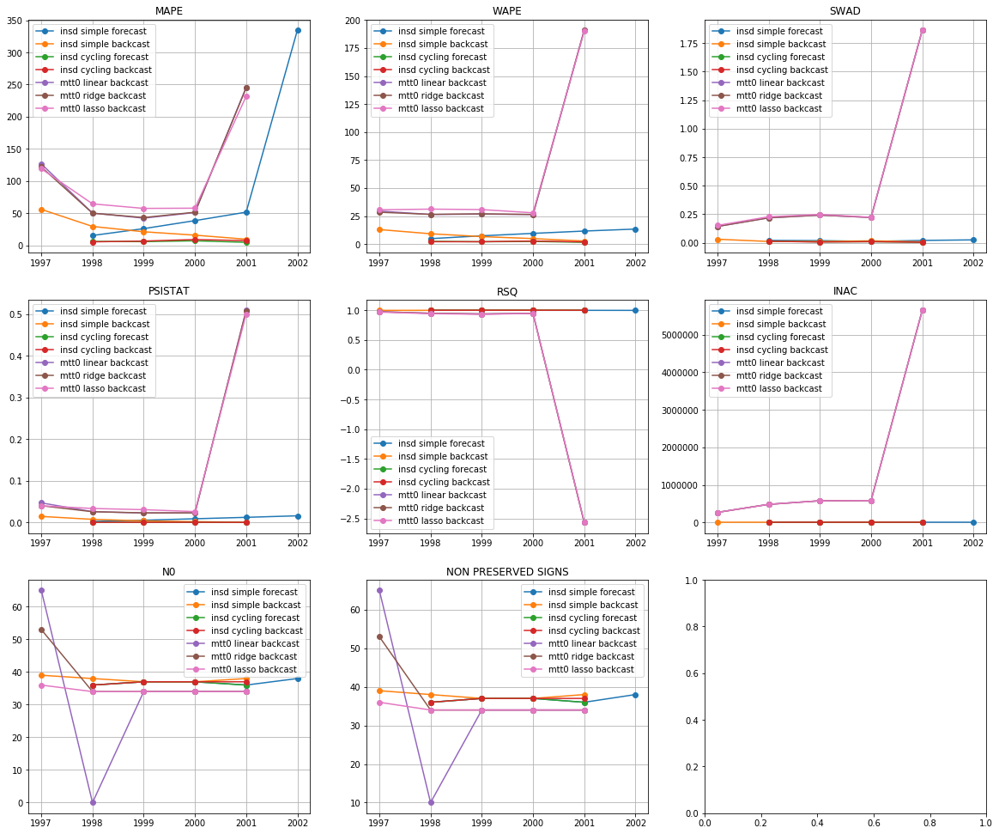

kuroda simple forecast
kuroda simple backcast
final cycle: 10
kuroda cycling forecast
final cycle: 10
kuroda cycling backcast


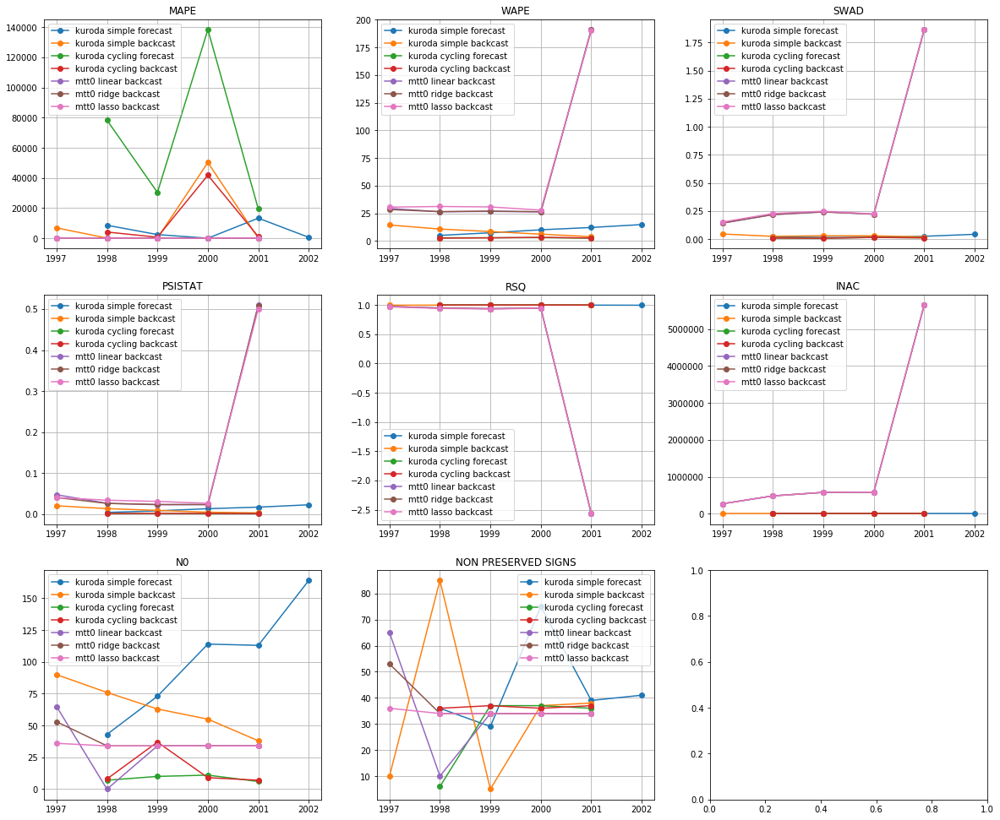

,MAPE,MAPE_R,WAPE,WAPE_R,SWAD,SWAD_R,PSISTAT,PSISTAT_R,RSQ,RSQ_R,INAC,INAC_R,N0,NON PRESERVED SIGNS,R_all,CmR
insd cycling forecast,5.838450,2,2.100900,2,0.007950,4,0.000400,1,0.999875,1,0.000000e+00,1,36.50,36.50,11,1
nras cycling forecast,5.807875,1,2.092700,1,0.007900,3,0.000400,1,0.999875,1,3.500000e-04,10,0.50,36.50,17,2
insd cycling backcast,7.042325,4,2.226275,4,0.007850,2,0.000525,3,0.999850,3,0.000000e+00,1,36.75,36.75,17,2
nras cycling backcast,7.004750,3,2.202000,3,0.007675,1,0.000525,3,0.999850,3,2.750000e-04,9,0.50,36.50,22,4
insd simple backcast,26.299520,6,7.286580,7,0.015000,7,0.005840,7,0.998960,7,0.000000e+00,1,37.80,37.80,35,5
kuroda cycling forecast,66651.348775,15,2.840000,5,0.010850,6,0.001300,5,0.999800,5,0.000000e+00,1,8.50,29.00,37,6
kuroda cycling backcast,11961.896150,14,2.875550,6,0.010650,5,0.001400,6,0.999800,5,0.000000e+00,1,15.25,36.50,37,6
nras simple backcast,26.297040,5,7.301700,8,0.015040,8,0.005840,7,0.998940,8,5.000000e-04,11,2.80,37.80,47,8
insd simple forecast,93.177060,7,9.352820,11,0.018620,10,0.009220,10,0.998640,10,0.000000e+00,1,36.80,36.80,49,9
nras simple forecast,93.280700,8,9.297380,10,0.018260,9,0.009140,9,0.998660,9,5.400000e-04,12,35.80,36.80,57,10


[1997 2002 2003 2004 2005 2006 2007]
available mtypes: [0]
0 LinearRegression(copy_X=True, fit_intercept=True, n_jobs=1, normalize=False) True
using mtt 0
mtt0 ridge forecast
0 Ridge(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=None,
   normalize=False, random_state=None, solver='auto', tol=0.001) True
using mtt 0
mtt0 ridge forecast
0 Lasso(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=1000,
   normalize=False, positive=False, precompute=False, random_state=None,
   selection='cyclic', tol=0.0001, warm_start=False) True
using mtt 0
mtt0 ridge forecast
nras simple forecast
nras simple backcast
final cycle: 10
nras cycling forecast
final cycle: 10
nras cycling backcast


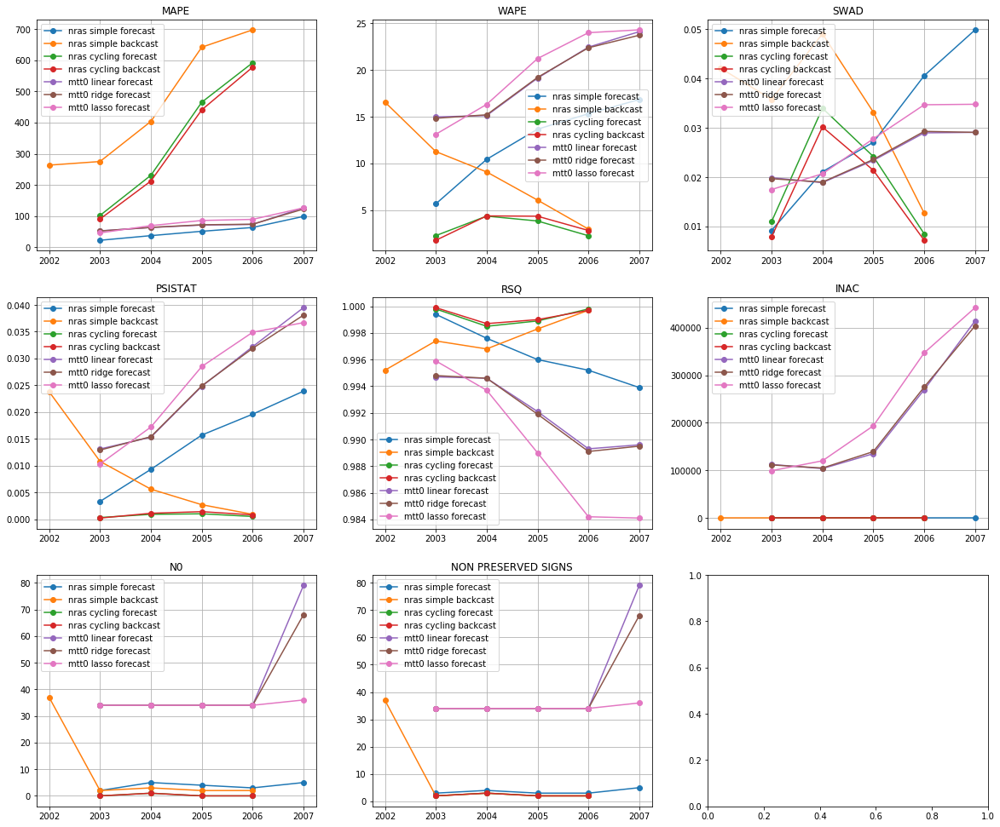

insd simple forecast
insd simple backcast
final cycle: 10
insd cycling forecast
final cycle: 10
insd cycling backcast


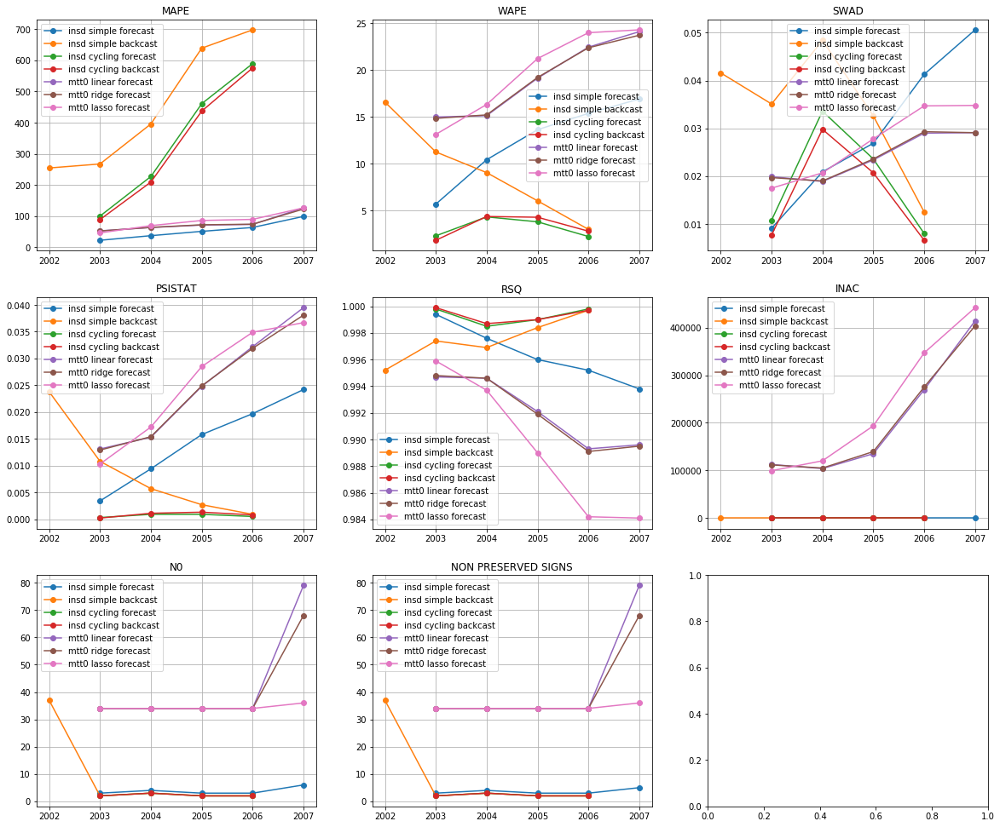

kuroda simple forecast
kuroda simple backcast
final cycle: 10
kuroda cycling forecast
final cycle: 10
kuroda cycling backcast


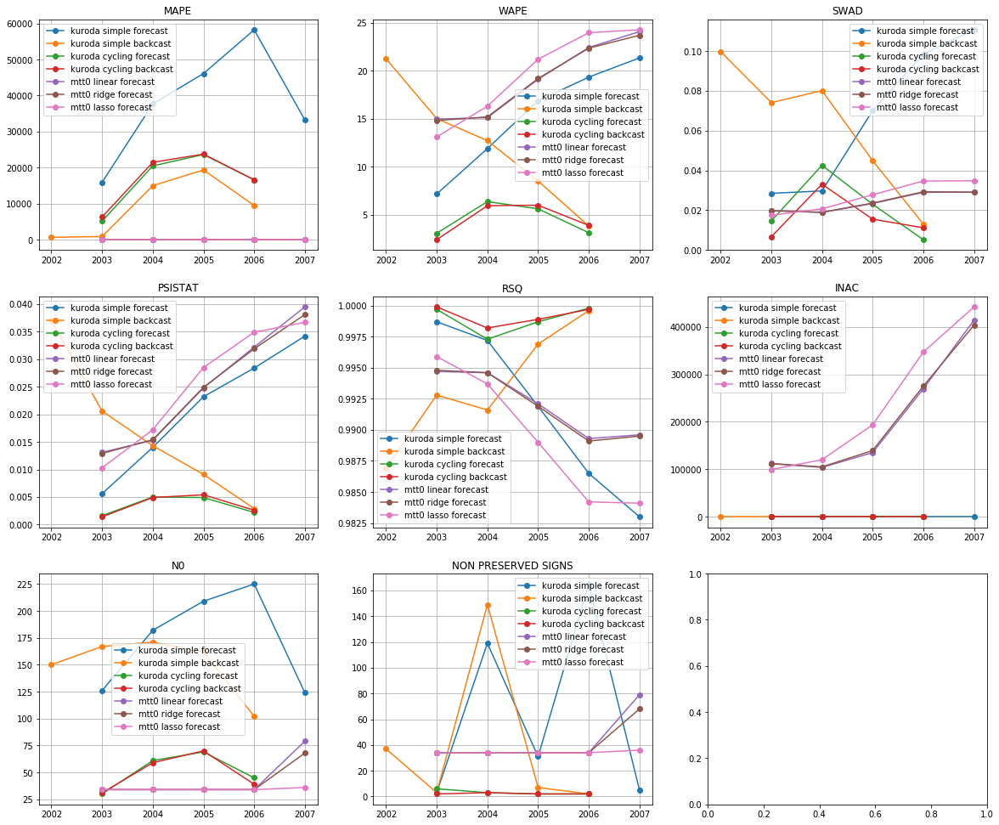

,MAPE,MAPE_R,WAPE,WAPE_R,SWAD,SWAD_R,PSISTAT,PSISTAT_R,RSQ,RSQ_R,INAC,INAC_R,N0,NON PRESERVED SIGNS,R_all,CmR
insd cycling backcast,327.660925,6,3.302175,3,0.016200,1,0.000850,3,0.999325,1,0.000000,1,2.25,2.25,15,1
insd cycling forecast,344.325950,8,3.145425,1,0.019000,4,0.000650,1,0.999275,3,0.000000,1,2.25,2.25,18,2
nras cycling backcast,330.340825,7,3.341950,4,0.016675,3,0.000875,4,0.999325,1,0.000075,10,0.25,2.25,29,3
nras cycling forecast,347.485350,9,3.193075,2,0.019425,5,0.000675,2,0.999250,4,0.000050,9,0.25,2.25,31,4
kuroda cycling backcast,17067.419775,14,4.558200,6,0.016625,2,0.003575,6,0.999175,5,0.000000,1,49.75,2.25,34,5
kuroda cycling forecast,16496.875825,13,4.547600,5,0.021350,6,0.003425,5,0.998875,6,0.000000,1,51.25,3.25,36,6
insd simple forecast,54.534620,1,12.392400,11,0.029760,11,0.014500,10,0.996400,10,0.000000,1,3.80,3.60,44,7
insd simple backcast,450.885560,10,9.170200,7,0.034040,12,0.008780,8,0.997520,7,0.000000,1,9.20,9.20,45,8
nras simple forecast,54.589980,2,12.386500,10,0.029580,10,0.014360,9,0.996420,9,0.000580,12,3.80,3.60,52,9
nras simple backcast,456.259260,11,9.197380,8,0.034580,13,0.008760,7,0.997480,8,0.000540,11,9.20,9.20,58,10


In [38]:
metrics_res['CHN'] = get_results('CHN')

RUS
use basic I+II
[2011 2012 2013 2014 2015 2016]
available mtypes: [0]
nras simple forecast
nras simple backcast
final cycle: 10
nras cycling forecast
final cycle: 10
nras cycling backcast


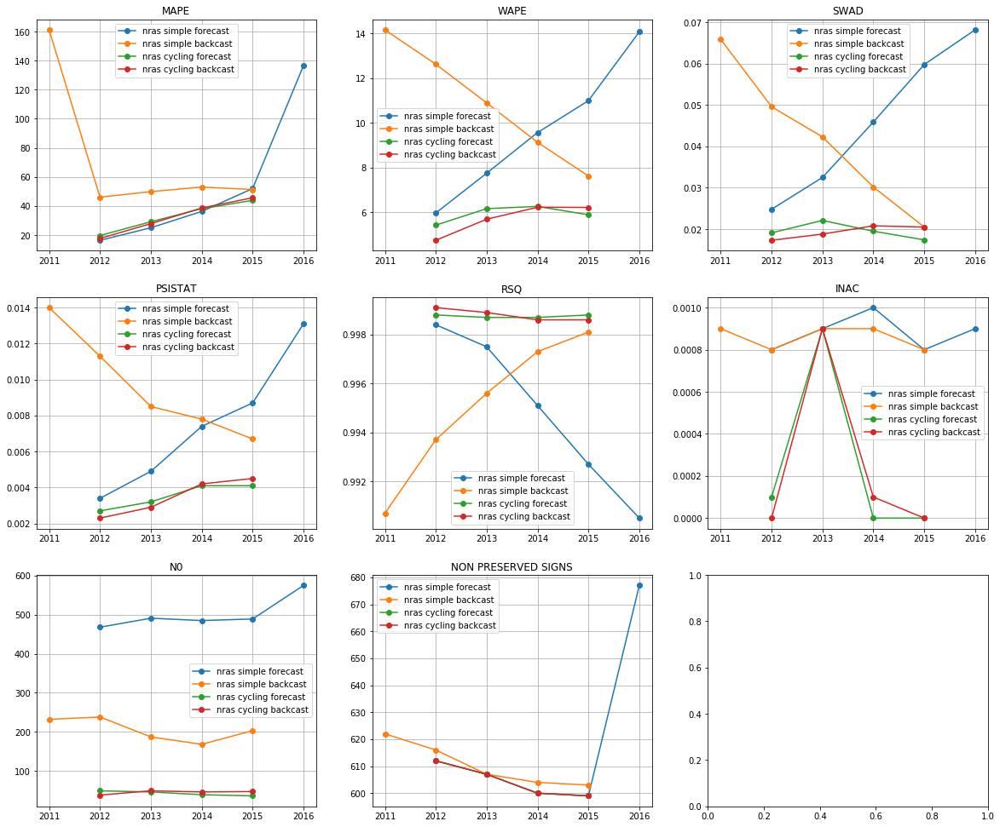

insd simple forecast
insd simple backcast
final cycle: 10
insd cycling forecast
final cycle: 10
insd cycling backcast


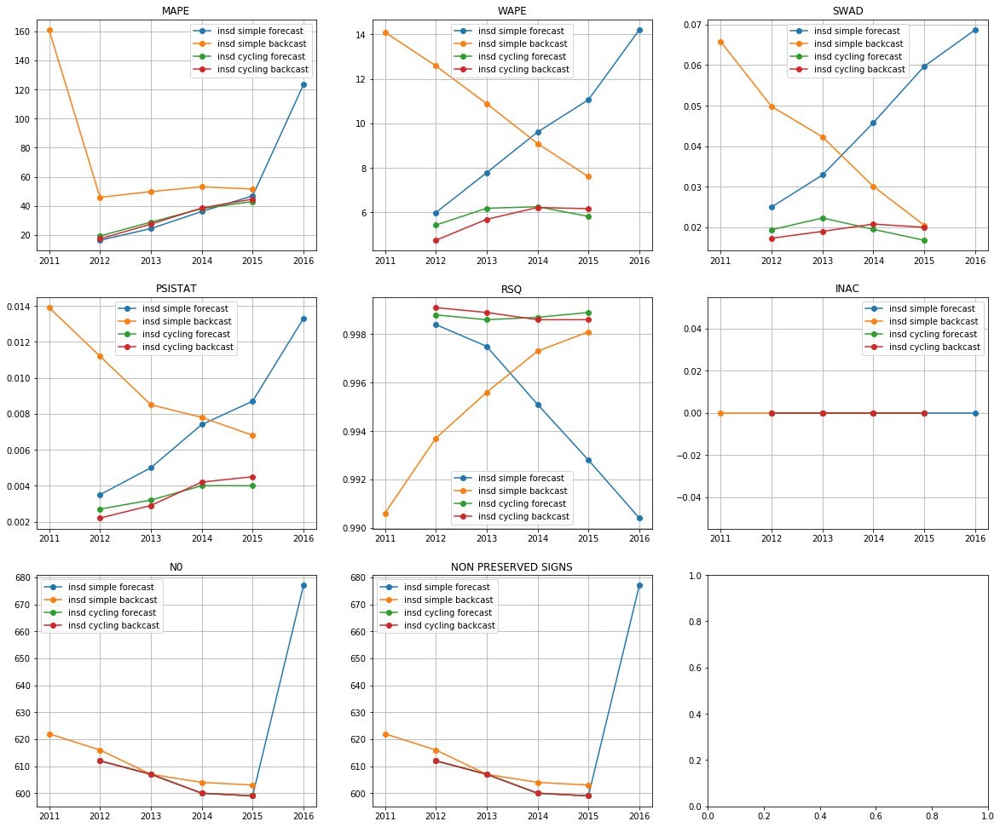

kuroda simple forecast
kuroda simple backcast
final cycle: 10
kuroda cycling forecast
final cycle: 10
kuroda cycling backcast


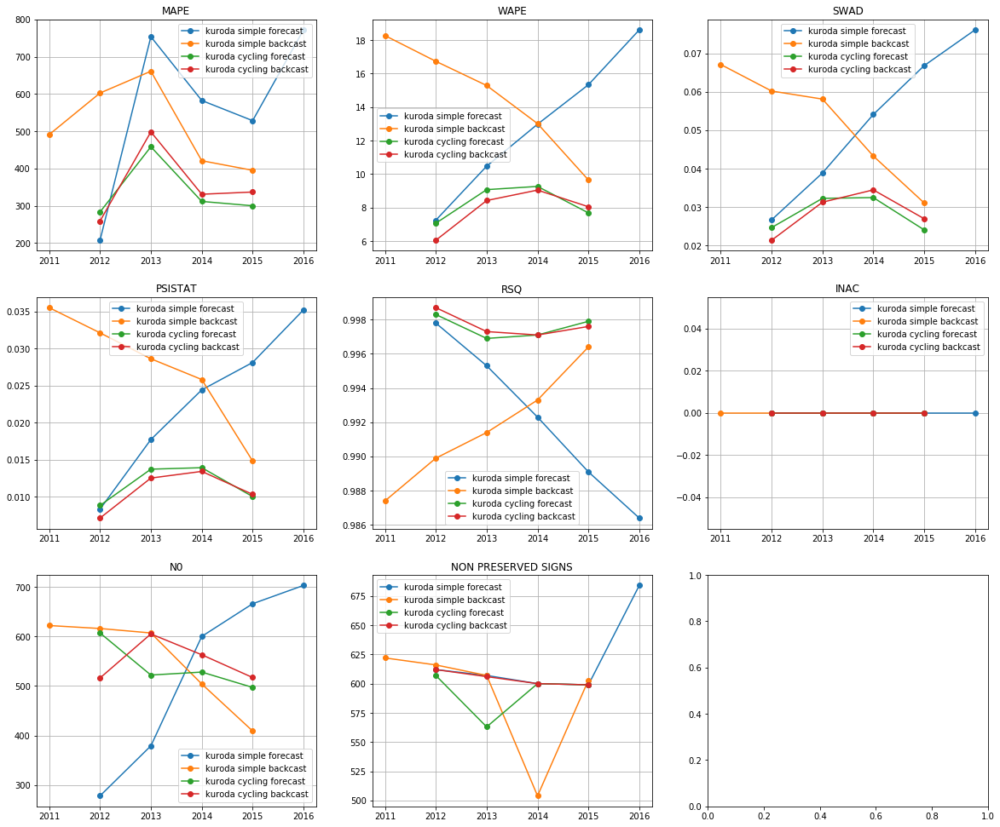

,MAPE,MAPE_R,WAPE,WAPE_R,SWAD,SWAD_R,PSISTAT,PSISTAT_R,RSQ,RSQ_R,INAC,INAC_R,N0,NON PRESERVED SIGNS,R_all,CmR
insd cycling backcast,32.021300,1,5.710175,1,0.019275,1,0.003450,1,0.998800,1,0.00000,1,604.50,604.50,6,1
insd cycling forecast,32.334350,2,5.927125,3,0.019500,3,0.003475,3,0.998750,3,0.00000,1,604.50,604.50,15,2
nras cycling backcast,32.496050,3,5.715275,2,0.019350,2,0.003475,2,0.998800,1,0.00025,9,45.00,604.50,19,3
nras cycling forecast,32.771675,4,5.930275,4,0.019525,4,0.003525,4,0.998750,3,0.00025,9,42.50,604.50,28,4
kuroda cycling backcast,356.072850,10,7.892350,5,0.028550,6,0.010825,9,0.997675,5,0.00000,1,550.25,604.25,36,5
kuroda cycling forecast,338.088500,9,8.272225,6,0.028400,5,0.011600,10,0.997550,6,0.00000,1,538.50,592.25,37,6
insd simple backcast,72.281000,7,10.851160,9,0.041700,7,0.009640,7,0.995060,8,0.00000,1,610.40,610.40,39,7
insd simple forecast,49.429880,5,9.728500,8,0.046420,10,0.007580,6,0.994840,10,0.00000,1,619.00,619.00,40,8
nras simple forecast,53.302580,6,9.663520,7,0.046240,9,0.007500,5,0.994840,9,0.00088,12,501.60,619.00,48,9
nras simple backcast,72.319780,8,10.879120,10,0.041700,8,0.009660,8,0.995080,7,0.00086,11,205.60,610.40,52,10


use basic I
[2011 2012 2013 2014 2015 2016]
available mtypes: [0]
nras simple forecast
nras simple backcast
final cycle: 10
nras cycling forecast
final cycle: 10
nras cycling backcast


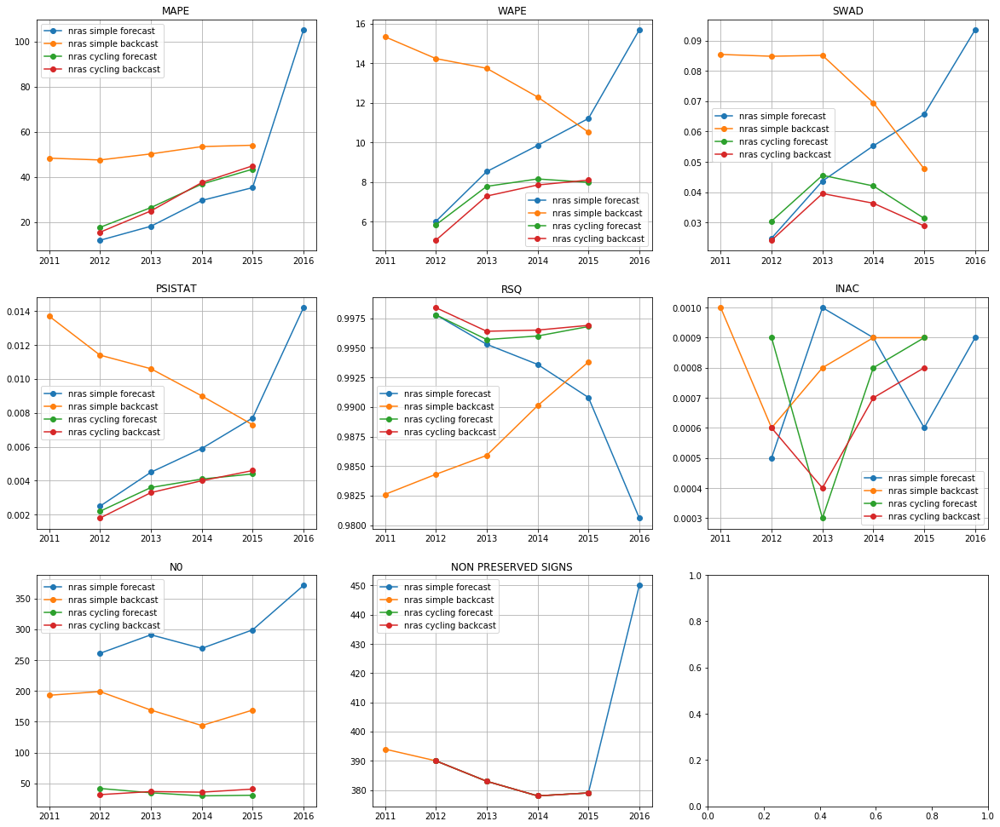

insd simple forecast
insd simple backcast
final cycle: 10
insd cycling forecast
final cycle: 10
insd cycling backcast


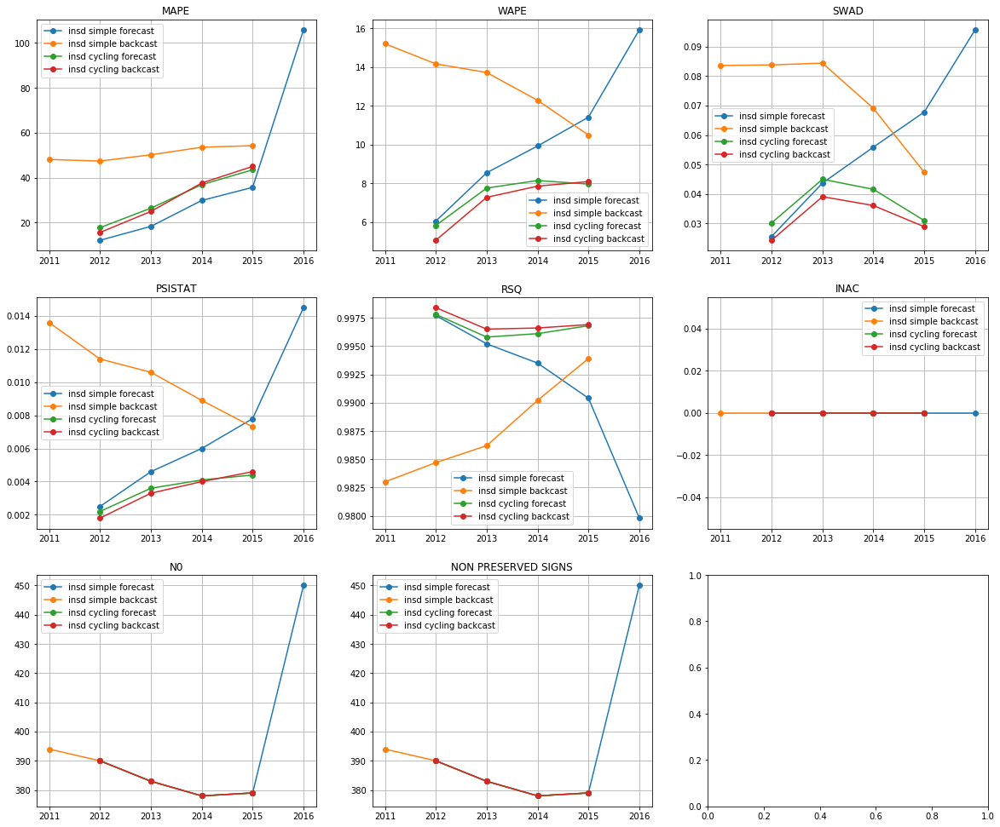

kuroda simple forecast
kuroda simple backcast
final cycle: 10
kuroda cycling forecast
final cycle: 10
kuroda cycling backcast


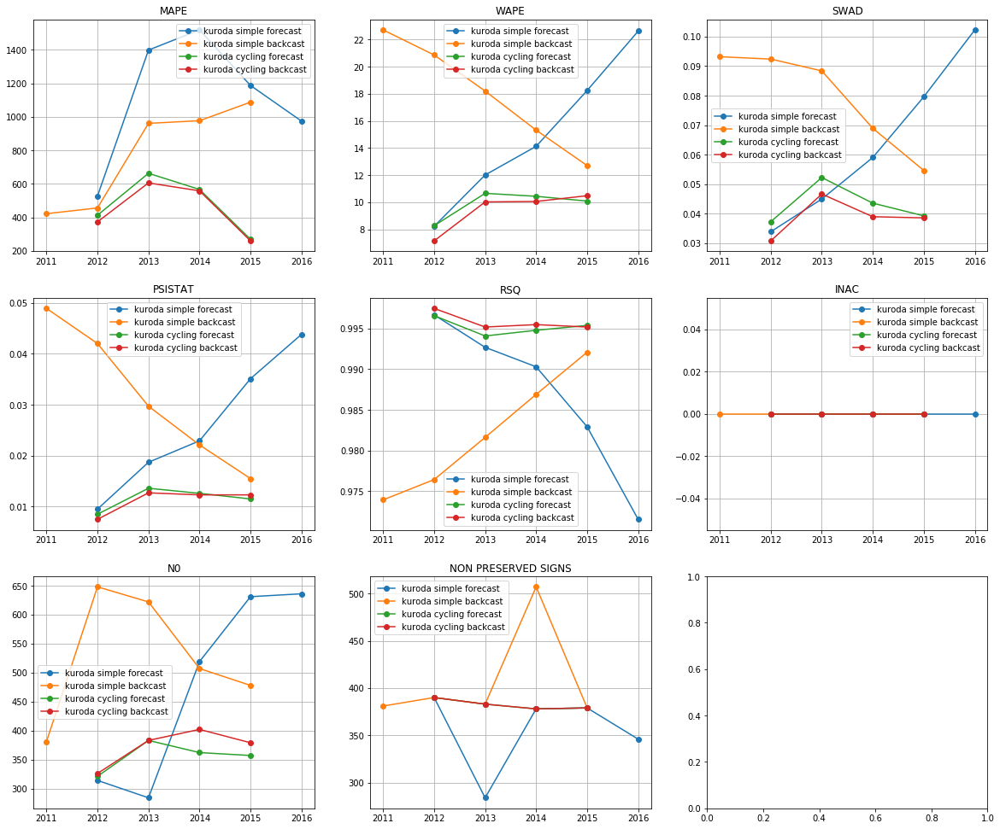

,MAPE,MAPE_R,WAPE,WAPE_R,SWAD,SWAD_R,PSISTAT,PSISTAT_R,RSQ,RSQ_R,INAC,INAC_R,N0,NON PRESERVED SIGNS,R_all,CmR
insd cycling backcast,30.769025,2,7.073800,1,0.032100,1,0.003425,1,0.997100,1,0.000000,1,382.50,382.5,7,1
nras cycling backcast,30.735500,1,7.080050,2,0.032275,2,0.003425,1,0.997050,2,0.000625,9,36.50,382.5,17,2
insd cycling forecast,31.107125,4,7.424475,3,0.036950,3,0.003575,3,0.996625,3,0.000000,1,382.50,382.5,17,2
nras cycling forecast,31.104500,3,7.444775,4,0.037400,4,0.003575,3,0.996575,4,0.000725,10,34.50,382.5,28,4
kuroda cycling backcast,448.868200,9,9.425800,5,0.038675,5,0.011200,9,0.995850,5,0.000000,1,372.50,382.5,34,5
insd simple forecast,40.326360,6,10.371600,8,0.057740,8,0.007080,6,0.991320,8,0.000000,1,396.00,396.0,37,6
kuroda cycling forecast,477.631500,10,9.860050,6,0.043025,6,0.011550,10,0.995225,6,0.000000,1,355.75,382.5,39,7
nras simple forecast,40.028060,5,10.260400,7,0.056620,7,0.006960,5,0.991620,7,0.000780,11,298.20,396.0,42,8
insd simple backcast,50.669800,7,13.170380,9,0.073660,10,0.010360,7,0.987600,9,0.000000,1,384.80,384.8,43,9
kuroda simple forecast,1120.970240,12,15.044800,11,0.063920,9,0.026000,11,0.986820,11,0.000000,1,476.80,355.4,55,10


use purchase I+II
[2011 2012 2013 2014 2015 2016]
available mtypes: [0]
nras simple forecast
nras simple backcast
final cycle: 10
nras cycling forecast
final cycle: 10
nras cycling backcast


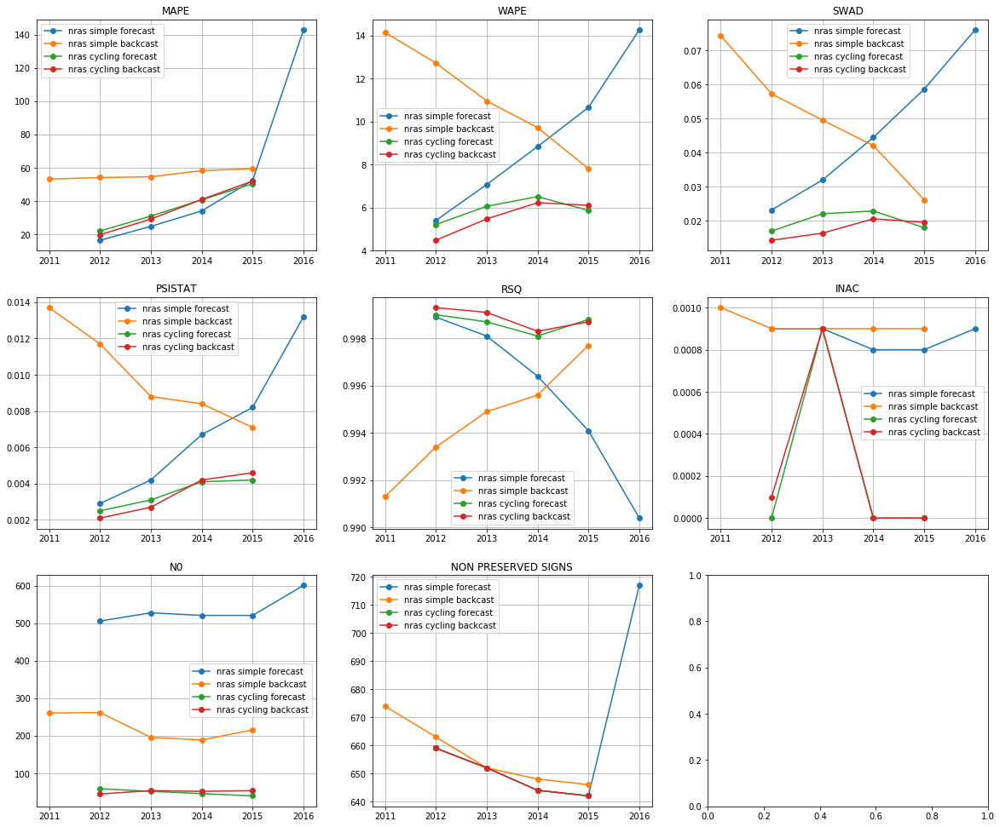

insd simple forecast
insd simple backcast
final cycle: 10
insd cycling forecast
final cycle: 10
insd cycling backcast


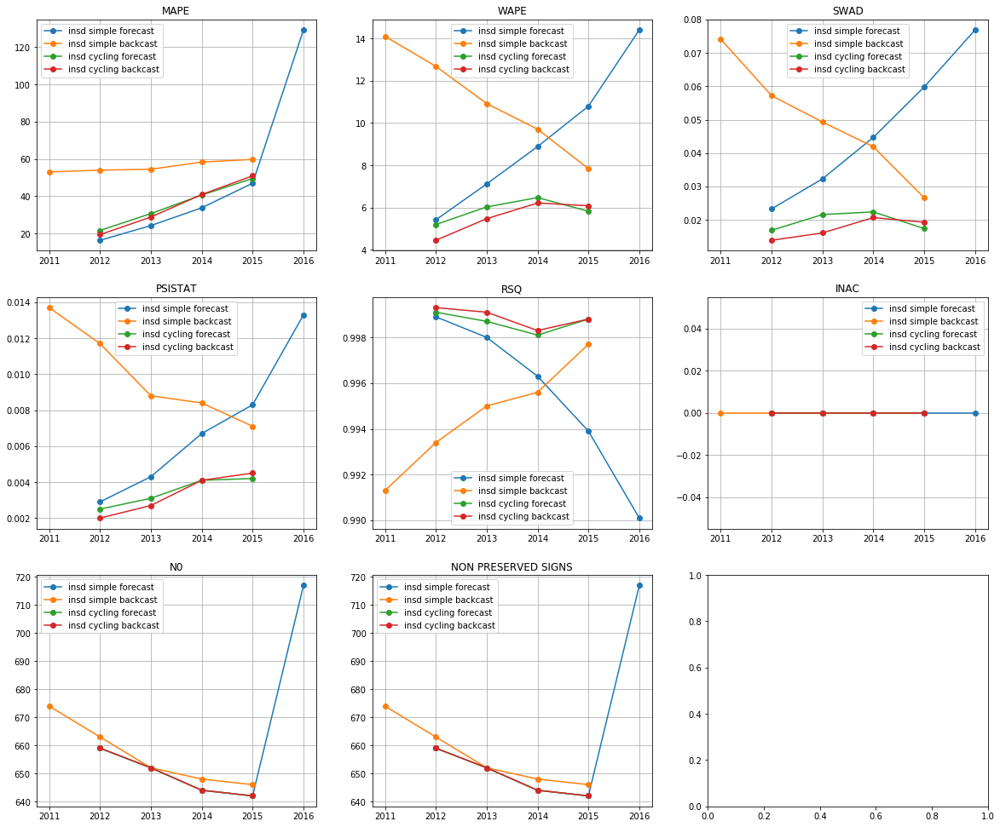

kuroda simple forecast
kuroda simple backcast
final cycle: 10
kuroda cycling forecast
final cycle: 10
kuroda cycling backcast


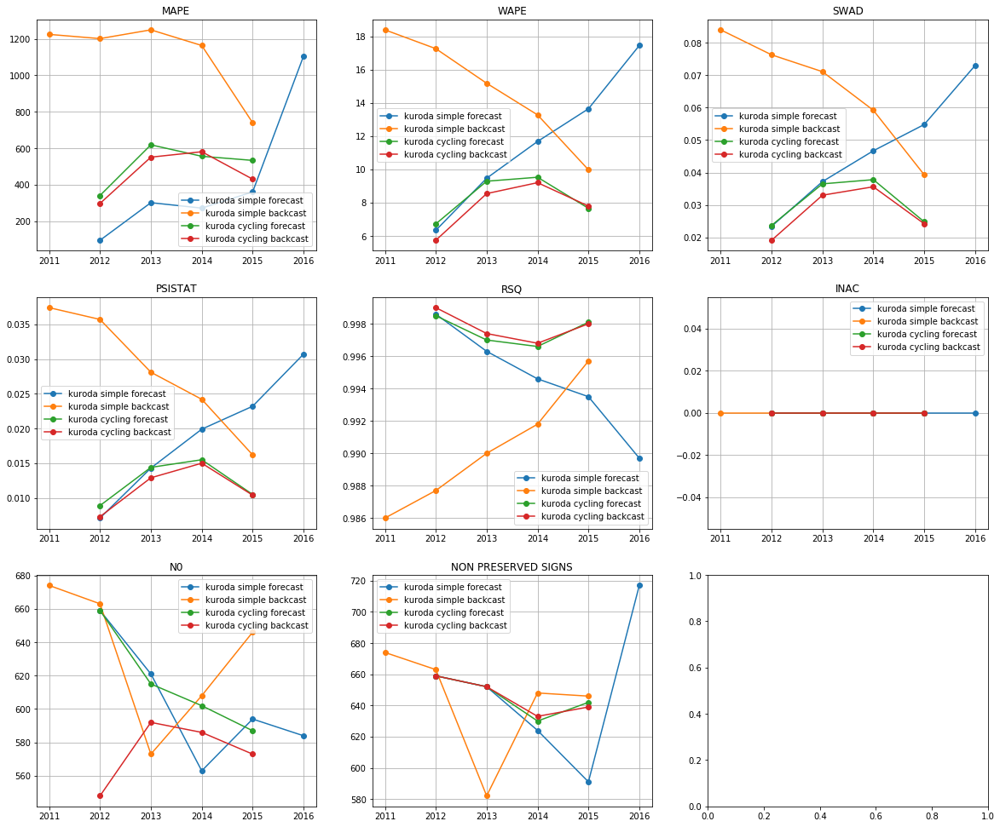

,MAPE,MAPE_R,WAPE,WAPE_R,SWAD,SWAD_R,PSISTAT,PSISTAT_R,RSQ,RSQ_R,INAC,INAC_R,N0,NON PRESERVED SIGNS,R_all,CmR
insd cycling backcast,34.986825,1,5.554100,1,0.017500,1,0.003325,1,0.998875,1,0.000000,1,649.25,649.25,6,1
insd cycling forecast,35.588200,3,5.878900,3,0.019575,3,0.003475,3,0.998675,3,0.000000,1,649.25,649.25,16,2
nras cycling backcast,35.507500,2,5.573450,2,0.017725,2,0.003400,2,0.998850,2,0.000250,10,51.25,649.25,20,3
nras cycling forecast,36.058425,4,5.913925,4,0.020000,4,0.003475,3,0.998650,4,0.000225,9,49.25,649.25,28,4
kuroda cycling backcast,465.066025,10,7.818775,5,0.027975,5,0.011400,9,0.997800,5,0.000000,1,574.75,645.75,35,5
insd simple forecast,50.098880,5,9.322600,8,0.047400,9,0.007100,6,0.995440,8,0.000000,1,662.80,662.80,37,6
kuroda cycling forecast,512.286950,11,8.299250,6,0.030700,6,0.012325,10,0.997550,6,0.000000,1,615.75,645.75,40,7
nras simple forecast,54.150340,6,9.245060,7,0.046900,7,0.007040,5,0.995580,7,0.000860,11,535.40,662.80,43,8
insd simple backcast,55.879880,7,11.049000,9,0.049820,10,0.009940,7,0.994600,9,0.000000,1,656.60,656.60,43,8
kuroda simple forecast,426.853880,9,11.714060,11,0.047020,8,0.019040,11,0.994540,11,0.000000,1,604.20,648.60,51,10


use purchase I
[2011 2012 2013 2014 2015 2016]
available mtypes: [0]
nras simple forecast
nras simple backcast
final cycle: 10
nras cycling forecast
final cycle: 10
nras cycling backcast


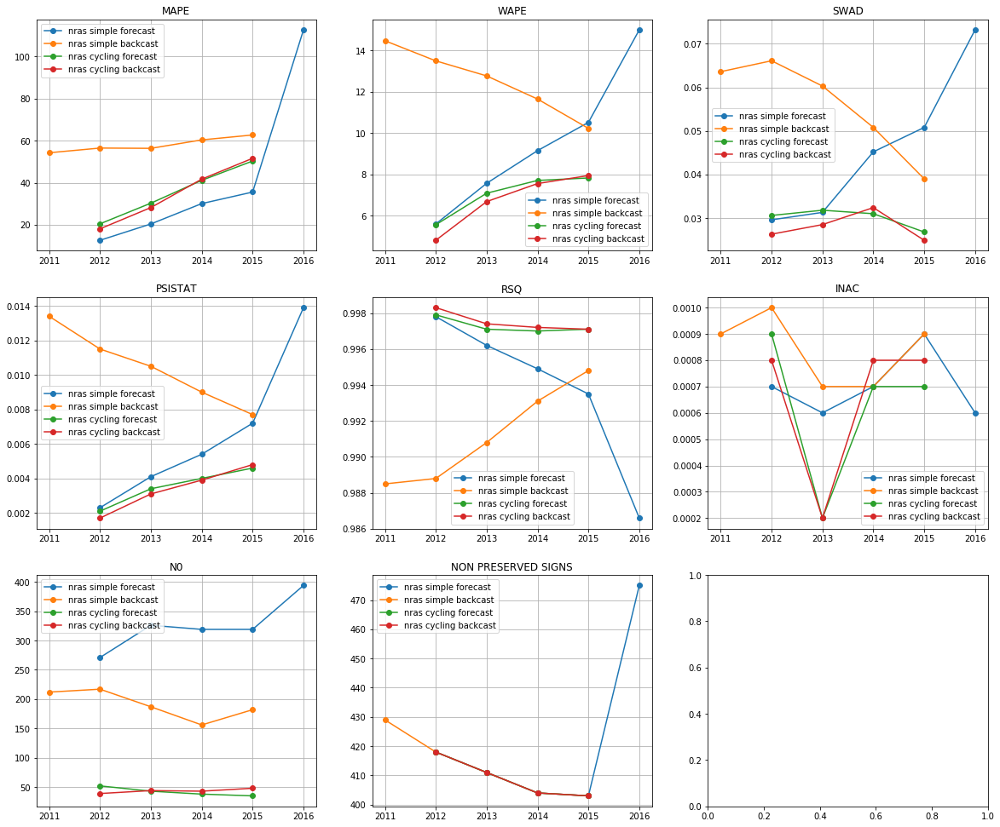

insd simple forecast
insd simple backcast
final cycle: 10
insd cycling forecast
final cycle: 10
insd cycling backcast


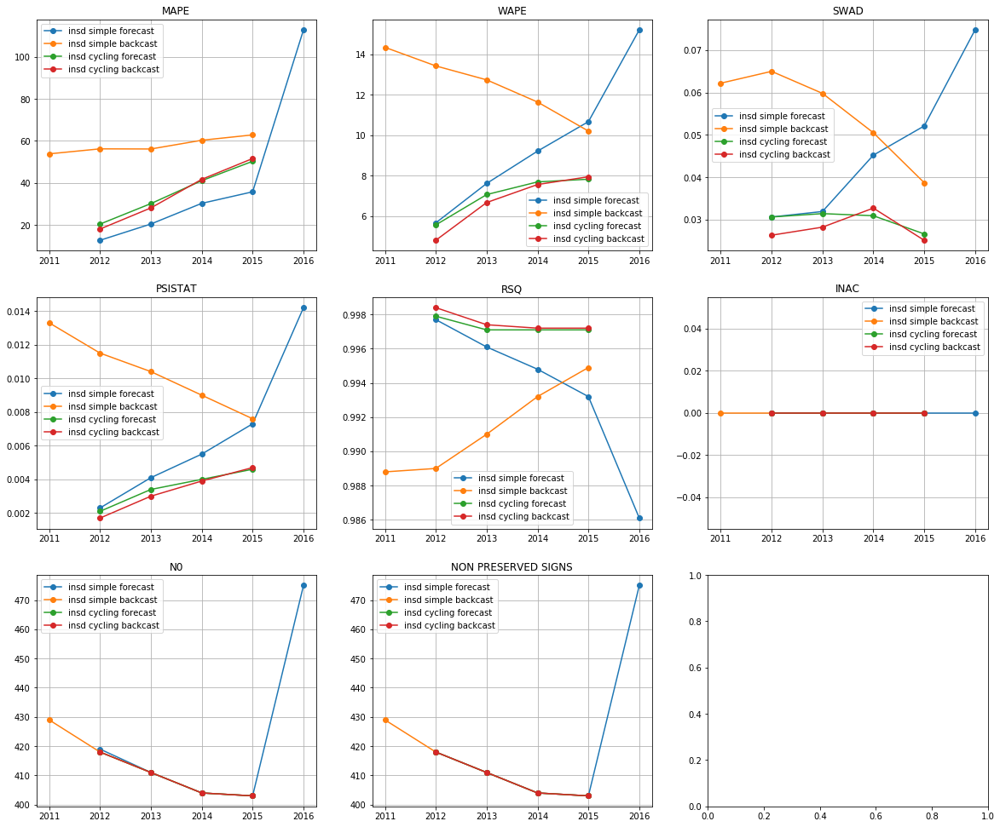

kuroda simple forecast
kuroda simple backcast
final cycle: 10
kuroda cycling forecast
final cycle: 10
kuroda cycling backcast


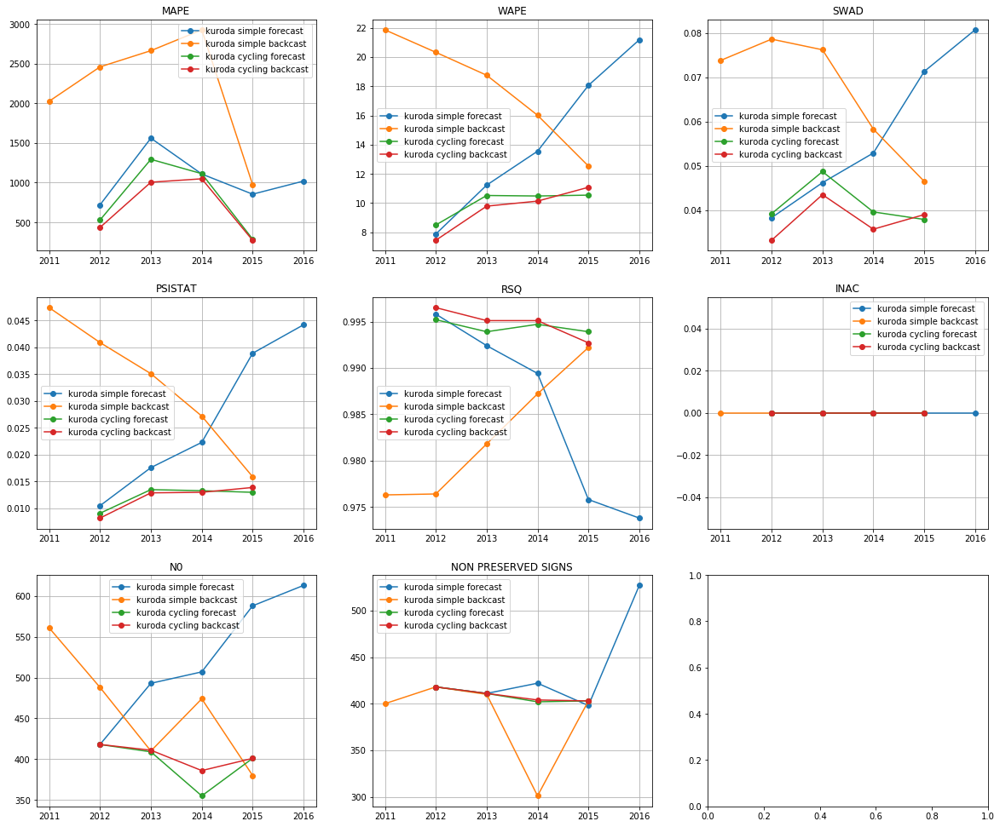

,MAPE,MAPE_R,WAPE,WAPE_R,SWAD,SWAD_R,PSISTAT,PSISTAT_R,RSQ,RSQ_R,INAC,INAC_R,N0,NON PRESERVED SIGNS,R_all,CmR
insd cycling backcast,34.888125,1,6.746900,1,0.028075,2,0.003325,1,0.997550,1,0.000000,1,409.00,409.0,7,1
insd cycling forecast,35.508300,3,7.037325,3,0.029875,3,0.003525,3,0.997300,3,0.000000,1,409.00,409.0,16,2
nras cycling backcast,34.890425,2,6.756725,2,0.028025,1,0.003375,2,0.997500,2,0.000650,10,43.50,409.0,19,3
nras cycling forecast,35.546175,4,7.054550,4,0.030050,4,0.003525,3,0.997275,4,0.000625,9,42.00,409.0,28,4
kuroda cycling backcast,690.713000,9,9.617675,6,0.037850,5,0.012000,9,0.994850,5,0.000000,1,404.00,409.0,35,5
insd simple forecast,42.431640,6,9.673660,7,0.046920,8,0.006680,6,0.993580,8,0.000000,1,422.40,422.2,36,6
nras simple forecast,42.261720,5,9.571620,5,0.046020,7,0.006580,5,0.993800,7,0.000700,11,325.80,422.2,40,7
kuroda cycling forecast,805.991950,10,10.014700,8,0.041350,6,0.012225,10,0.994425,6,0.000000,1,395.75,408.5,41,8
insd simple backcast,57.889180,7,12.467240,9,0.055240,9,0.010360,7,0.991380,9,0.000000,1,413.00,413.0,42,9
kuroda simple forecast,1052.634500,11,14.380440,11,0.057880,11,0.026700,11,0.985440,11,0.000000,1,523.80,435.2,56,10


sup I
[2011 2012 2013 2014 2015 2016]
available mtypes: [0]
nras simple forecast
nras simple backcast
final cycle: 10
nras cycling forecast
final cycle: 10
nras cycling backcast


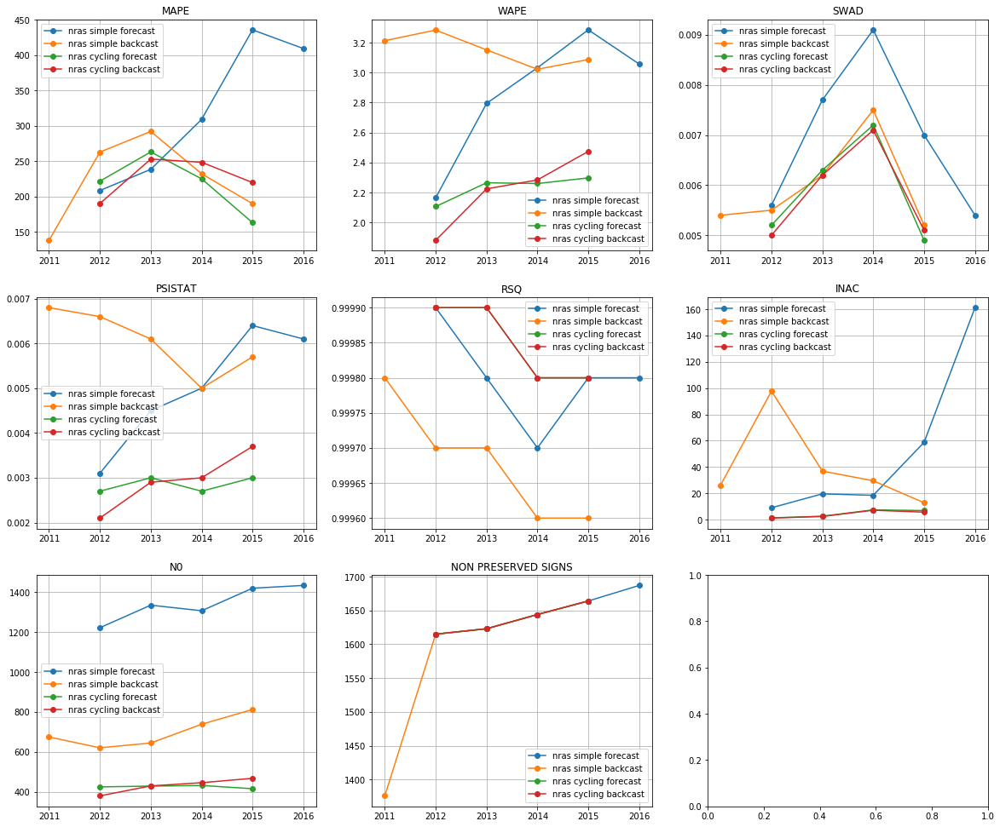

insd simple forecast
status was bad, new status: 3
status was bad twice, new status: 2
insd simple backcast
final cycle: 10
insd cycling forecast
final cycle: 10
insd cycling backcast


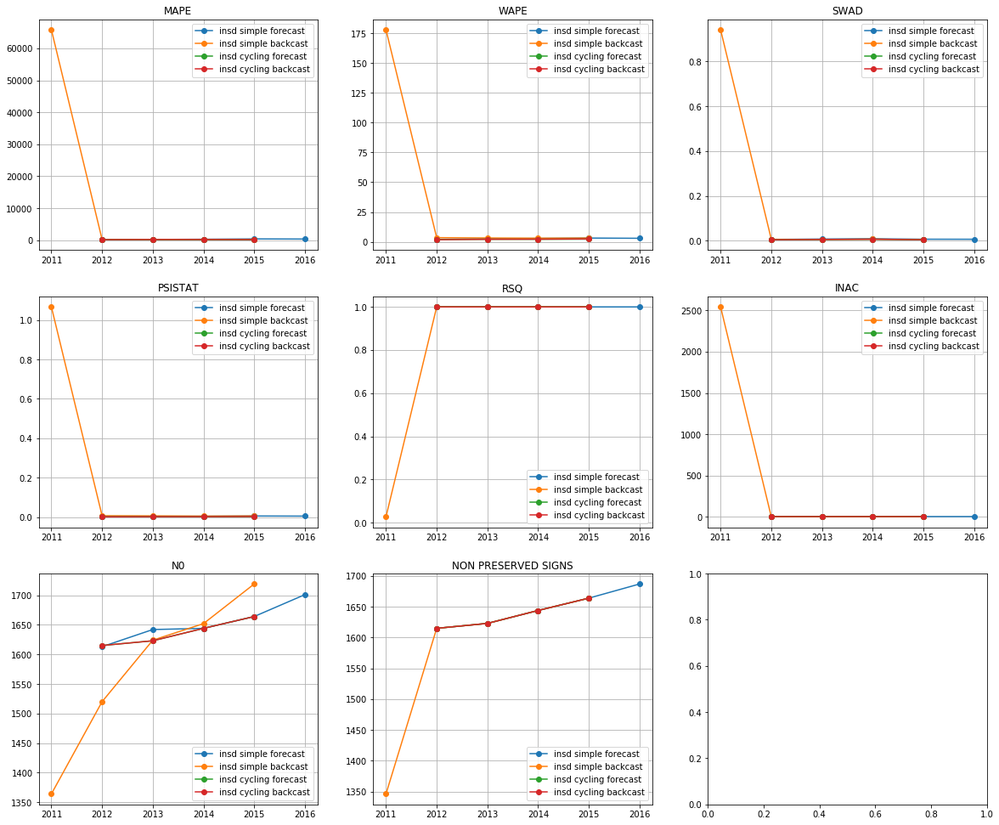

kuroda simple forecast
kuroda simple backcast
final cycle: 10
kuroda cycling forecast
final cycle: 10
kuroda cycling backcast


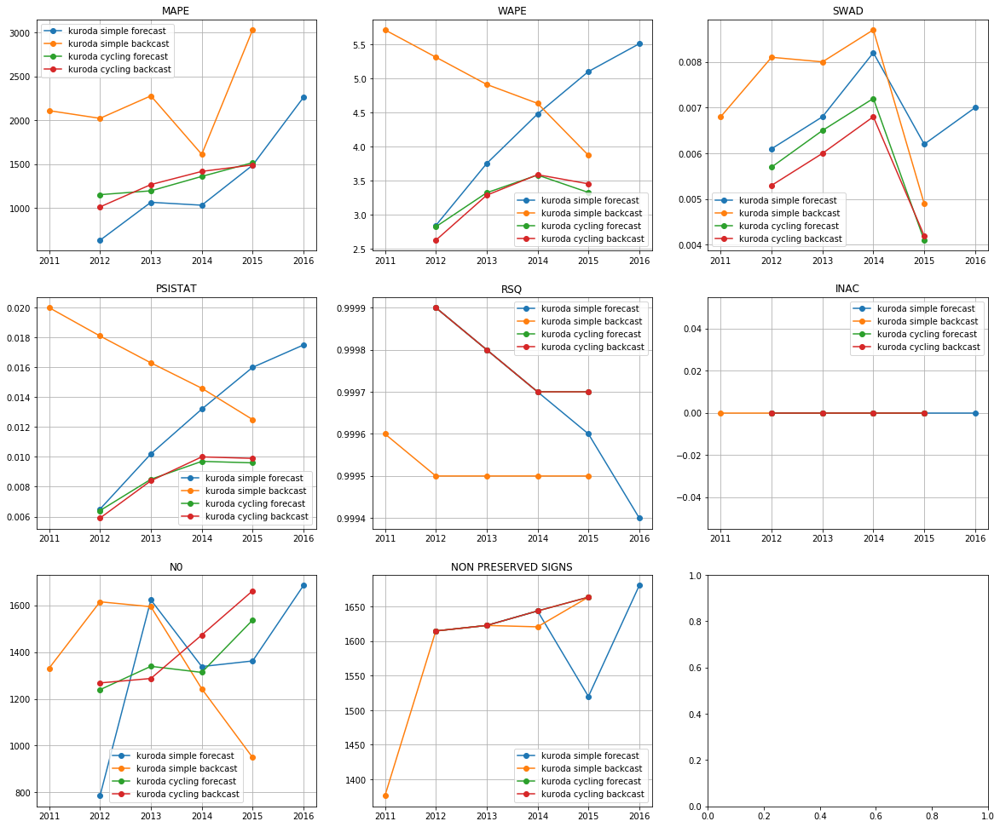

,MAPE,MAPE_R,WAPE,WAPE_R,SWAD,SWAD_R,PSISTAT,PSISTAT_R,RSQ,RSQ_R,INAC,INAC_R,N0,NON PRESERVED SIGNS,R_all,CmR
insd cycling forecast,198.088350,1,2.169275,2,0.005125,2,0.002850,1,0.999850,1,0.00000,1,1636.5,1636.5,8,1
insd cycling backcast,211.102075,2,2.155225,1,0.005075,1,0.002925,3,0.999850,1,0.00000,1,1636.5,1636.5,9,2
nras cycling forecast,218.313350,3,2.231925,4,0.005900,6,0.002850,1,0.999850,1,4.56670,9,424.5,1636.5,24,3
nras cycling backcast,227.917750,5,2.215700,3,0.005850,4,0.002925,3,0.999850,1,4.11255,8,430.0,1636.5,24,3
insd simple forecast,298.428880,6,2.783160,5,0.006680,8,0.004880,5,0.999820,5,0.00000,1,1652.8,1646.6,30,5
kuroda cycling backcast,1296.985800,9,3.240650,8,0.005575,3,0.008550,8,0.999775,7,0.00000,1,1422.5,1636.5,36,6
kuroda cycling forecast,1306.274925,10,3.266375,9,0.005875,5,0.008550,8,0.999775,7,0.00000,1,1357.0,1636.5,40,7
nras simple backcast,223.103720,4,3.151520,7,0.005960,7,0.006040,7,0.999680,9,40.65320,10,697.6,1584.4,44,8
nras simple forecast,320.317300,7,2.866660,6,0.006960,10,0.005020,6,0.999800,6,53.40756,11,1343.6,1646.6,46,9
kuroda simple forecast,1295.838820,8,4.338920,10,0.006860,9,0.012680,10,0.999680,9,0.00000,1,1358.6,1616.6,47,10


iot
[2011 2012 2013 2014 2015 2016]
available mtypes: [0]
0 LinearRegression(copy_X=True, fit_intercept=True, n_jobs=1, normalize=False) False
using mtt 0
mtt0 ridge backcast
0 Ridge(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=None,
   normalize=False, random_state=None, solver='auto', tol=0.001) False
using mtt 0
mtt0 ridge backcast
0 Lasso(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=1000,
   normalize=False, positive=False, precompute=False, random_state=None,
   selection='cyclic', tol=0.0001, warm_start=False) False
using mtt 0
mtt0 ridge backcast
nras simple forecast
nras simple backcast
final cycle: 10
nras cycling forecast
final cycle: 10
nras cycling backcast


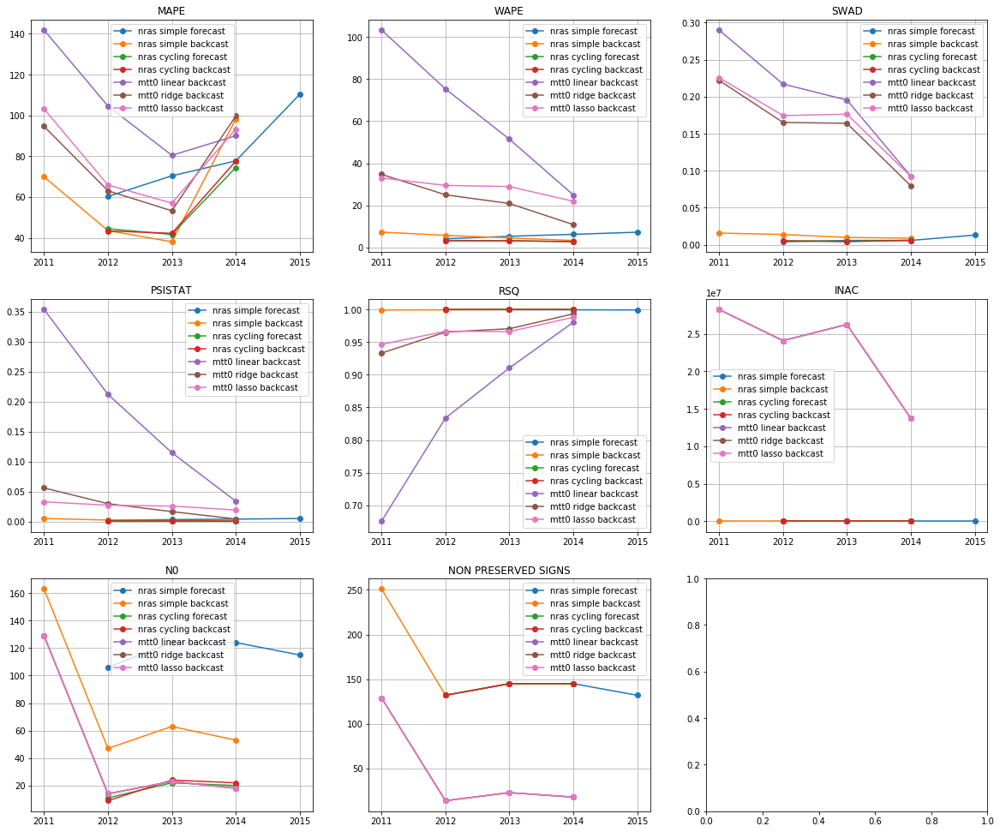

insd simple forecast
insd simple backcast
final cycle: 10
insd cycling forecast
final cycle: 10
insd cycling backcast


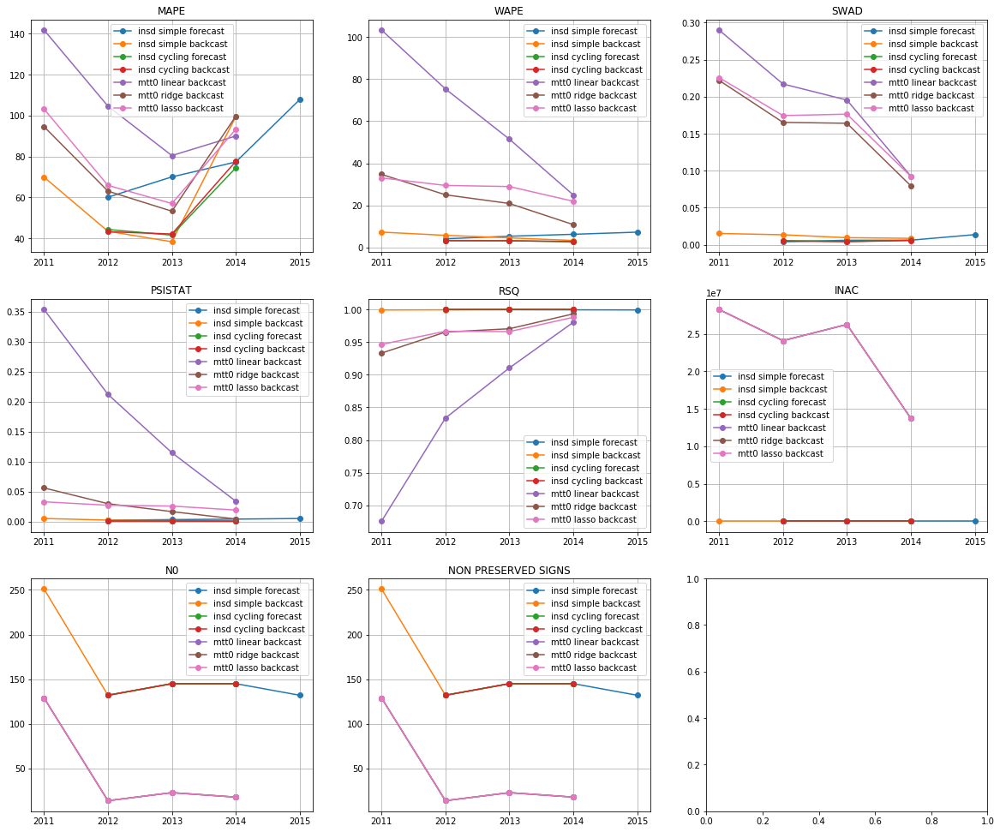

kuroda simple forecast
kuroda simple backcast
final cycle: 10
kuroda cycling forecast
final cycle: 10
kuroda cycling backcast


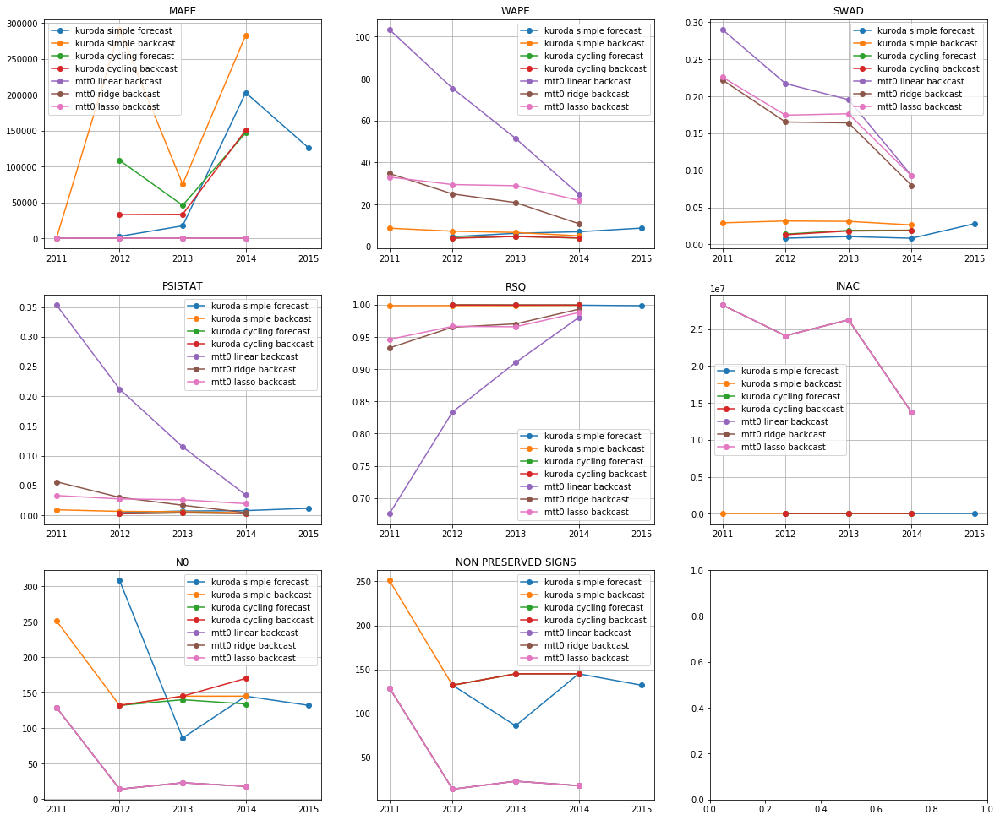

,MAPE,MAPE_R,WAPE,WAPE_R,SWAD,SWAD_R,PSISTAT,PSISTAT_R,RSQ,RSQ_R,INAC,INAC_R,N0,NON PRESERVED SIGNS,R_all,CmR
insd cycling backcast,54.326200,3,3.093567,2,0.004967,1,0.001033,1,0.999867,1,0.000000e+00,1,140.666667,140.666667,9,1
insd cycling forecast,53.449000,1,3.142500,4,0.005300,3,0.001033,1,0.999867,1,0.000000e+00,1,140.666667,140.666667,11,2
nras cycling backcast,54.414800,4,3.087033,1,0.005100,2,0.001033,1,0.999867,1,2.666667e-04,9,18.333333,140.666667,18,3
nras cycling forecast,53.537000,2,3.139033,3,0.005467,4,0.001033,1,0.999867,1,2.666667e-04,9,17.666667,140.666667,20,4
insd simple backcast,62.788125,6,5.271600,8,0.011675,7,0.002750,5,0.999500,7,0.000000e+00,1,168.250000,168.250000,34,5
kuroda cycling backcast,72262.999700,12,4.265367,5,0.016633,10,0.003267,7,0.999633,5,0.000000e+00,1,149.000000,140.666667,40,6
insd simple forecast,78.814850,8,5.788775,10,0.007425,6,0.003900,9,0.999475,9,0.000000e+00,1,138.500000,138.500000,43,7
nras simple backcast,62.446000,5,5.263525,7,0.012125,8,0.002750,5,0.999500,7,6.000000e-04,12,81.500000,168.250000,44,8
kuroda cycling forecast,100422.323300,14,4.338567,6,0.017333,11,0.003300,8,0.999567,6,0.000000e+00,1,135.333333,140.666667,46,9
nras simple forecast,79.675675,9,5.770550,9,0.007250,5,0.003900,9,0.999475,9,4.750000e-04,11,117.250000,138.500000,52,10


In [39]:
metrics_res['RUS'] = get_results('RUS')

# 3. Анализ результатов

## 3.1. Расчёт рангов для каждого вида таблиц

In [435]:
methods_names_ = sorted(get_compared_results(metrics_res['NLD']['iot'][0]).index.tolist())
methods_names_

['insd cycling backcast',
 'insd cycling forecast',
 'insd simple backcast',
 'insd simple forecast',
 'kuroda cycling backcast',
 'kuroda cycling forecast',
 'kuroda simple backcast',
 'kuroda simple forecast',
 'mtt0 lasso backcast',
 'mtt0 linear backcast',
 'mtt0 ridge backcast',
 'mtt2 lasso backcast',
 'mtt2 linear backcast',
 'mtt2 ridge backcast',
 'nras cycling backcast',
 'nras cycling forecast',
 'nras simple backcast',
 'nras simple forecast']

In [441]:
methods_names = methods_names_[-1:-5:-1] + methods_names_[3::-1] + methods_names_[7:3:-1] + \
                methods_names_[9:10] + methods_names_[8:9] + methods_names_[10:11] + \
                methods_names_[-6:-5] + methods_names_[-7:-6] + methods_names_[-5:-4]
for i, m in enumerate(methods_names[12:]):
    methods_names.insert(12 + 2 * i, m[:m.rfind(' ')] + ' forecast')
methods_names

['nras simple forecast',
 'nras simple backcast',
 'nras cycling forecast',
 'nras cycling backcast',
 'insd simple forecast',
 'insd simple backcast',
 'insd cycling forecast',
 'insd cycling backcast',
 'kuroda simple forecast',
 'kuroda simple backcast',
 'kuroda cycling forecast',
 'kuroda cycling backcast',
 'mtt0 linear forecast',
 'mtt0 linear backcast',
 'mtt0 lasso forecast',
 'mtt0 lasso backcast',
 'mtt0 ridge forecast',
 'mtt0 ridge backcast',
 'mtt2 linear forecast',
 'mtt2 linear backcast',
 'mtt2 lasso forecast',
 'mtt2 lasso backcast',
 'mtt2 ridge forecast',
 'mtt2 ridge backcast']

In [138]:
metrics_cols = get_compared_results(metrics_res['NLD']['iot'][0]).columns.tolist()
metrics_cols

['MAPE',
 'MAPE_R',
 'WAPE',
 'WAPE_R',
 'SWAD',
 'SWAD_R',
 'PSISTAT',
 'PSISTAT_R',
 'RSQ',
 'RSQ_R',
 'INAC',
 'INAC_R',
 'N0',
 'N0_R',
 'NON PRESERVED SIGNS',
 'NON PRESERVED SIGNS_R',
 'R_all',
 'CmR']

In [112]:
periods = dict.fromkeys(countries)
for country in countries:
    periods[country] = []
    for i in range(len(years[country]) // 5):
        periods[country].append(str(years[country][i * 5]) + '-' + str(years[country][(i + 1) * 5]))
periods

{'CHN': ['1997-2002', '2002-2007'],
 'ESP': ['1995-2000', '2000-2005'],
 'IND': ['1998-2003', '2003-2008'],
 'NLD': ['2000-2005', '2005-2010'],
 'RUS': ['2011-2016'],
 'USA': ['1997-2002', '2002-2007']}

In [42]:
tables_kinds = ['use basic I+II', 'use basic I', 'use purchase I+II', 'use purchase I', 'sup I', 'iot']

In [141]:
# Сбор всех результатов (значений метрик и рангов) в одну таблицу

res_df = pd.DataFrame(data=np.zeros((843, len(metrics_cols) + 4), dtype='float'), 
                      columns=['table kind', 'country', 'period', 'method'] + metrics_cols)
res_df.iloc[:, :4] = res_df.iloc[:, :4].astype('str')

old_ind = 0
new_ind = 0
for country, res in metrics_res.items():
    for kind, res_list in metrics_res[country].items():
        for i in range(len(res_list)):
            compared_res = get_compared_results(res_list[i])
            old_ind = new_ind
            new_ind += compared_res.shape[0]
            res_df.iloc[old_ind:new_ind, 4:] = np.array(compared_res)
            res_df.iloc[old_ind:new_ind]['method'] = compared_res.index.tolist()
            res_df.iloc[old_ind:new_ind]['period'] = np.full(compared_res.shape[0], periods[country][i])
            res_df.iloc[old_ind:new_ind]['table kind'] = np.full(new_ind - old_ind, kind)
            res_df.iloc[old_ind:new_ind]['country'] = np.full(new_ind - old_ind, country)
        old_ind = new_ind  
        
res_df

,table kind,country,period,method,MAPE,MAPE_R,WAPE,WAPE_R,SWAD,SWAD_R,...,RSQ,RSQ_R,INAC,INAC_R,N0,N0_R,NON PRESERVED SIGNS,NON PRESERVED SIGNS_R,R_all,CmR
0,use basic I+II,RUS,2011-2016,nras cycling backcast,32.496050,3.0,5.715275,2.0,0.019350,2.0,...,0.998800,1.0,2.500000e-04,2.0,45.00,2.0,604.50,4.0,18.0,1.0
1,use basic I+II,RUS,2011-2016,insd cycling backcast,32.021300,1.0,5.710175,1.0,0.019275,1.0,...,0.998800,1.0,0.000000e+00,1.0,604.50,9.0,604.50,4.0,19.0,2.0
2,use basic I+II,RUS,2011-2016,nras cycling forecast,32.771675,4.0,5.930275,4.0,0.019525,4.0,...,0.998750,2.0,2.500000e-04,2.0,42.50,1.0,604.50,4.0,25.0,3.0
3,use basic I+II,RUS,2011-2016,insd cycling forecast,32.334350,2.0,5.927125,3.0,0.019500,3.0,...,0.998750,2.0,0.000000e+00,1.0,604.50,9.0,604.50,4.0,27.0,4.0
4,use basic I+II,RUS,2011-2016,kuroda cycling forecast,338.088500,9.0,8.272225,6.0,0.028400,5.0,...,0.997550,4.0,0.000000e+00,1.0,538.50,6.0,592.25,2.0,43.0,5.0
5,use basic I+II,RUS,2011-2016,kuroda cycling backcast,356.072850,10.0,7.892350,5.0,0.028550,6.0,...,0.997675,3.0,0.000000e+00,1.0,550.25,7.0,604.25,3.0,44.0,6.0
6,use basic I+II,RUS,2011-2016,nras simple forecast,53.302580,6.0,9.663520,7.0,0.046240,9.0,...,0.994840,7.0,8.800000e-04,4.0,501.60,4.0,619.00,6.0,48.0,7.0
7,use basic I+II,RUS,2011-2016,nras simple backcast,72.319780,8.0,10.879120,10.0,0.041700,8.0,...,0.995080,5.0,8.600000e-04,3.0,205.60,3.0,610.40,5.0,50.0,8.0
8,use basic I+II,RUS,2011-2016,insd simple backcast,72.281000,7.0,10.851160,9.0,0.041700,7.0,...,0.995060,6.0,0.000000e+00,1.0,610.40,10.0,610.40,5.0,52.0,9.0
9,use basic I+II,RUS,2011-2016,insd simple forecast,49.429880,5.0,9.728500,8.0,0.046420,10.0,...,0.994840,8.0,0.000000e+00,1.0,619.00,11.0,619.00,6.0,55.0,10.0


In [144]:
res_df.to_csv('res_df.csv')

In [221]:
res_df = pd.read_csv('res_df.csv').iloc[:, 1:]
res_df = res_df.set_index('method')
res_df

,table kind,country,period,method,MAPE,MAPE_R,WAPE,WAPE_R,SWAD,SWAD_R,...,RSQ,RSQ_R,INAC,INAC_R,N0,N0_R,NON PRESERVED SIGNS,NON PRESERVED SIGNS_R,R_all,CmR
0,use basic I+II,RUS,2011-2016,nras cycling backcast,32.496050,3.0,5.715275,2.0,0.019350,2.0,...,0.998800,1.0,2.500000e-04,2.0,45.00,2.0,604.50,4.0,18.0,1.0
1,use basic I+II,RUS,2011-2016,insd cycling backcast,32.021300,1.0,5.710175,1.0,0.019275,1.0,...,0.998800,1.0,0.000000e+00,1.0,604.50,9.0,604.50,4.0,19.0,2.0
2,use basic I+II,RUS,2011-2016,nras cycling forecast,32.771675,4.0,5.930275,4.0,0.019525,4.0,...,0.998750,2.0,2.500000e-04,2.0,42.50,1.0,604.50,4.0,25.0,3.0
3,use basic I+II,RUS,2011-2016,insd cycling forecast,32.334350,2.0,5.927125,3.0,0.019500,3.0,...,0.998750,2.0,0.000000e+00,1.0,604.50,9.0,604.50,4.0,27.0,4.0
4,use basic I+II,RUS,2011-2016,kuroda cycling forecast,338.088500,9.0,8.272225,6.0,0.028400,5.0,...,0.997550,4.0,0.000000e+00,1.0,538.50,6.0,592.25,2.0,43.0,5.0
5,use basic I+II,RUS,2011-2016,kuroda cycling backcast,356.072850,10.0,7.892350,5.0,0.028550,6.0,...,0.997675,3.0,0.000000e+00,1.0,550.25,7.0,604.25,3.0,44.0,6.0
6,use basic I+II,RUS,2011-2016,nras simple forecast,53.302580,6.0,9.663520,7.0,0.046240,9.0,...,0.994840,7.0,8.800000e-04,4.0,501.60,4.0,619.00,6.0,48.0,7.0
7,use basic I+II,RUS,2011-2016,nras simple backcast,72.319780,8.0,10.879120,10.0,0.041700,8.0,...,0.995080,5.0,8.600000e-04,3.0,205.60,3.0,610.40,5.0,50.0,8.0
8,use basic I+II,RUS,2011-2016,insd simple backcast,72.281000,7.0,10.851160,9.0,0.041700,7.0,...,0.995060,6.0,0.000000e+00,1.0,610.40,10.0,610.40,5.0,52.0,9.0
9,use basic I+II,RUS,2011-2016,insd simple forecast,49.429880,5.0,9.728500,8.0,0.046420,10.0,...,0.994840,8.0,0.000000e+00,1.0,619.00,11.0,619.00,6.0,55.0,10.0


In [226]:
# Кумулятивные ранги по сбалансированным прогнозам

ranks = np.arange(1, 19)
balanced_ranks_df = pd.DataFrame(data=np.zeros((len(ranks) * len(tables_kinds), len(methods_names) + 2), dtype='int'), 
                                 columns=['table kind', 'CmR'] + methods_names)
balanced_ranks_df['table kind'] = balanced_ranks_df['table kind'].astype('str')
balanced_ranks_df['table kind'] = np.repeat(tables_kinds, len(ranks))
balanced_ranks_df['CmR'] = np.tile(ranks, len(tables_kinds))

for kind in tables_kinds:
    for rank in ranks:
        n_ranks = res_df['CmR'][(res_df['table kind'] == kind) & (res_df['INAC'] < 10)] == rank
        n_ranks = n_ranks.groupby(level=0).sum(axis=0).astype('int')
        balanced_ranks_df.loc[balanced_ranks_df[(balanced_ranks_df['table kind'] == kind) \
                                                & (balanced_ranks_df['CmR'] == rank)].index, 
                              n_ranks.index.tolist()] = n_ranks.values

balanced_ranks_df.to_csv('balanced_ranks_df.csv')
balanced_ranks_df

,table kind,CmR,nras simple forecast,nras simple backcast,nras cycling forecast,nras cycling backcast,insd simple forecast,insd simple backcast,insd cycling forecast,insd cycling backcast,...,mtt0 ridge backcast,mtt2 linear backcast,mtt2 lasso backcast,mtt2 ridge backcast,mtt0 linear forecast,mtt0 lasso forecast,mtt0 ridge forecast,mtt2 linear forecast,mtt2 lasso forecast,mtt2 ridge forecast
0,use basic I+II,1,0,0,7,5,0,0,1,0,...,0,0,0,0,0,0,0,0,0,0
1,use basic I+II,2,0,0,2,1,0,0,4,4,...,0,0,0,0,0,0,0,0,0,0
2,use basic I+II,3,0,0,2,4,0,0,0,5,...,0,0,0,0,0,0,0,0,0,0
3,use basic I+II,4,1,0,0,1,0,0,5,2,...,0,0,0,0,0,0,0,0,0,0
4,use basic I+II,5,2,2,0,0,1,1,1,0,...,0,0,0,0,0,0,0,0,0,0
5,use basic I+II,6,0,0,0,0,1,2,0,0,...,0,0,0,0,0,0,0,0,0,0
6,use basic I+II,7,1,5,0,0,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
7,use basic I+II,8,1,1,0,0,0,4,0,0,...,0,0,0,0,0,0,0,0,0,0
8,use basic I+II,9,5,3,0,0,2,1,0,0,...,0,0,0,0,0,0,0,0,0,0
9,use basic I+II,10,1,0,0,0,5,2,0,0,...,0,0,0,0,0,0,0,0,0,0


In [238]:
balanced_ranks_df.iloc[:, 2:].sum().sum(), np.sum(res_df['INAC'] < 10)

(755, 755)

In [239]:
# Кумулятивные ранги по всем прогнозам (включая несбалансированные)

non_balanced_ranks_df = pd.DataFrame(data=np.zeros((len(ranks) * len(tables_kinds), len(methods_names) + 2), dtype='int'), 
                                     columns=['table kind', 'CmR'] + methods_names)
non_balanced_ranks_df['table kind'] = non_balanced_ranks_df['table kind'].astype('str')
non_balanced_ranks_df['table kind'] = np.repeat(tables_kinds, len(ranks))
non_balanced_ranks_df['CmR'] = np.tile(ranks, len(tables_kinds))

for kind in tables_kinds:
    for rank in ranks:
        n_ranks = res_df['CmR'][res_df['table kind'] == kind] == rank
        n_ranks = n_ranks.groupby(level=0).sum(axis=0).astype('int')
        non_balanced_ranks_df.loc[non_balanced_ranks_df[(non_balanced_ranks_df['table kind'] == kind) \
                                                        & (non_balanced_ranks_df['CmR'] == rank)].index, 
                              n_ranks.index.tolist()] = n_ranks.values

non_balanced_ranks_df.to_csv('non_balanced_ranks_df.csv')
non_balanced_ranks_df

,table kind,CmR,nras simple forecast,nras simple backcast,nras cycling forecast,nras cycling backcast,insd simple forecast,insd simple backcast,insd cycling forecast,insd cycling backcast,...,mtt0 ridge backcast,mtt2 linear backcast,mtt2 lasso backcast,mtt2 ridge backcast,mtt0 linear forecast,mtt0 lasso forecast,mtt0 ridge forecast,mtt2 linear forecast,mtt2 lasso forecast,mtt2 ridge forecast
0,use basic I+II,1,0,0,7,5,0,0,1,0,...,0,0,0,0,0,0,0,0,0,0
1,use basic I+II,2,0,0,2,1,0,0,4,4,...,0,0,0,0,0,0,0,0,0,0
2,use basic I+II,3,0,0,2,4,0,0,0,5,...,0,0,0,0,0,0,0,0,0,0
3,use basic I+II,4,1,0,0,1,0,0,5,2,...,0,0,0,0,0,0,0,0,0,0
4,use basic I+II,5,2,2,0,0,1,1,1,0,...,0,0,0,0,0,0,0,0,0,0
5,use basic I+II,6,0,0,0,0,1,2,0,0,...,0,0,0,0,0,0,0,0,0,0
6,use basic I+II,7,1,5,0,0,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
7,use basic I+II,8,1,1,0,0,0,4,0,0,...,0,0,0,0,0,0,0,0,0,0
8,use basic I+II,9,5,3,0,0,2,1,0,0,...,0,0,0,0,0,0,0,0,0,0
9,use basic I+II,10,1,0,0,0,5,2,0,0,...,0,0,0,0,0,0,0,0,0,0


In [240]:
non_balanced_ranks_df.iloc[:, 2:].sum().sum(), res_df.shape[0]

(843, 843)

## 3.2. Визуальное представление результатов

In [505]:
labels = {'nras simple': 'классический NRAS',
          'nras cycling': 'цикличный NRAS',
          'insd simple': 'классический INSD',
          'insd cycling': 'цикличный INSD',
          'kuroda simple': 'классический Kuroda',
          'kuroda cycling': 'цикличный Kuroda',
          'mtt0 linear': 'МТТ с простой линейной регрессией',
          'mtt0 lasso': 'MTT с L1-регуляризацией',
          'mtt0 ridge': 'МТТ с L2-регуляризацией',
          'mtt2 linear': 'МТТ II с простой линейной регрессией',
          'mtt2 lasso': 'MTT II с L1-регуляризацией',
          'mtt2 ridge': 'МТТ II с L2-регуляризацией',
          'mtt0': 'MTT',
          'mtt2': 'MTT II'}

In [559]:
def plot_comparative_res(table_kind, n_methods):
    """
    Plot cumulative ranks
    
    Parameters
    ----------
    tables_kind: str
        kind of tables
    n_methods: int
        number of methods to plot
    """
    
    print(table_kind)
    n_non_balanced = np.sum(non_balanced_ranks_df[non_balanced_ranks_df['table kind'] == table_kind].iloc[:n_methods, 2 : 2 + n_methods].sum())
    n_balanced = np.sum(balanced_ranks_df[balanced_ranks_df['table kind'] == table_kind].iloc[:n_methods, 2 : 2 + n_methods].sum())
    print('n_non_balanced == n_balanced:', n_non_balanced == n_balanced)
    print(balanced_ranks_df[balanced_ranks_df['table kind'] == table_kind].iloc[:n_methods, 2 : 2 + n_methods].sum(axis=0))
    
    markers = ['o', '^', 's', '1', '2']
    edgecolors = ['tab:blue', 'tab:orange', 'tab:green']
        
    for i, ranks_df in enumerate([non_balanced_ranks_df] + ([balanced_ranks_df] if n_non_balanced != n_balanced else [])):
        print('non balanced' if i == 0 else 'balanced')
        plot_ranks_df = ranks_df[ranks_df['table kind'] == table_kind].iloc[:n_methods, 1 : 2 + n_methods]

        fig, ax = plt.subplots(1, 2, sharey=True, figsize=(15, 5))
        plt.subplots_adjust(wspace=0.1)

        for i in range(len(ax)):
            methods = methods_names[i:12:2]
            for j in range(len(methods[:12]) // 2):
                for k in range(2):
                    method = methods[j * 2 + k]
                    ax[i].scatter(plot_ranks_df['CmR'][plot_ranks_df[method] != 0], 
                                  plot_ranks_df[method][plot_ranks_df[method] != 0], 
                                  s=150 * (k + 1), marker=markers[j], c='None', edgecolors=edgecolors[k], linewidths=1.5,
                                  label=labels[method[:method.rfind(' ')]])
            if n_methods > 12:
                methods = methods_names[-12 + i * 1::2]
                for j in range(2):
                    mtt_ranks_df = pd.concat((plot_ranks_df['CmR'], plot_ranks_df[methods[j * 3 : (j + 1) * 3]].sum(axis=1)), 1)
                    if np.sum(mtt_ranks_df['CmR'][mtt_ranks_df.iloc[:, 1] != 0]):
                        ax[i].scatter(mtt_ranks_df['CmR'][mtt_ranks_df.iloc[:, 1] != 0], 
                                      mtt_ranks_df.iloc[:, 1][mtt_ranks_df.iloc[:, 1] != 0], 
                                      s=500, marker=markers[j + 3], c=edgecolors[2], 
                                      linewidths=3, label=labels['mtt0' if j == 0 else 'mtt2'])
                
            ax[i].set_xticks(plot_ranks_df['CmR'])
            ax[i].set_xlabel('Кумулятивные ранги')
            ax[i].set_title(('Перспективное' if i == 0 else 'Рестроспективное') + ' прогнозирование')

        ax[0].set_ylabel('Количество таблиц')
        ax[0].legend(loc='upper center', bbox_to_anchor=(2.3, 1.02), labelspacing=1)

        plt.show()

use basic I+II
n_non_balanced == n_balanced: True
nras simple forecast       11
nras simple backcast       11
nras cycling forecast      11
nras cycling backcast      11
insd simple forecast       11
insd simple backcast       11
insd cycling forecast      11
insd cycling backcast      11
kuroda simple forecast     11
kuroda simple backcast     11
kuroda cycling forecast    11
kuroda cycling backcast    11
dtype: int64
non balanced


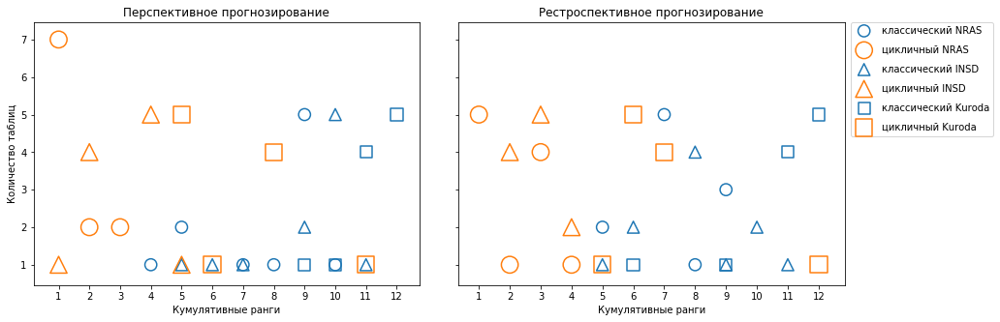

use basic I
n_non_balanced == n_balanced: True
nras simple forecast       11
nras simple backcast       11
nras cycling forecast      11
nras cycling backcast      11
insd simple forecast       11
insd simple backcast       11
insd cycling forecast      11
insd cycling backcast      11
kuroda simple forecast     11
kuroda simple backcast     11
kuroda cycling forecast    11
kuroda cycling backcast    11
dtype: int64
non balanced


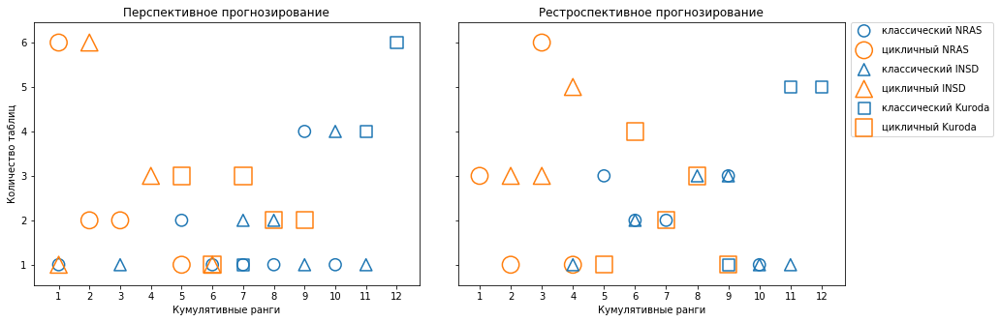

use purchase I+II
n_non_balanced == n_balanced: True
nras simple forecast       11
nras simple backcast       11
nras cycling forecast      11
nras cycling backcast      11
insd simple forecast       11
insd simple backcast       11
insd cycling forecast      11
insd cycling backcast      11
kuroda simple forecast     11
kuroda simple backcast     11
kuroda cycling forecast    11
kuroda cycling backcast    11
dtype: int64
non balanced


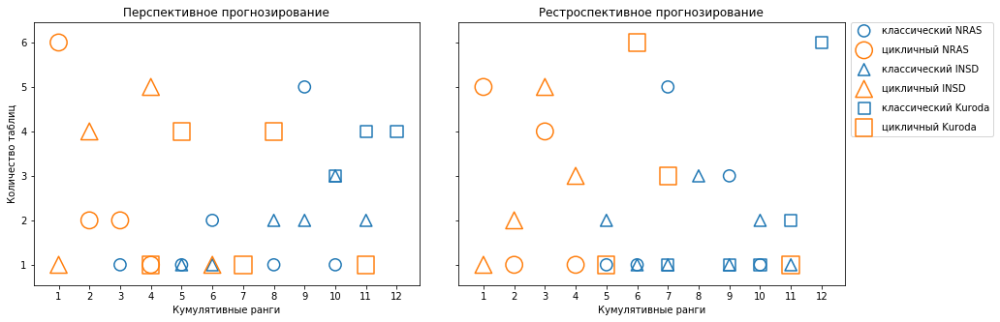

use purchase I
n_non_balanced == n_balanced: True
nras simple forecast       11
nras simple backcast       11
nras cycling forecast      11
nras cycling backcast      11
insd simple forecast       11
insd simple backcast       11
insd cycling forecast      11
insd cycling backcast      11
kuroda simple forecast     11
kuroda simple backcast     11
kuroda cycling forecast    11
kuroda cycling backcast    11
dtype: int64
non balanced


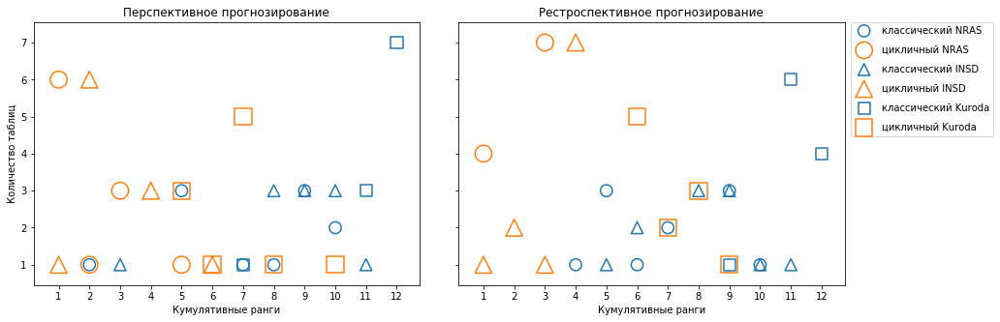

sup I
n_non_balanced == n_balanced: False
nras simple forecast        6
nras simple backcast        6
nras cycling forecast       7
nras cycling backcast       7
insd simple forecast       11
insd simple backcast       10
insd cycling forecast      11
insd cycling backcast      11
kuroda simple forecast      5
kuroda simple backcast      5
kuroda cycling forecast     5
kuroda cycling backcast     5
dtype: int64
non balanced


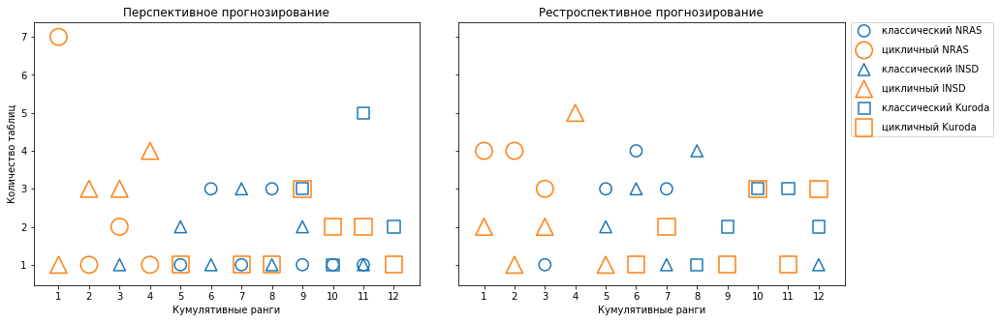

balanced


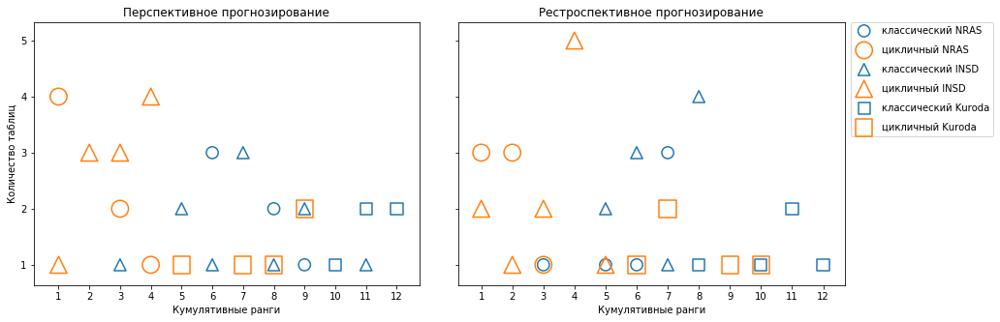

In [560]:
# Строим кумулятивные ранги для таблиц использования и ресурсов

for table_kind in tables_kinds[:-1]:
    plot_comparative_res(table_kind, 12)

iot
n_non_balanced == n_balanced: False
nras simple forecast       11
nras simple backcast       11
nras cycling forecast      11
nras cycling backcast      11
insd simple forecast       11
insd simple backcast       11
insd cycling forecast      11
insd cycling backcast      11
kuroda simple forecast     11
kuroda simple backcast     11
kuroda cycling forecast    11
kuroda cycling backcast    11
mtt0 linear backcast        0
mtt0 lasso backcast         0
mtt0 ridge backcast         0
mtt2 linear backcast        0
mtt2 lasso backcast         0
mtt2 ridge backcast         0
mtt0 linear forecast        0
mtt0 lasso forecast         0
mtt0 ridge forecast         0
mtt2 linear forecast        2
mtt2 lasso forecast         2
mtt2 ridge forecast         2
dtype: int64
non balanced


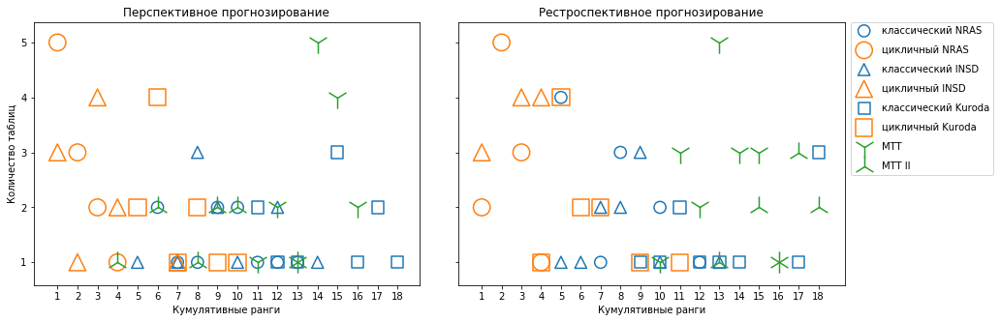

balanced


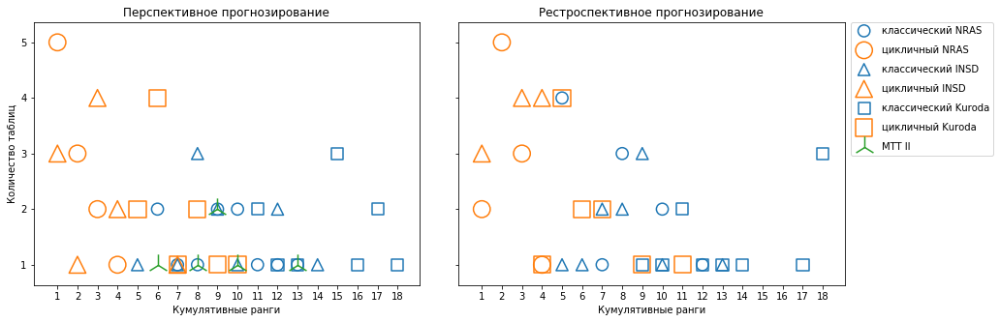

In [561]:
# Строим кумулятивные ранги для симметричных таблиц

plot_comparative_res('iot', 24)

non balanced


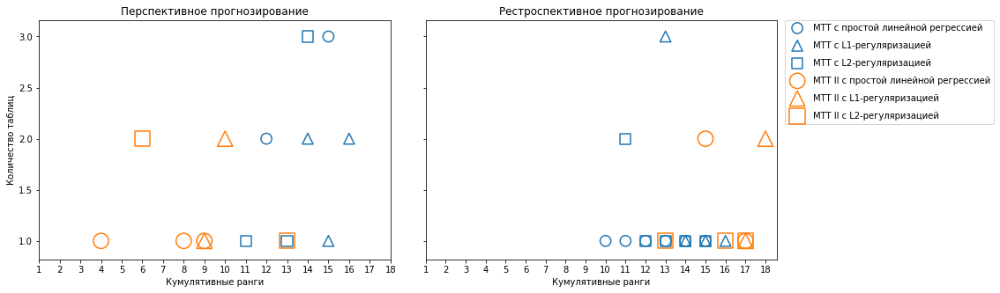

balanced


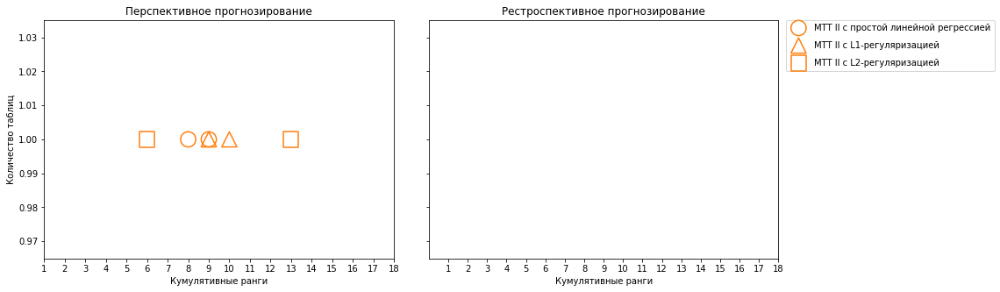

In [579]:
# Строим кумулятивные ранги для mtt метода с детализацией прогнозных моделей

mtt_methods = methods_names[-12:]

markers = ['o', '^', 's']
edgecolors = ['tab:blue', 'tab:orange']
        
for i, ranks_df in enumerate([non_balanced_ranks_df, balanced_ranks_df]):
    print('non balanced' if i == 0 else 'balanced')
    plot_ranks_df = ranks_df[ranks_df['table kind'] == 'iot'].iloc[:, np.append([1], np.arange(14, 26))]

    fig, ax = plt.subplots(1, 2, sharey=True, figsize=(15, 5))
    plt.subplots_adjust(wspace=0.1)

    for i in range(len(ax)):
        methods = mtt_methods[i::2]
        for j in range(2):
            for k in range(3):
                method = methods[j * 3 + k]
                if np.sum(plot_ranks_df['CmR'][plot_ranks_df[method] != 0]) != 0:
                    ax[i].scatter(plot_ranks_df['CmR'][plot_ranks_df[method] != 0], 
                                  plot_ranks_df[method][plot_ranks_df[method] != 0], 
                                  s=150 * (j + 1), marker=markers[k], c='None', edgecolors=edgecolors[j], linewidths=1.5,
                                  label=labels[method[:method.rfind(' ')]])

        ax[i].set_xticks(plot_ranks_df['CmR'])
        ax[i].set_xlabel('Кумулятивные ранги')
        ax[i].set_title(('Перспективное' if i == 0 else 'Рестроспективное') + ' прогнозирование')
    
    ax[0].set_ylabel('Количество таблиц')
    ax[0].legend(loc='upper center', bbox_to_anchor=(2.42, 1.02), labelspacing=1)

    plt.show()